In [2]:
import pandas as pd
import numpy as np
from pandas.plotting import table

In [3]:
data = pd.read_excel(r'D:\Code\py_code\Multi-Layer-Perceptron\data\BA_AirlineReviews_CL_excel.xlsx',header=0)

data.head()

,id,Satisfaction,ReviewHeader,Name,Datetime,VerifiedReview,ReviewBody,TypeOfTraveller,SeatType,Route,DateFlown,SeatComfort,CabinStaffService,GroundService,ValueForMoney,Recommended,Aircraft,Food&Beverages,InflightEntertainment,Wifi&Connectivity
0,0,Very Dissatisfied,"""Service level far worse then Ryanair""",L Keele,19th November 2023,True,4 Hours before takeoff we received a Mail stat...,Couple Leisure,Economy Class,London to Stuttgart,2023-11-01,1.0,1.0,1.0,1.0,no,NaN,NaN,NaN,NaN
1,1,Neutral,"""do not upgrade members based on status""",Austin Jones,19th November 2023,True,I recently had a delay on British Airways from...,Business,Economy Class,Brussels to London,2023-11-01,2.0,3.0,1.0,2.0,no,A320,1.0,2.0,2.0
2,2,Enthusiastic,"""Flight was smooth and quick""",M A Collie,16th November 2023,False,"Boarded on time, but it took ages to get to th...",Couple Leisure,Business Class,London Heathrow to Dublin,2023-11-01,3.0,3.0,4.0,3.0,yes,A320,4.0,NaN,NaN
3,3,Very Dissatisfied,"""Absolutely hopeless airline""",Nigel Dean,16th November 2023,True,"5 days before the flight, we were advised by B...",Couple Leisure,Economy Class,London to Dublin,2022-12-01,3.0,3.0,1.0,1.0,no,NaN,NaN,NaN,NaN
4,4,Very Dissatisfied,"""Customer Service is non existent""",Gaylynne Simpson,14th November 2023,False,"We traveled to Lisbon for our dream vacation, ...",Couple Leisure,Economy Class,London to Lisbon,2023-11-01,1.0,1.0,1.0,1.0,no,NaN,1.0,1.0,1.0


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3701 entries, 0 to 3700
Data columns (total 20 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   id                     3701 non-null   int64         
 1   Satisfaction           3701 non-null   object        
 2   ReviewHeader           3701 non-null   object        
 3   Name                   3701 non-null   object        
 4   Datetime               3701 non-null   object        
 5   VerifiedReview         3701 non-null   bool          
 6   ReviewBody             3701 non-null   object        
 7   TypeOfTraveller        2930 non-null   object        
 8   SeatType               3699 non-null   object        
 9   Route                  2926 non-null   object        
 10  DateFlown              2923 non-null   datetime64[ns]
 11  SeatComfort            3585 non-null   float64       
 12  CabinStaffService      3574 non-null   float64       
 13  Gro

In [5]:
from sklearn.impute import KNNImputer

numeric_missing_col = data.columns[(data.isnull().any()) & (data.dtypes != 'object')].to_list()

impNumeric = KNNImputer(n_neighbors=5)
for col in numeric_missing_col:
    numeric = data[[col]].values
    impNumeric = impNumeric.fit(numeric)
    numeric = impNumeric.transform(numeric)
    numeric = numeric.round()
    data[col] = numeric

data.isnull().sum()

id                          0
Satisfaction                0
ReviewHeader                0
Name                        0
Datetime                    0
VerifiedReview              0
ReviewBody                  0
TypeOfTraveller           771
SeatType                    2
Route                     775
DateFlown                   0
SeatComfort                 0
CabinStaffService           0
GroundService               0
ValueForMoney               0
Recommended                 0
Aircraft                 1779
Food&Beverages              0
InflightEntertainment       0
Wifi&Connectivity           0
dtype: int64

In [6]:
nominal_missing_col = data.columns[(data.isnull().any()) & (data.dtypes == 'object')].to_list()
for col in nominal_missing_col:
    data[col].fillna("Unknown", inplace=True)

data.isnull().sum()

id                       0
Satisfaction             0
ReviewHeader             0
Name                     0
Datetime                 0
VerifiedReview           0
ReviewBody               0
TypeOfTraveller          0
SeatType                 0
Route                    0
DateFlown                0
SeatComfort              0
CabinStaffService        0
GroundService            0
ValueForMoney            0
Recommended              0
Aircraft                 0
Food&Beverages           0
InflightEntertainment    0
Wifi&Connectivity        0
dtype: int64

In [7]:
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder, OneHotEncoder

encoder = OneHotEncoder(sparse_output=False)
categorical_col = ['TypeOfTraveller', 'SeatType', 'SeatComfort','CabinStaffService','GroundService','ValueForMoney', 'Food&Beverages','InflightEntertainment','Wifi&Connectivity']
for col in categorical_col:
    encoded_data = encoder.fit_transform(data[[col]])
    encoded_df = pd.DataFrame(encoded_data, columns=encoder.get_feature_names_out([col]))
    data = pd.concat([data, encoded_df], axis=1)
    data = data.drop([col], axis=1)

lbenc = LabelEncoder()
for i in data.columns.values:
    if (data[i].dtypes == "object" or data[i].dtypes == "bool") and i != "Satisfaction":
        data[i] = lbenc.fit_transform(data[i].astype(str))

satisfaction_order = [
    "Very Dissatisfied",
    "Dissatisfied",
    "Neutral",
    "Satisfied",
    "Very Satisfied",
    "Enthusiastic",
    "Extremely Satisfied",
    "Delighted",
    "Evangelist",
    "Advocate"
]

ordinal_enc = OrdinalEncoder(categories=[satisfaction_order])
data["Satisfaction"] = ordinal_enc.fit_transform(data[["Satisfaction"]])

data.head()

,id,Satisfaction,ReviewHeader,Name,Datetime,VerifiedReview,ReviewBody,Route,DateFlown,Recommended,...,InflightEntertainment_1.0,InflightEntertainment_2.0,InflightEntertainment_3.0,InflightEntertainment_4.0,InflightEntertainment_5.0,Wifi&Connectivity_1.0,Wifi&Connectivity_2.0,Wifi&Connectivity_3.0,Wifi&Connectivity_4.0,Wifi&Connectivity_5.0
0,0,0.0,483,1590,595,1,25,1044,1.698797e+18,0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,1,2.0,1128,254,595,1,1649,143,1.698797e+18,0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,2,5.0,264,1660,406,0,372,824,1.698797e+18,1,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,3,0.0,37,2009,406,1,28,946,1.669853e+18,0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,4,0.0,222,1013,295,0,3603,976,1.698797e+18,0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [8]:
data.describe()

,id,Satisfaction,ReviewHeader,Name,Datetime,VerifiedReview,ReviewBody,Route,DateFlown,Recommended,...,InflightEntertainment_1.0,InflightEntertainment_2.0,InflightEntertainment_3.0,InflightEntertainment_4.0,InflightEntertainment_5.0,Wifi&Connectivity_1.0,Wifi&Connectivity_2.0,Wifi&Connectivity_3.0,Wifi&Connectivity_4.0,Wifi&Connectivity_5.0
count,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3.701000e+03,3701.000000,...,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000,3701.000000
mean,1850.000000,3.627668,1665.487166,1396.319643,905.066739,0.311537,1845.307755,924.593083,-7.329317e+17,0.404755,...,0.212645,0.115644,0.460146,0.126182,0.085382,0.100784,0.852472,0.019724,0.012429,0.014591
std,1068.531001,3.094761,869.403991,838.782534,527.062164,0.463184,1065.214398,468.600891,4.381454e+18,0.490911,...,0.409234,0.319841,0.498476,0.332099,0.279488,0.301083,0.354679,0.139070,0.110806,0.119924
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.223372e+18,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,925.000000,1.000000,897.000000,655.000000,457.000000,0.000000,923.000000,563.000000,1.438387e+18,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
50%,1850.000000,3.000000,1804.000000,1354.000000,888.000000,0.000000,1847.000000,962.000000,1.483229e+18,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
75%,2775.000000,6.000000,2609.000000,2136.000000,1373.000000,1.000000,2767.000000,1454.000000,1.551398e+18,1.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
max,3700.000000,9.000000,2684.000000,2901.000000,1819.000000,1.000000,3691.000000,1542.000000,1.698797e+18,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [9]:
data.drop(['id', 'Name', 'ReviewHeader', 'ReviewBody', 'Route', 'Aircraft', 'DateFlown', 'Datetime'], inplace=True, axis = 1)
data.columns.to_list()

['Satisfaction',
 'VerifiedReview',
 'Recommended',
 'TypeOfTraveller_Business',
 'TypeOfTraveller_Couple Leisure',
 'TypeOfTraveller_Family Leisure',
 'TypeOfTraveller_Solo Leisure',
 'TypeOfTraveller_Unknown',
 'SeatType_Business Class',
 'SeatType_Economy Class',
 'SeatType_First Class',
 'SeatType_Premium Economy',
 'SeatType_Unknown',
 'SeatComfort_1.0',
 'SeatComfort_2.0',
 'SeatComfort_3.0',
 'SeatComfort_4.0',
 'SeatComfort_5.0',
 'CabinStaffService_1.0',
 'CabinStaffService_2.0',
 'CabinStaffService_3.0',
 'CabinStaffService_4.0',
 'CabinStaffService_5.0',
 'GroundService_1.0',
 'GroundService_2.0',
 'GroundService_3.0',
 'GroundService_4.0',
 'GroundService_5.0',
 'ValueForMoney_1.0',
 'ValueForMoney_2.0',
 'ValueForMoney_3.0',
 'ValueForMoney_4.0',
 'ValueForMoney_5.0',
 'Food&Beverages_1.0',
 'Food&Beverages_2.0',
 'Food&Beverages_3.0',
 'Food&Beverages_4.0',
 'Food&Beverages_5.0',
 'InflightEntertainment_1.0',
 'InflightEntertainment_2.0',
 'InflightEntertainment_3.0',
 'I

In [10]:
from sklearn.model_selection import train_test_split

features = data.drop(['Satisfaction'], axis=1)
label = data['Satisfaction']

x_train, x_test, y_train, y_test = train_test_split(features, label, test_size=0.1, random_state=42, stratify=label, shuffle=True)

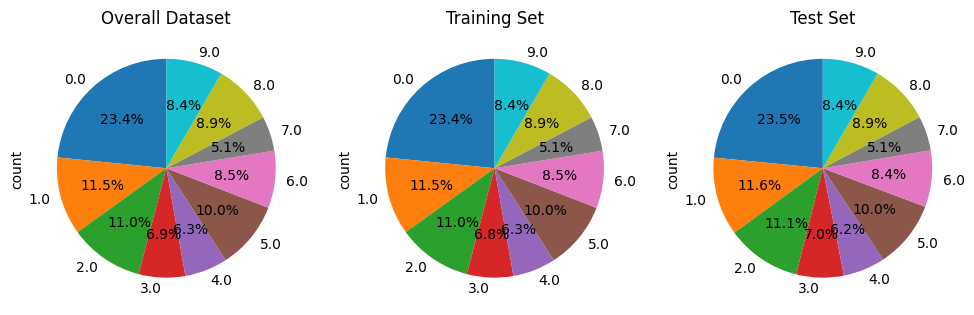

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

s_train = pd.DataFrame(y_train, columns=['Satisfaction'])
s_test = pd.DataFrame(y_test, columns=['Satisfaction'])

sorted_train = s_train['Satisfaction'].value_counts().sort_index()
sorted_test = s_test['Satisfaction'].value_counts().sort_index()
sorted_data = data['Satisfaction'].value_counts().sort_index()

# Create a pie chart for the overall dataset
plt.figure(figsize=(12, 5))

plt.subplot(1, 3, 2)
plt.title('Training Set')
sorted_train.plot.pie(autopct='%1.1f%%', startangle=90)

plt.subplot(1, 3, 3)
plt.title('Test Set')
sorted_test.plot.pie(autopct='%1.1f%%', startangle=90)

plt.subplot(1, 3, 1)
plt.title('Overall Dataset')
sorted_data.plot.pie(autopct='%1.1f%%', startangle=90)

plt.show()

In [12]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_test = scaler.transform(x_test)

,0,1,2,3,4,5,6,7,8,9,...,37,38,39,40,41,42,43,44,45,46
0,1.000000,-0.072955,0.078334,0.040597,0.076577,0.157712,-0.341139,0.023674,0.016246,-0.039935,...,-0.081331,-0.076504,0.157887,-0.063152,0.000449,0.089580,-0.163777,0.072204,0.092817,0.095750
1,-0.072955,1.000000,-0.171770,-0.050867,-0.020437,0.048071,0.178671,0.075868,-0.087849,0.038319,...,-0.241251,-0.095406,-0.048930,0.222641,0.286082,-0.205170,0.123051,-0.003321,0.060546,0.113029
2,0.078334,-0.171770,1.000000,-0.276494,-0.155063,-0.253058,-0.229964,0.119343,-0.097501,0.003640,...,0.039193,-0.029269,0.066602,-0.054959,-0.077071,0.096582,-0.104172,0.045954,0.002285,0.008333
3,0.040597,-0.050867,-0.276494,1.000000,-0.213446,-0.348337,-0.316548,0.039993,-0.040615,0.003890,...,-0.076663,0.011789,0.068092,0.008778,-0.033202,0.021215,-0.026690,0.008705,0.024509,-0.007939
4,0.076577,-0.020437,-0.155063,-0.213446,1.000000,-0.195354,-0.177526,-0.082932,0.112716,-0.031009,...,-0.008266,-0.033179,0.032256,0.001548,-0.008933,0.047433,-0.090960,0.069338,0.051062,0.023062
5,0.157712,0.048071,-0.253058,-0.348337,-0.195354,1.000000,-0.289717,-0.141110,0.124310,-0.021636,...,-0.092100,-0.013054,0.092019,-0.026655,0.017177,0.023311,-0.016914,-0.029967,-0.010750,0.038727
6,-0.341139,0.178671,-0.229964,-0.316548,-0.177526,-0.289717,1.000000,0.058173,-0.082509,0.038773,...,0.151699,0.052926,-0.257645,0.067760,0.096035,-0.172742,0.212110,-0.072963,-0.056577,-0.057288
7,0.023674,0.075868,0.119343,0.039993,-0.082932,-0.141110,0.058173,1.000000,-0.723321,-0.171486,...,-0.001619,-0.010028,-0.015670,0.029953,0.006434,-0.020034,-0.004807,-0.002319,0.035095,0.038587
8,0.016246,-0.087849,-0.097501,-0.040615,0.112716,0.124310,-0.082509,-0.723321,1.000000,-0.256652,...,0.020599,-0.043389,0.094318,-0.084071,-0.048628,0.021430,0.019804,-0.048766,-0.042997,-0.018056
9,-0.039935,0.038319,0.003640,0.003890,-0.031009,-0.021636,0.038773,-0.171486,-0.256652,1.000000,...,-0.042638,0.033859,-0.069195,0.082572,0.048838,-0.006168,0.003203,0.039050,-0.015344,-0.027541


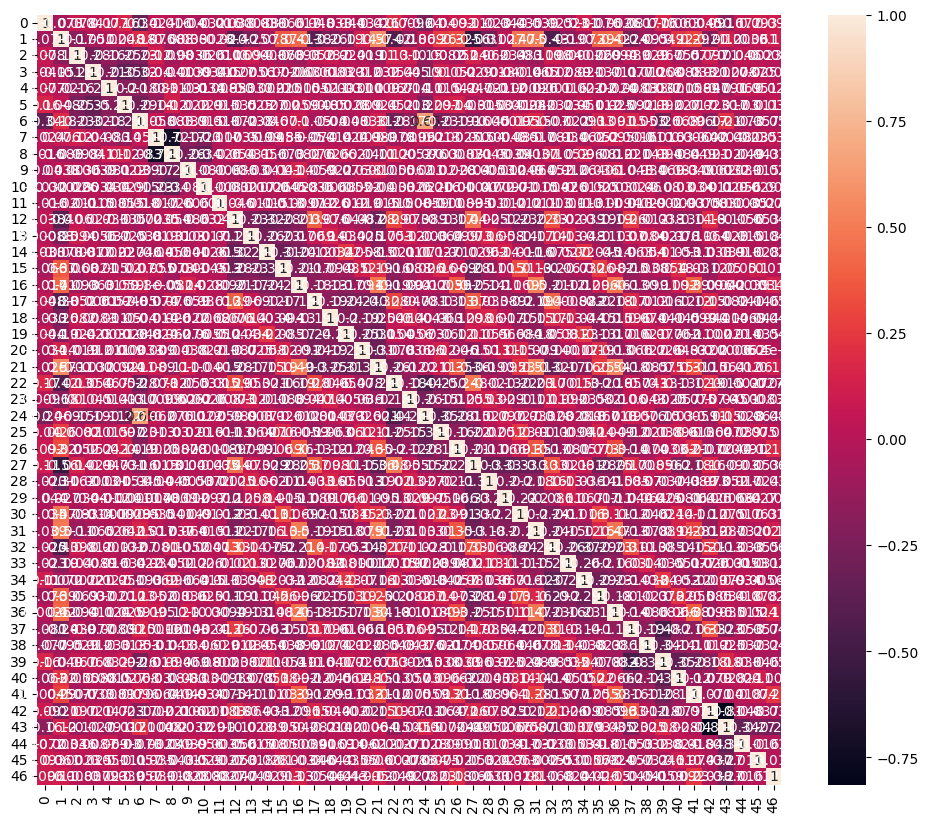

In [13]:
x_train = pd.DataFrame(x_train)
x_test = pd.DataFrame(x_test)

correlation_matrix = pd.DataFrame(x_train).corr()
fig, ax = plt.subplots(figsize=(12,10))
sns.heatmap(correlation_matrix, annot=True ,ax=ax)
correlation_matrix

In [14]:
def correlation(dataset, threshold):
    col_corr = set()  # Set of all the names of correlated columns
    corr_matrix = pd.DataFrame(dataset, columns=col).corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold:  # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr

In [15]:
upper_tri = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape),k=1).astype(bool))
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.7)]
print(to_drop)

x_train = x_train.drop(x_train.columns[to_drop], axis=1)
x_test = x_test.drop(x_test.columns[to_drop], axis=1)

[]


**PCA**

In [16]:
from sklearn.decomposition import PCA

pca = PCA(n_components=0.95)
pca.fit(x_train)
x_train = pca.transform(x_train)
x_test = pca.transform(x_test)

# Developing model

**Devault Model**

In [17]:
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import confusion_matrix, classification_report, mean_squared_error


mlp = MLPClassifier(hidden_layer_sizes=(128,64,32), max_iter=100, activation='relu', solver='adam', random_state=42, learning_rate_init=0.0001, learning_rate='constant')
mlp.fit(x_train, y_train)
predict = mlp.predict(x_test)

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


In [18]:
def plot_cm(matrix, title, directory): 
    ax = plt.subplot()
    sns.heatmap(matrix, annot=True, fmt='g', ax=ax, cmap=sns.cubehelix_palette(as_cmap=True))

    ax.set_title(f'Confusion Matrix\n{title}', pad=10);
    plt.savefig(f'{directory}/Confusion Matrix {title}.jpg', transparent=False, dpi=100,bbox_inches='tight')
    plt.show()

In [19]:
from pandas.plotting import table as pd_table  # Rename the table module to avoid conflicts

def report_maker(model_report, mse, title, directory):
    fig, ax = plt.subplots(figsize=(6, 4))  
    ax.xaxis.set_visible(False)  
    ax.yaxis.set_visible(False)  
    ax.set_frame_on(False)

    red_color = '#ADD8E6'  
    cell_colors = [['#f2f2f2']*len(model_report.columns)]*len(model_report)
    cell_colors[10] = [red_color]*len(model_report.columns)

    tabla = pd_table(ax, model_report, loc='upper right', colWidths=[0.17]*len(model_report.columns), cellColours=cell_colors)  
    tabla.auto_set_font_size(False) 
    tabla.set_fontsize(12) 
    tabla.scale(1.2, 1.2) 

    mse_text = f'Mean Squared Error: {mse:.3f}'
    plt.text(0.5, -0.05, mse_text, ha='center', va='center', transform=ax.transAxes, fontsize=12)

    plt.savefig(f'{directory}/Report {title}.jpg', transparent=False, dpi=150)
    plt.show()

**Best Model**

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


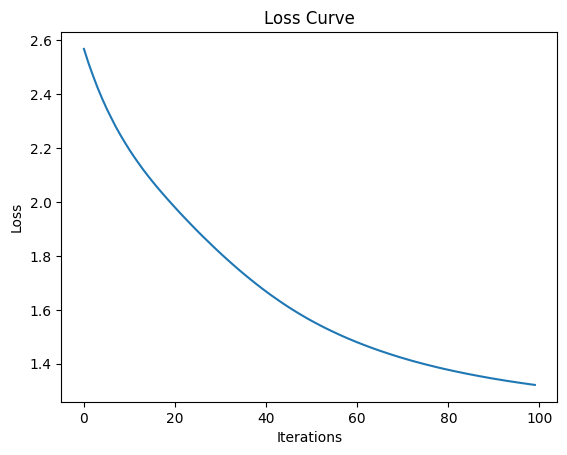

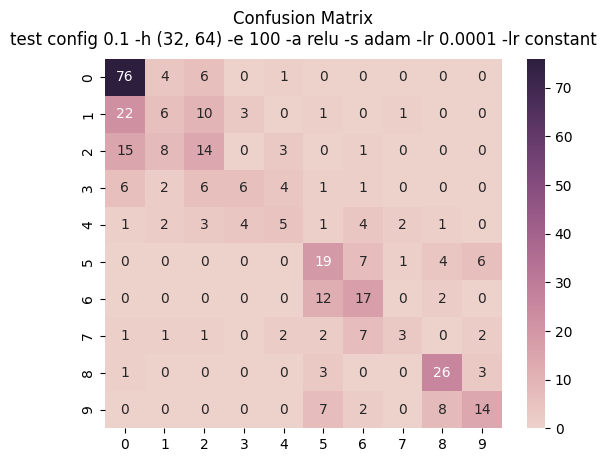

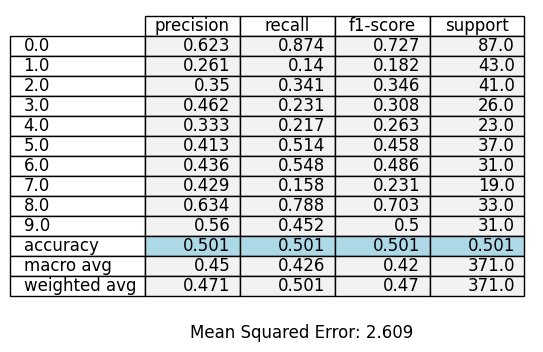

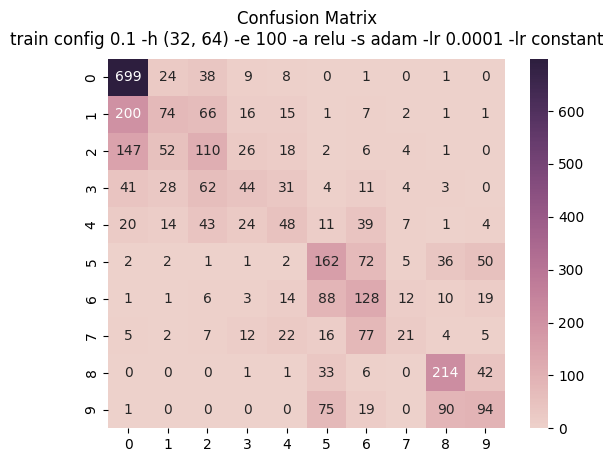

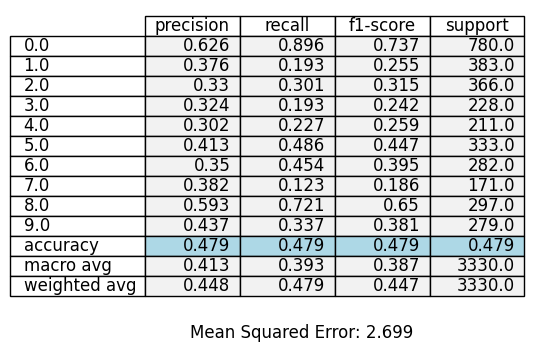

In [20]:
# split configuration
i = 0.1
x_train, x_test, y_train, y_test = train_test_split(features, label, test_size=i, random_state=42, stratify=label)

scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_test = scaler.transform(x_test)

x_train = pd.DataFrame(x_train)
x_test = pd.DataFrame(x_test)

correlation_matrix = pd.DataFrame(x_train).corr()

upper_tri = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape),k=1).astype(bool))
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.7)]

x_train = x_train.drop(x_train.columns[to_drop], axis=1)
x_test = x_test.drop(x_test.columns[to_drop], axis=1)

pca = PCA(n_components=0.95)
pca.fit(x_train)
x_train = pca.transform(x_train)
x_test = pca.transform(x_test)

# model
hidden_layer = (32,64)
max_iter = 100
activation = 'relu'
solver = 'adam'
random_state = 42
learning_rate_init = 0.0001
learning_rate = 'constant'
mlp = MLPClassifier(hidden_layer_sizes=hidden_layer, max_iter=max_iter, activation=activation, solver=solver, random_state=random_state, learning_rate_init=learning_rate_init, learning_rate=learning_rate)
mlp.fit(x_train, y_train)

accuracy = mlp.score(x_test, y_test)

plt.plot(mlp.loss_curve_)
plt.title('Loss Curve')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.show()

# confusion matrix
predict = mlp.predict(x_test)
confussion_matrix = confusion_matrix(y_test, predict)
plot_cm(confussion_matrix, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', 'best-model')

model1_report = classification_report(y_test, predict, output_dict=True)
report1 = pd.DataFrame(model1_report).transpose()
report1 = report1.round(3)
mse_value1 = mean_squared_error(y_test, predict)
report_maker(report1, mse_value1, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', 'best-model')


predict = mlp.predict(x_train)
confusion_matrix_result = confusion_matrix(y_train, predict)
plot_cm(confusion_matrix_result, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', 'best-model')

model_report = classification_report(y_train, predict, output_dict=True)
report = pd.DataFrame(model_report).transpose()
report = report.round(3)
mse_value = mean_squared_error(y_train, predict)
report_maker(report, mse_value, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', 'best-model')

# Split Configuration

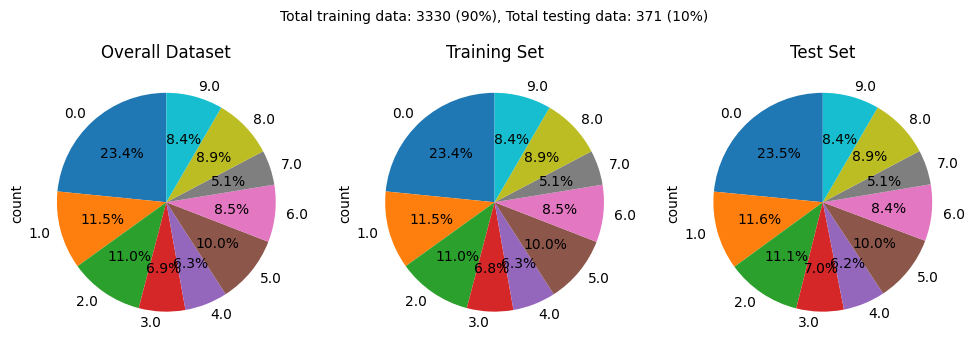

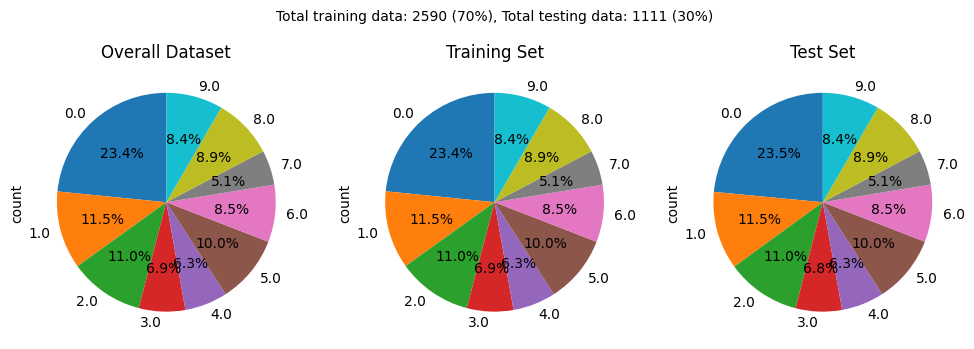

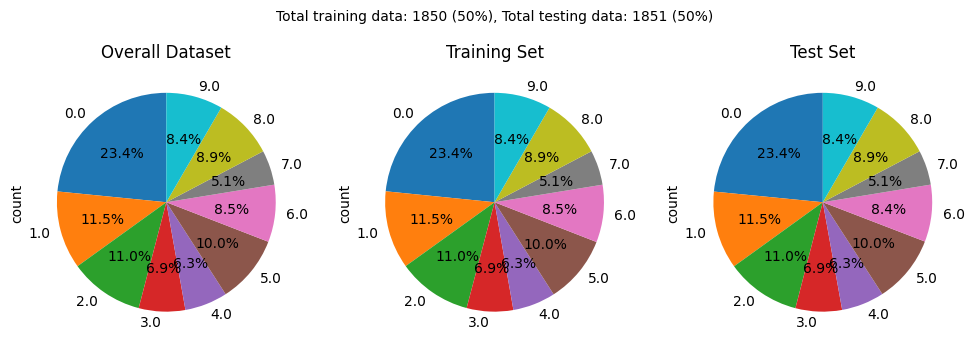

In [25]:
config = [0.1, 0.3, 0.5]

for i in config:
    x_train, x_test, y_train, y_test = train_test_split(features, label, test_size=i, random_state=42, stratify=label)
    s_train = pd.DataFrame(y_train, columns=['Satisfaction'])
    s_test = pd.DataFrame(y_test, columns=['Satisfaction'])
    total = s_train.shape[0] + s_test.shape[0]

    sorted_train = s_train['Satisfaction'].value_counts().sort_index()
    sorted_test = s_test['Satisfaction'].value_counts().sort_index()
    sorted_data = data['Satisfaction'].value_counts().sort_index()


    plt.figure(figsize=(12, 5))

    plt.subplot(1, 3, 2)
    plt.title('Training Set')
    plt.text(0, 1.7, f'Total training data: {s_train.shape[0]} ({round(s_train.shape[0]/total * 100)}%), Total testing data: {s_test.shape[0]} ({round(s_test.shape[0]/total * 100)}%)', horizontalalignment='center', verticalalignment='center')
    sorted_train.plot.pie(autopct='%1.1f%%', startangle=90)

    plt.subplot(1, 3, 3)
    plt.title('Test Set')
    sorted_test.plot.pie(autopct='%1.1f%%', startangle=90)

    plt.subplot(1, 3, 1)
    plt.title('Overall Dataset')
    sorted_data.plot.pie(autopct='%1.1f%%', startangle=90)

    plt.show()

# Experiment

In [ ]:
import os

main_dir = os.getcwd()
cm_dir = os.path.join(main_dir, 'confusion-matrix-jpeg')
report_dir = os.path.join(main_dir, 'report-jpeg')

### Epochs

In [ ]:
epoch_dir = 'epoch'

cm_epoch_dir = os.path.join(cm_dir, epoch_dir)
if not os.path.exists(cm_epoch_dir):
    os.makedirs(cm_epoch_dir)

report_epoch_dir = os.path.join(report_dir, epoch_dir)
if not os.path.exists(report_epoch_dir):
    os.makedirs(report_epoch_dir)

cmdir = os.path.relpath(cm_epoch_dir, start=main_dir)
cmdir = cmdir.replace(os.path.sep, '/')

rpdir = os.path.relpath(report_epoch_dir, start=main_dir)
rpdir = rpdir.replace(os.path.sep, '/')
    

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (10) reached and the optimization hasn't converged yet.
  warnings.warn(


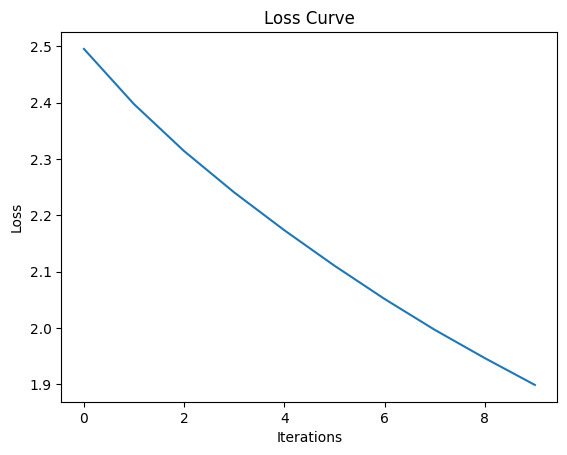

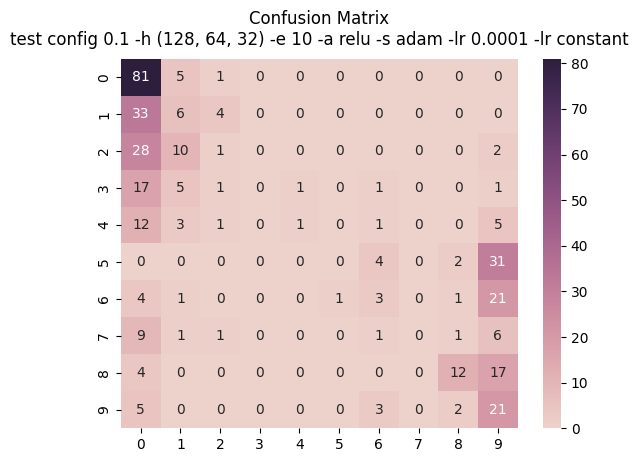

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


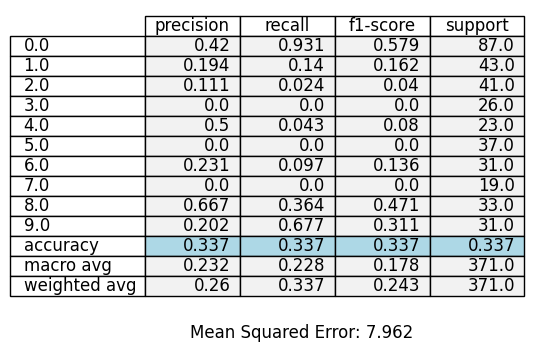

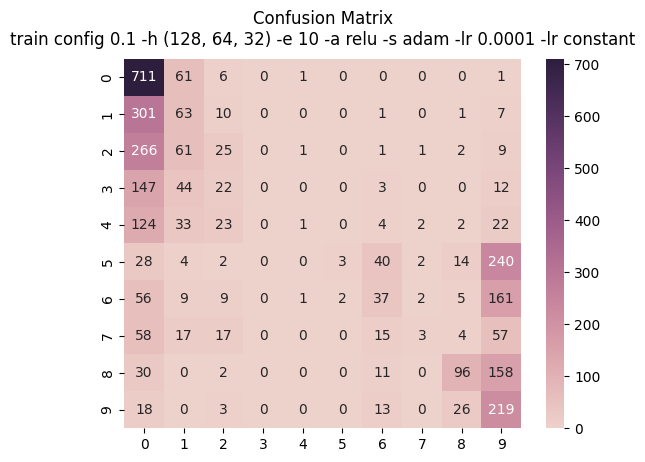

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


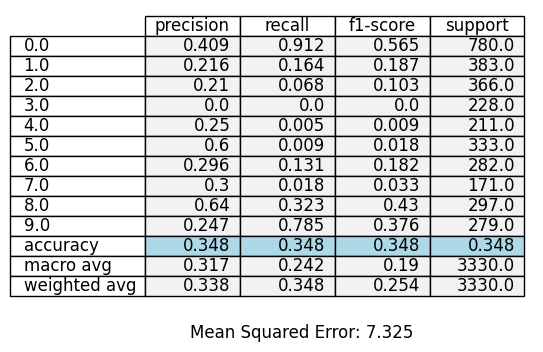

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  warnings.warn(


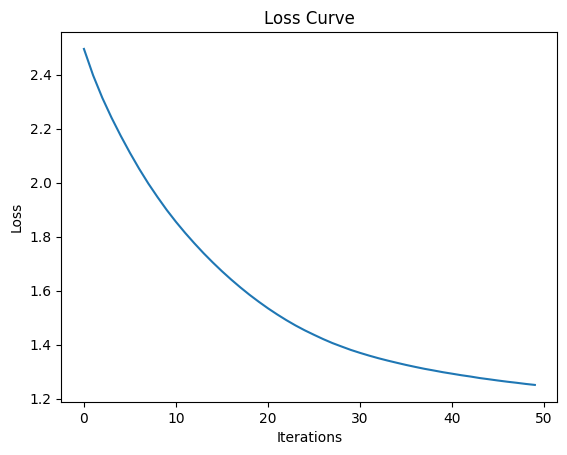

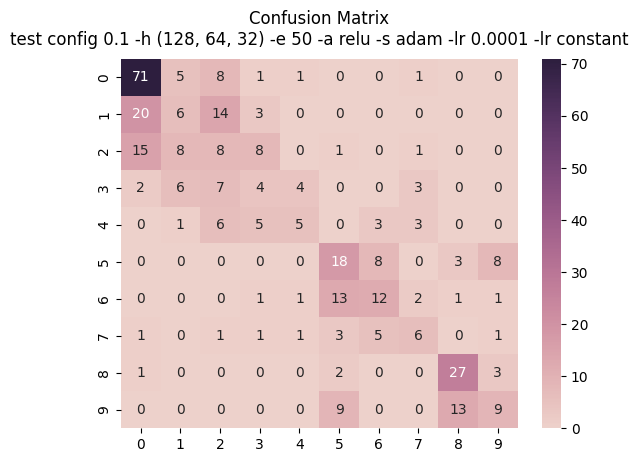

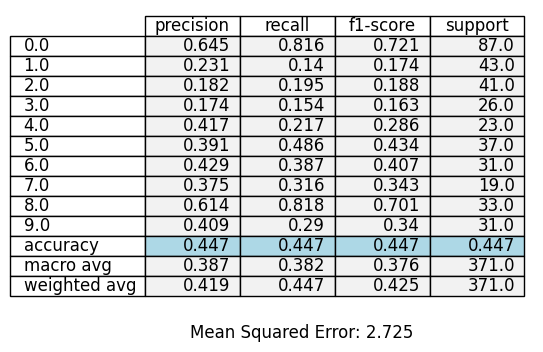

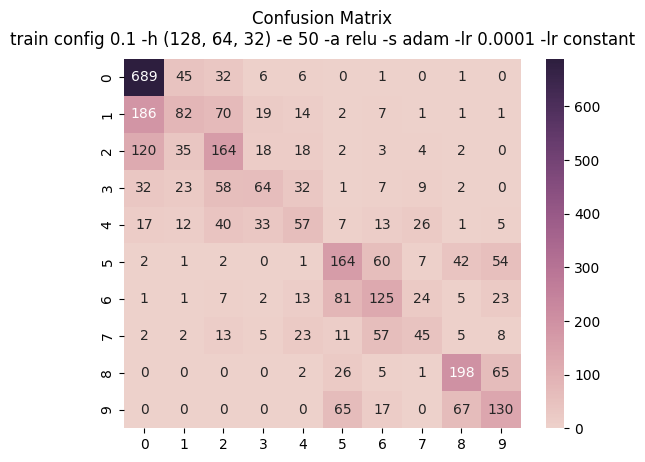

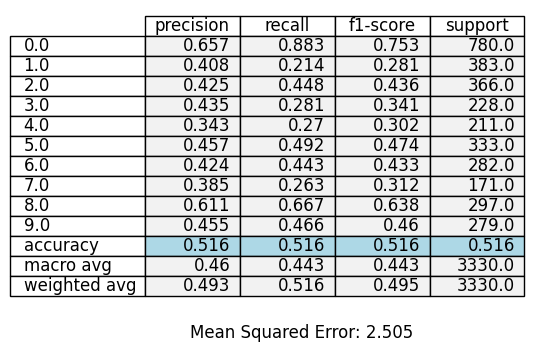

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


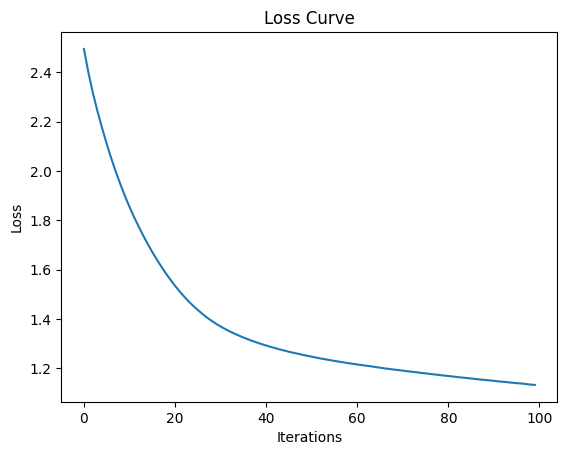

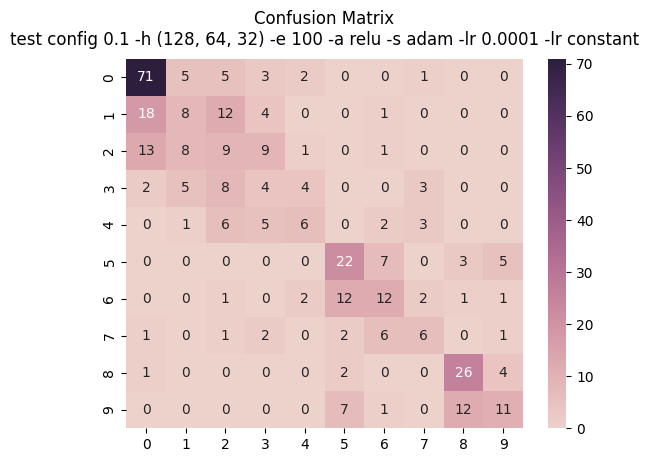

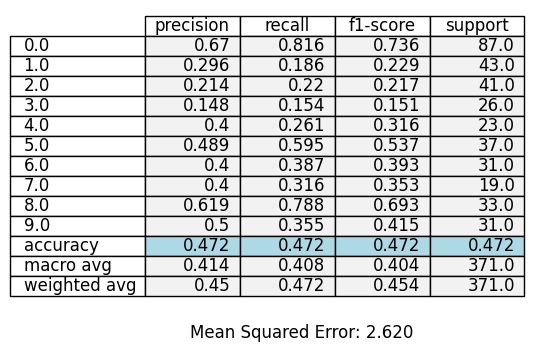

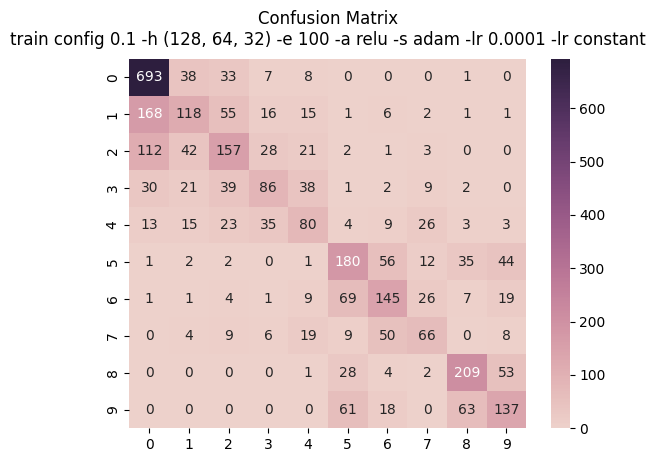

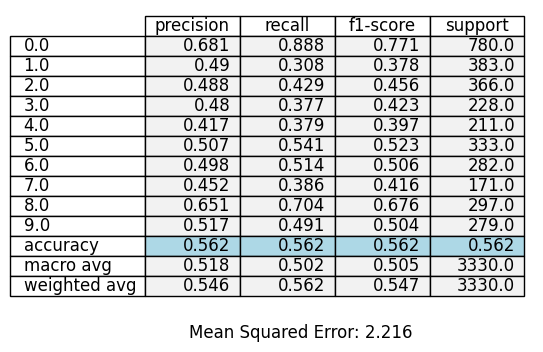

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


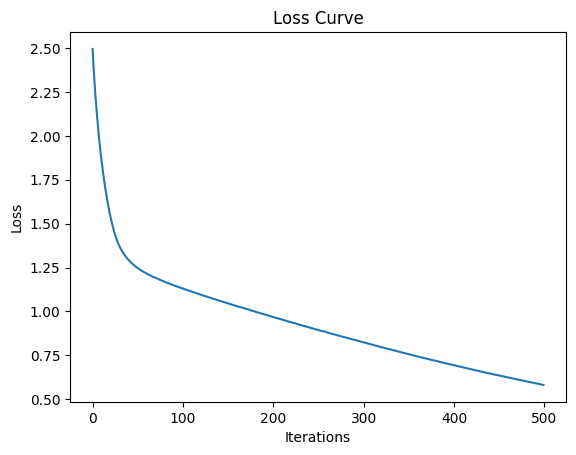

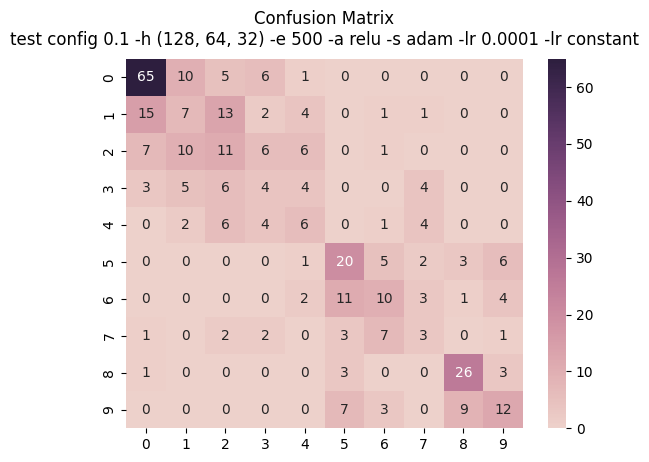

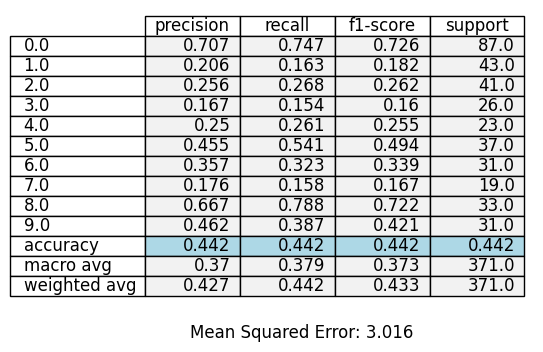

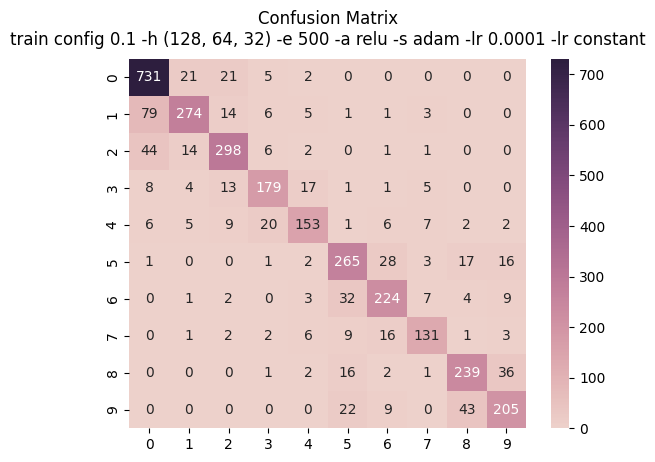

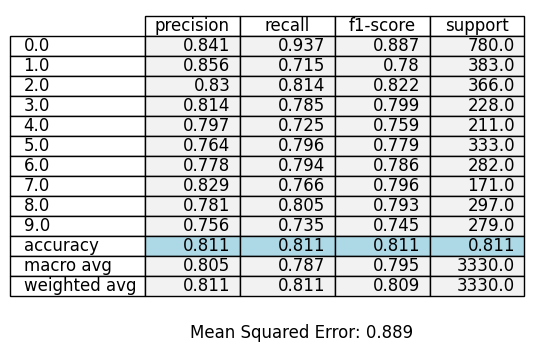

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


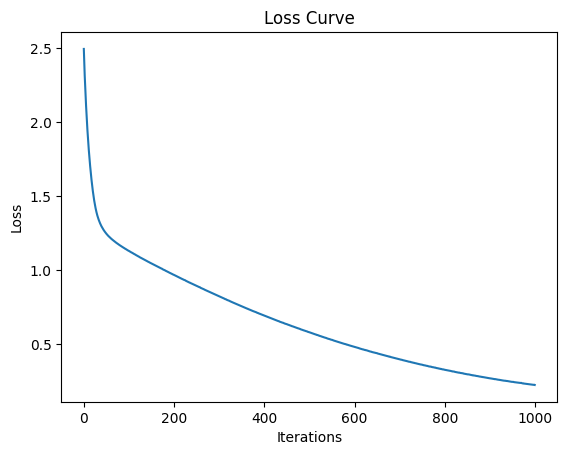

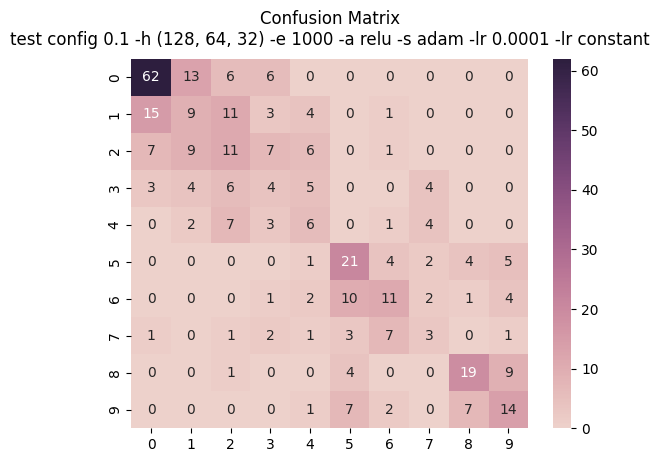

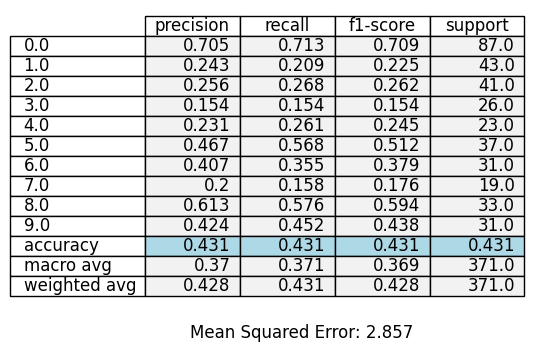

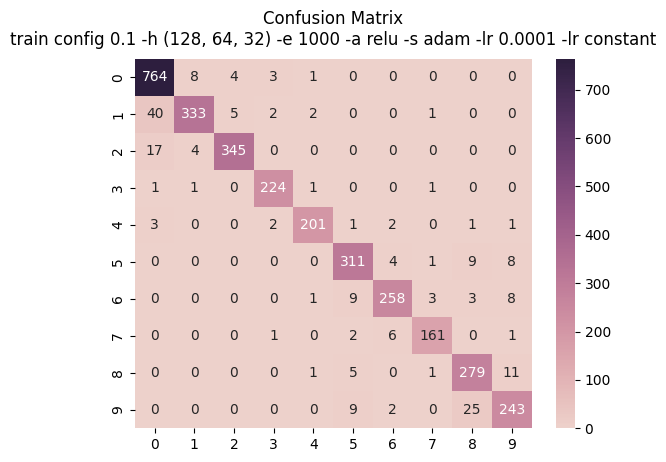

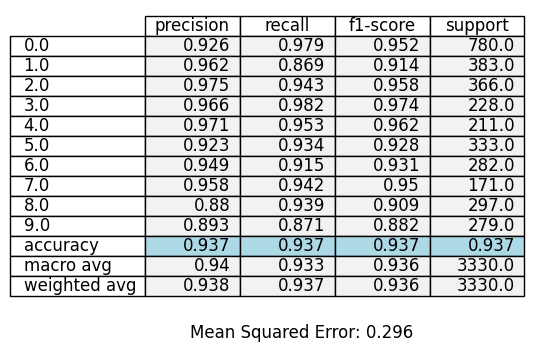

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (10) reached and the optimization hasn't converged yet.
  warnings.warn(


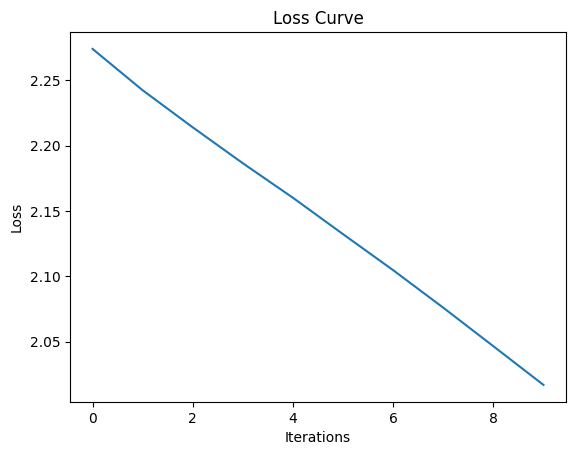

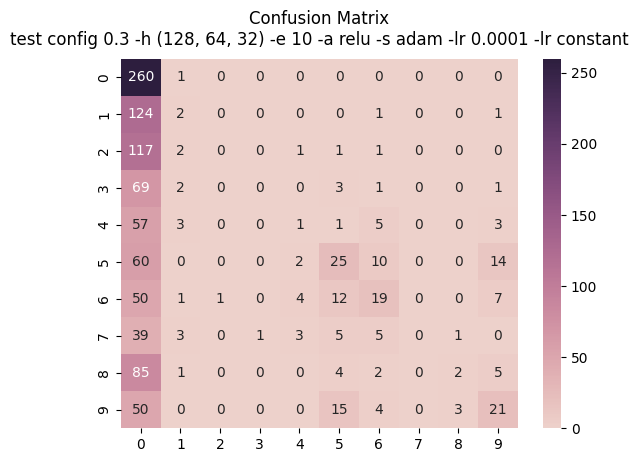

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


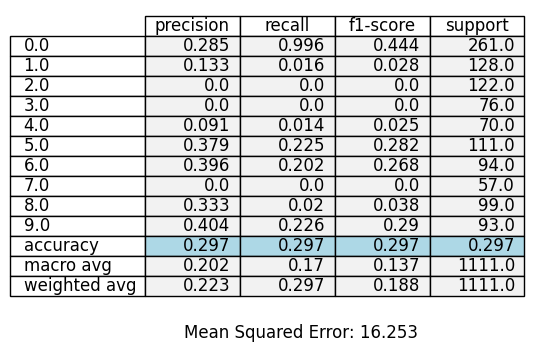

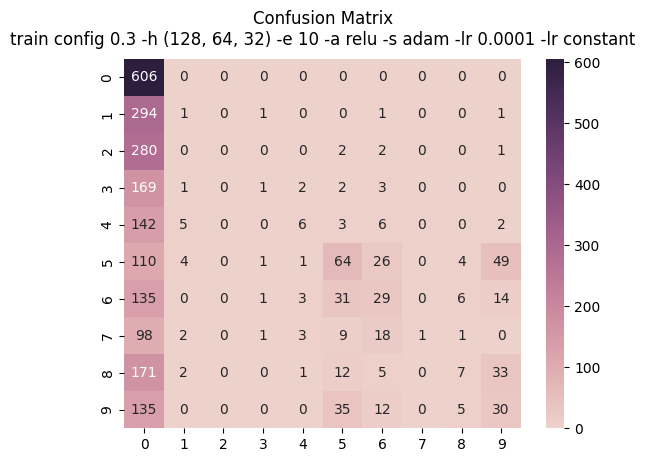

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


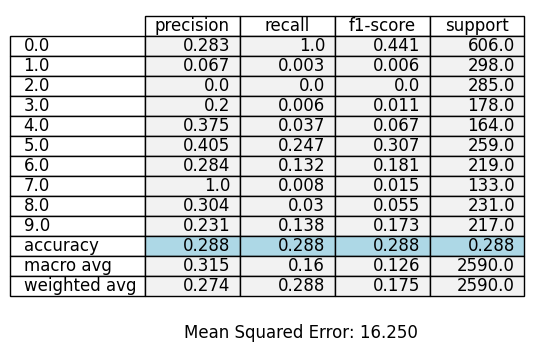

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  warnings.warn(


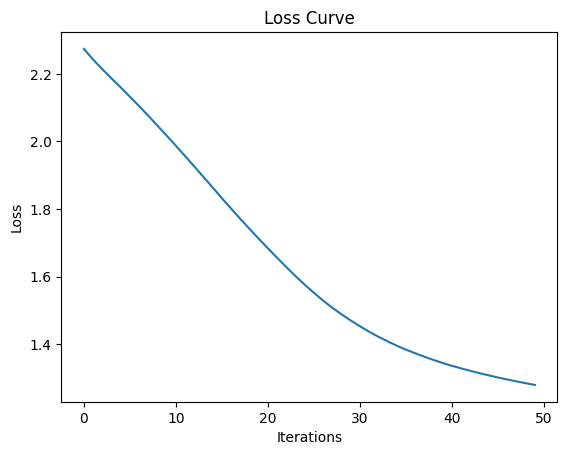

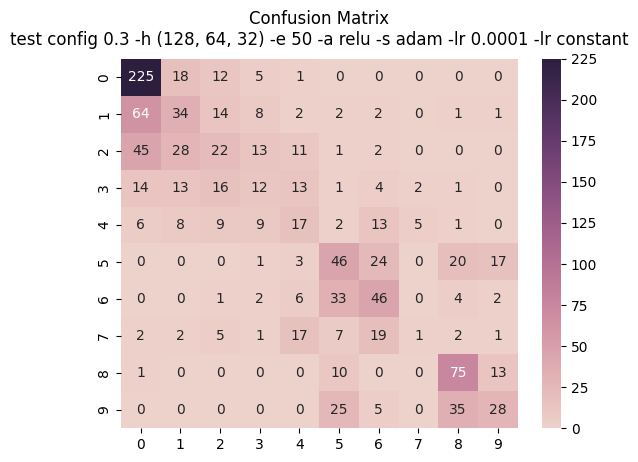

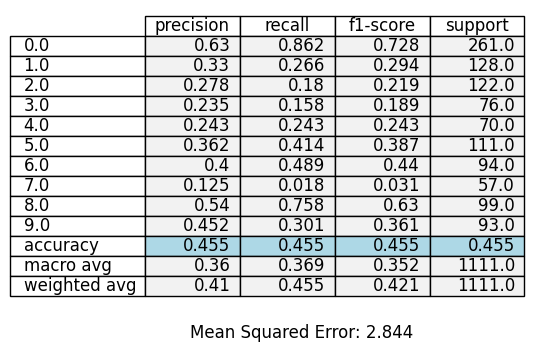

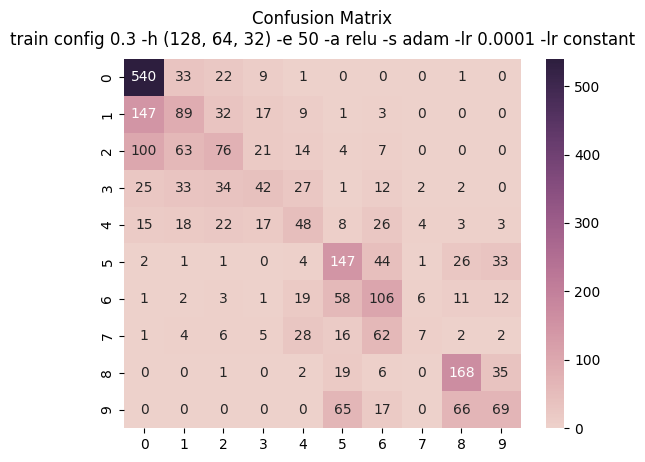

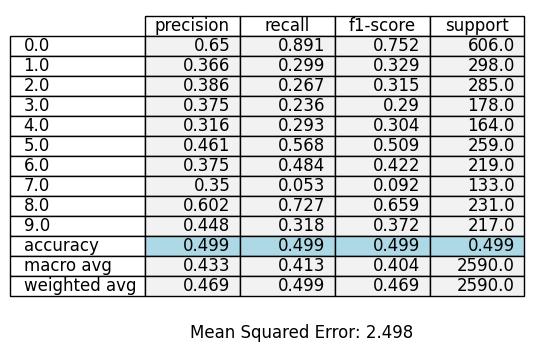

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


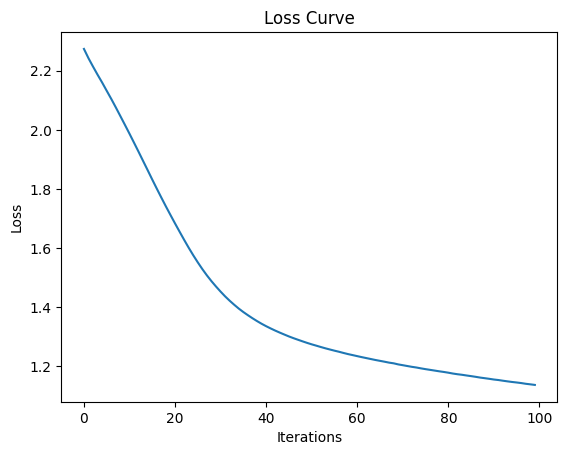

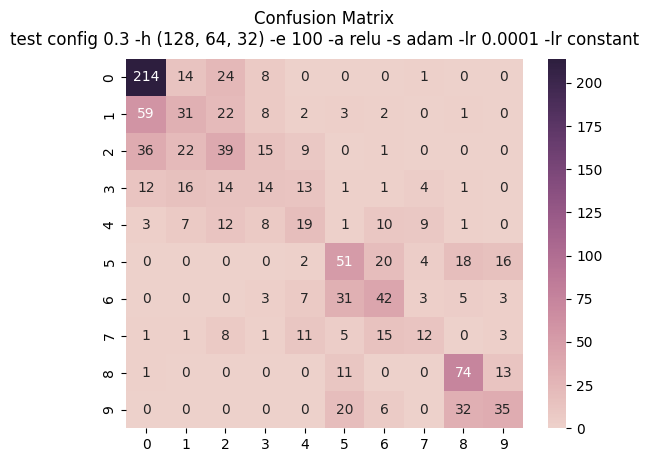

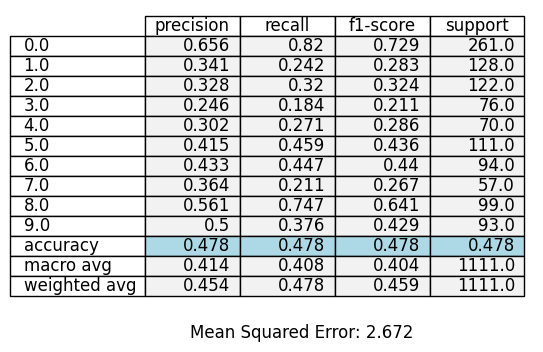

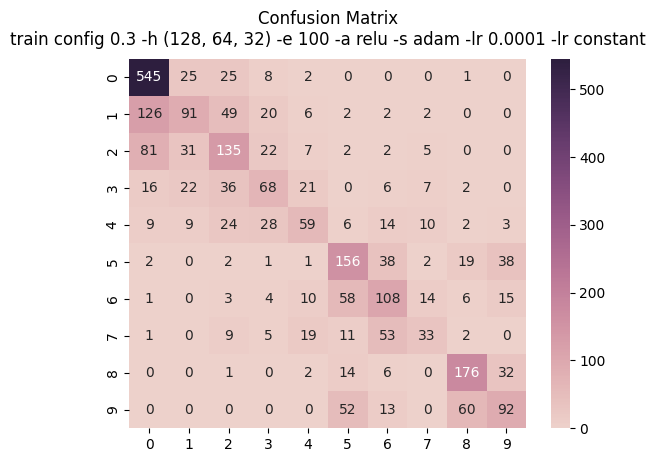

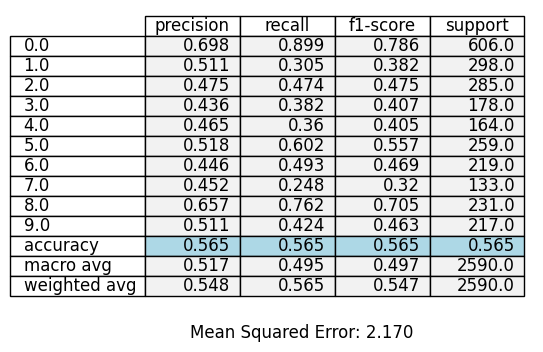

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:693: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


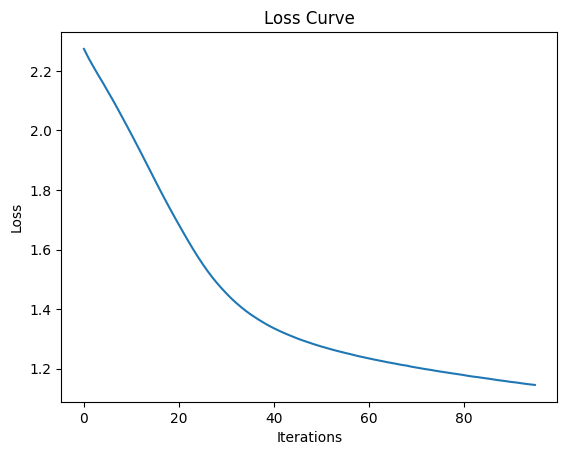

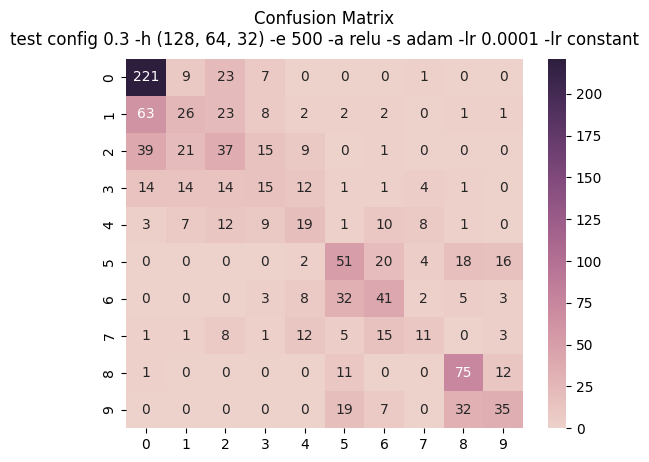

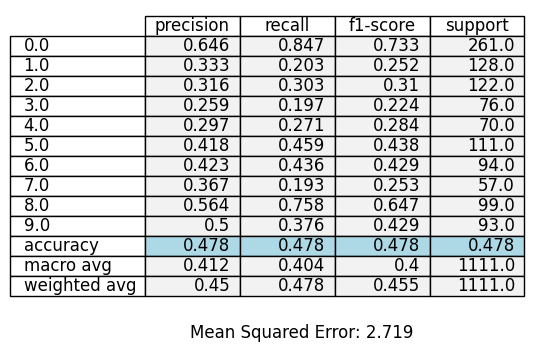

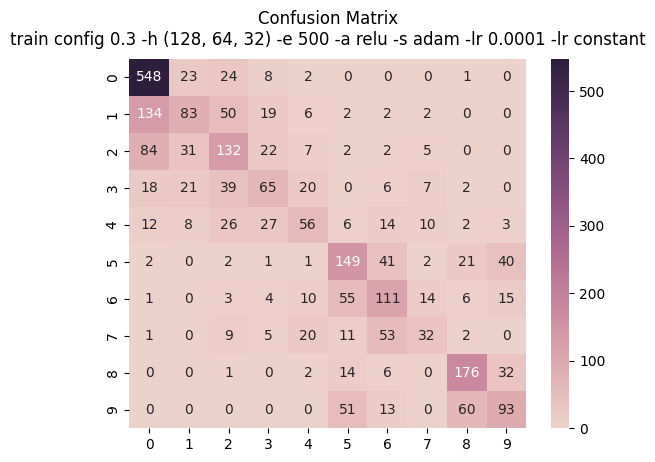

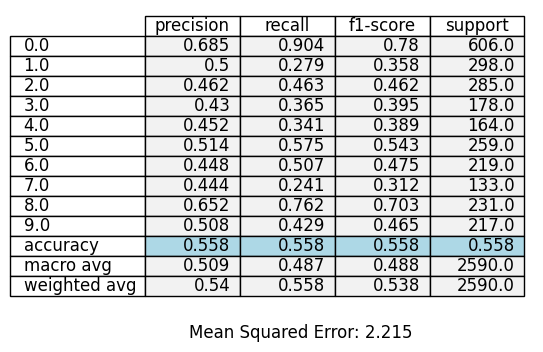

In [ ]:
best_accuracy = 0
best_config = None

config = [0.1, 0.3, 0.5]
epoch = [10, 50, 100, 500, 1000]

for i in config:
    x_train, x_test, y_train, y_test = train_test_split(features, label, test_size=i, random_state=42, stratify=label)

    scaler = StandardScaler()
    x_train = scaler.fit_transform(x_train)
    x_test = scaler.transform(x_test)

    x_train = pd.DataFrame(x_train)
    x_test = pd.DataFrame(x_test)

    correlation_matrix = pd.DataFrame(x_train).corr()

    upper_tri = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape),k=1).astype(bool))
    to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.9)]

    x_train = x_train.drop(x_train.columns[to_drop], axis=1)
    x_test = x_test.drop(x_test.columns[to_drop], axis=1)

    pca = PCA(n_components=0.95)
    pca.fit(x_train)
    x_train = pca.transform(x_train)
    x_test = pca.transform(x_test)

    for j in epoch:
        #! edit mulai disini
        hidden_layer = (128,64,32)
        max_iter = j
        activation = 'relu'
        solver = 'adam'
        random_state = 42
        learning_rate_init = 0.0001
        learning_rate = 'constant'
        mlp = MLPClassifier(hidden_layer_sizes=hidden_layer, max_iter=max_iter, activation=activation, solver=solver, random_state=random_state, learning_rate_init=learning_rate_init, learning_rate=learning_rate)
        mlp.fit(x_train, y_train)

        accuracy = mlp.score(x_test, y_test)

        # Check if the current accuracy is the best
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_config = {
                'config': i,
                'epoch': j,
                'hidden_layer': hidden_layer,
                'activation': activation,
                'solver': solver,
                'learning_rate_init': learning_rate_init,
                'learning_rate': learning_rate
            }
        #! sampe sini

        plt.plot(mlp.loss_curve_)
        plt.title('Loss Curve')
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.show()

        predict = mlp.predict(x_test)
        confussion_matrix = confusion_matrix(y_test, predict)
        plot_cm(confussion_matrix, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model1_report = classification_report(y_test, predict, output_dict=True)
        report1 = pd.DataFrame(model1_report).transpose()
        report1 = report1.round(3)
        mse_value1 = mean_squared_error(y_test, predict)
        report_maker(report1, mse_value1, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)


        predict = mlp.predict(x_train)
        confusion_matrix_result = confusion_matrix(y_train, predict)
        plot_cm(confusion_matrix_result, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model_report = classification_report(y_train, predict, output_dict=True)
        report = pd.DataFrame(model_report).transpose()
        report = report.round(3)
        mse_value = mean_squared_error(y_train, predict)
        report_maker(report, mse_value, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)

In [ ]:
best_accuracy, best_config

(0.47794779477947796,
 {'config': 0.3,
  'epoch': 100,
  'hidden_layer': (128, 64, 32),
  'activation': 'relu',
  'solver': 'adam',
  'learning_rate_init': 0.0001,
  'learning_rate': 'constant'})

### Learning Rate

In [ ]:
epoch_dir = 'learning-rate'

cm_epoch_dir = os.path.join(cm_dir, epoch_dir)
if not os.path.exists(cm_epoch_dir):
    os.makedirs(cm_epoch_dir)

report_epoch_dir = os.path.join(report_dir, epoch_dir)
if not os.path.exists(report_epoch_dir):
    os.makedirs(report_epoch_dir)

cmdir = os.path.relpath(cm_epoch_dir, start=main_dir)
cmdir = cmdir.replace(os.path.sep, '/')

rpdir = os.path.relpath(report_epoch_dir, start=main_dir)
rpdir = rpdir.replace(os.path.sep, '/')
    

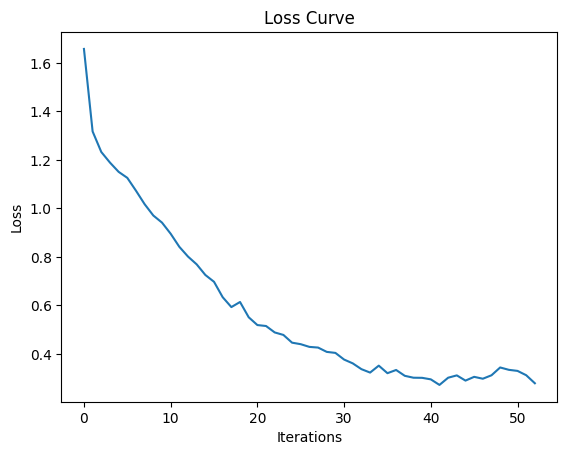

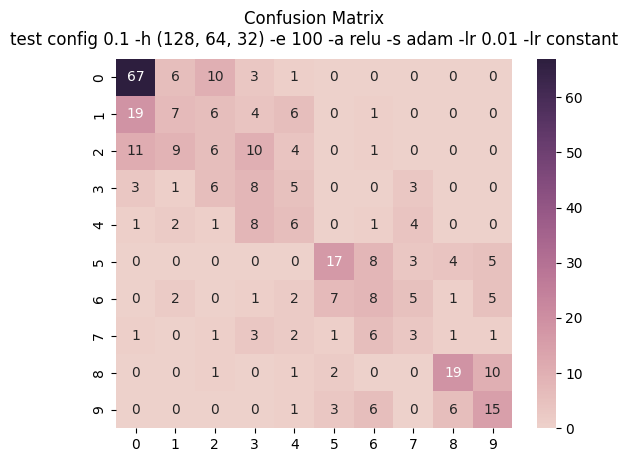

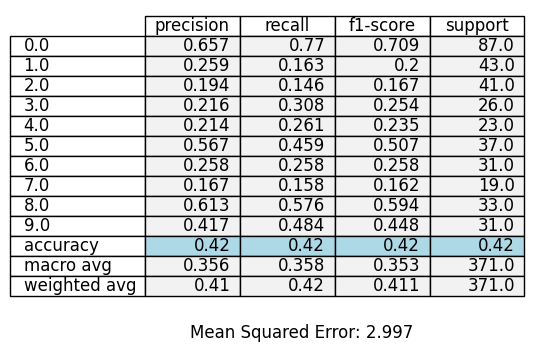

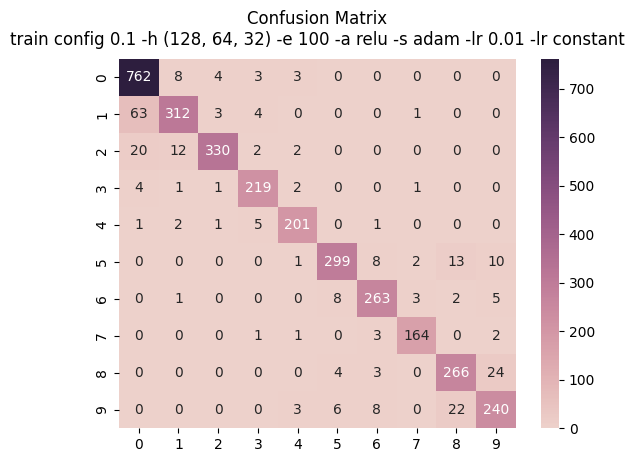

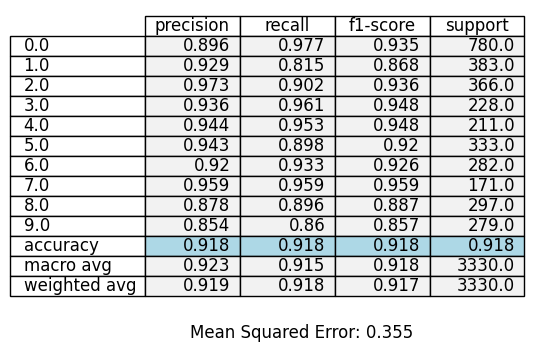

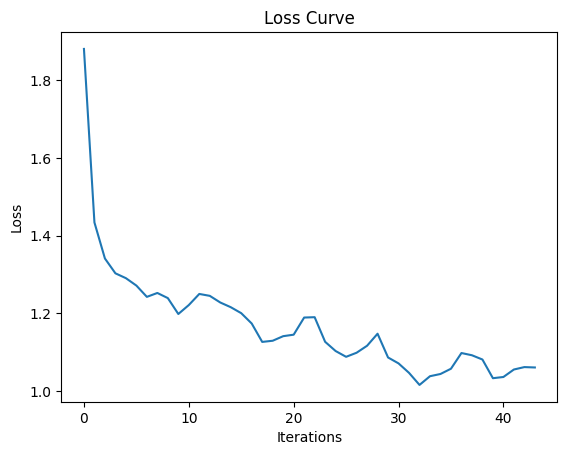

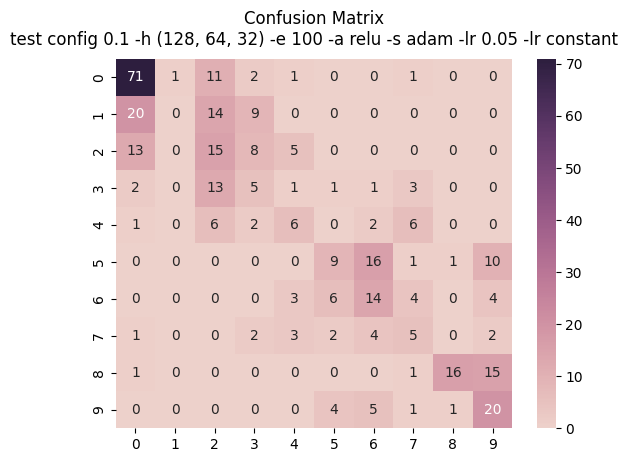

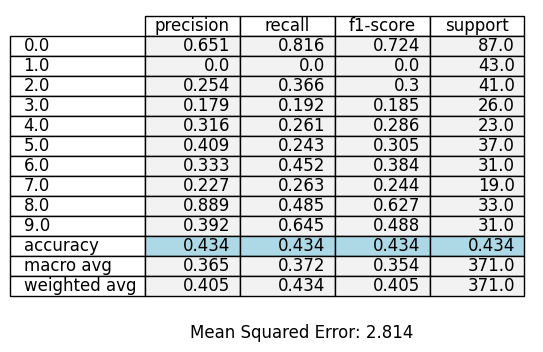

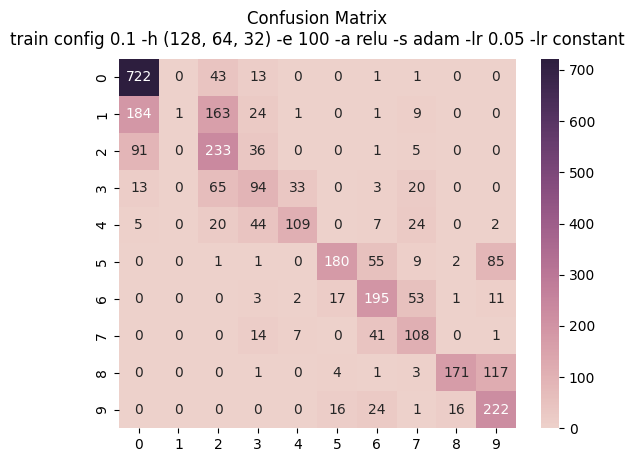

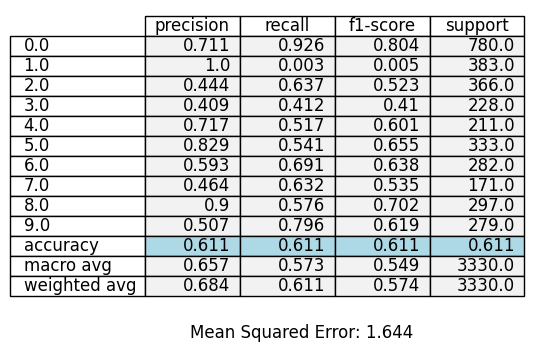

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


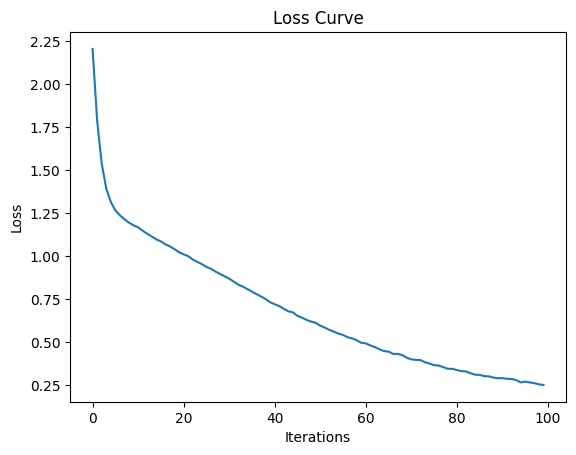

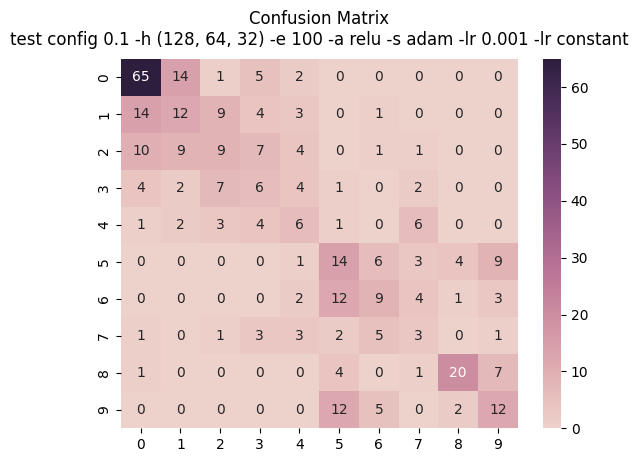

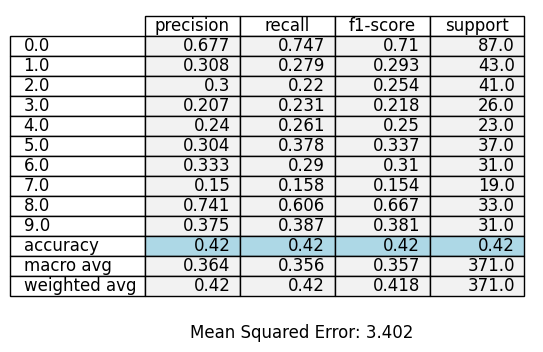

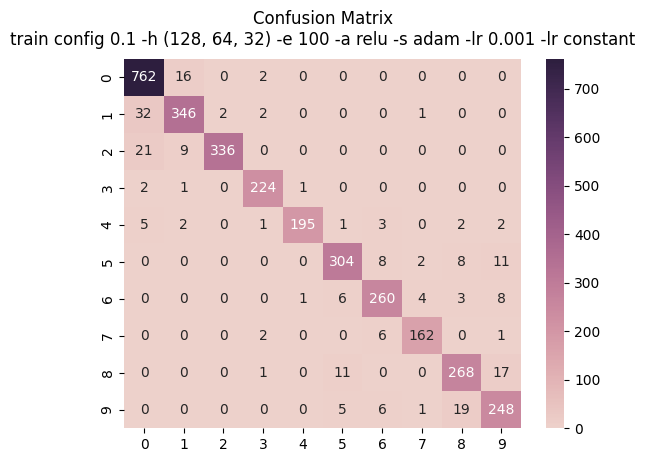

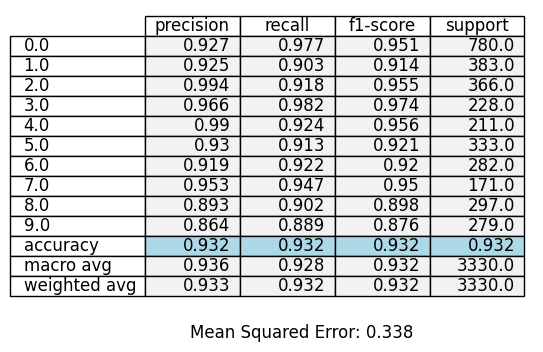

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


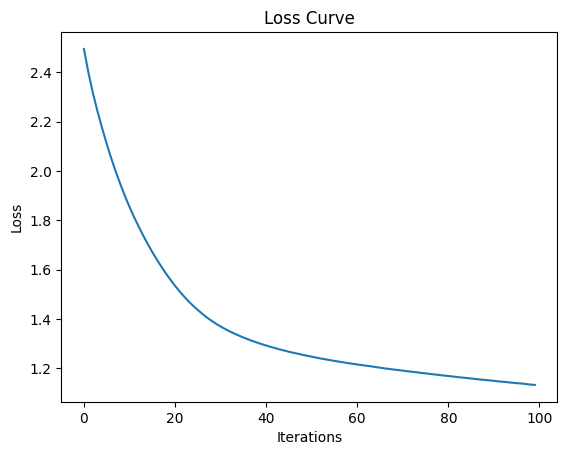

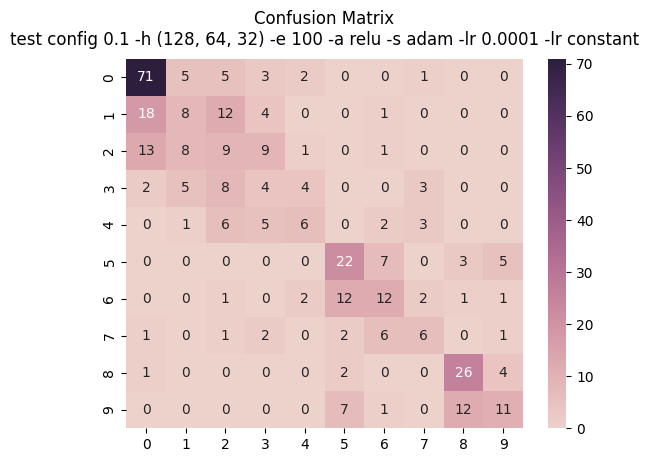

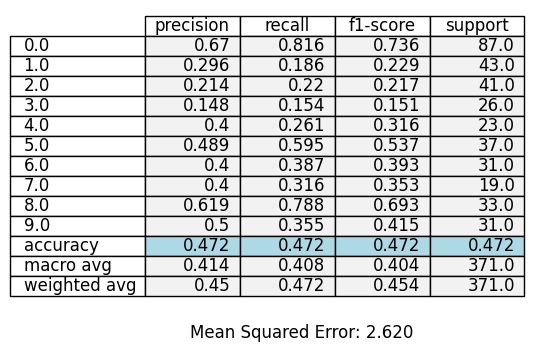

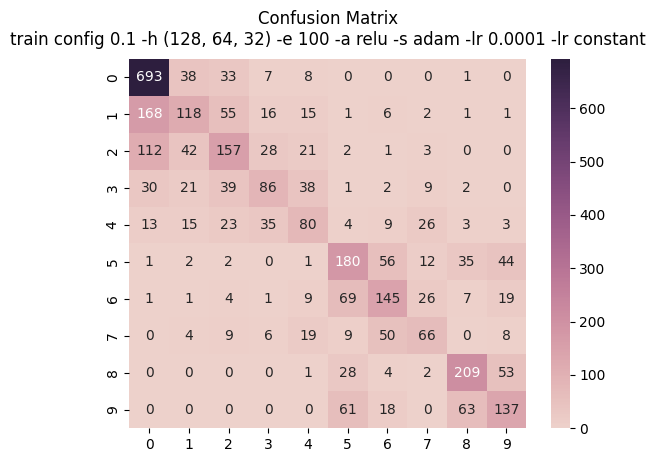

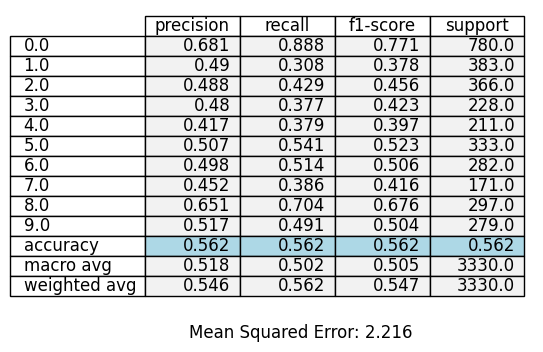

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


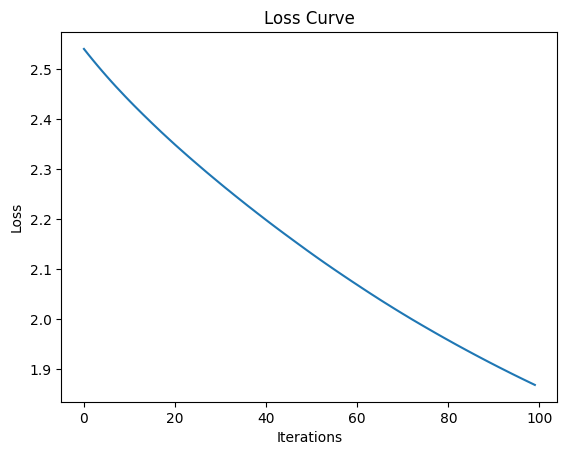

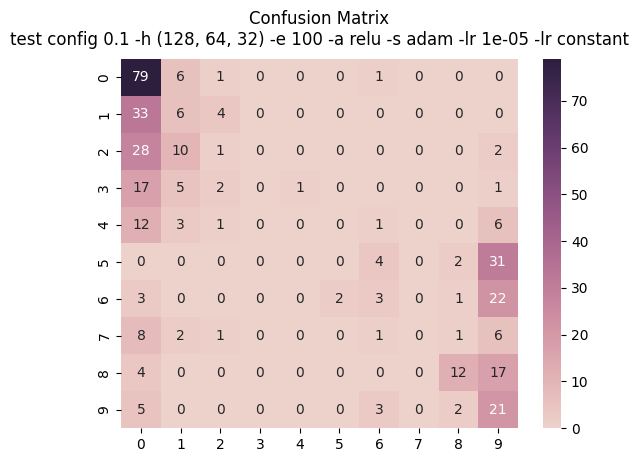

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


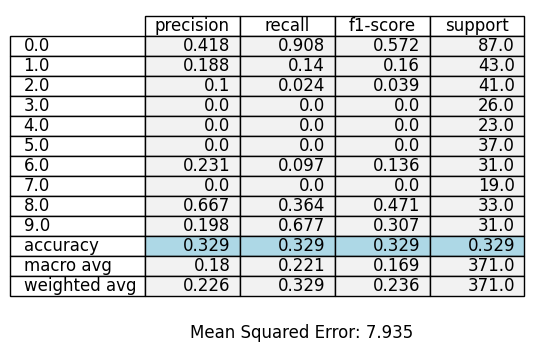

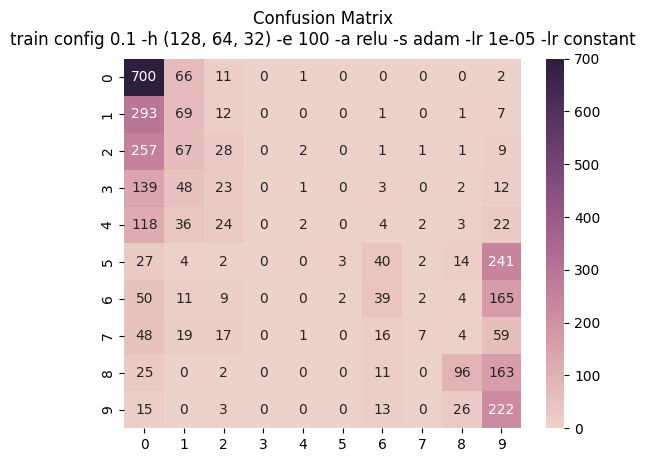

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


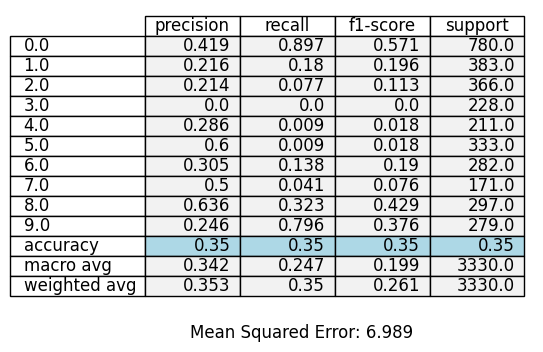

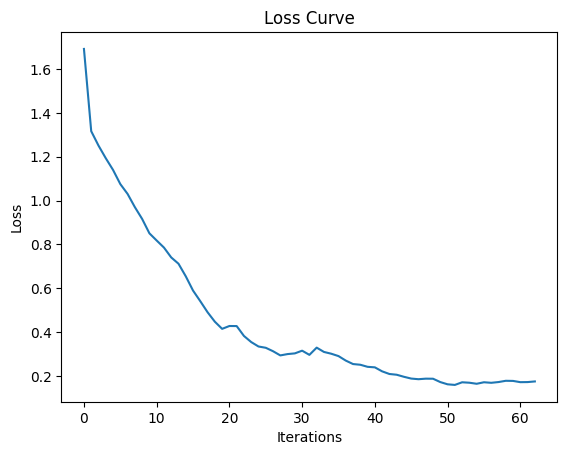

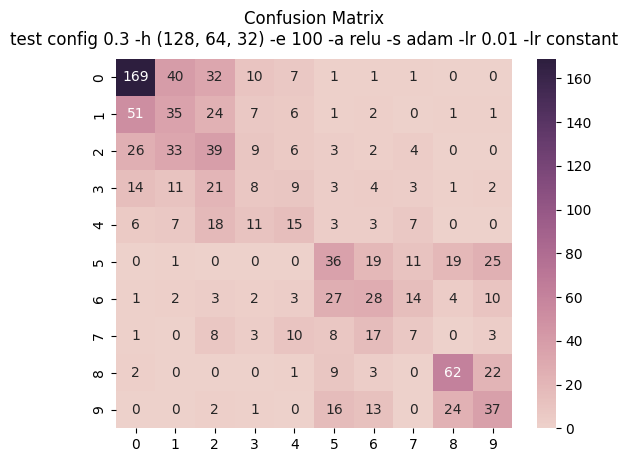

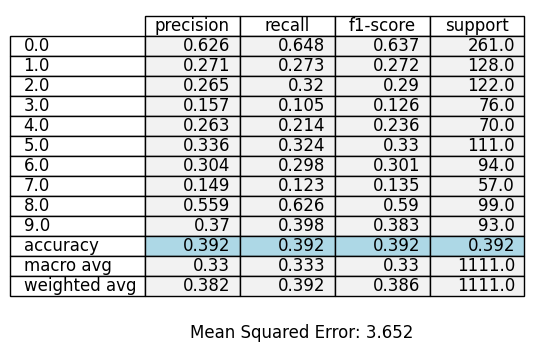

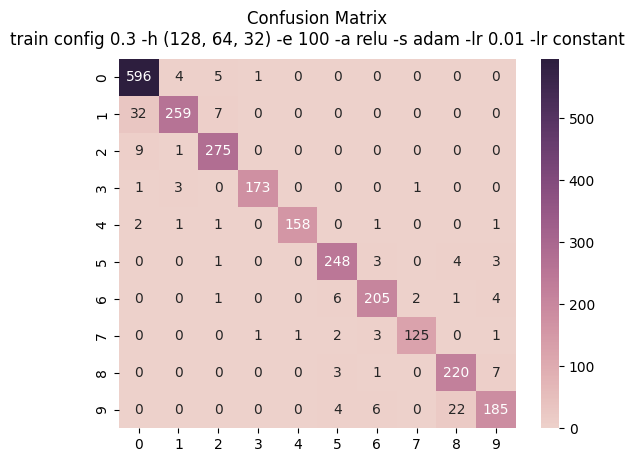

...

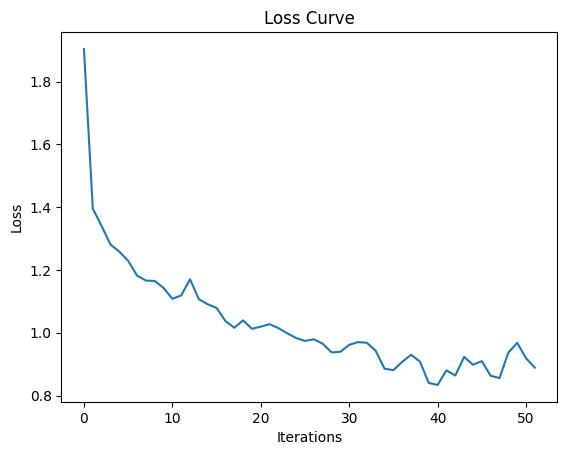

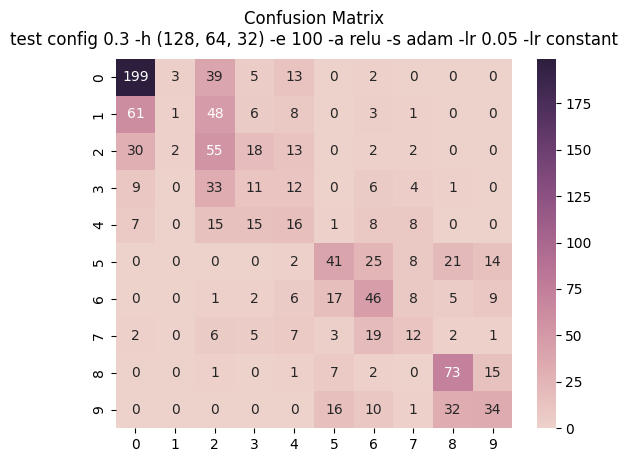

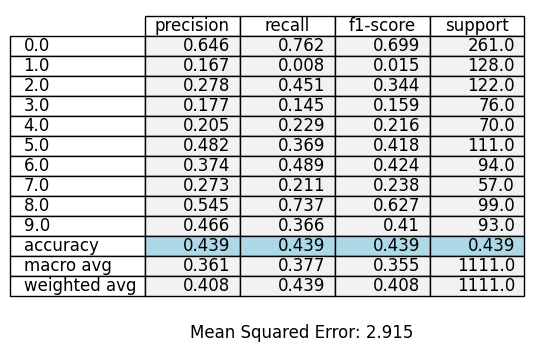

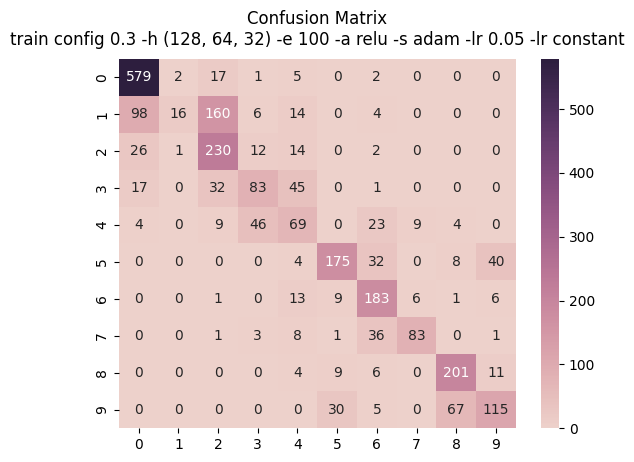

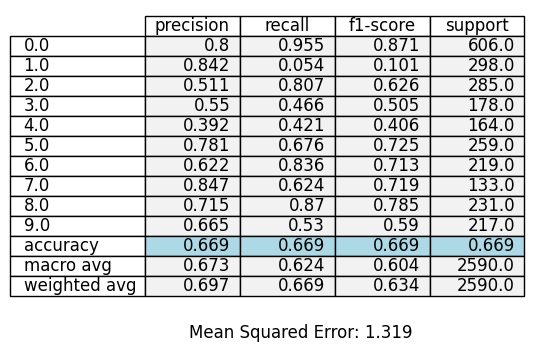

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


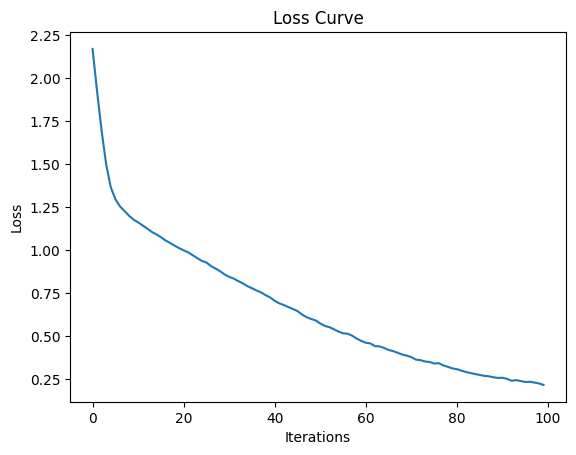

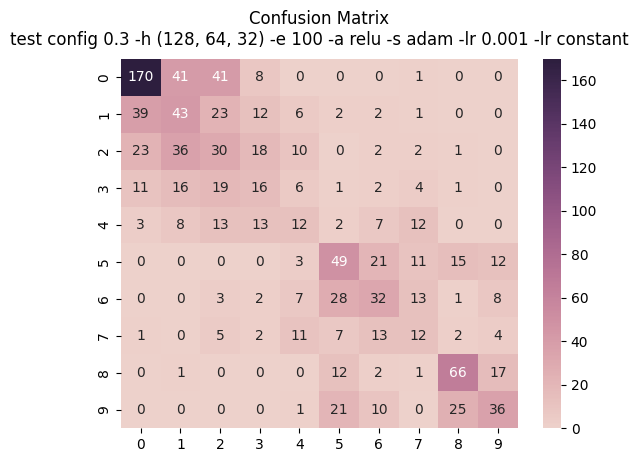

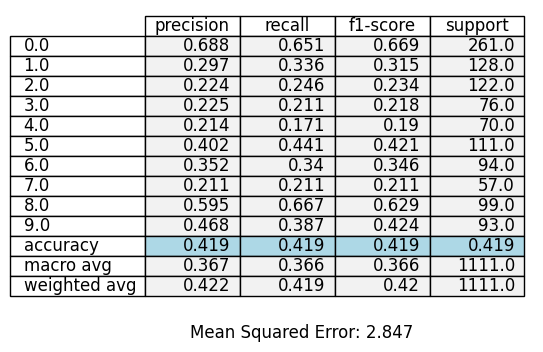

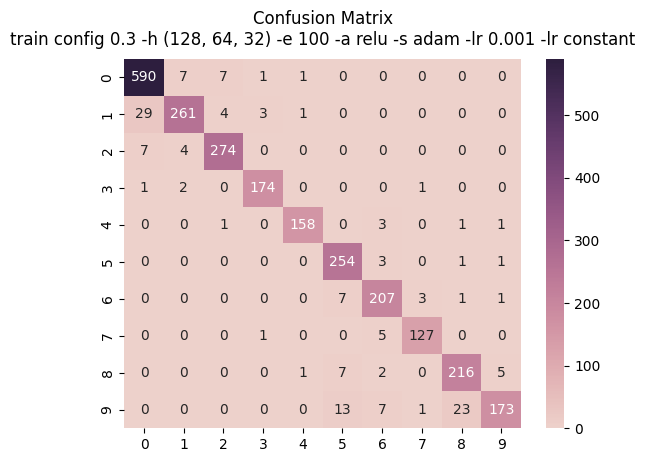

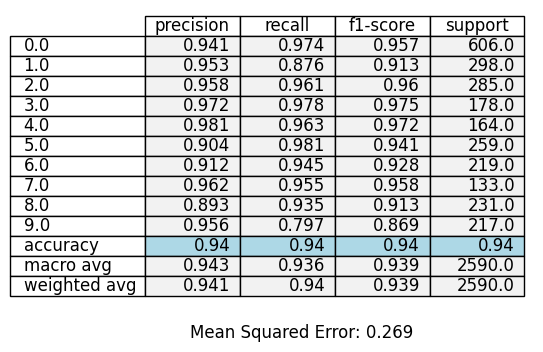

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


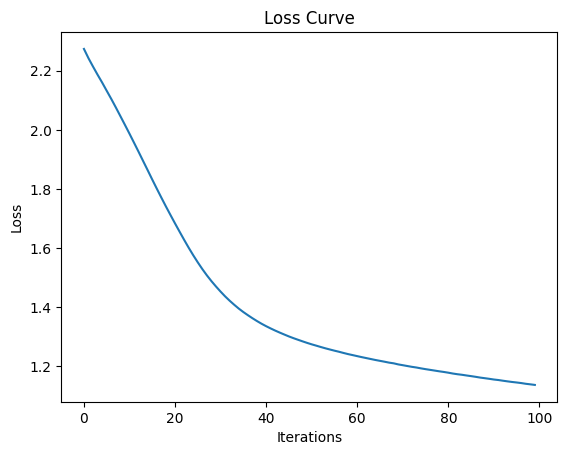

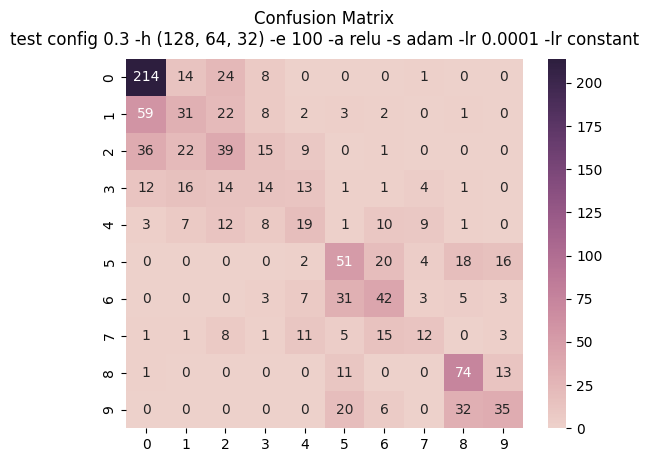

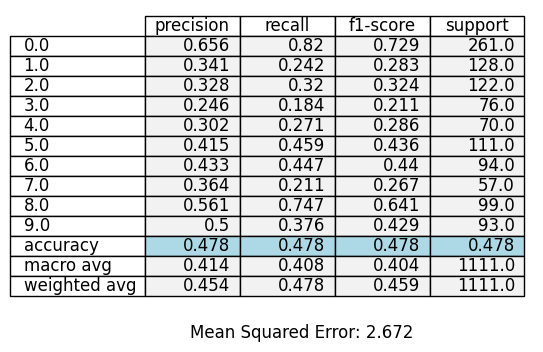

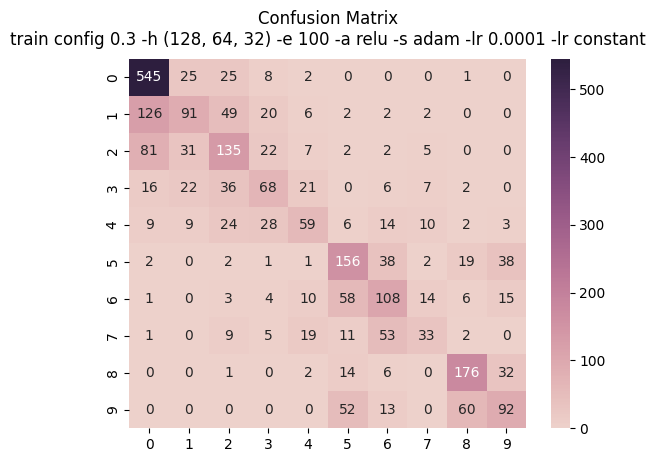

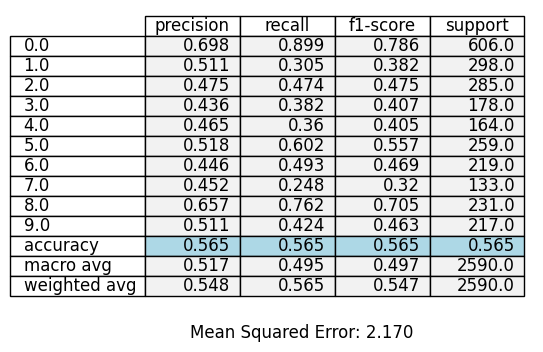

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


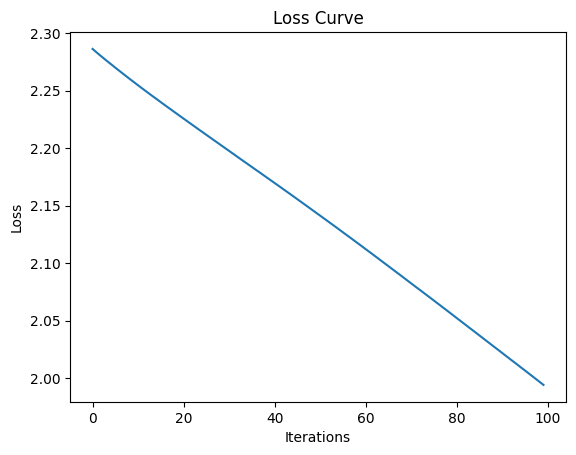

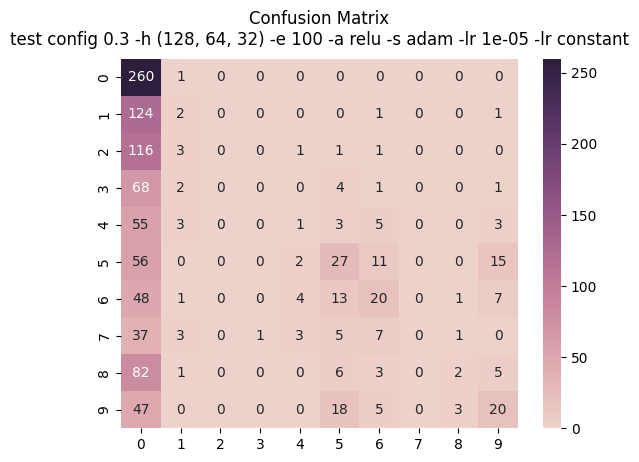

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


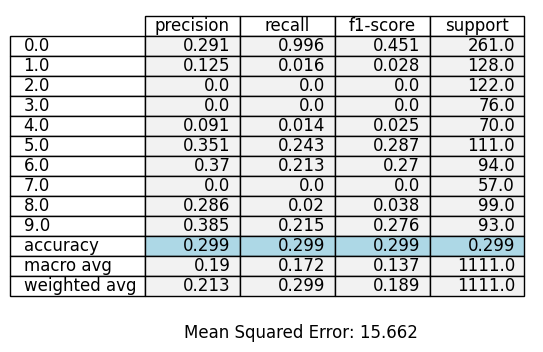

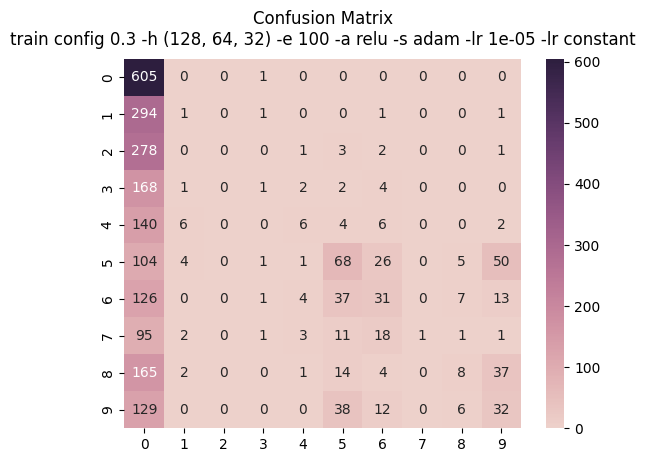

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


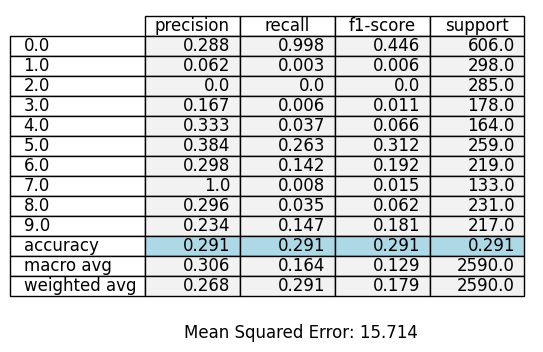

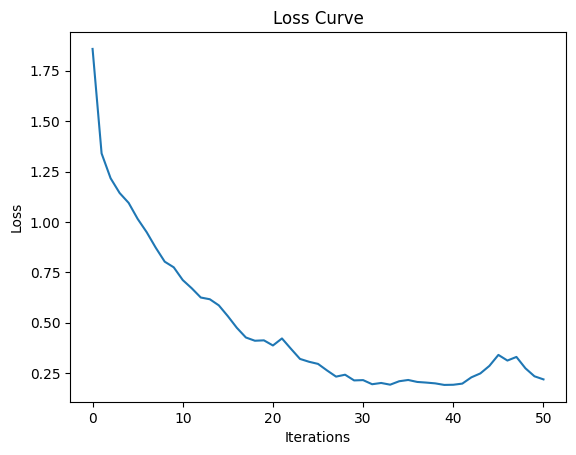

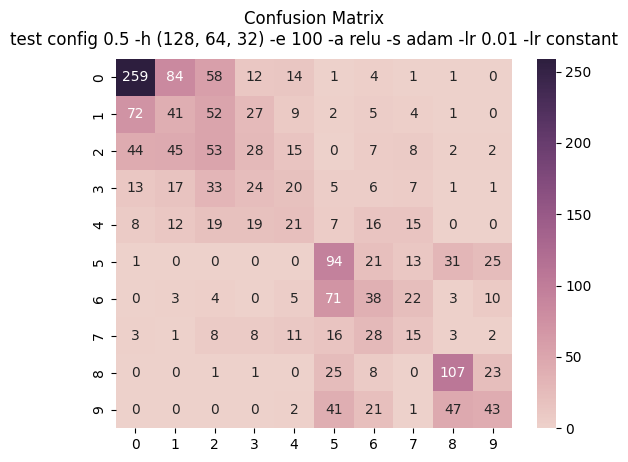

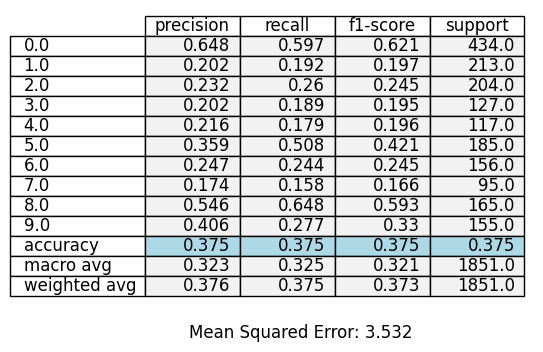

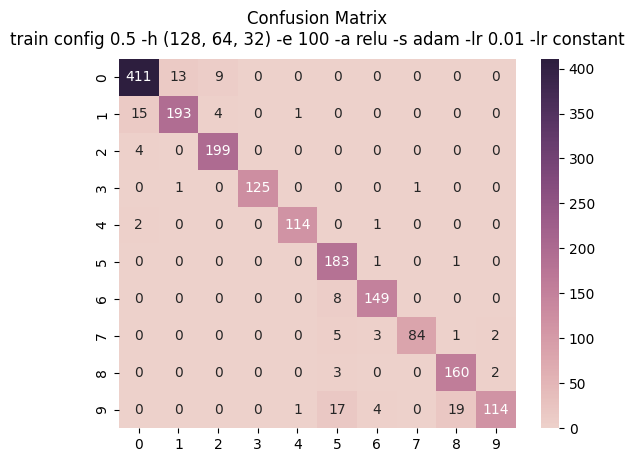

...

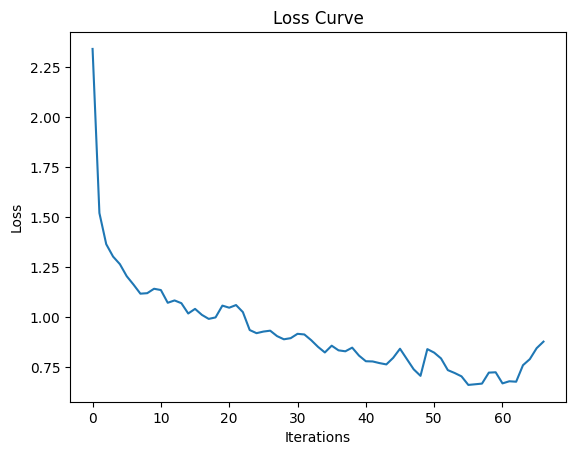

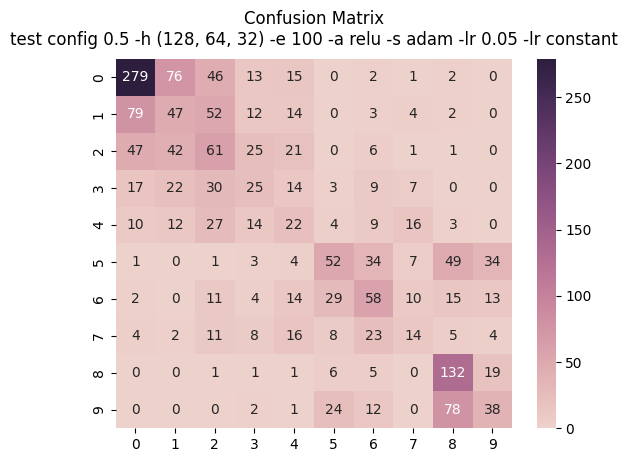

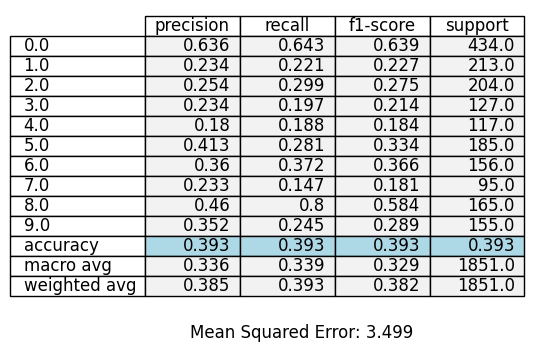

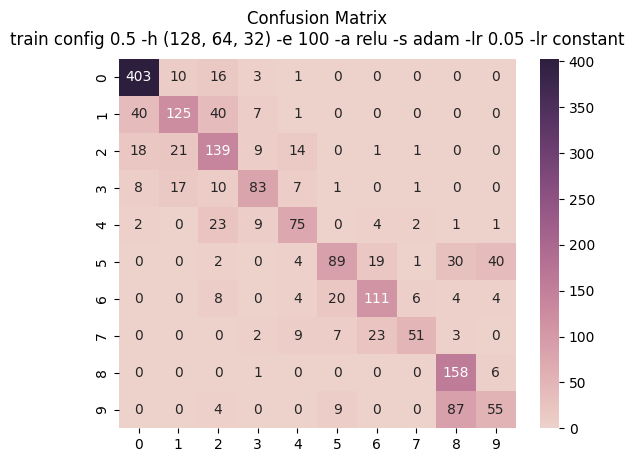

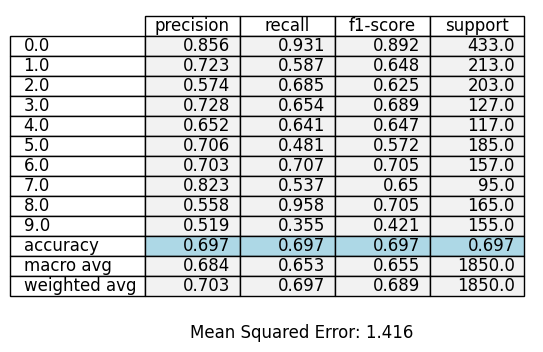

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


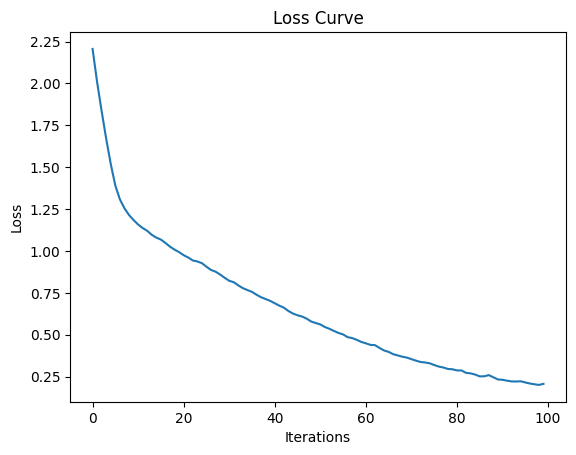

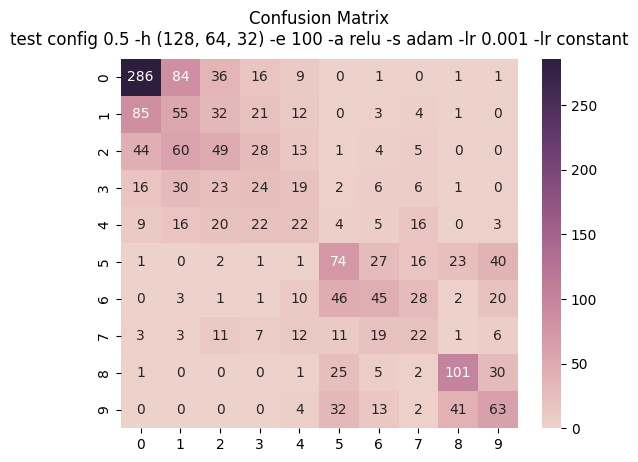

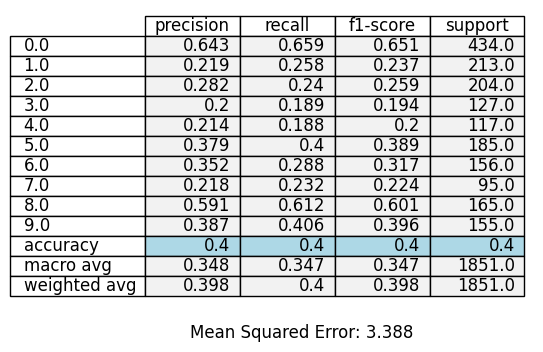

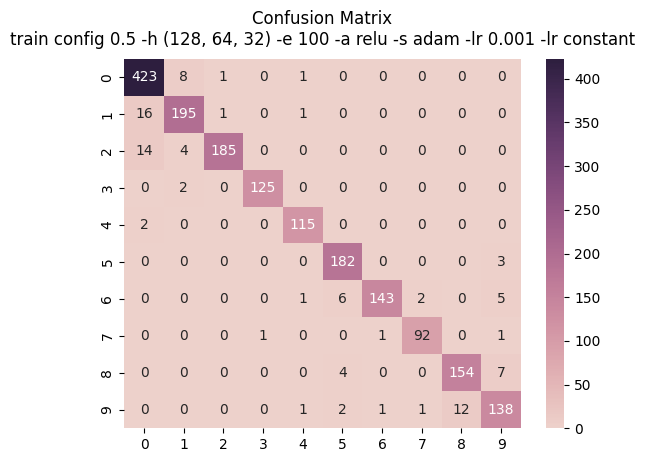

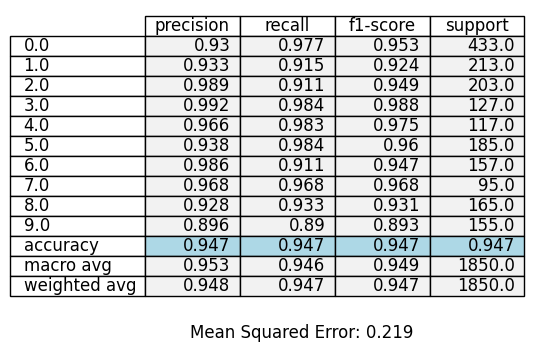

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


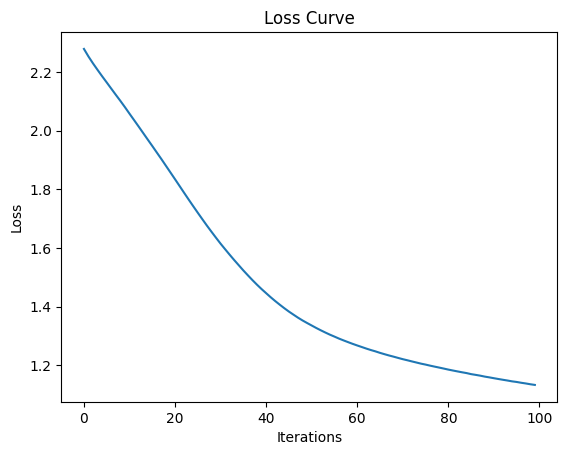

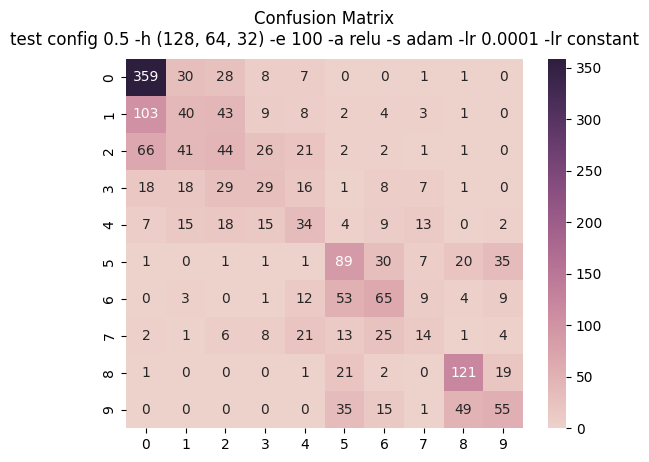

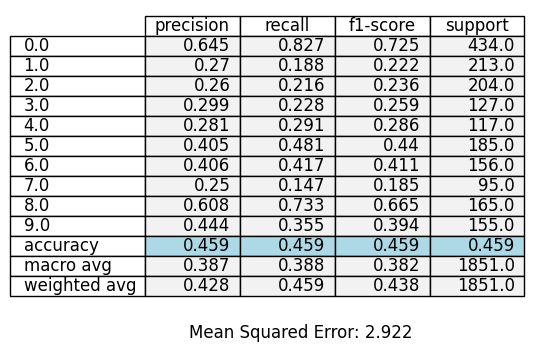

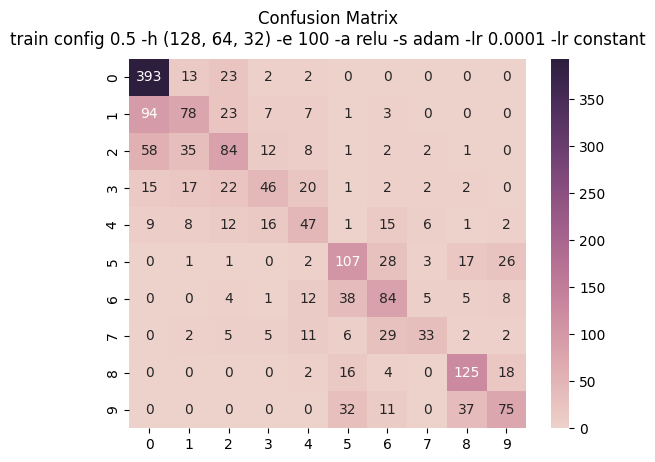

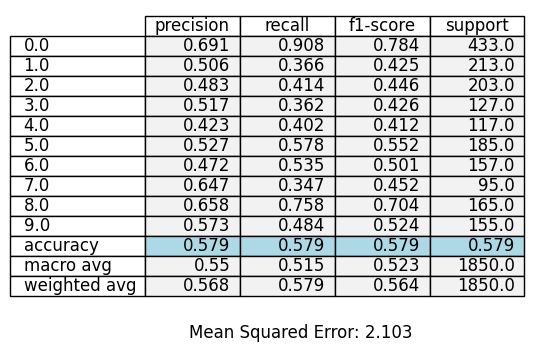

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


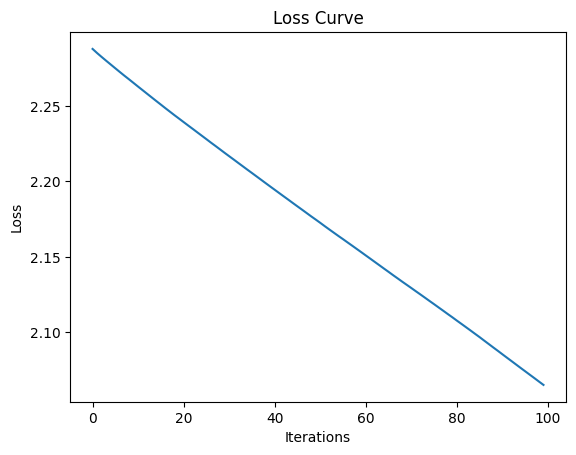

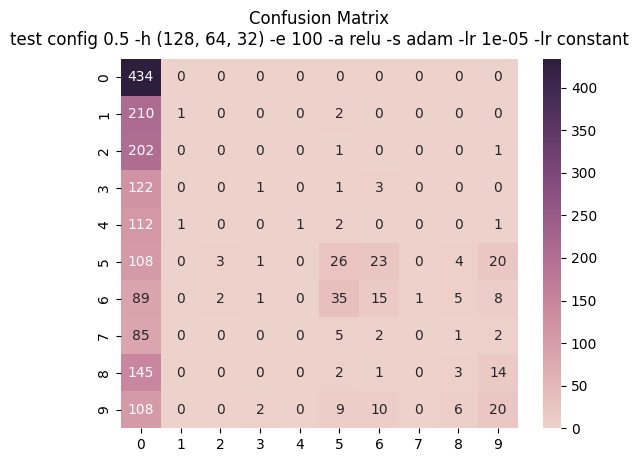

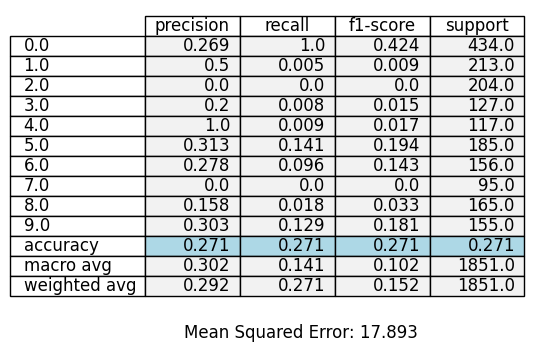

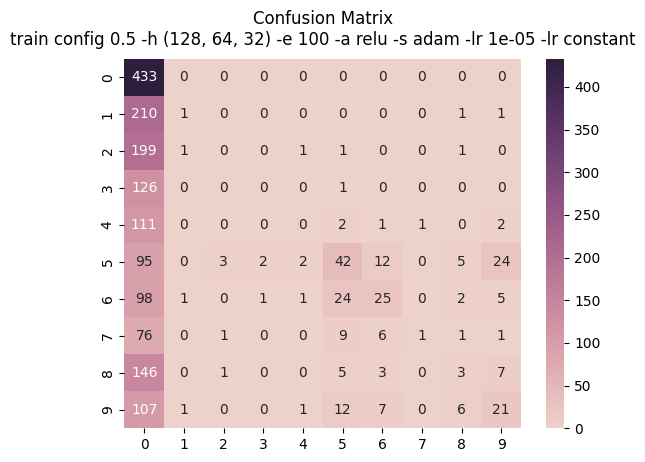

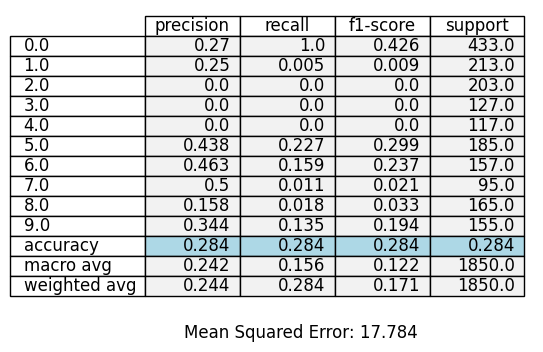

In [ ]:
best_accuracy = 0
best_config = None

config = [0.1, 0.3, 0.5]
lr = [0.01, 0.05, 0.001, 0.0001, 0.00001]

for i in config:
    x_train, x_test, y_train, y_test = train_test_split(features, label, test_size=i, random_state=42, stratify=label)

    scaler = StandardScaler()
    x_train = scaler.fit_transform(x_train)
    x_test = scaler.transform(x_test)

    x_train = pd.DataFrame(x_train)
    x_test = pd.DataFrame(x_test)

    correlation_matrix = pd.DataFrame(x_train).corr()

    upper_tri = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape),k=1).astype(bool))
    to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.9)]

    x_train = x_train.drop(x_train.columns[to_drop], axis=1)
    x_test = x_test.drop(x_test.columns[to_drop], axis=1)

    pca = PCA(n_components=0.95)
    pca.fit(x_train)
    x_train = pca.transform(x_train)
    x_test = pca.transform(x_test)

    for j in lr:
        #! edit mulai disini
        hidden_layer = (128,64,32)
        max_iter = 100
        activation = 'relu'
        solver = 'adam'
        random_state = 42
        learning_rate_init = j
        learning_rate = 'constant'
        mlp = MLPClassifier(hidden_layer_sizes=hidden_layer, max_iter=max_iter, activation=activation, solver=solver, random_state=random_state, learning_rate_init=learning_rate_init, learning_rate=learning_rate)
        mlp.fit(x_train, y_train)
        #! sampe sini

        accuracy = mlp.score(x_test, y_test)

        # Check if the current accuracy is the best
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_config = {
                'config': i,
                'epoch': max_iter,
                'hidden_layer': hidden_layer,
                'activation': activation,
                'solver': solver,
                'learning_rate_init': j,
                'learning_rate': learning_rate
            }

        plt.plot(mlp.loss_curve_)
        plt.title('Loss Curve')
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.show()

        predict = mlp.predict(x_test)
        confussion_matrix = confusion_matrix(y_test, predict)
        plot_cm(confussion_matrix, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model1_report = classification_report(y_test, predict, output_dict=True)
        report1 = pd.DataFrame(model1_report).transpose()
        report1 = report1.round(3)
        mse_value1 = mean_squared_error(y_test, predict)
        report_maker(report1, mse_value1, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)


        predict = mlp.predict(x_train)
        confusion_matrix_result = confusion_matrix(y_train, predict)
        plot_cm(confusion_matrix_result, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model_report = classification_report(y_train, predict, output_dict=True)
        report = pd.DataFrame(model_report).transpose()
        report = report.round(3)
        mse_value = mean_squared_error(y_train, predict)
        report_maker(report, mse_value, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)

In [ ]:
best_accuracy, best_config

(0.47794779477947796,
 {'config': 0.3,
  'epoch': 100,
  'hidden_layer': (128, 64, 32),
  'activation': 'relu',
  'solver': 'adam',
  'learning_rate_init': 0.0001,
  'learning_rate': 'constant'})

### Activation Funtion

In [ ]:
epoch_dir = 'activation-function'

cm_epoch_dir = os.path.join(cm_dir, epoch_dir)
if not os.path.exists(cm_epoch_dir):
    os.makedirs(cm_epoch_dir)

report_epoch_dir = os.path.join(report_dir, epoch_dir)
if not os.path.exists(report_epoch_dir):
    os.makedirs(report_epoch_dir)

cmdir = os.path.relpath(cm_epoch_dir, start=main_dir)
cmdir = cmdir.replace(os.path.sep, '/')

rpdir = os.path.relpath(report_epoch_dir, start=main_dir)
rpdir = rpdir.replace(os.path.sep, '/')
    

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


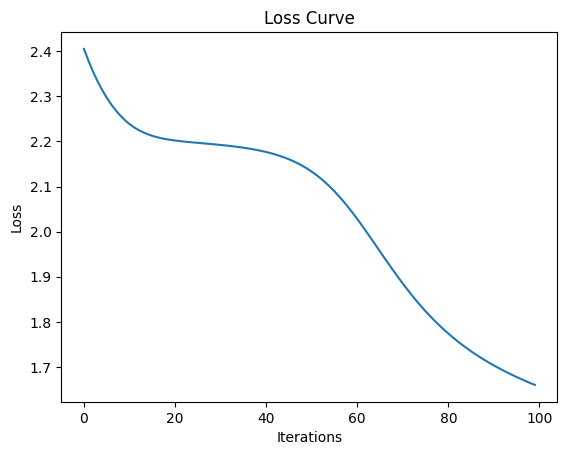

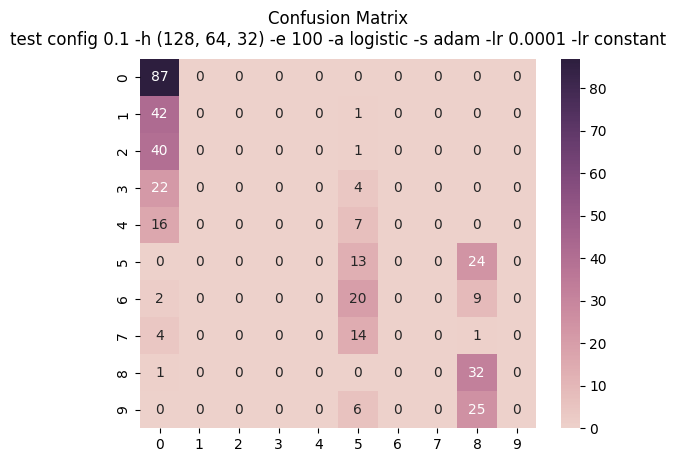

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


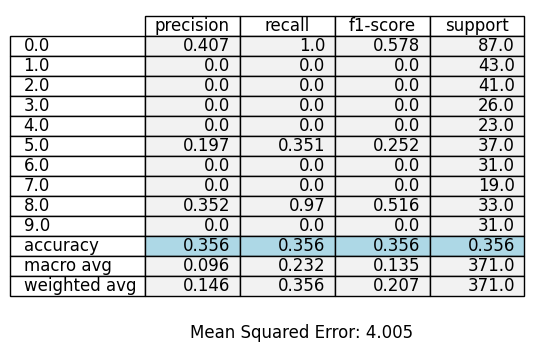

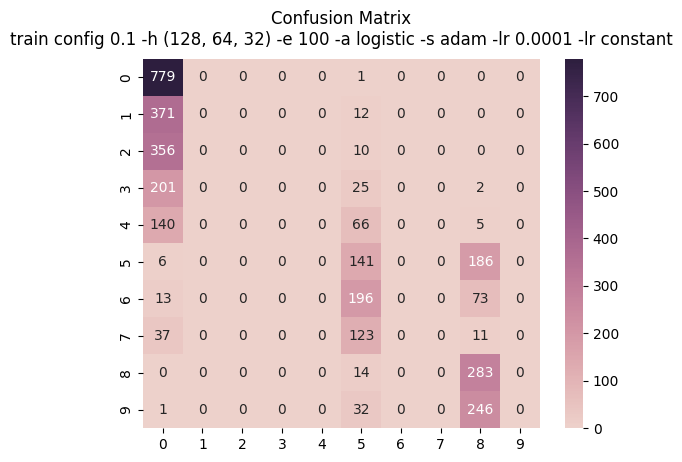

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


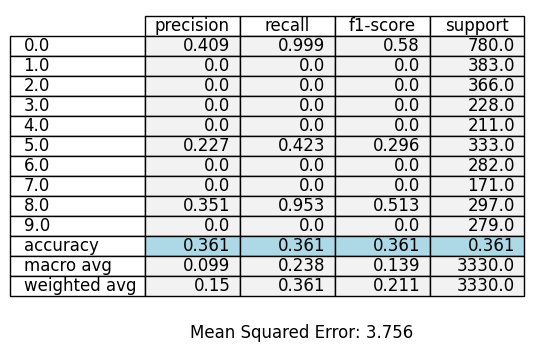

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


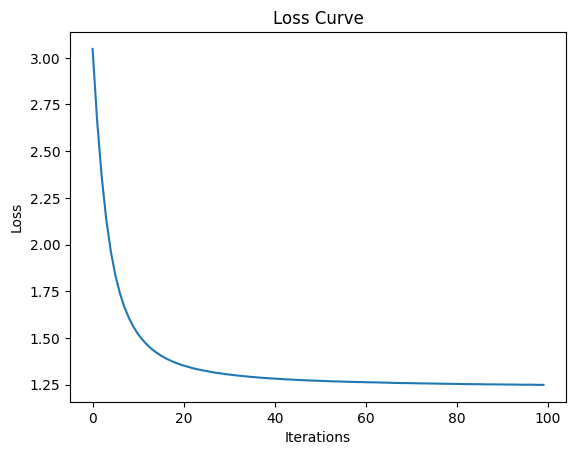

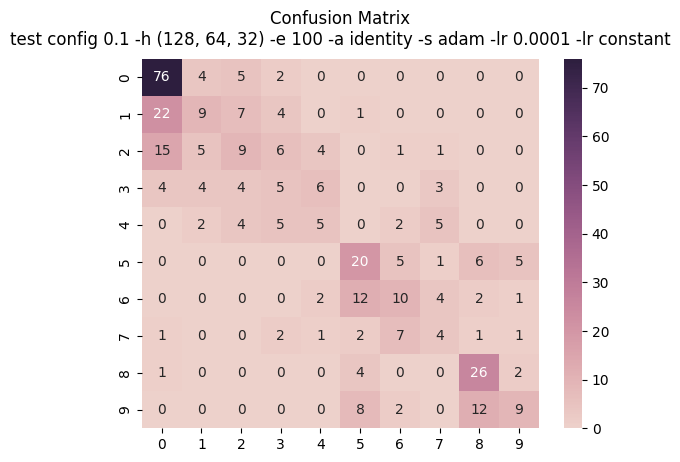

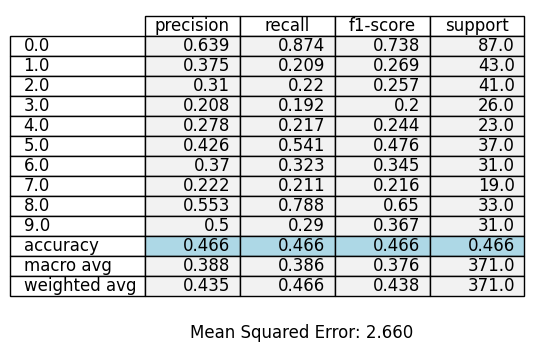

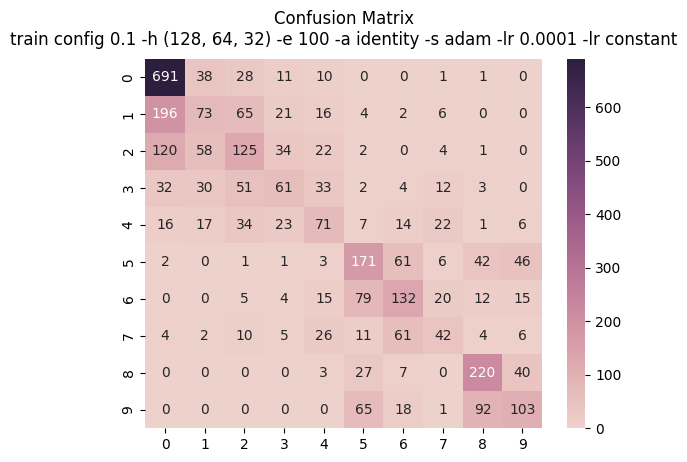

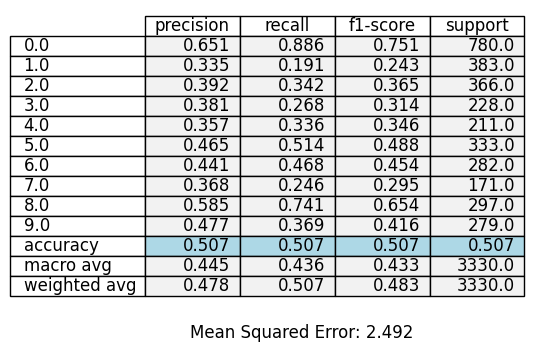

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


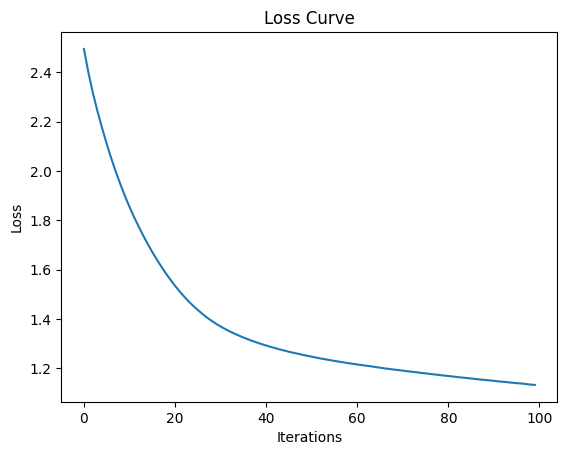

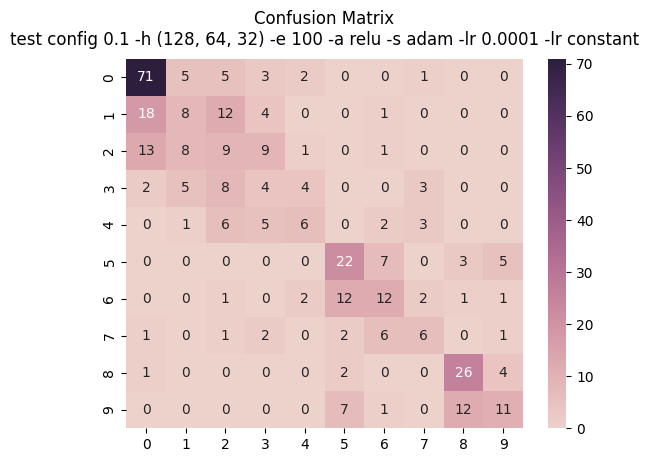

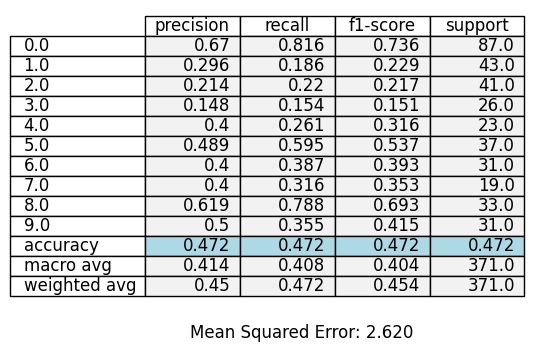

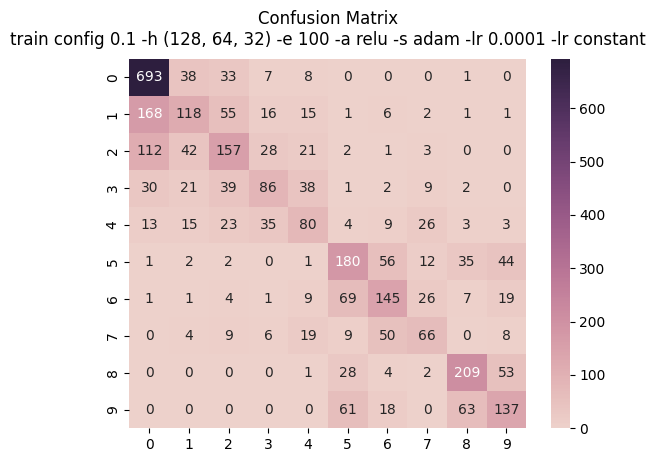

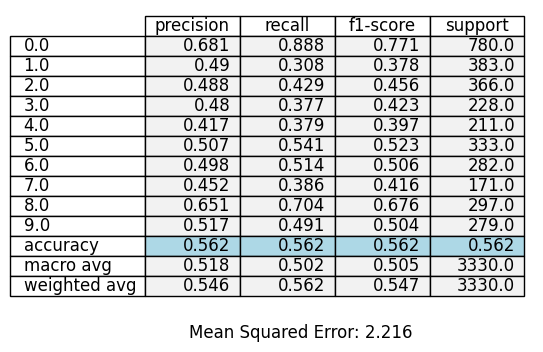

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


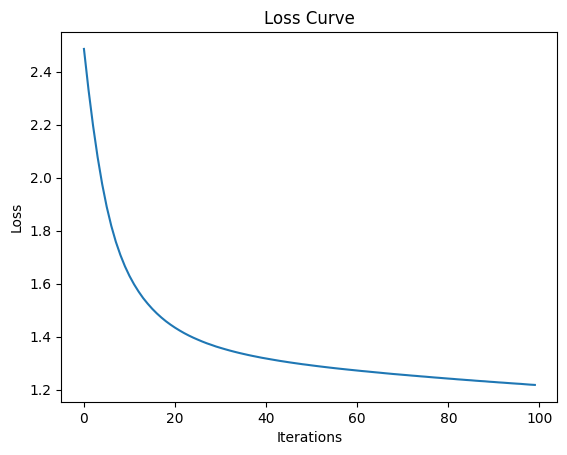

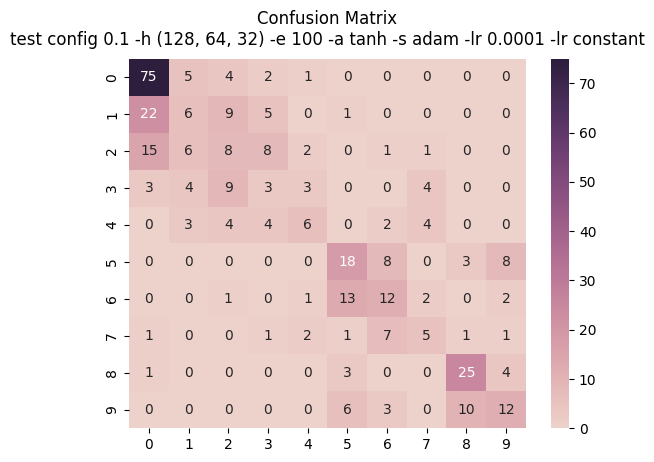

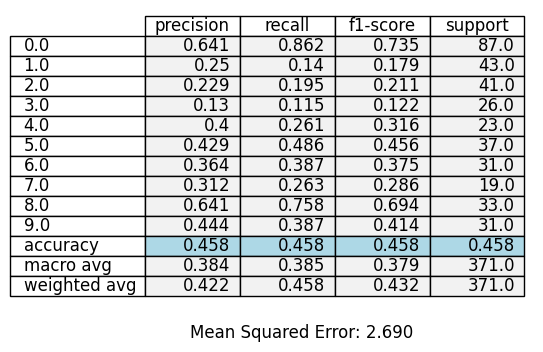

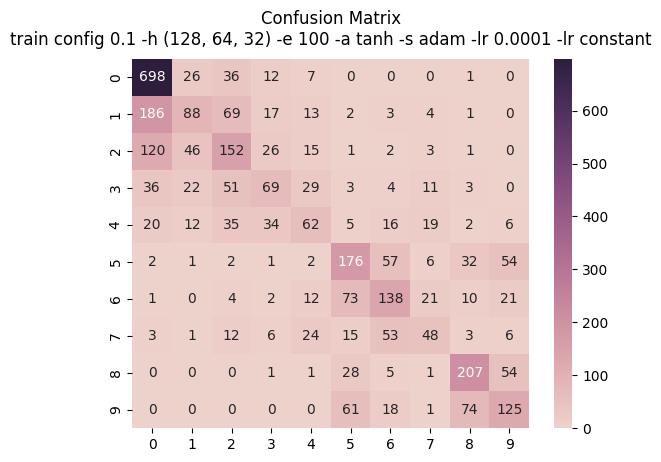

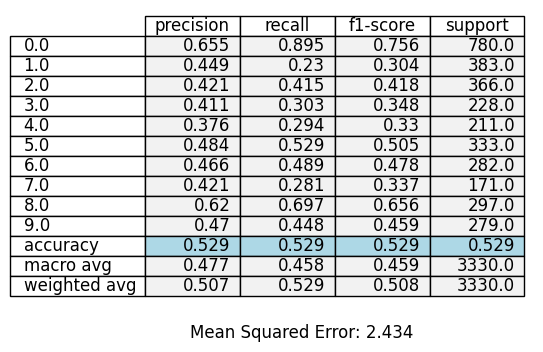

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


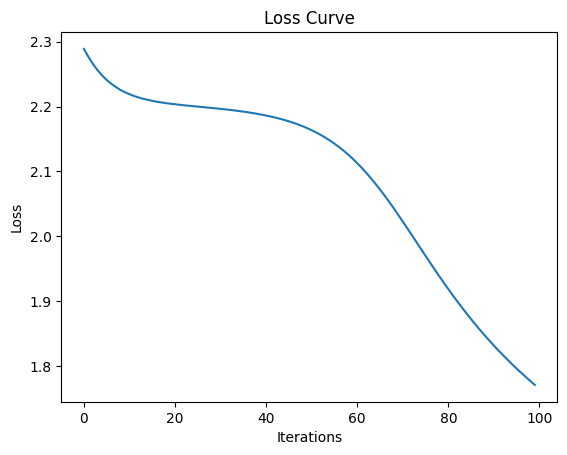

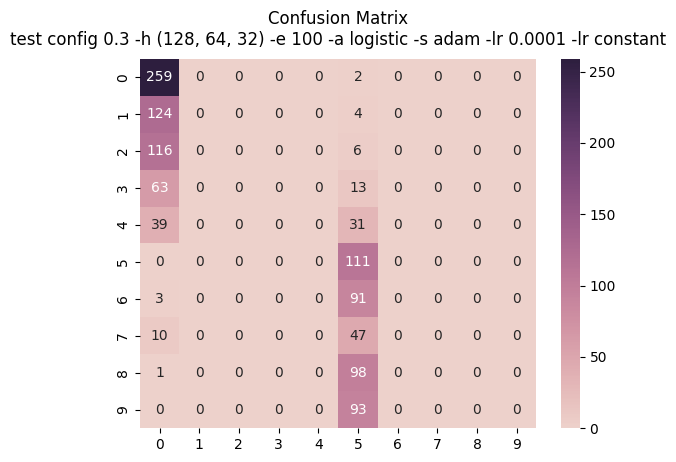

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


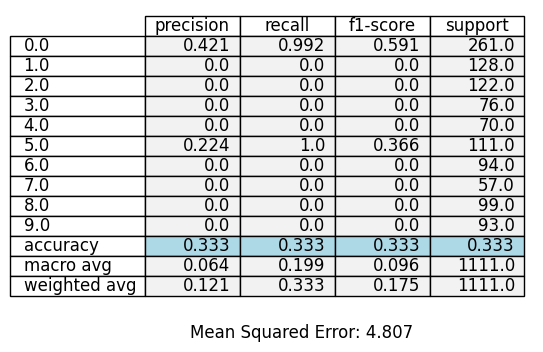

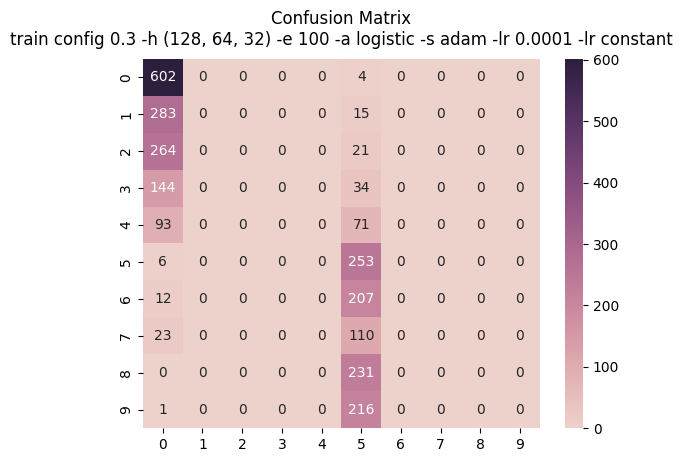

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


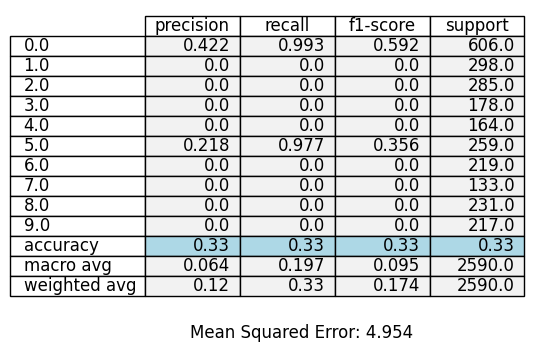

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


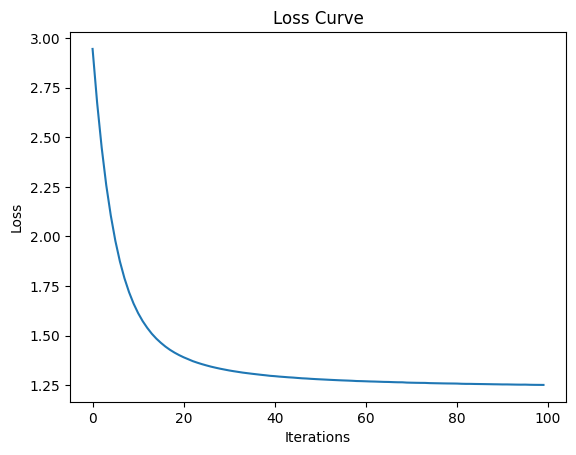

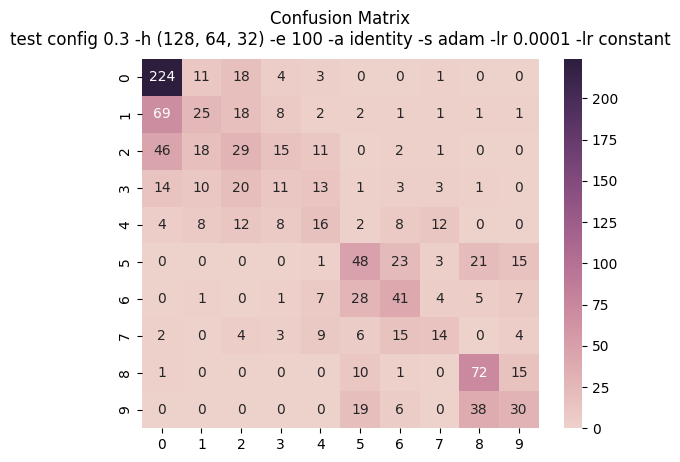

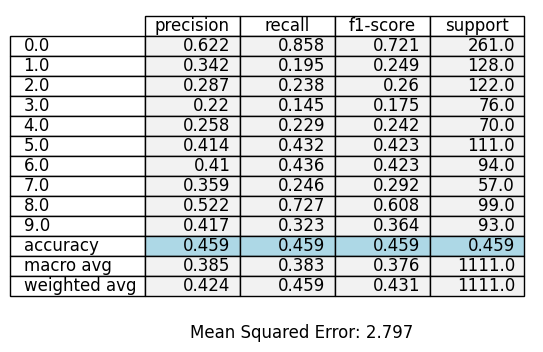

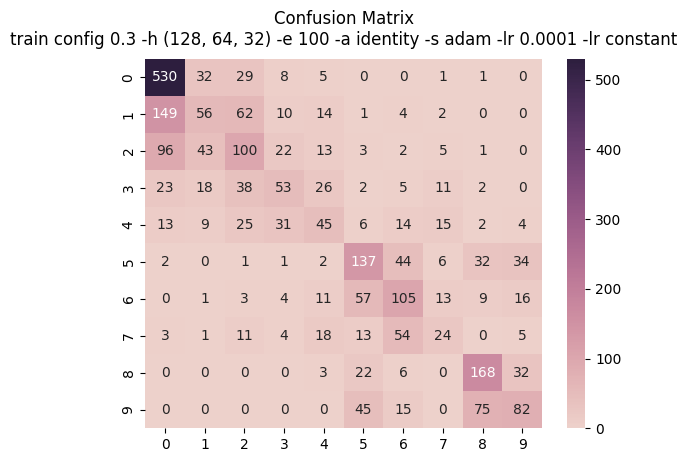

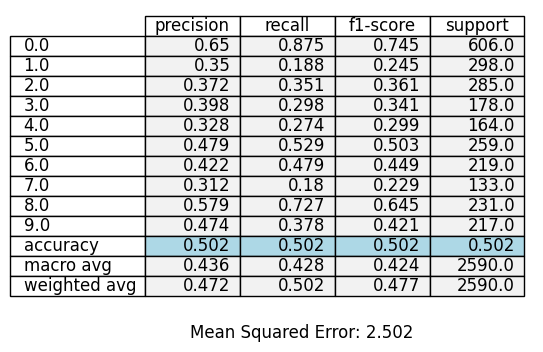

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


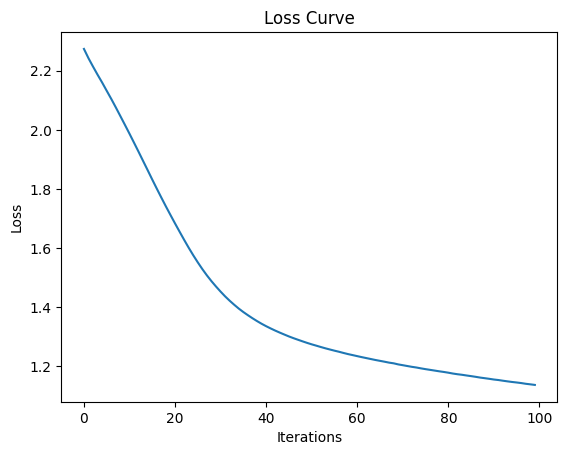

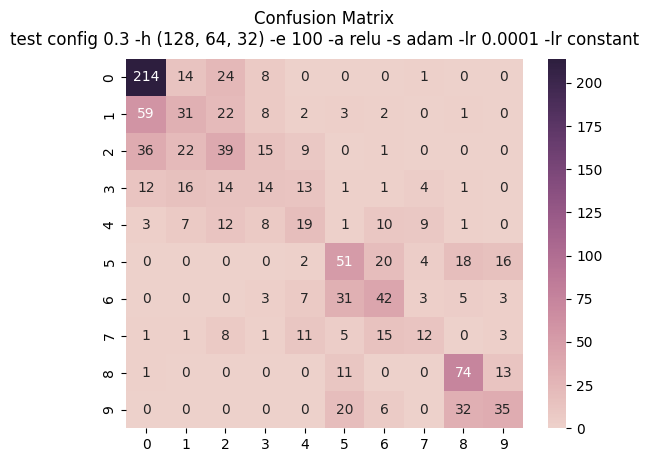

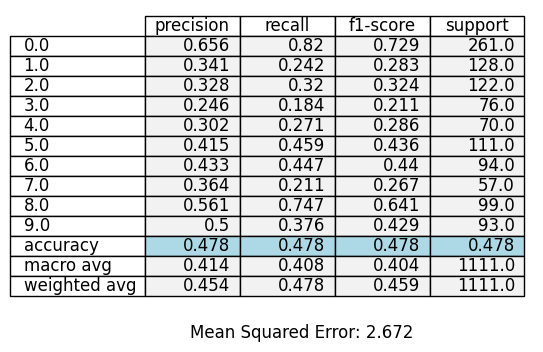

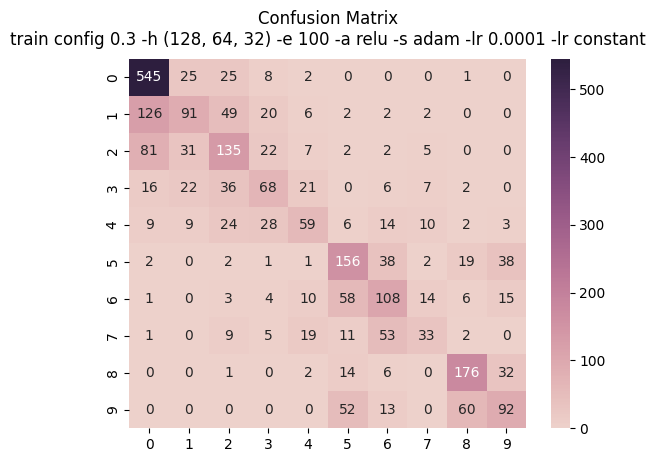

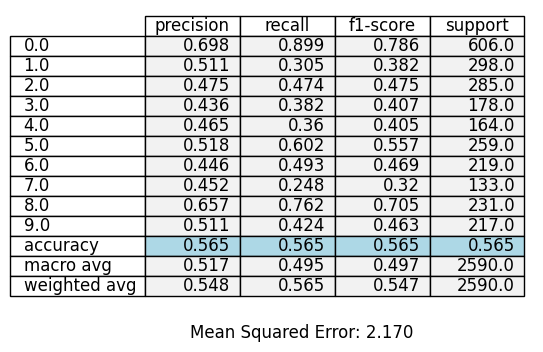

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


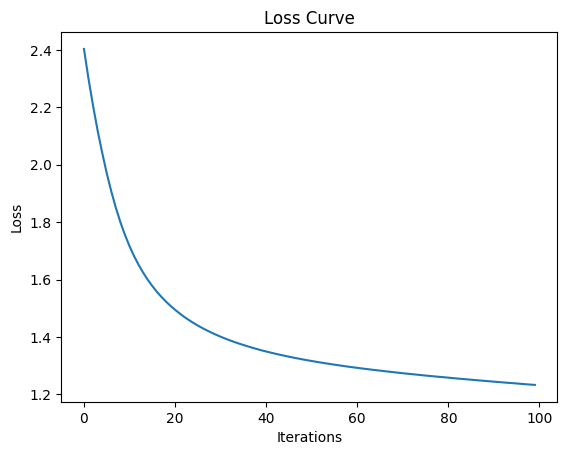

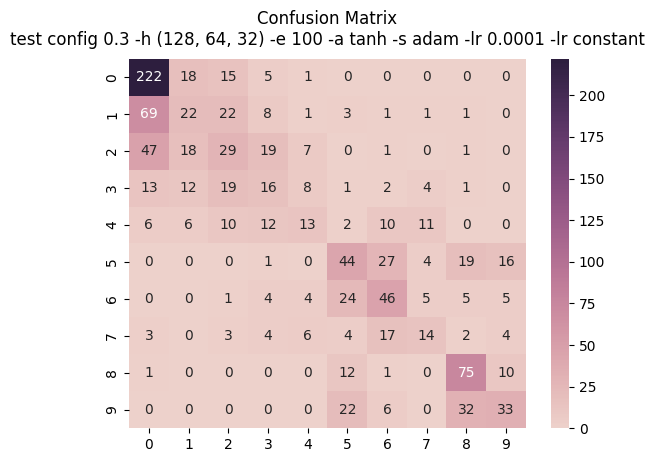

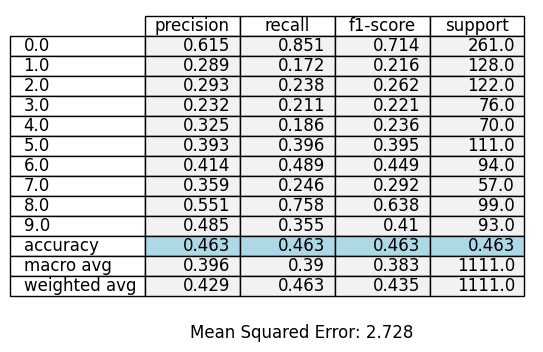

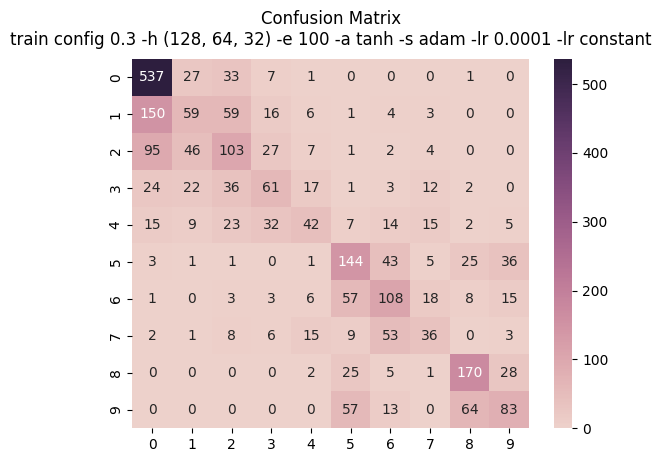

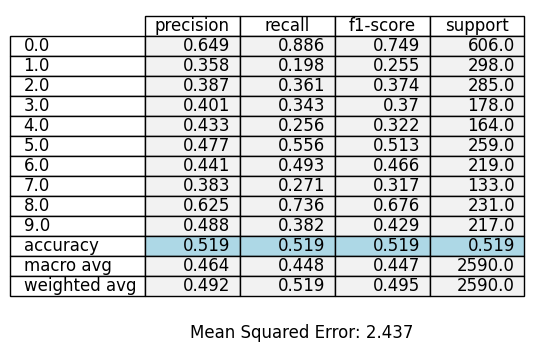

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


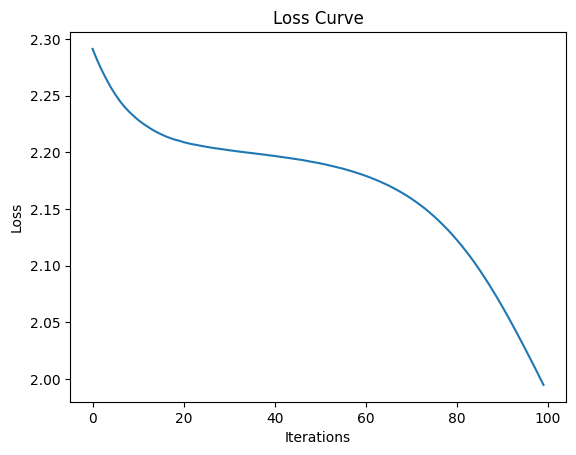

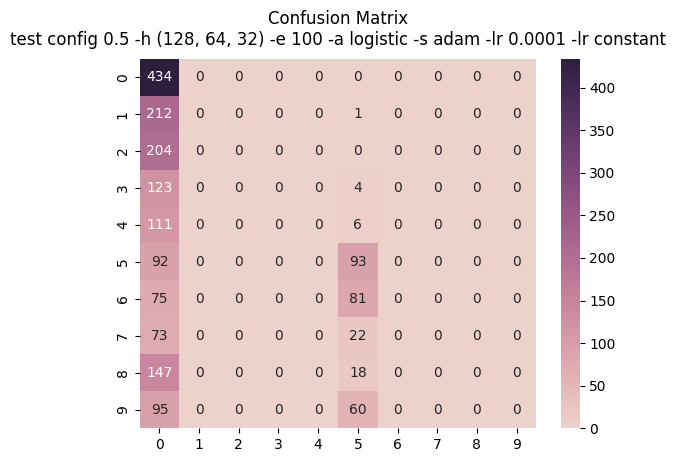

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


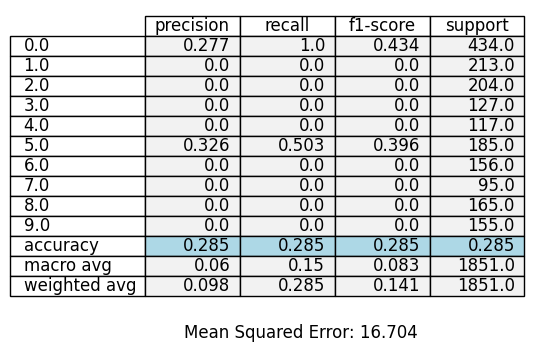

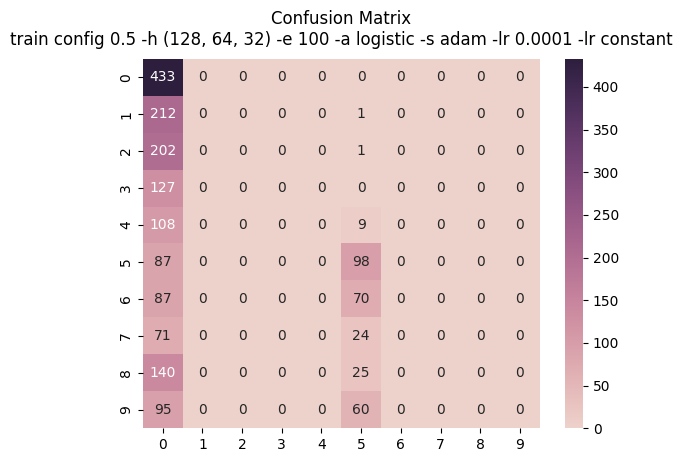

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


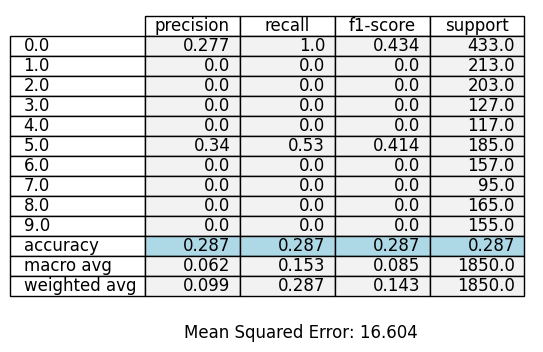

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


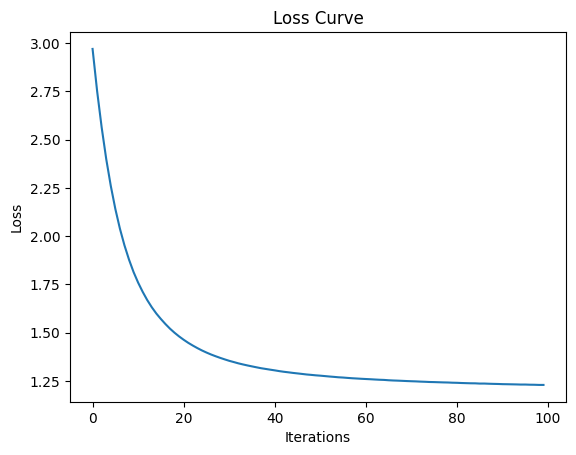

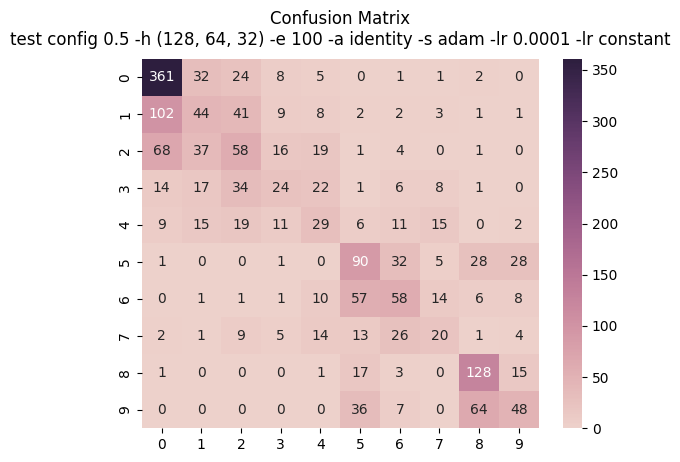

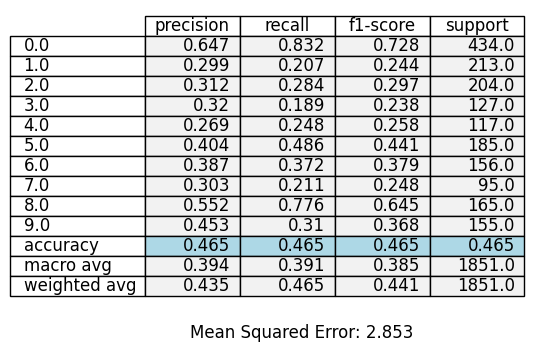

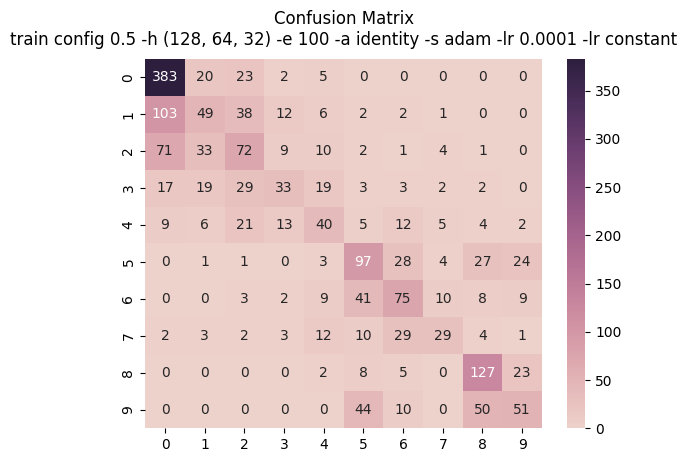

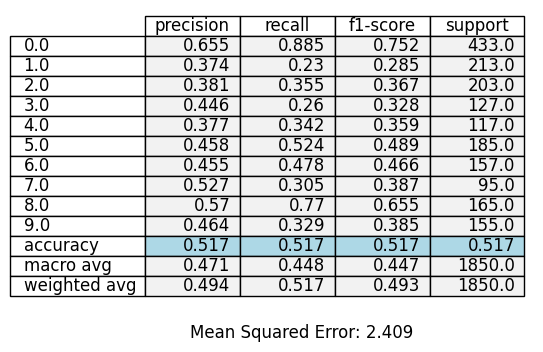

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


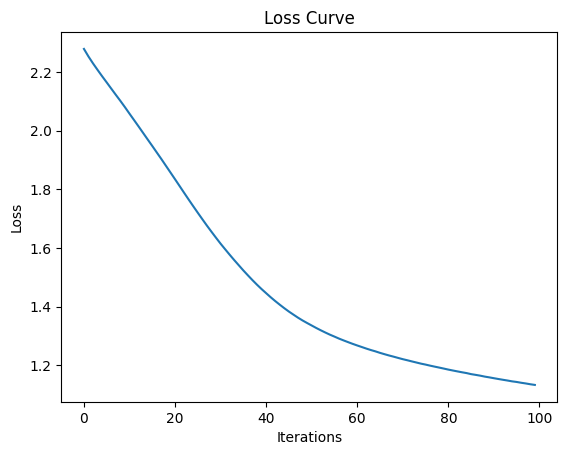

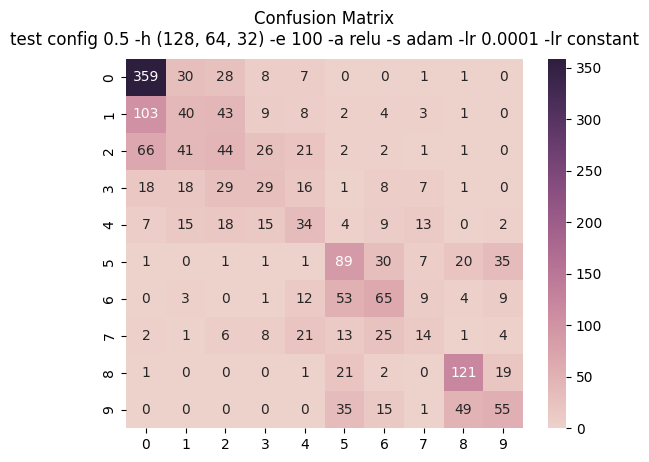

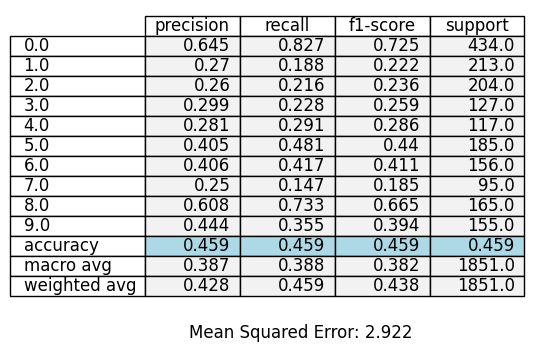

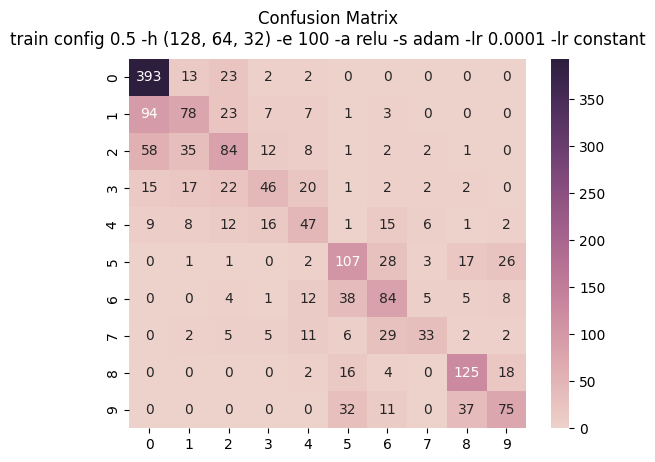

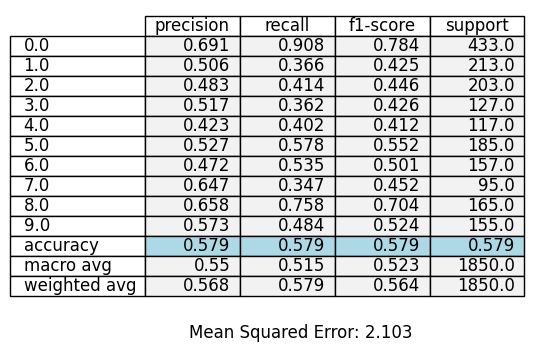

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


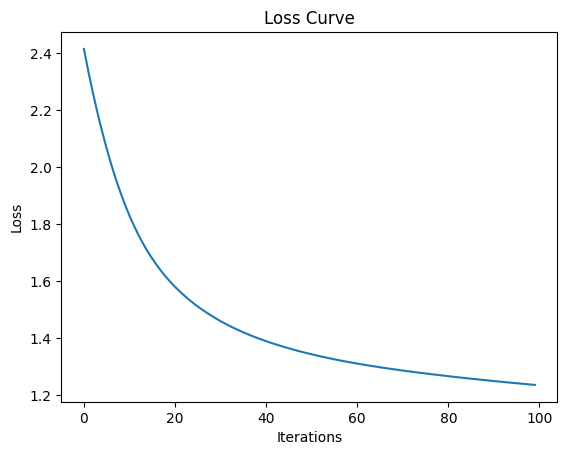

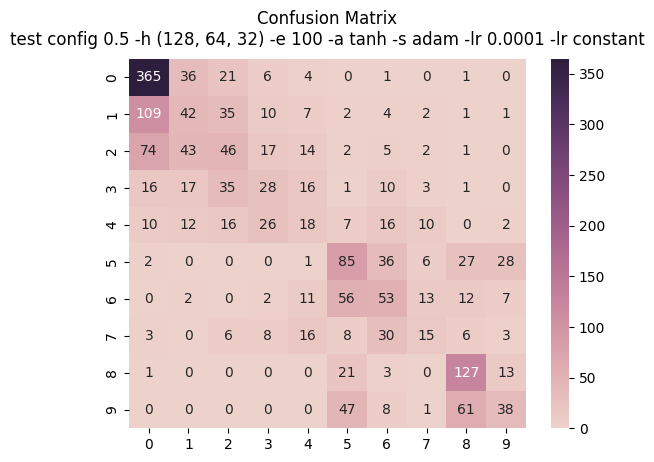

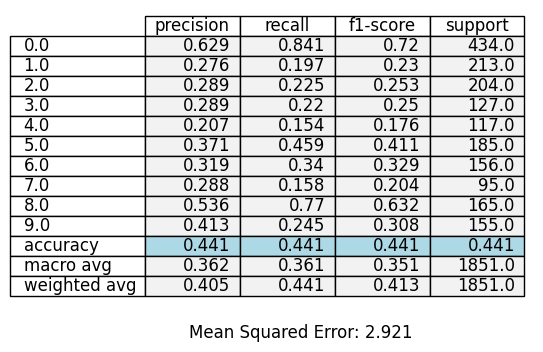

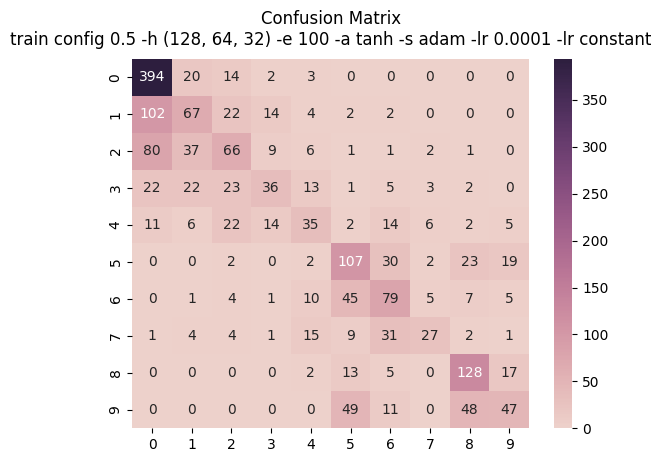

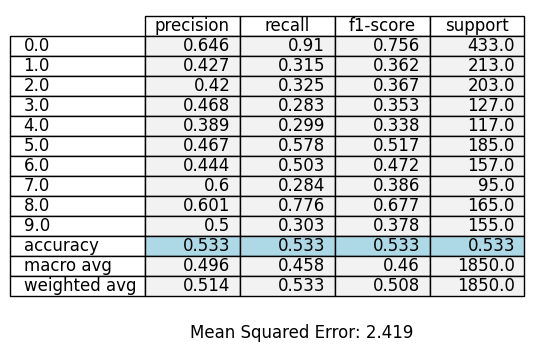

In [ ]:
best_accuracy = 0
best_config = None

config = [0.1, 0.3, 0.5]
act_func = ['logistic', 'identity', 'relu', 'tanh']

for i in config:
    x_train, x_test, y_train, y_test = train_test_split(features, label, test_size=i, random_state=42, stratify=label)

    scaler = StandardScaler()
    x_train = scaler.fit_transform(x_train)
    x_test = scaler.transform(x_test)

    x_train = pd.DataFrame(x_train)
    x_test = pd.DataFrame(x_test)

    correlation_matrix = pd.DataFrame(x_train).corr()

    upper_tri = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape),k=1).astype(bool))
    to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.9)]

    x_train = x_train.drop(x_train.columns[to_drop], axis=1)
    x_test = x_test.drop(x_test.columns[to_drop], axis=1)

    pca = PCA(n_components=0.95)
    pca.fit(x_train)
    x_train = pca.transform(x_train)
    x_test = pca.transform(x_test)

    for j in act_func:
        #! edit mulai disini
        hidden_layer = (128,64,32)
        max_iter = 100
        activation = j
        solver = 'adam'
        random_state = 42
        learning_rate_init = 0.0001
        learning_rate = 'constant'
        mlp = MLPClassifier(hidden_layer_sizes=hidden_layer, max_iter=max_iter, activation=activation, solver=solver, random_state=random_state, learning_rate_init=learning_rate_init, learning_rate=learning_rate)
        mlp.fit(x_train, y_train)
        #! sampe sini

        accuracy = mlp.score(x_test, y_test)

        # Check if the current accuracy is the best
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_config = {
                'config': i,
                'epoch': max_iter,
                'hidden_layer': hidden_layer,
                'activation': activation,
                'solver': solver,
                'learning_rate_init': learning_rate_init,
                'learning_rate': learning_rate
            }

        plt.plot(mlp.loss_curve_)
        plt.title('Loss Curve')
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.show()

        predict = mlp.predict(x_test)
        confussion_matrix = confusion_matrix(y_test, predict)
        plot_cm(confussion_matrix, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model1_report = classification_report(y_test, predict, output_dict=True)
        report1 = pd.DataFrame(model1_report).transpose()
        report1 = report1.round(3)
        mse_value1 = mean_squared_error(y_test, predict)
        report_maker(report1, mse_value1, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)


        predict = mlp.predict(x_train)
        confusion_matrix_result = confusion_matrix(y_train, predict)
        plot_cm(confusion_matrix_result, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model_report = classification_report(y_train, predict, output_dict=True)
        report = pd.DataFrame(model_report).transpose()
        report = report.round(3)
        mse_value = mean_squared_error(y_train, predict)
        report_maker(report, mse_value, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)

In [ ]:
best_accuracy, best_config

(0.47794779477947796,
 {'config': 0.3,
  'epoch': 100,
  'hidden_layer': (128, 64, 32),
  'activation': 'relu',
  'solver': 'adam',
  'learning_rate_init': 0.0001,
  'learning_rate': 'constant'})

### Jumlah Hidden Layer

In [ ]:
epoch_dir = 'jumlah-hidden-layer'

cm_epoch_dir = os.path.join(cm_dir, epoch_dir)
if not os.path.exists(cm_epoch_dir):
    os.makedirs(cm_epoch_dir)

report_epoch_dir = os.path.join(report_dir, epoch_dir)
if not os.path.exists(report_epoch_dir):
    os.makedirs(report_epoch_dir)

cmdir = os.path.relpath(cm_epoch_dir, start=main_dir)
cmdir = cmdir.replace(os.path.sep, '/')

rpdir = os.path.relpath(report_epoch_dir, start=main_dir)
rpdir = rpdir.replace(os.path.sep, '/')
    

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


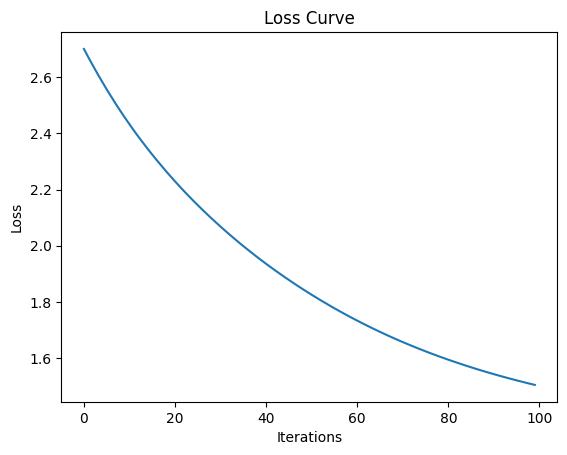

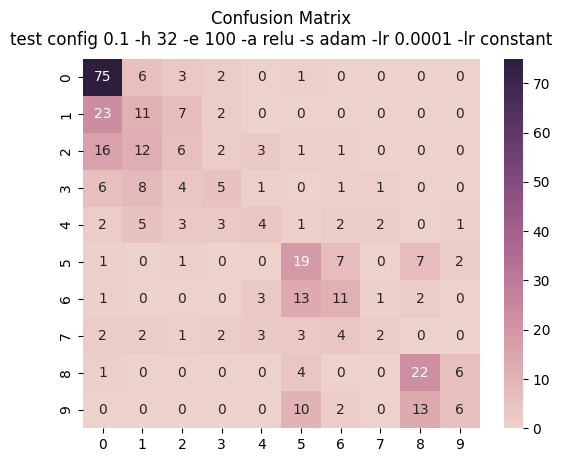

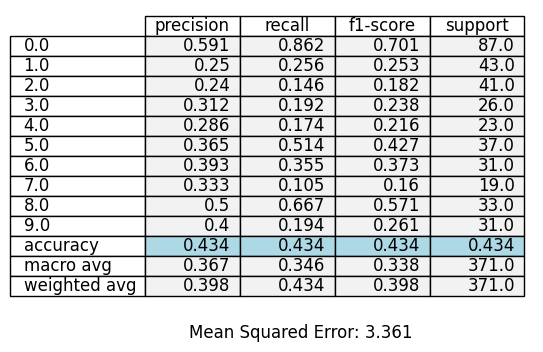

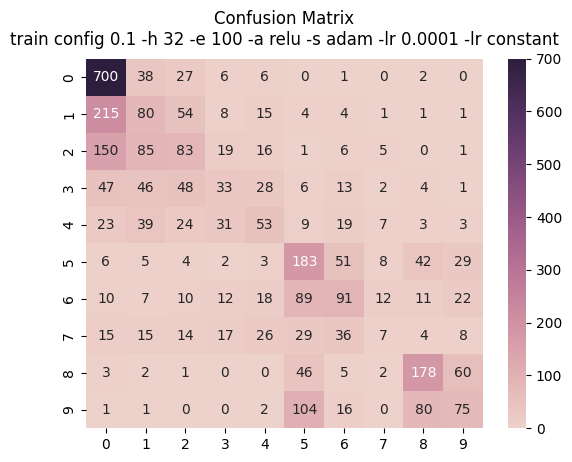

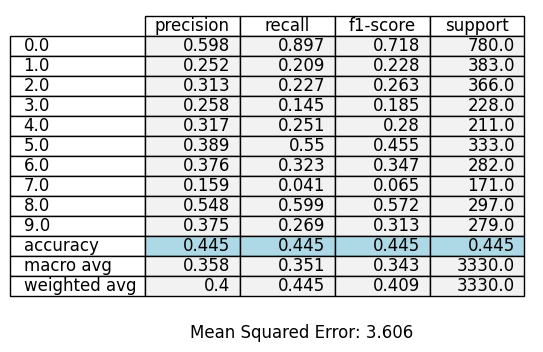

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


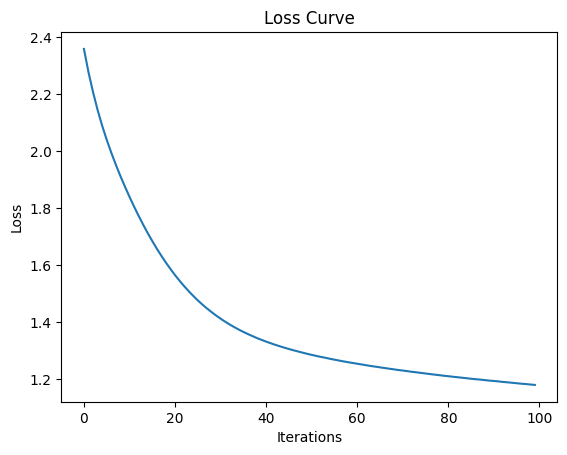

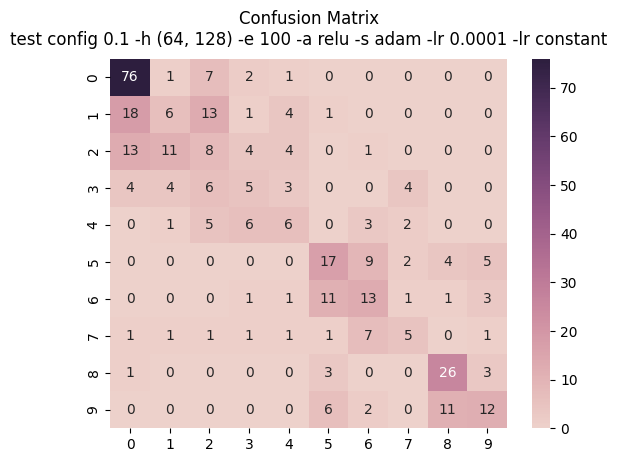

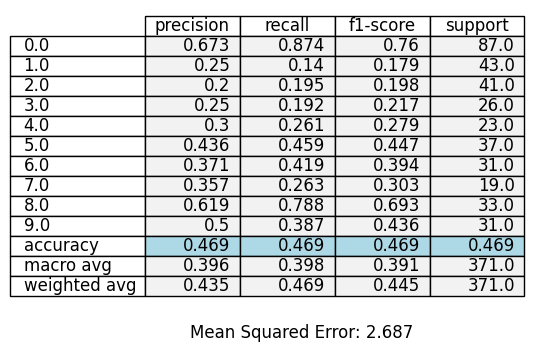

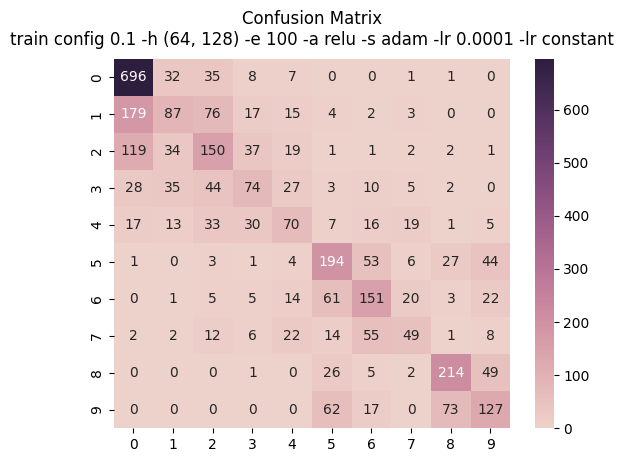

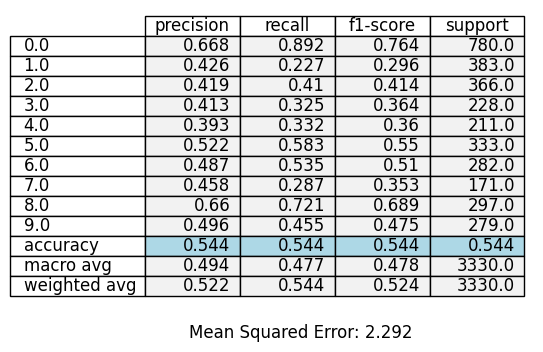

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


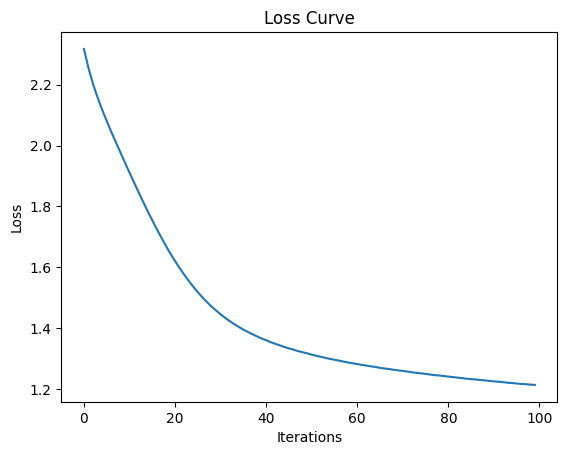

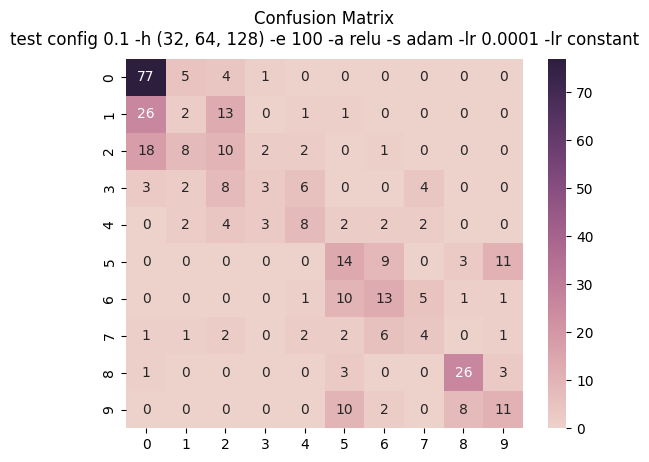

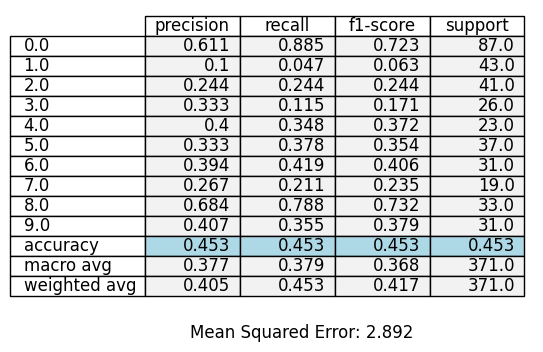

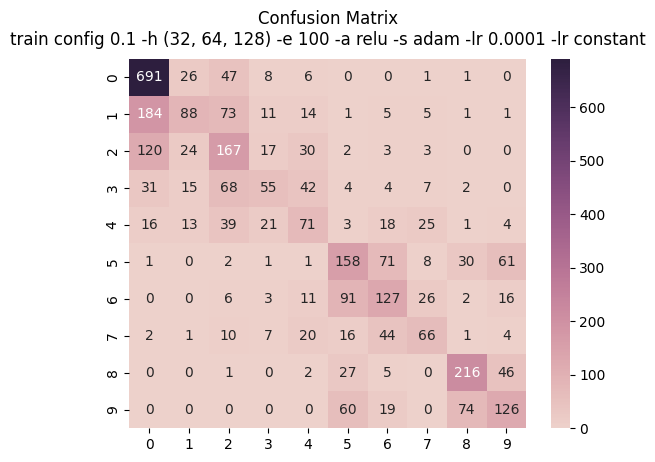

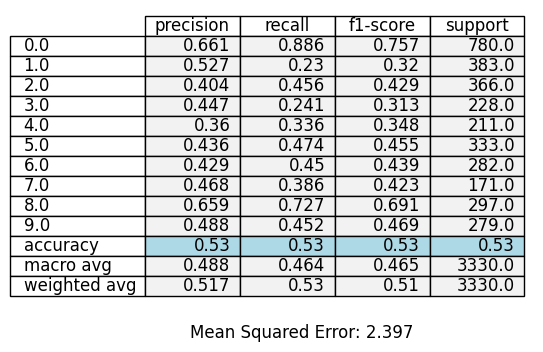

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


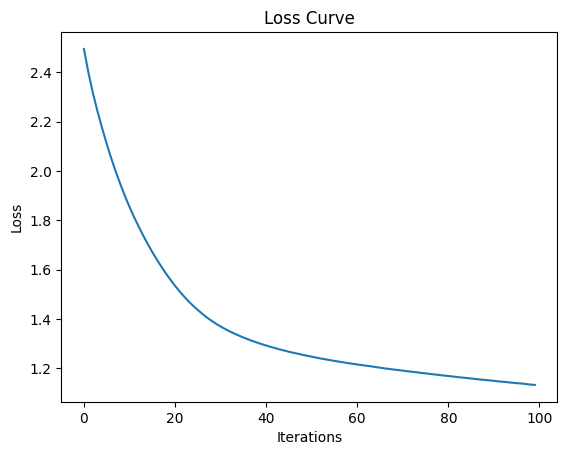

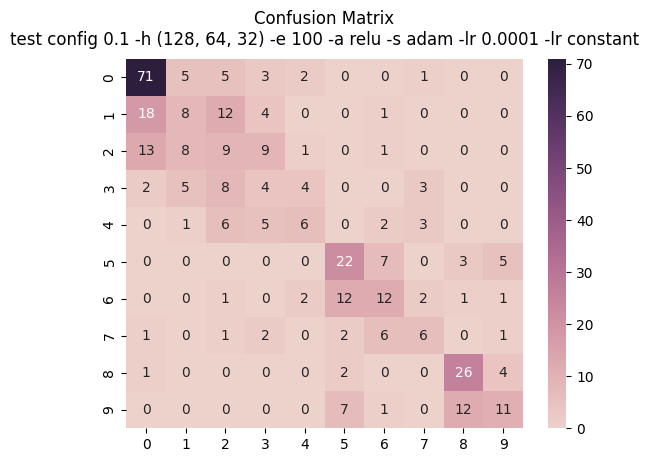

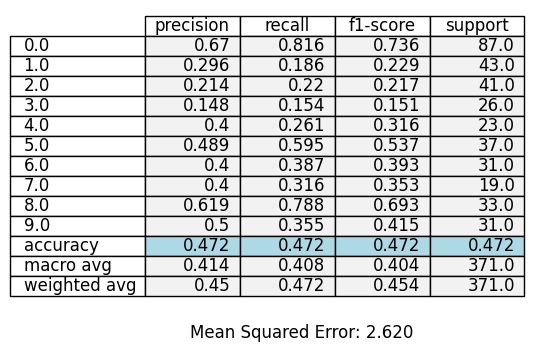

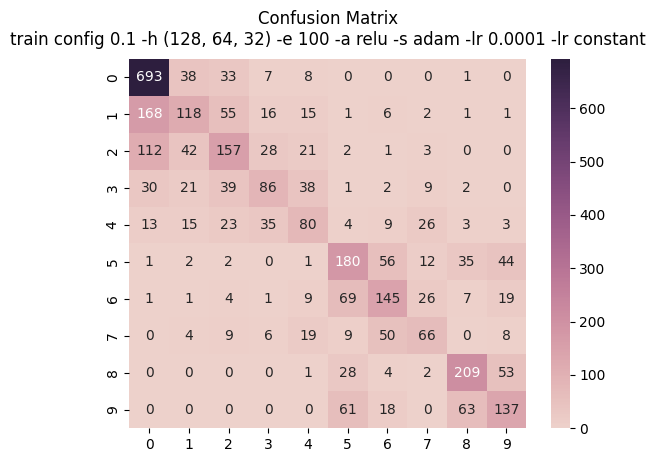

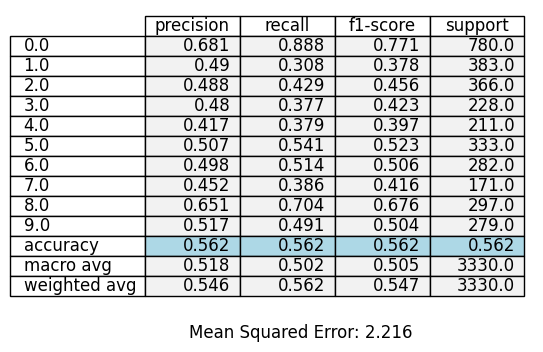

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


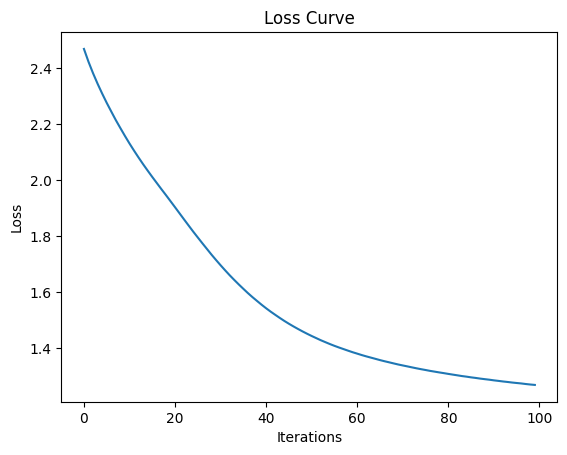

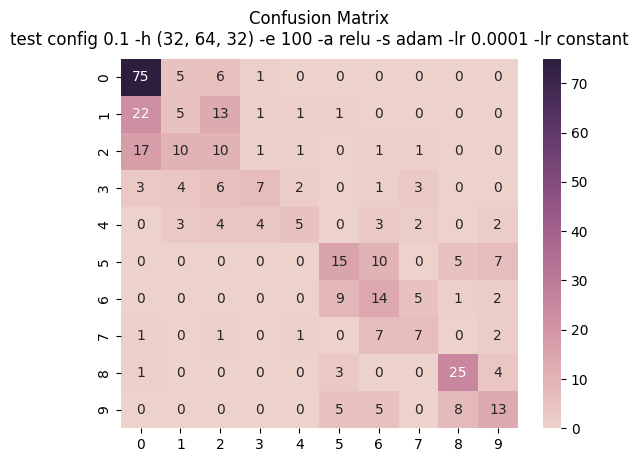

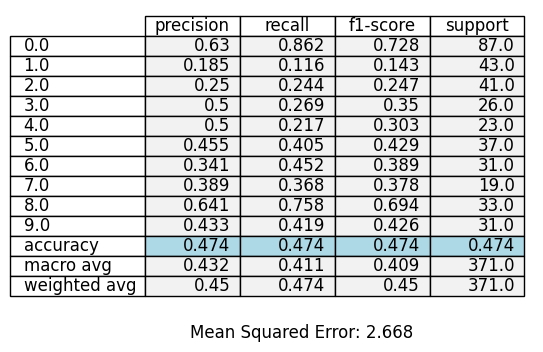

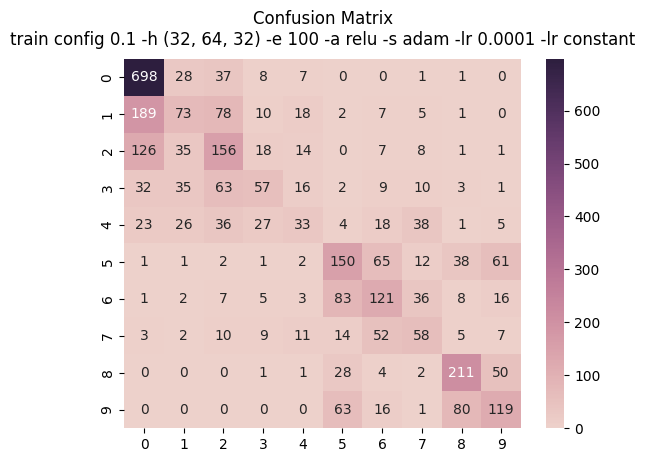

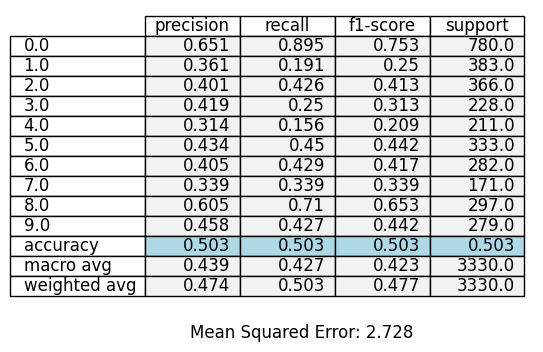

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


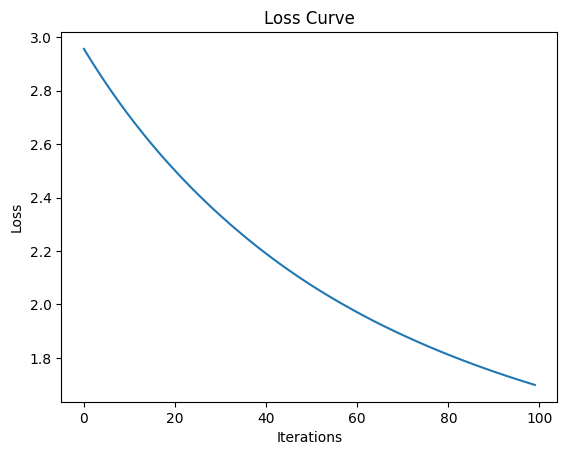

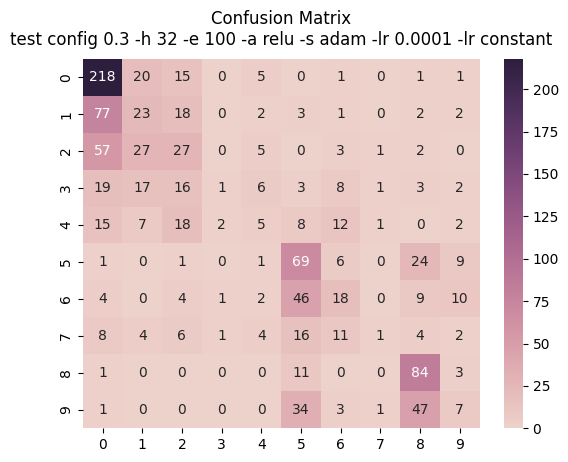

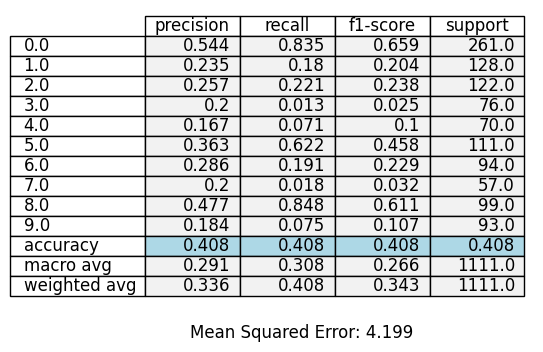

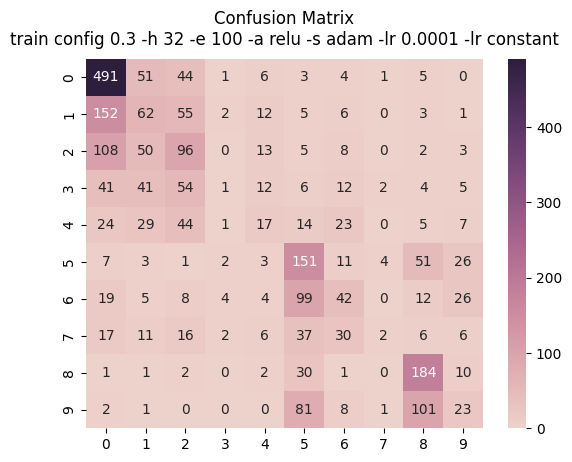

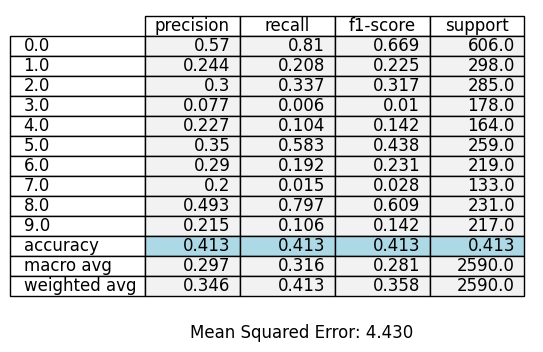

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


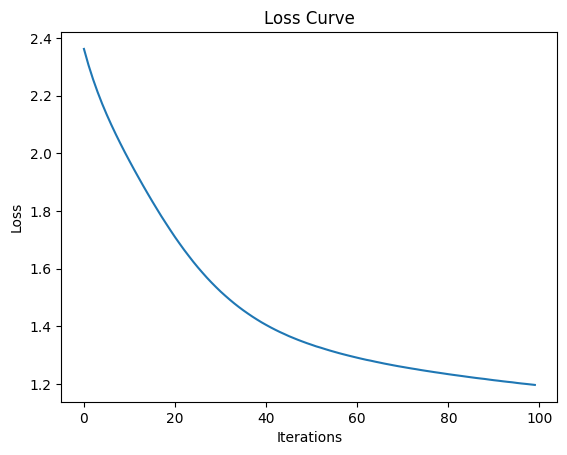

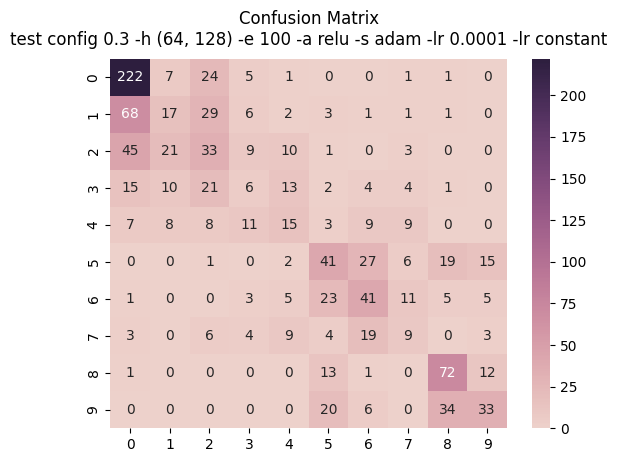

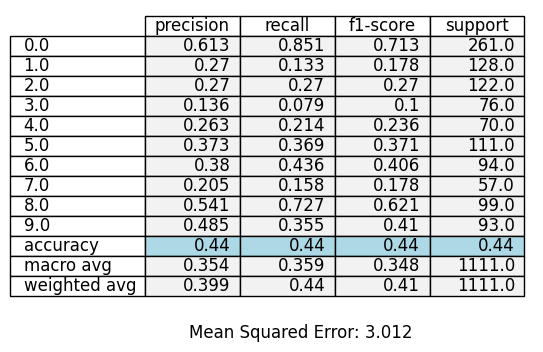

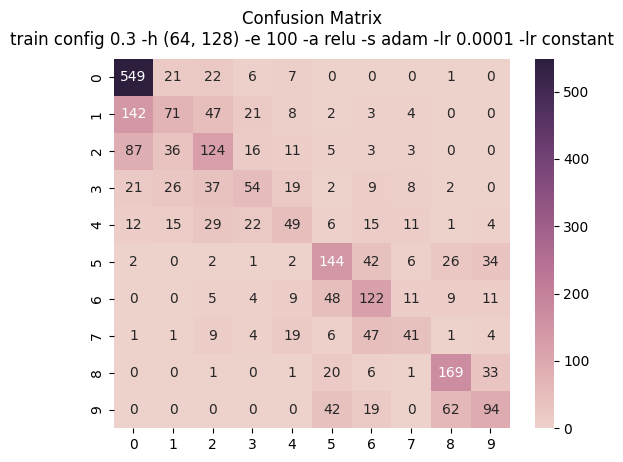

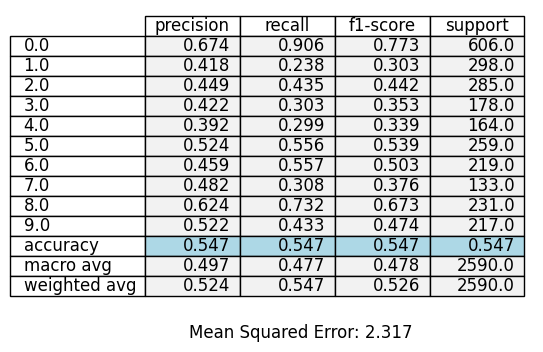

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


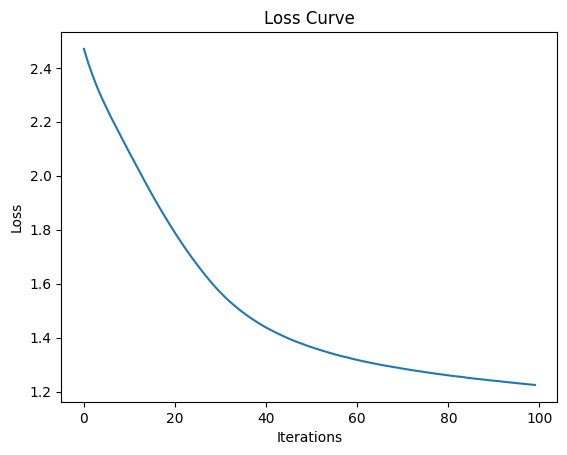

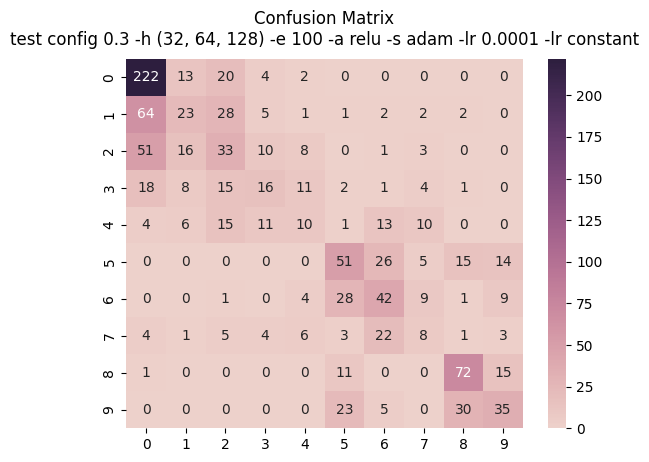

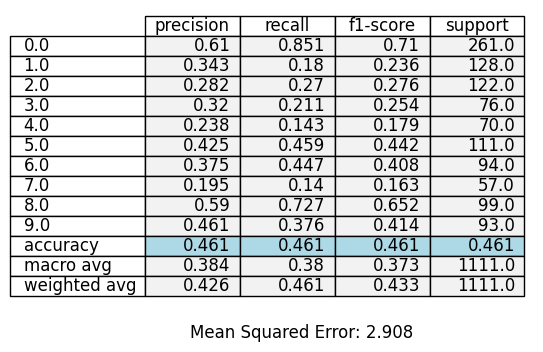

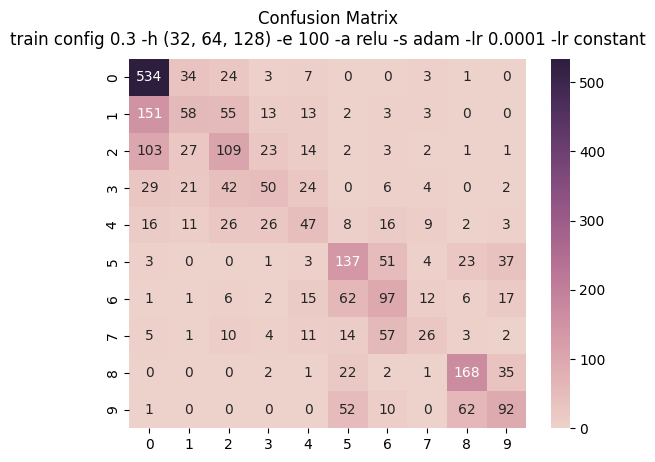

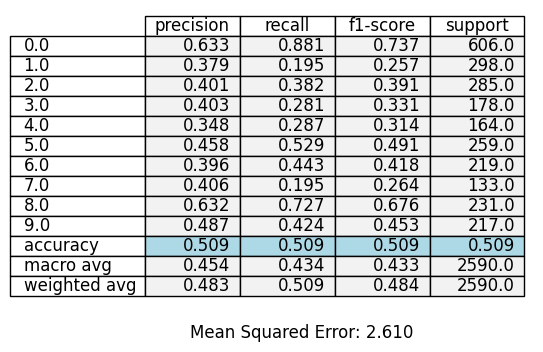

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


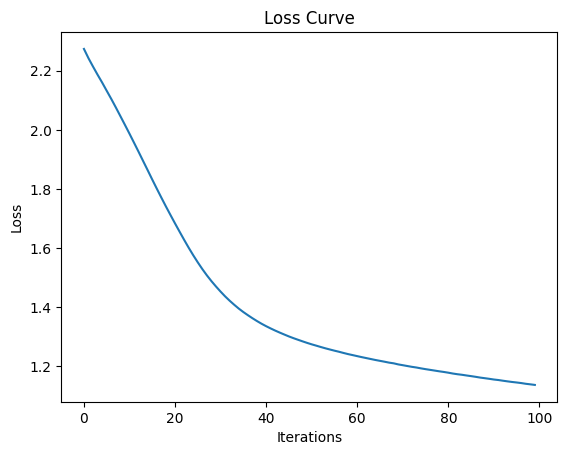

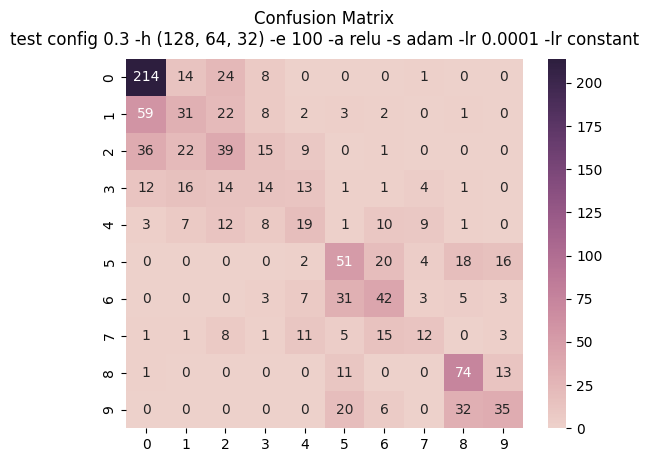

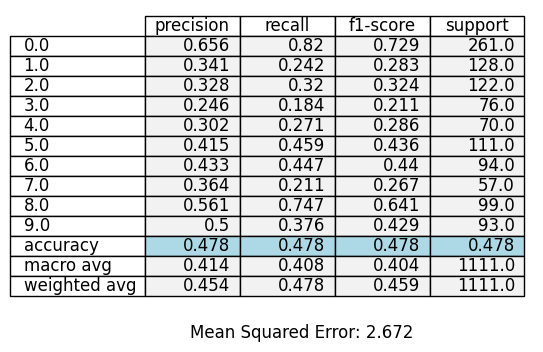

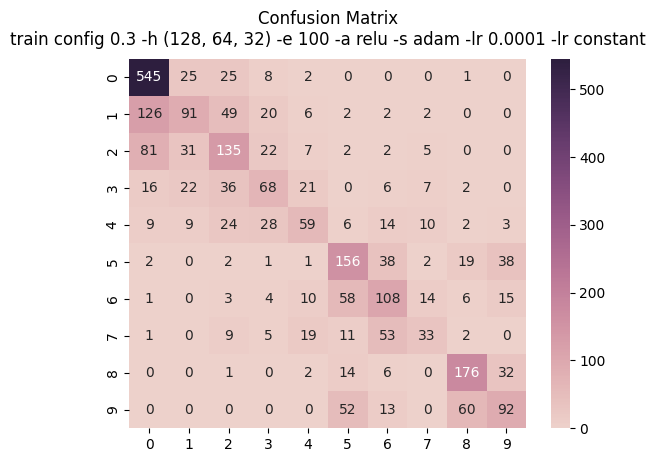

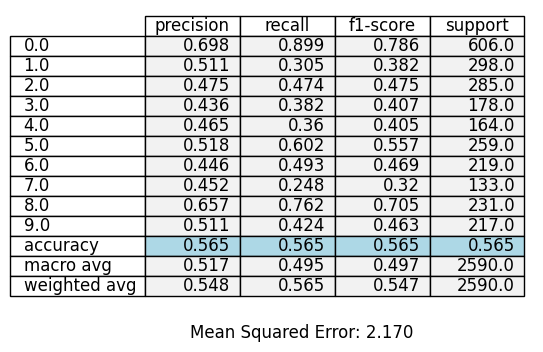

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


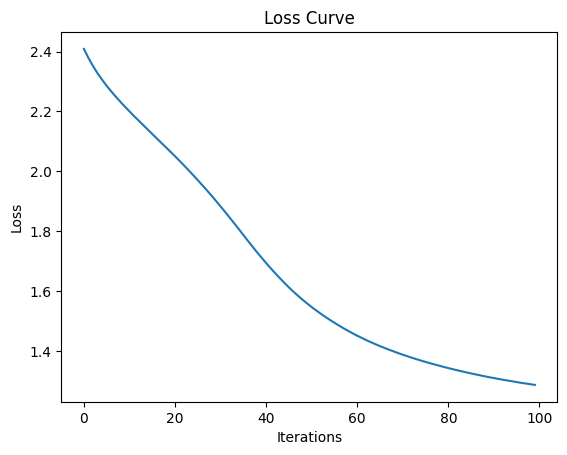

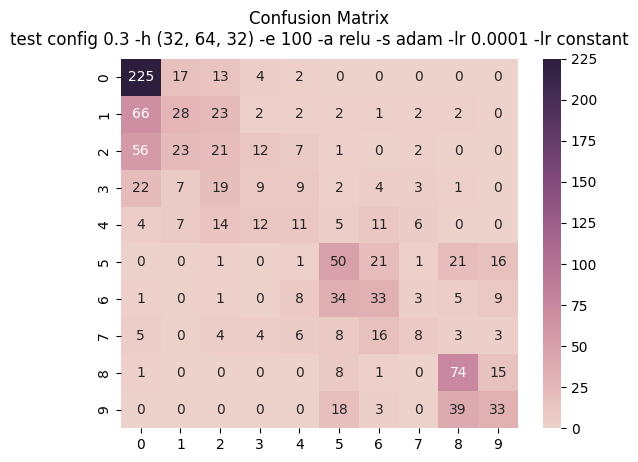

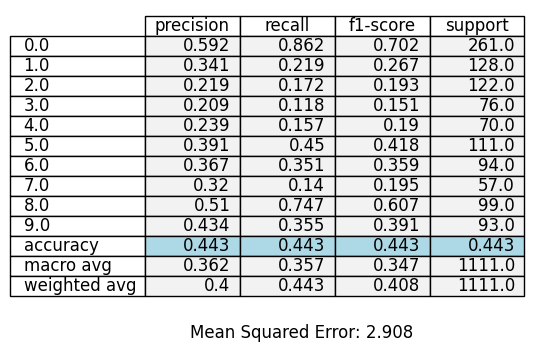

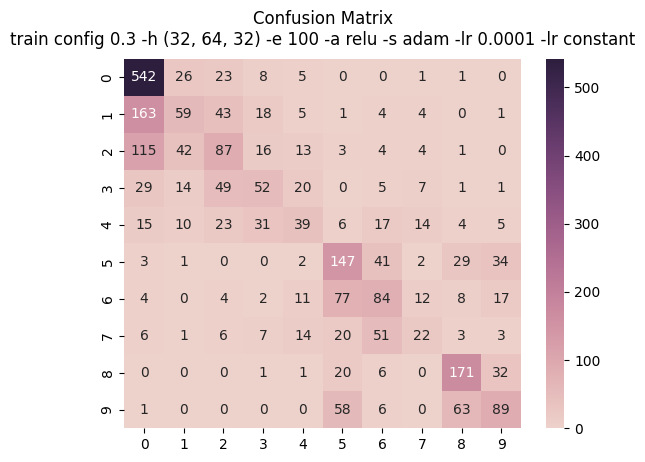

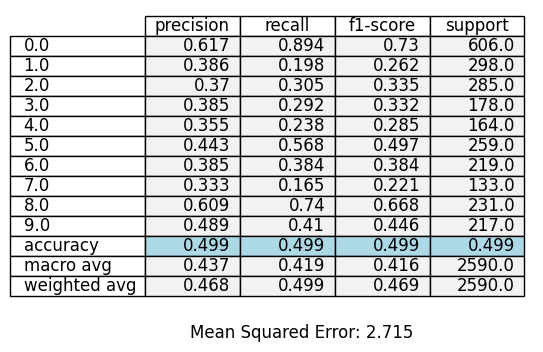

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


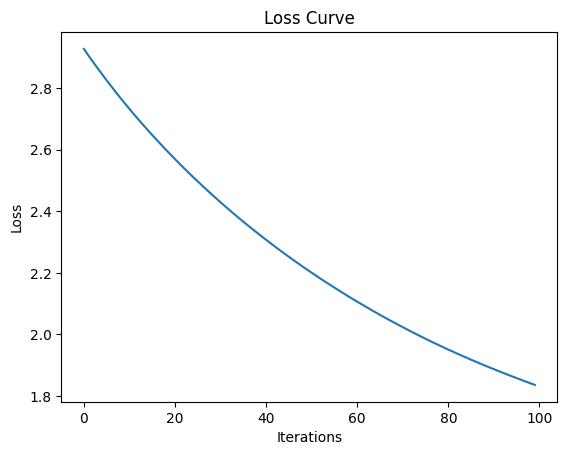

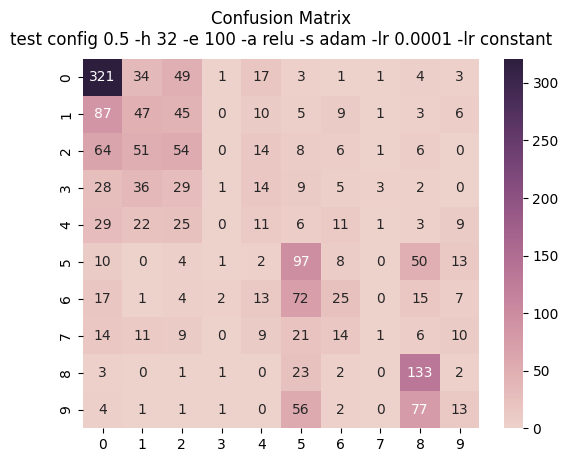

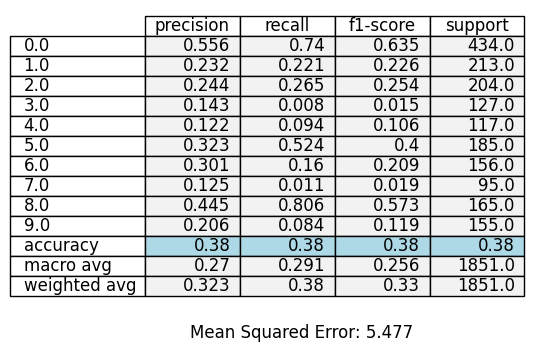

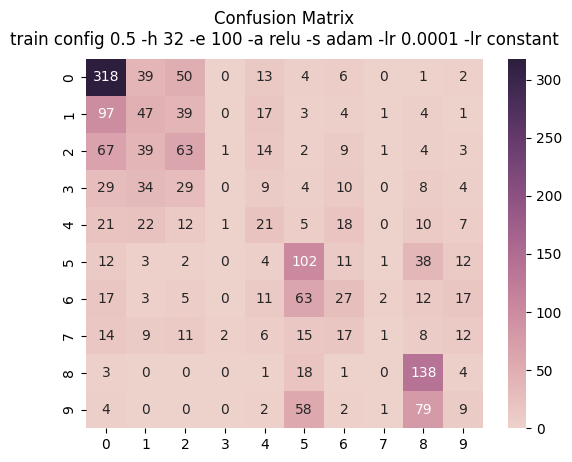

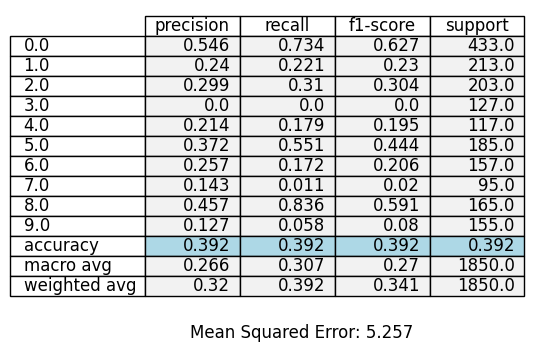

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


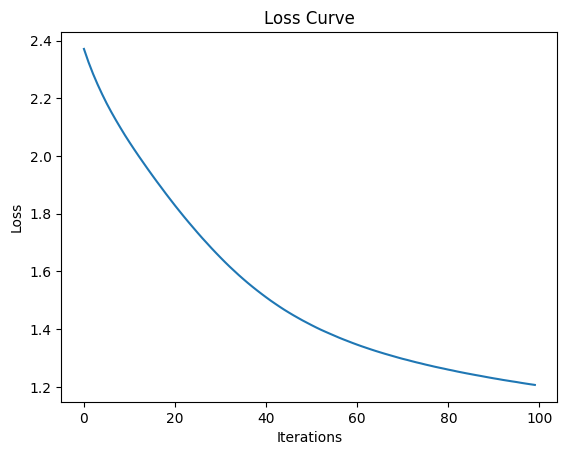

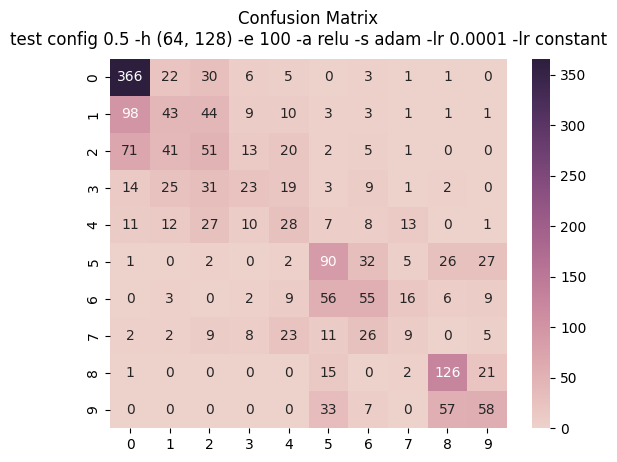

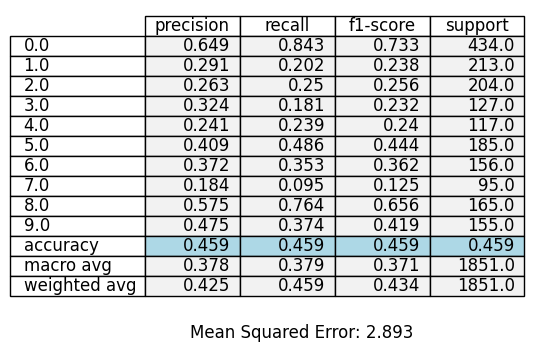

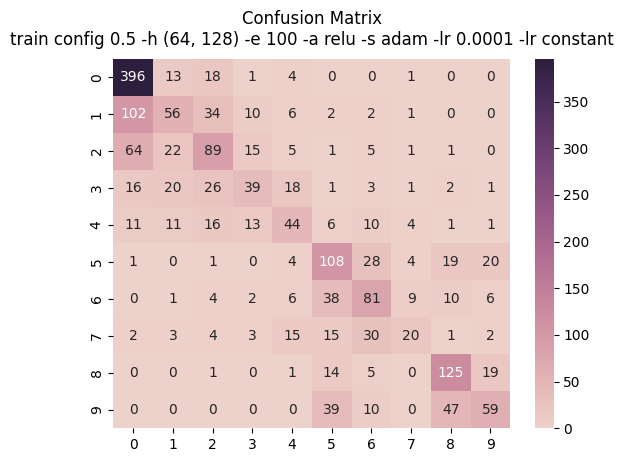

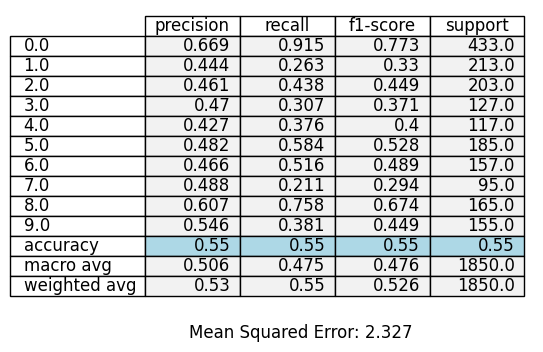

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


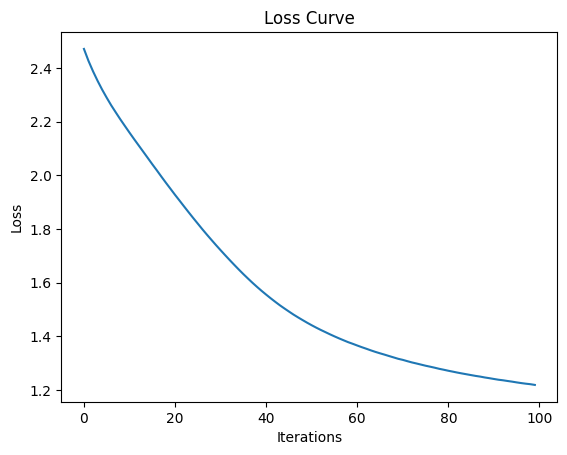

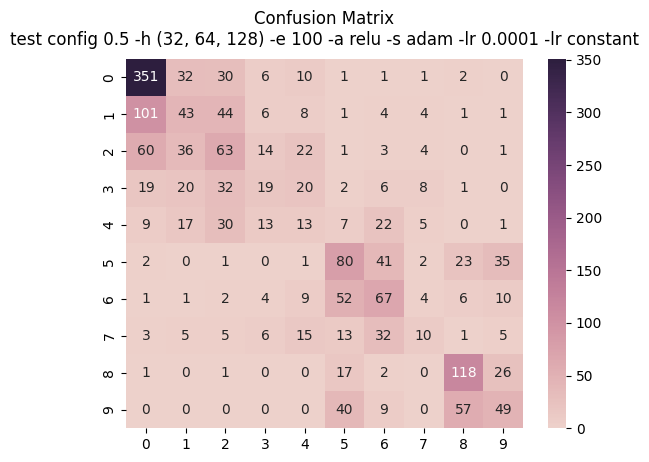

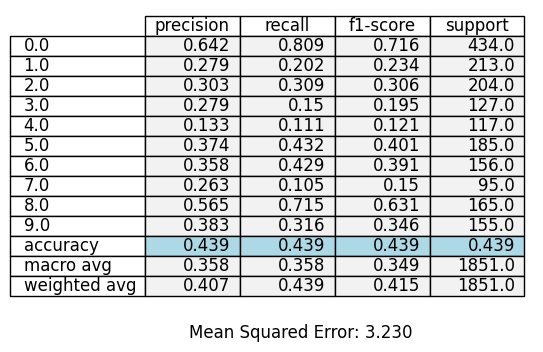

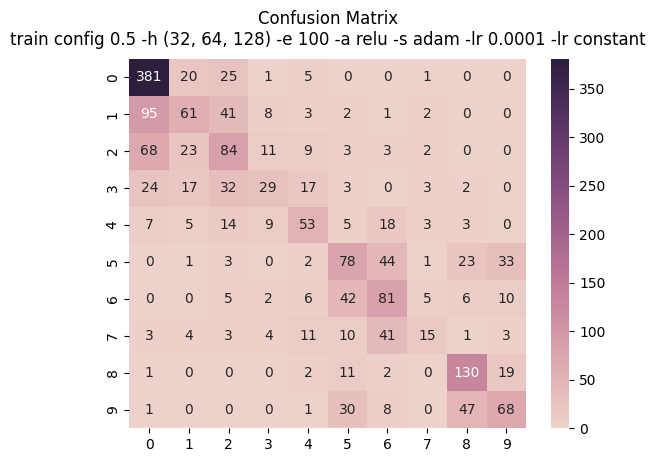

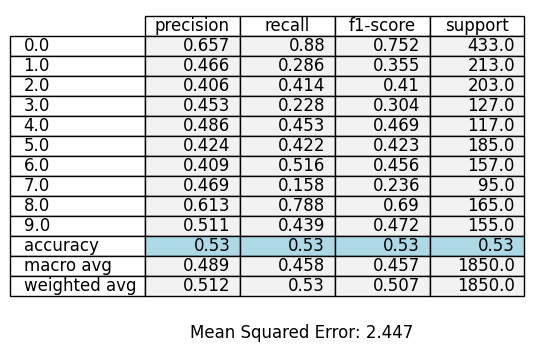

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


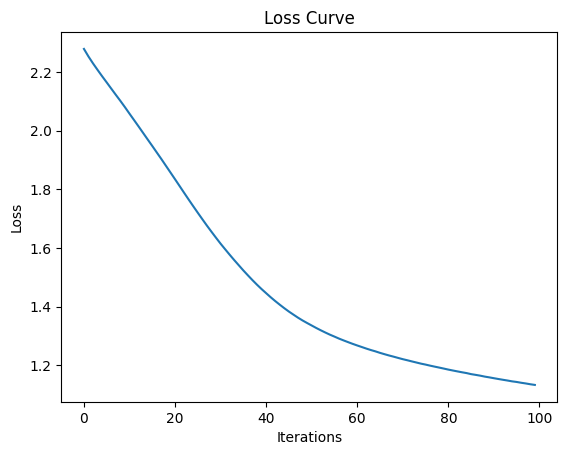

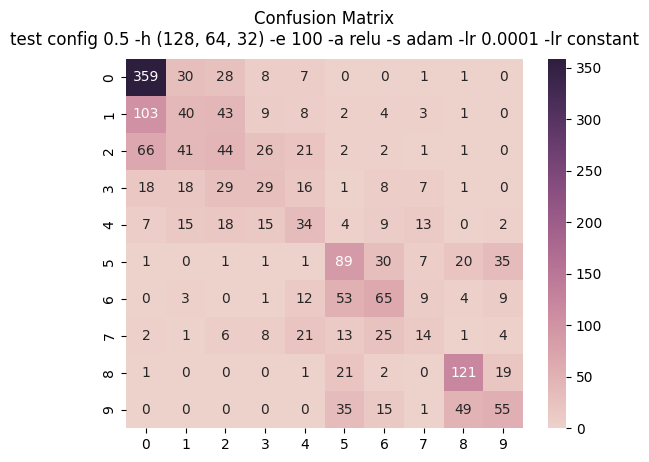

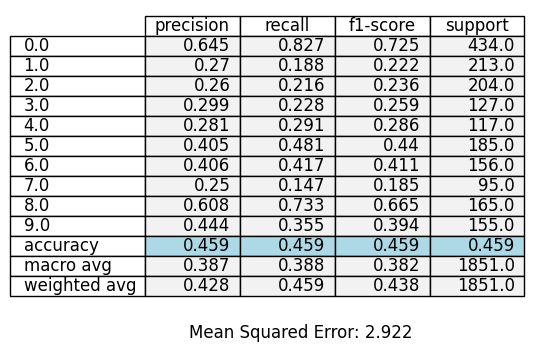

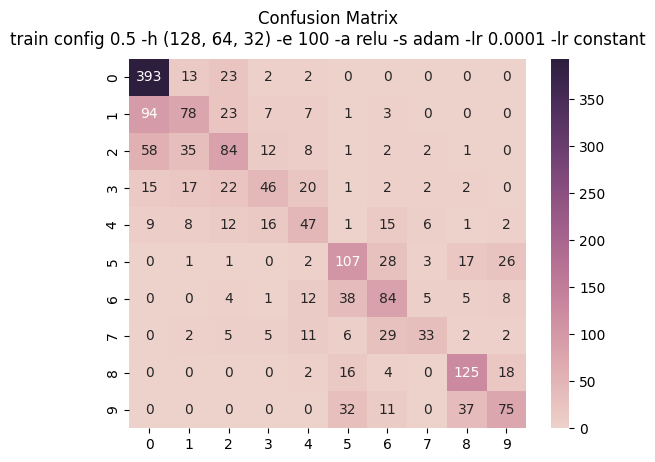

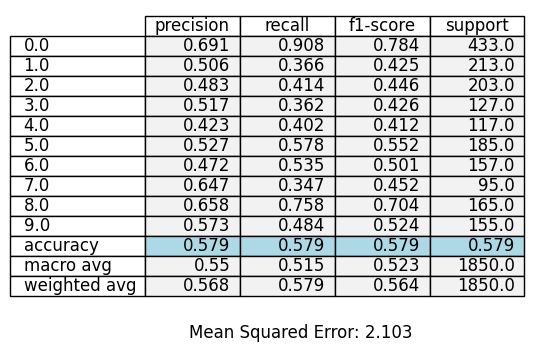

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


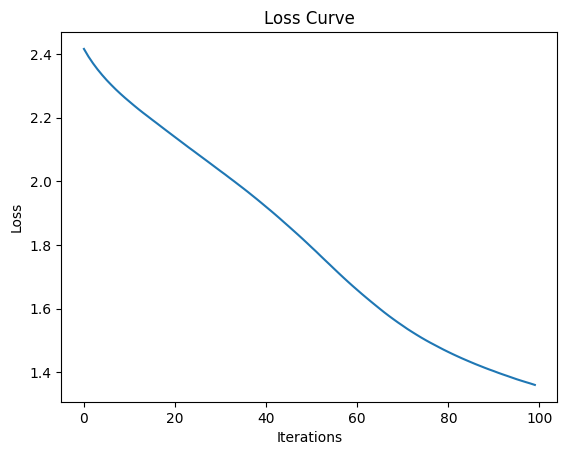

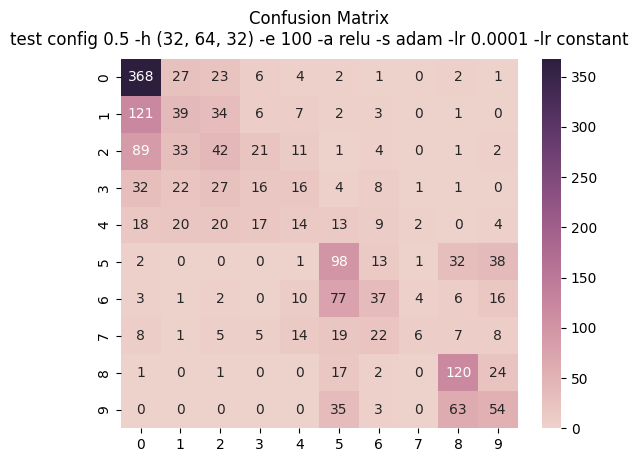

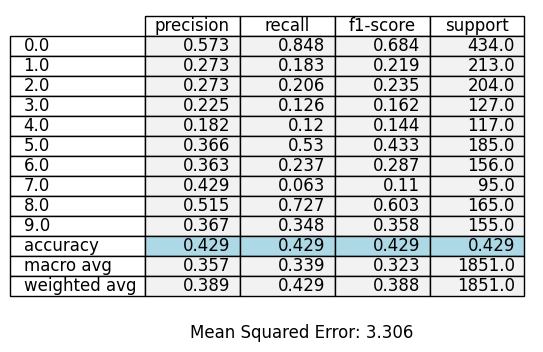

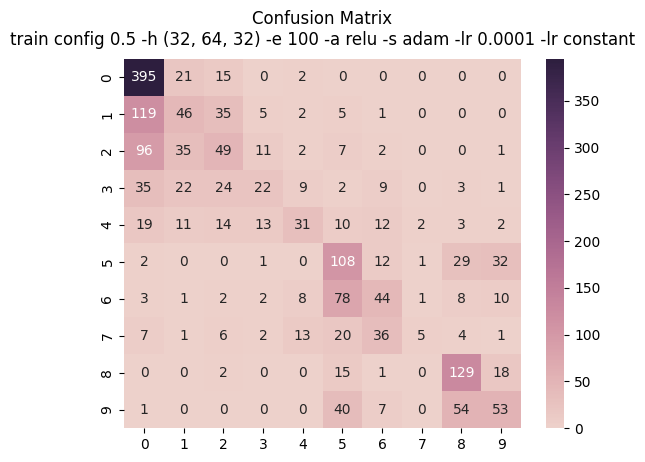

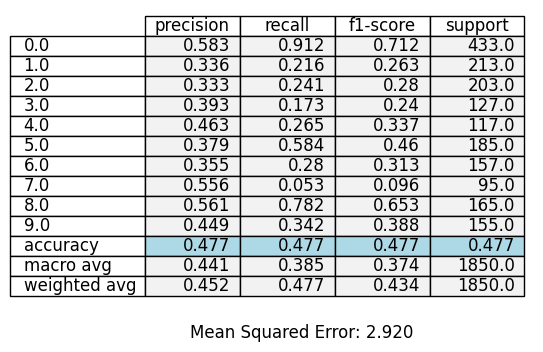

In [ ]:
best_accuracy = 0
best_config = None

config = [0.1, 0.3, 0.5]
jumlah_hidden = [(32), (64,128), (32,64,128), (128,64,32), (32,64,32)]

for i in config:
    x_train, x_test, y_train, y_test = train_test_split(features, label, test_size=i, random_state=42, stratify=label)

    scaler = StandardScaler()
    x_train = scaler.fit_transform(x_train)
    x_test = scaler.transform(x_test)

    x_train = pd.DataFrame(x_train)
    x_test = pd.DataFrame(x_test)

    correlation_matrix = pd.DataFrame(x_train).corr()

    upper_tri = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape),k=1).astype(bool))
    to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.9)]

    x_train = x_train.drop(x_train.columns[to_drop], axis=1)
    x_test = x_test.drop(x_test.columns[to_drop], axis=1)

    pca = PCA(n_components=0.95)
    pca.fit(x_train)
    x_train = pca.transform(x_train)
    x_test = pca.transform(x_test)

    for j in jumlah_hidden:
        #! edit mulai disini
        hidden_layer = j
        max_iter = 100
        activation = 'relu'
        solver = 'adam'
        random_state = 42
        learning_rate_init = 0.0001
        learning_rate = 'constant'
        mlp = MLPClassifier(hidden_layer_sizes=hidden_layer, max_iter=max_iter, activation=activation, solver=solver, random_state=random_state, learning_rate_init=learning_rate_init, learning_rate=learning_rate)
        mlp.fit(x_train, y_train)
        #! sampe sini

        accuracy = mlp.score(x_test, y_test)

        # Check if the current accuracy is the best
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_config = {
                'config': i,
                'epoch': max_iter,
                'hidden_layer': j,
                'activation': activation,
                'solver': solver,
                'learning_rate_init': learning_rate_init,
                'learning_rate': learning_rate
            }

        plt.plot(mlp.loss_curve_)
        plt.title('Loss Curve')
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.show()

        predict = mlp.predict(x_test)
        confussion_matrix = confusion_matrix(y_test, predict)
        plot_cm(confussion_matrix, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model1_report = classification_report(y_test, predict, output_dict=True)
        report1 = pd.DataFrame(model1_report).transpose()
        report1 = report1.round(3)
        mse_value1 = mean_squared_error(y_test, predict)
        report_maker(report1, mse_value1, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)


        predict = mlp.predict(x_train)
        confusion_matrix_result = confusion_matrix(y_train, predict)
        plot_cm(confusion_matrix_result, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model_report = classification_report(y_train, predict, output_dict=True)
        report = pd.DataFrame(model_report).transpose()
        report = report.round(3)
        mse_value = mean_squared_error(y_train, predict)
        report_maker(report, mse_value, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)

In [ ]:
best_accuracy, best_config

(0.47794779477947796,
 {'config': 0.3,
  'epoch': 100,
  'hidden_layer': (128, 64, 32),
  'activation': 'relu',
  'solver': 'adam',
  'learning_rate_init': 0.0001,
  'learning_rate': 'constant'})

### Unit Hidden Layer

In [ ]:
epoch_dir = 'unit-hidden-layer'

cm_epoch_dir = os.path.join(cm_dir, epoch_dir)
if not os.path.exists(cm_epoch_dir):
    os.makedirs(cm_epoch_dir)

report_epoch_dir = os.path.join(report_dir, epoch_dir)
if not os.path.exists(report_epoch_dir):
    os.makedirs(report_epoch_dir)

cmdir = os.path.relpath(cm_epoch_dir, start=main_dir)
cmdir = cmdir.replace(os.path.sep, '/')

rpdir = os.path.relpath(report_epoch_dir, start=main_dir)
rpdir = rpdir.replace(os.path.sep, '/')
    

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


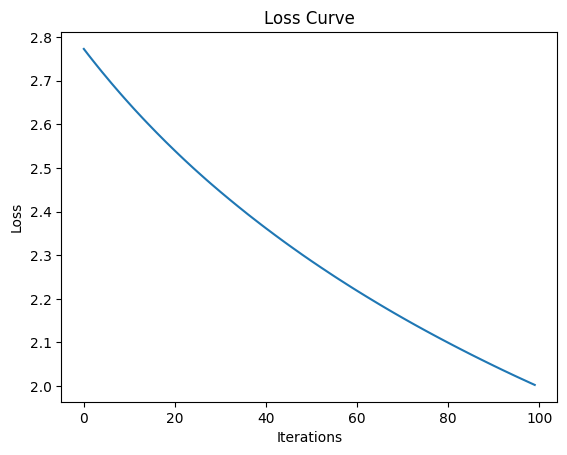

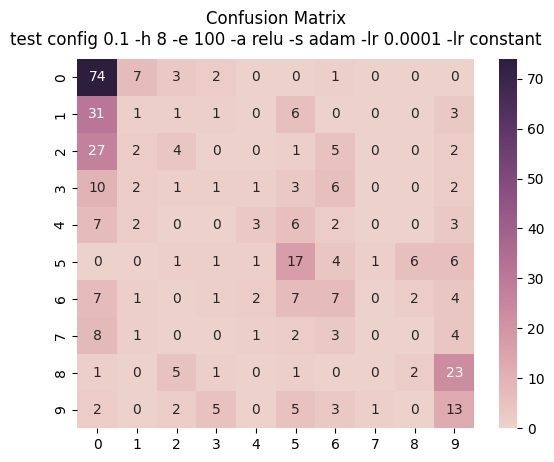

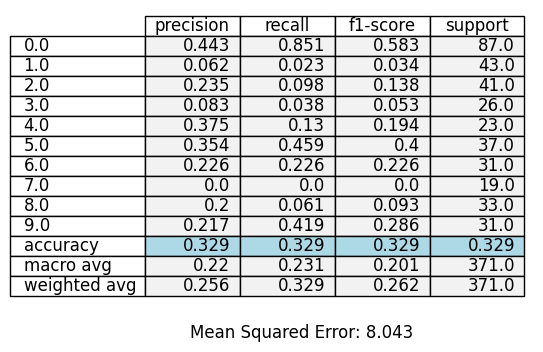

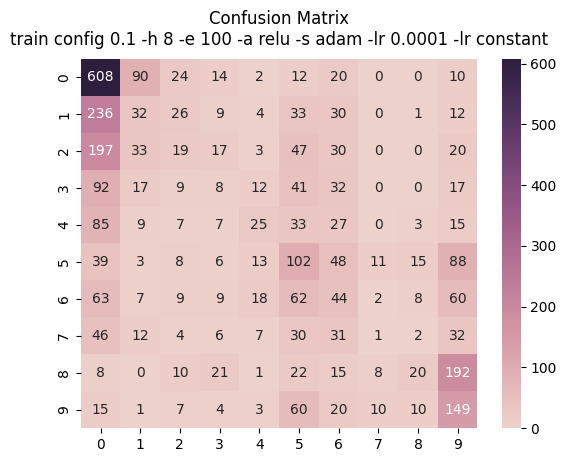

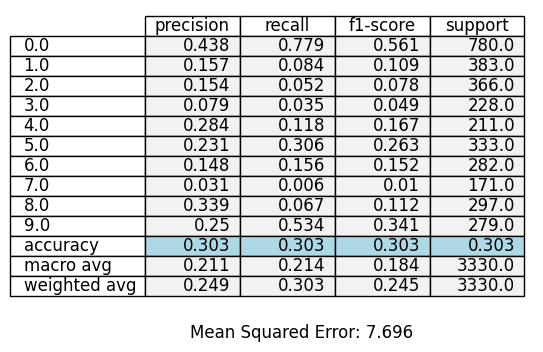

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


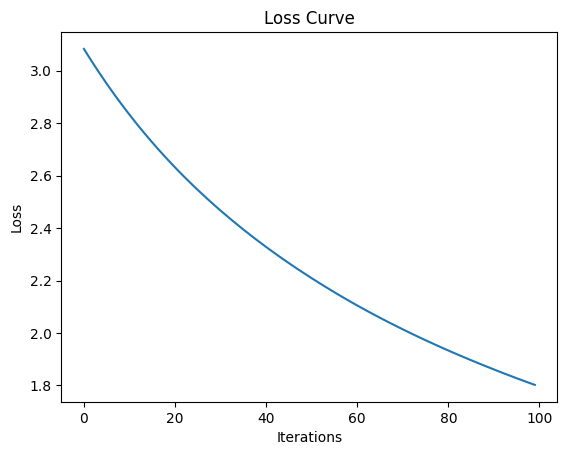

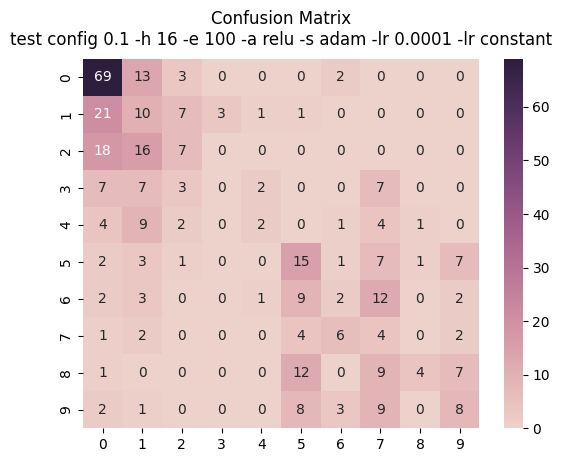

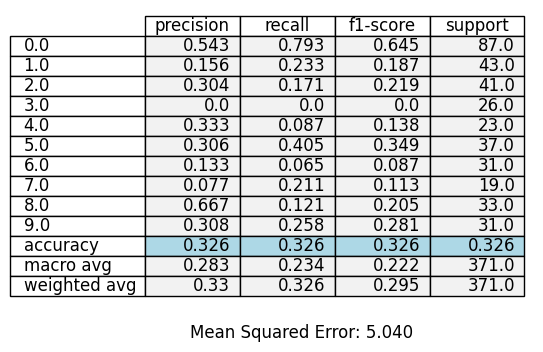

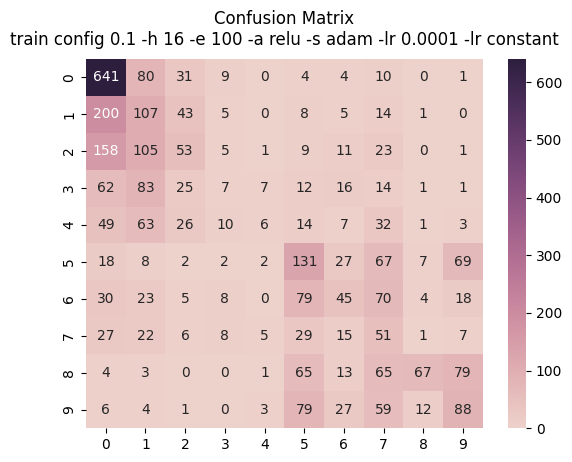

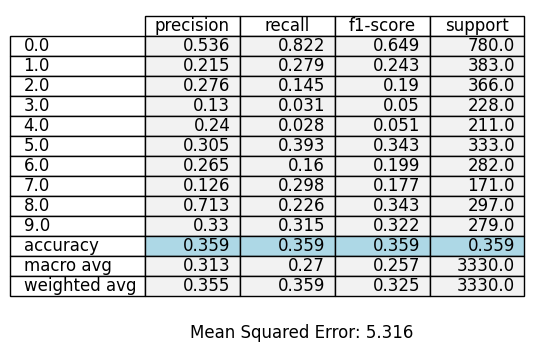

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


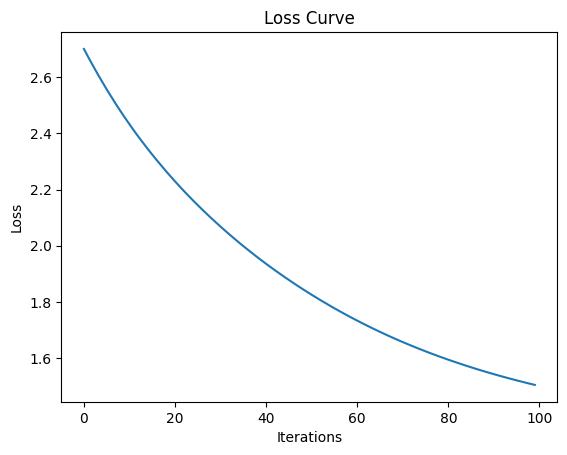

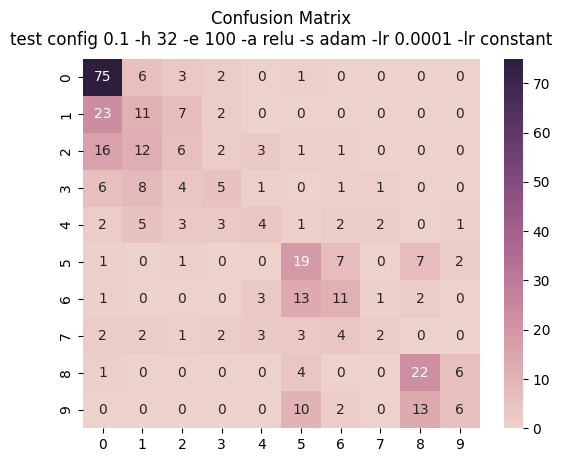

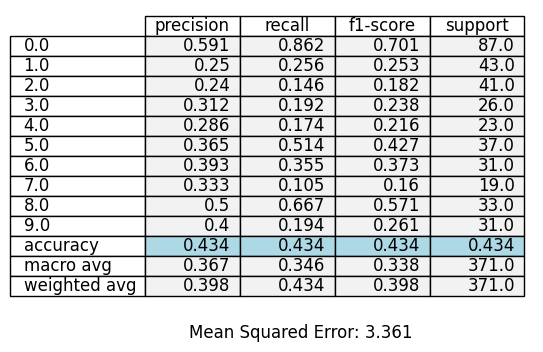

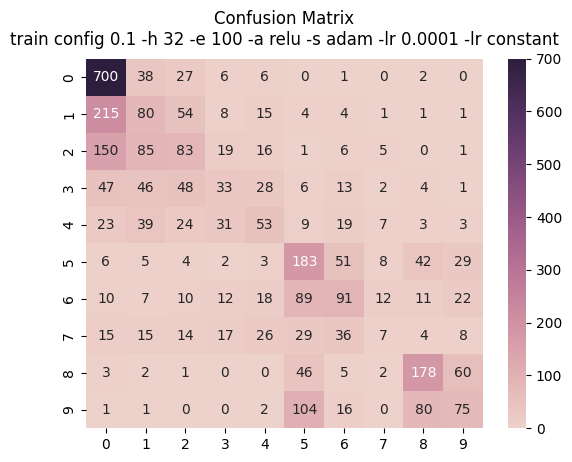

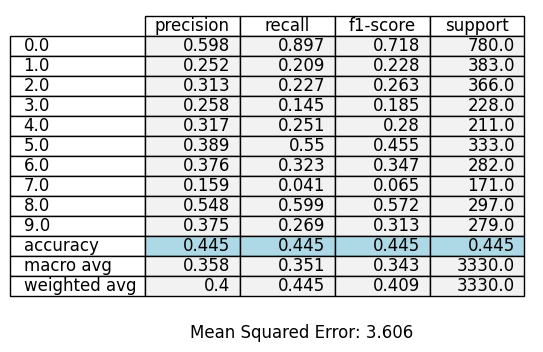

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


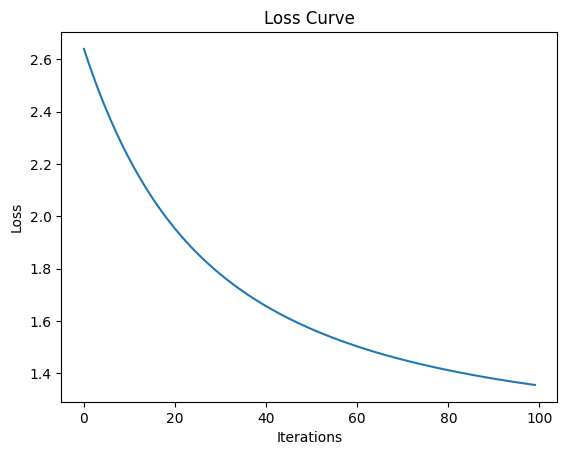

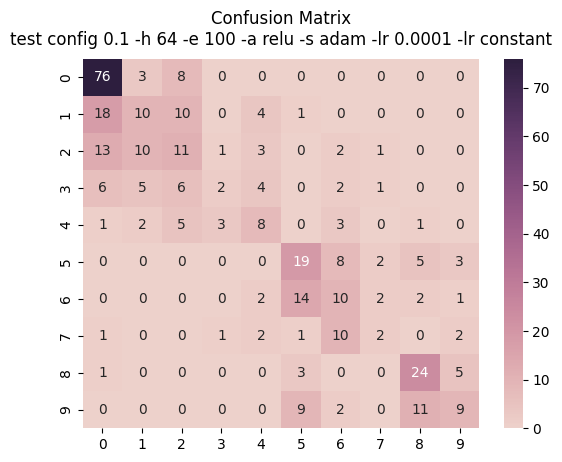

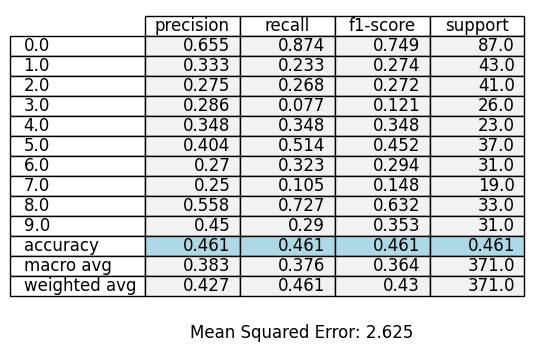

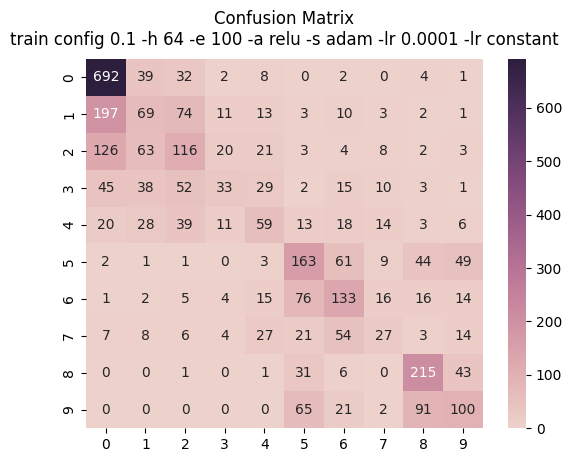

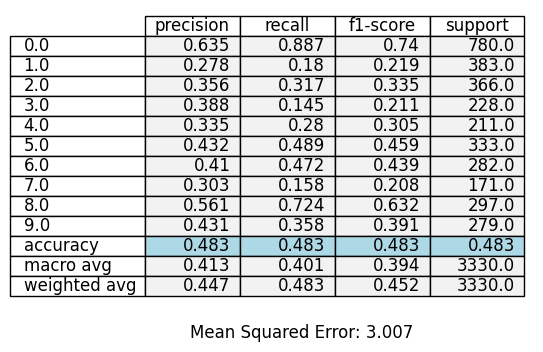

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


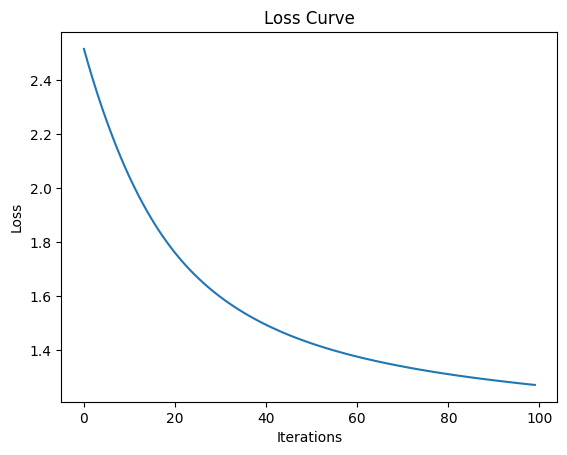

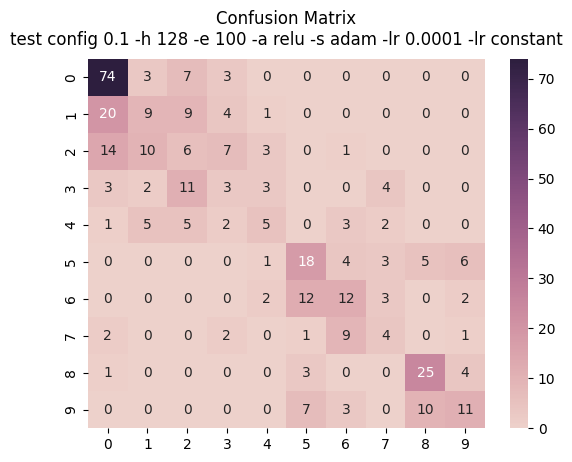

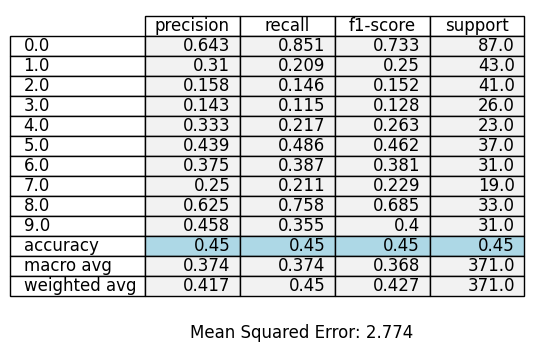

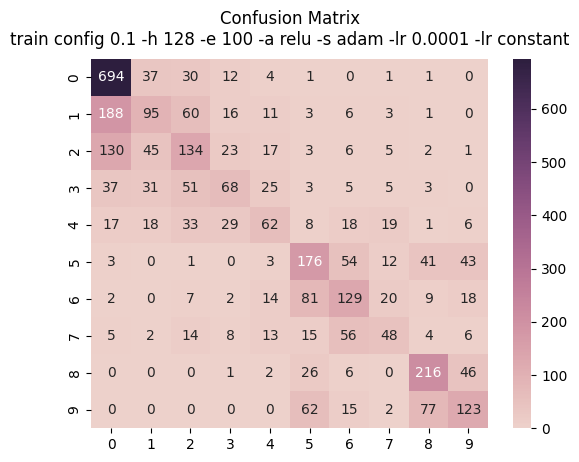

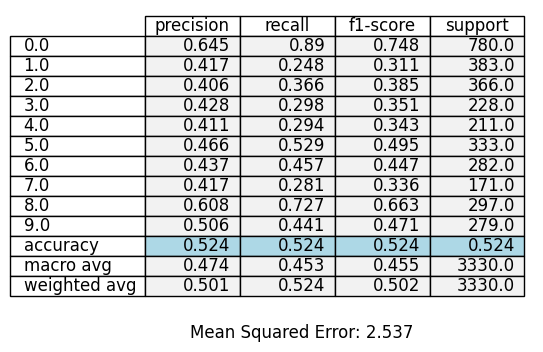

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


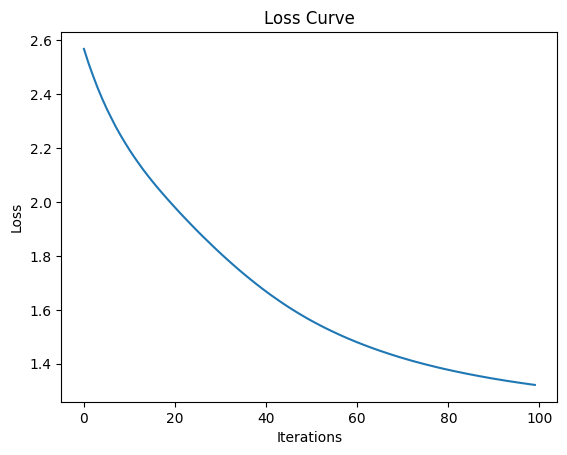

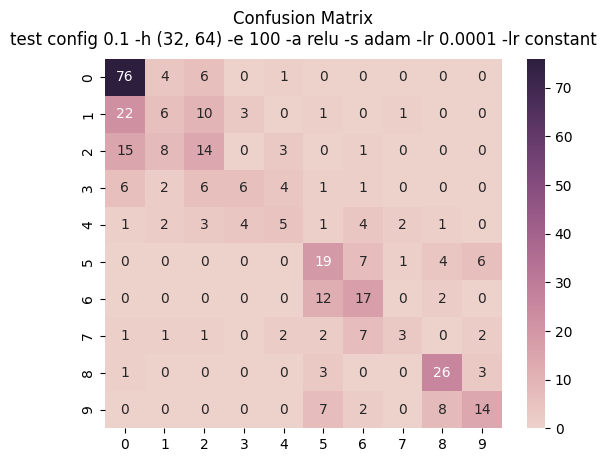

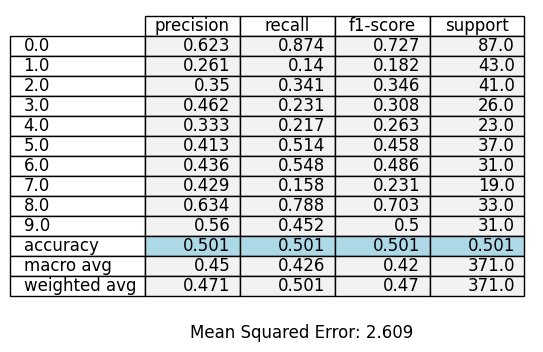

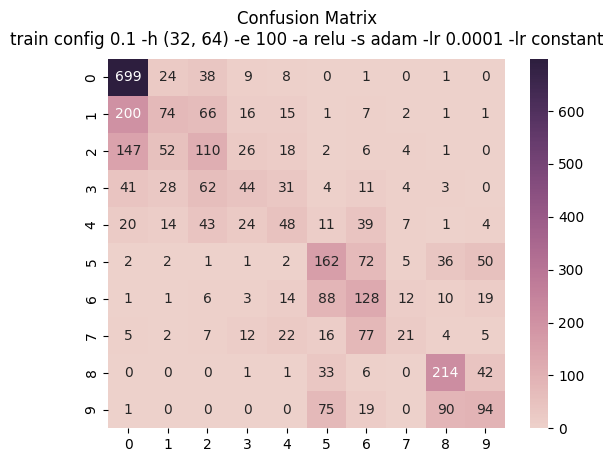

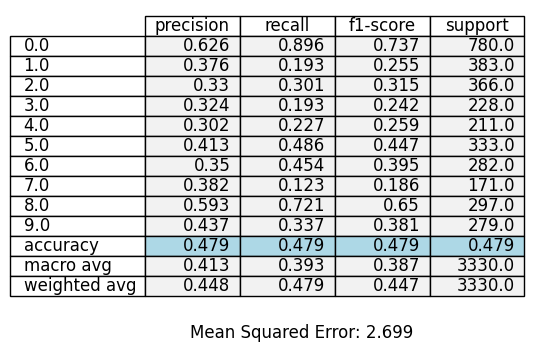

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


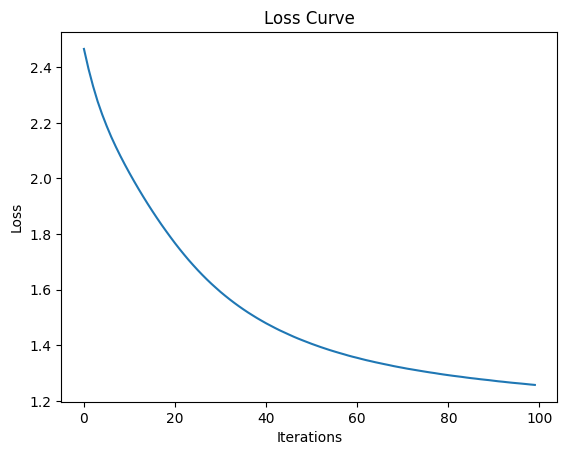

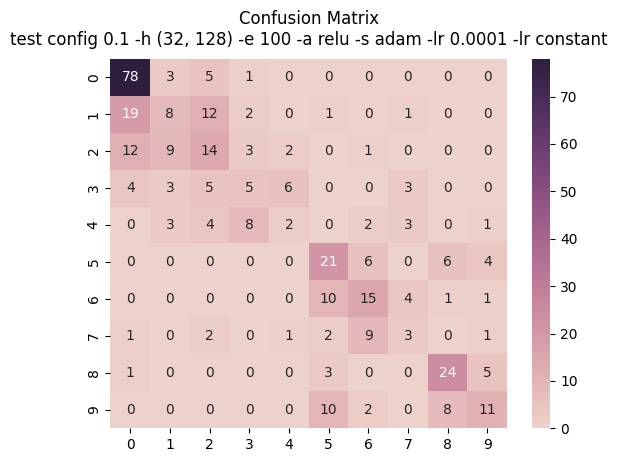

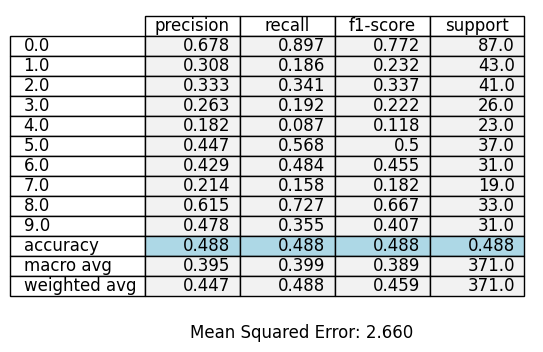

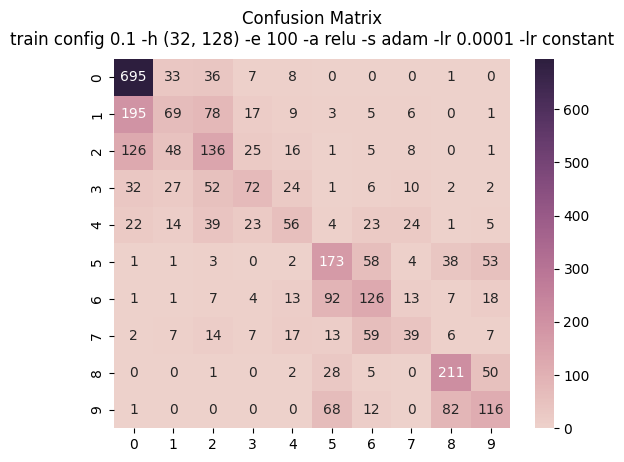

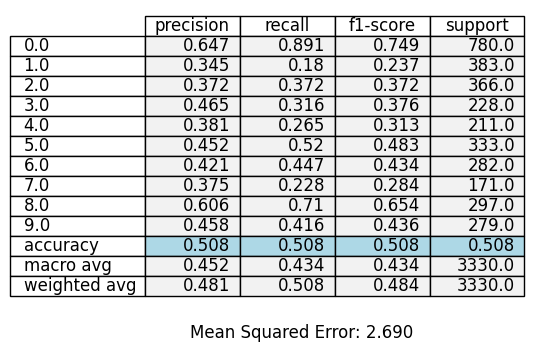

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


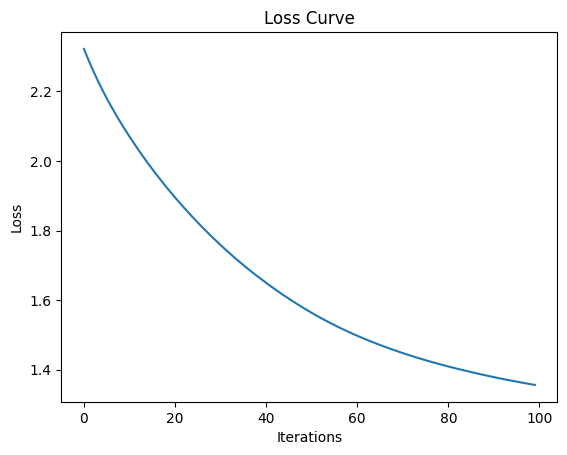

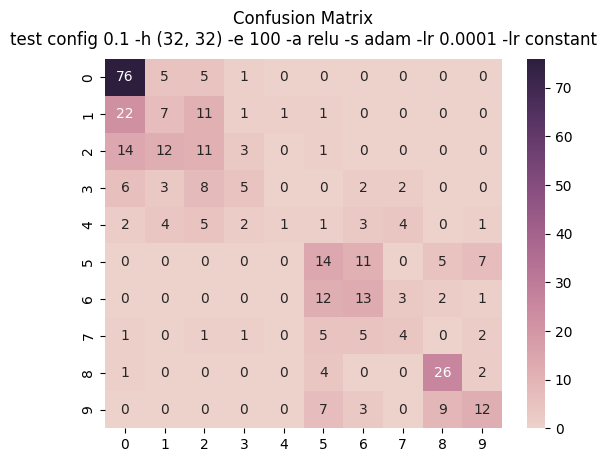

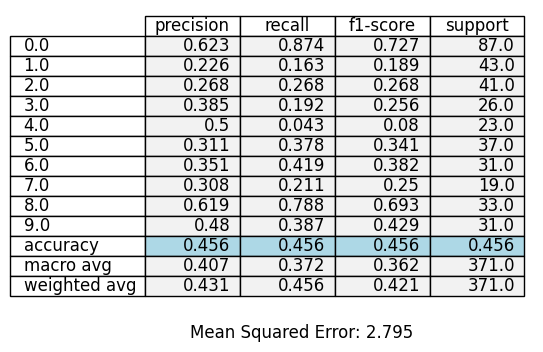

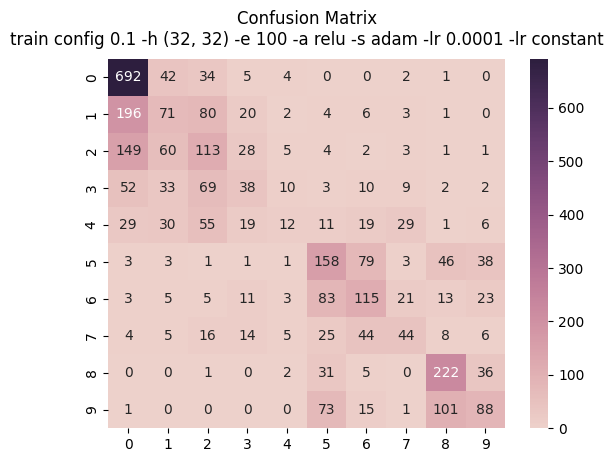

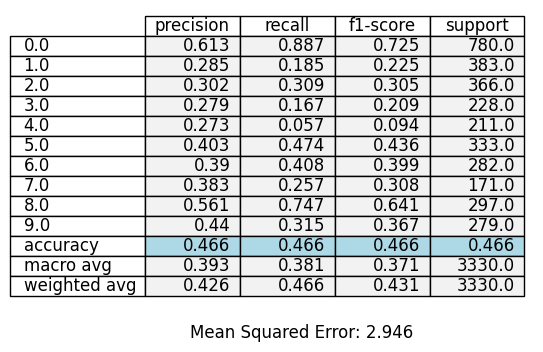

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


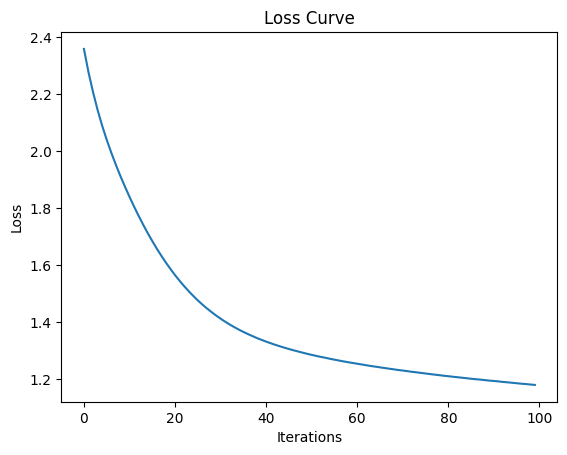

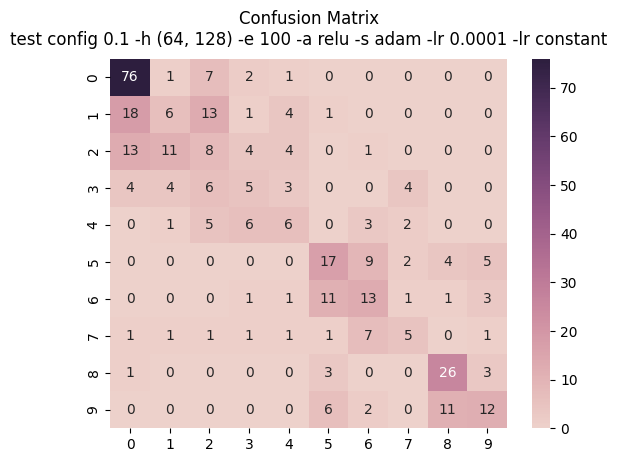

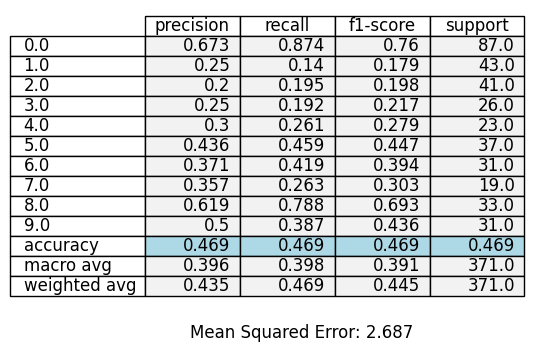

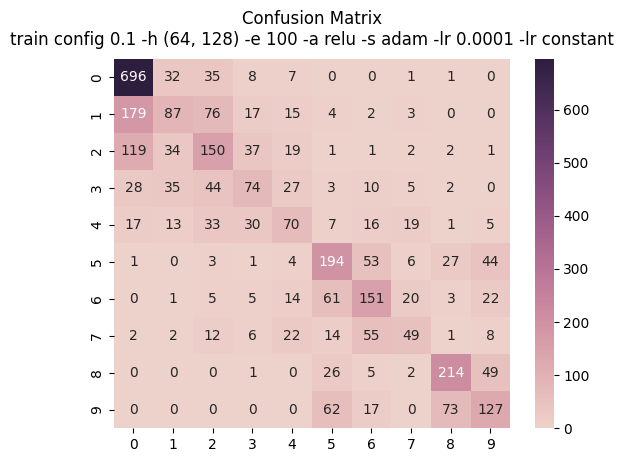

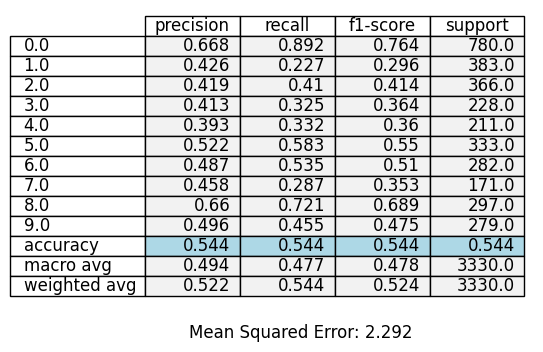

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


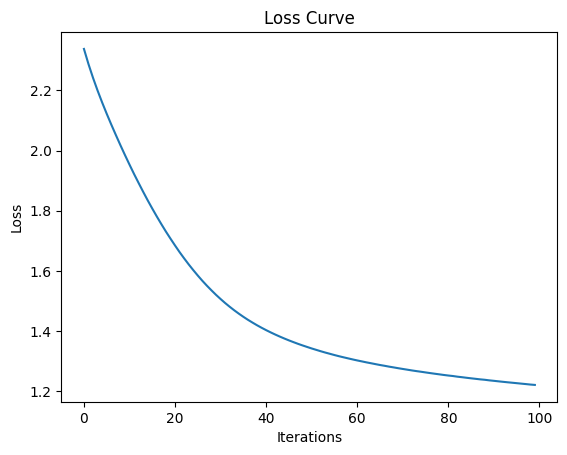

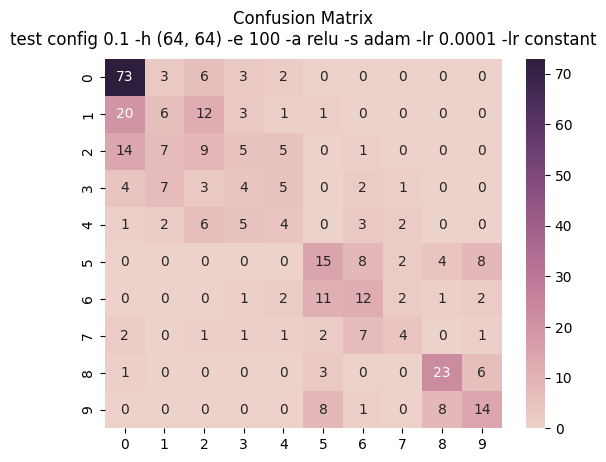

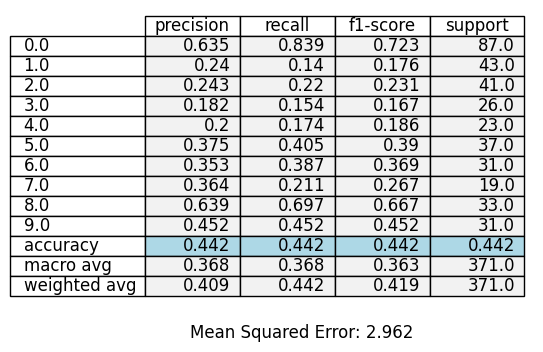

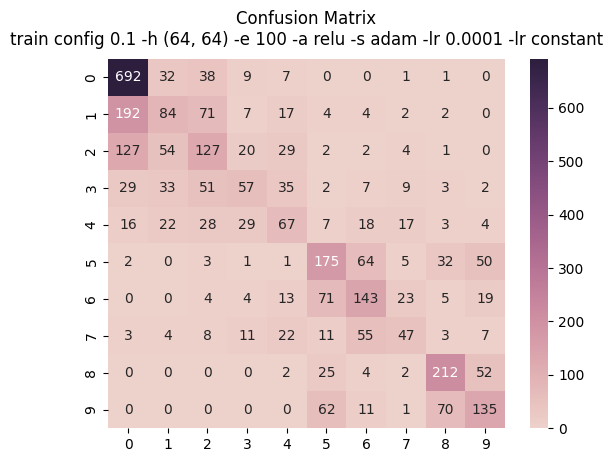

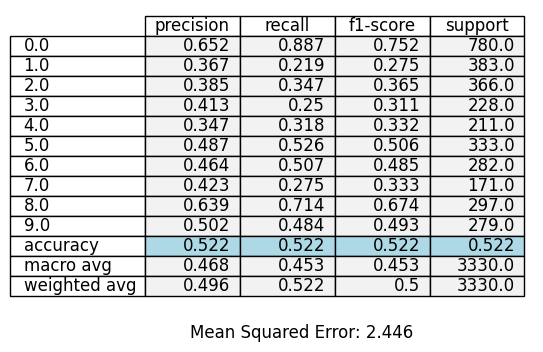

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


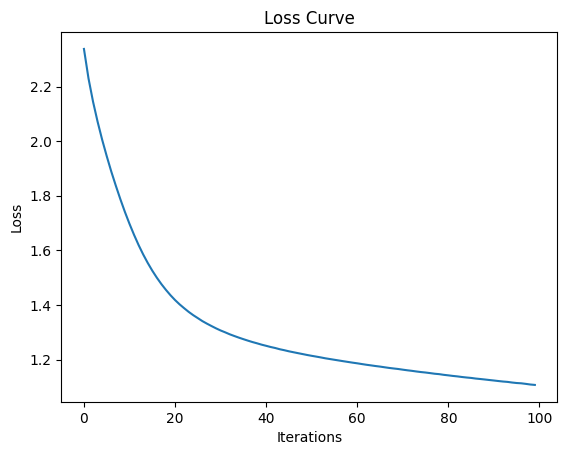

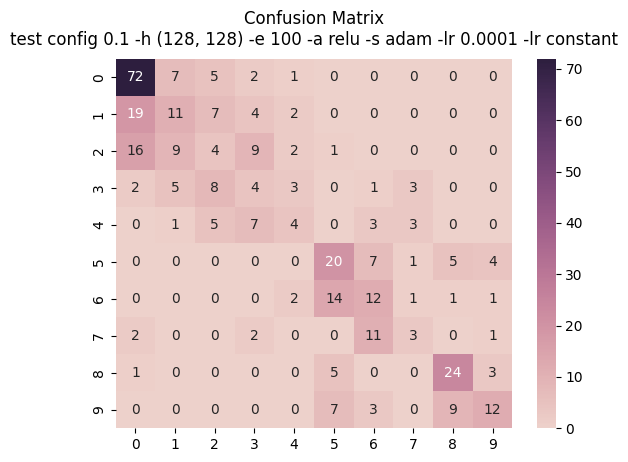

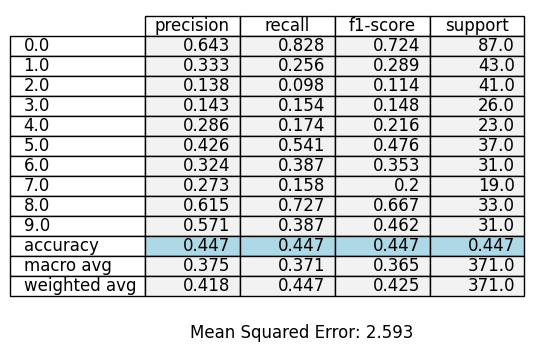

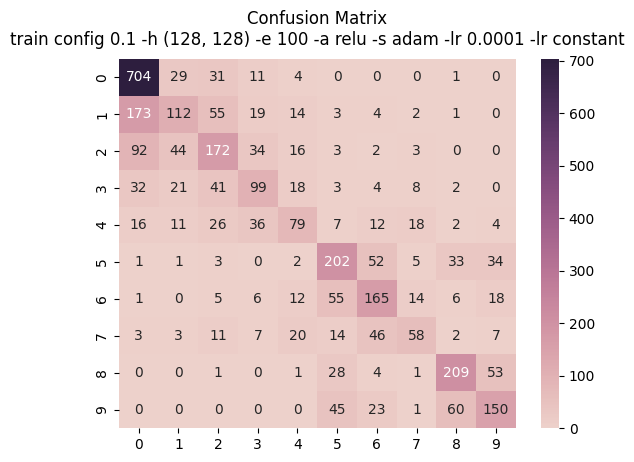

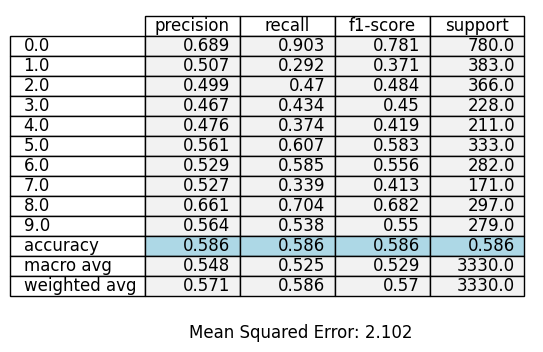

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


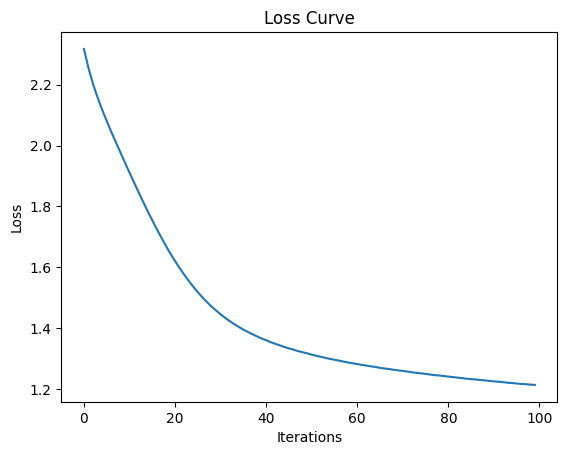

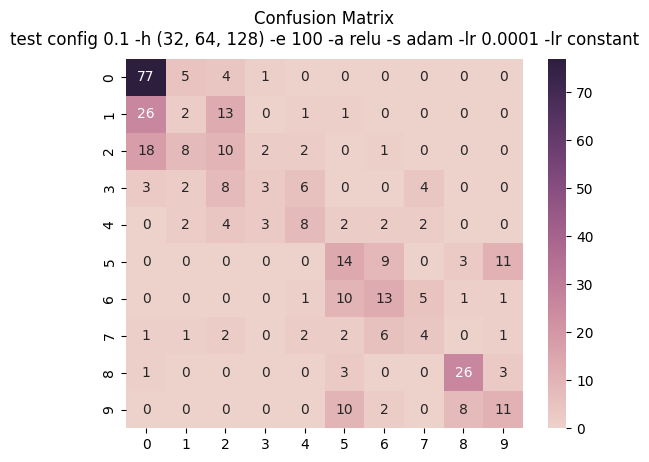

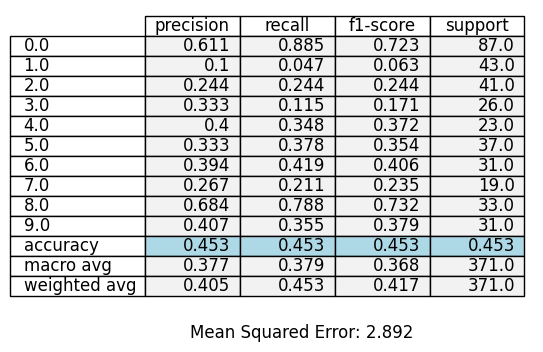

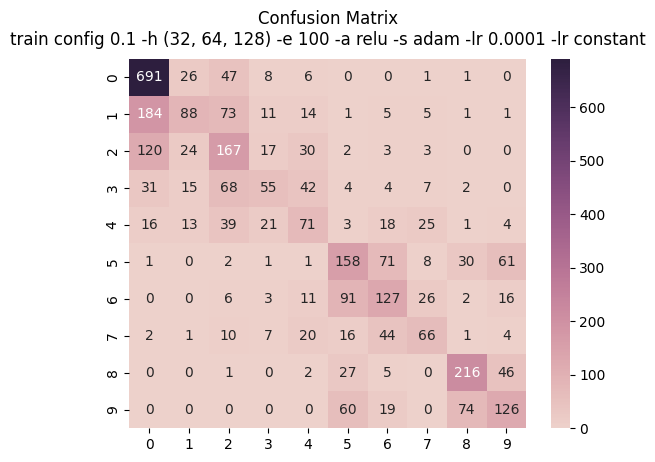

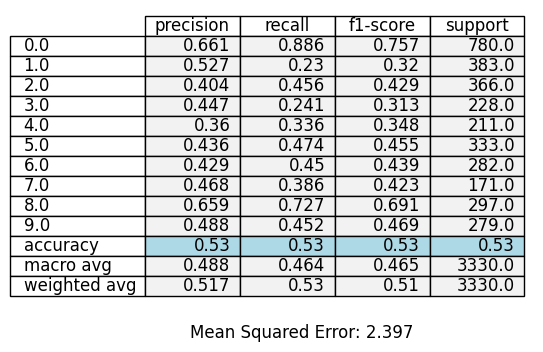

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


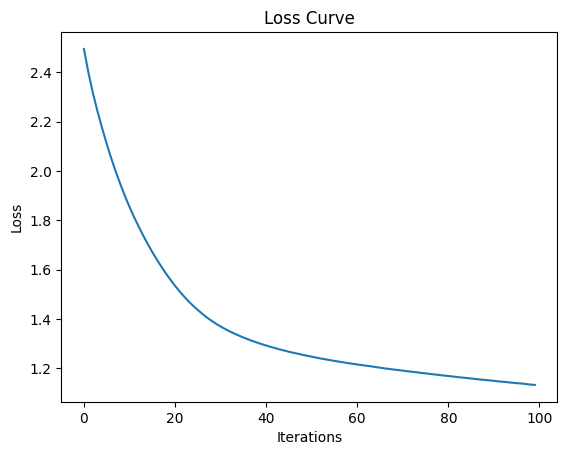

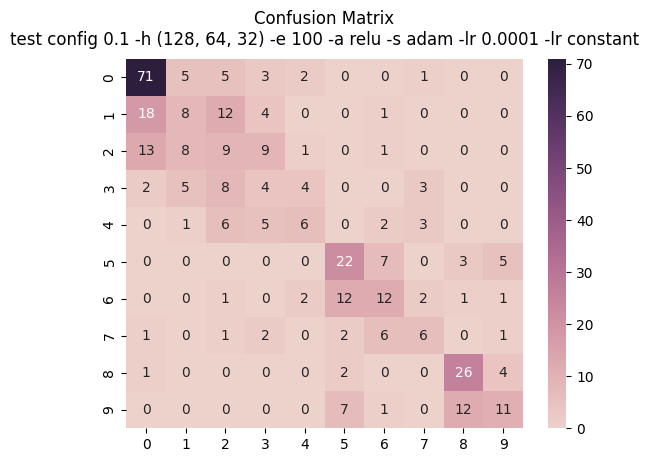

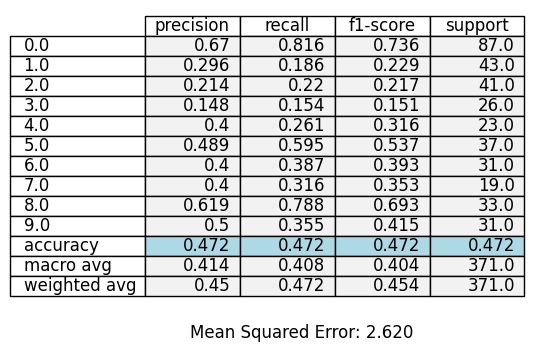

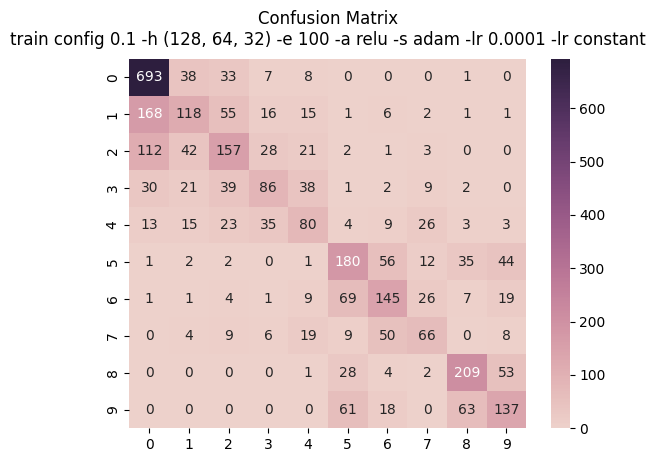

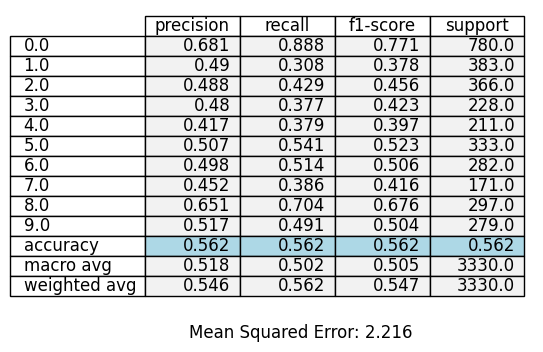

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


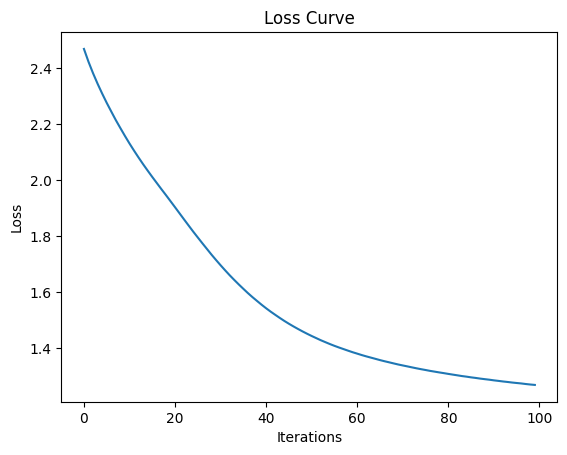

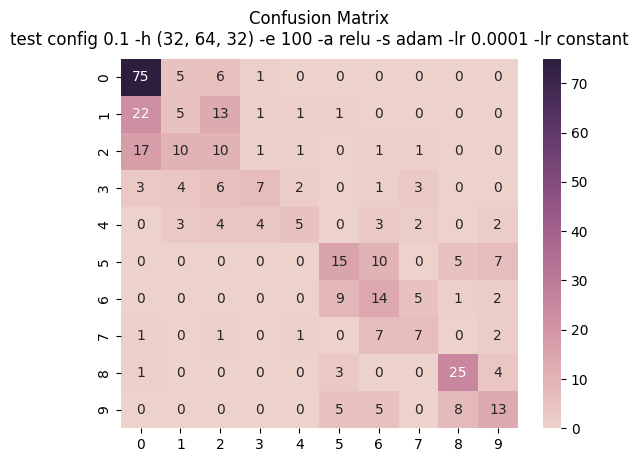

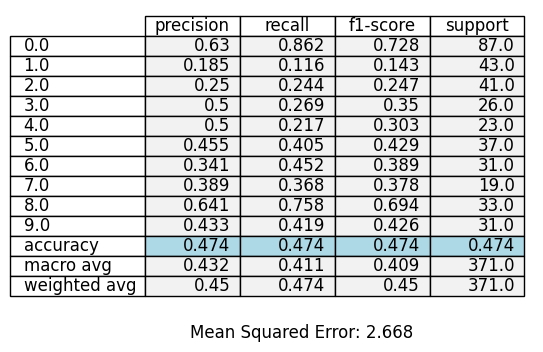

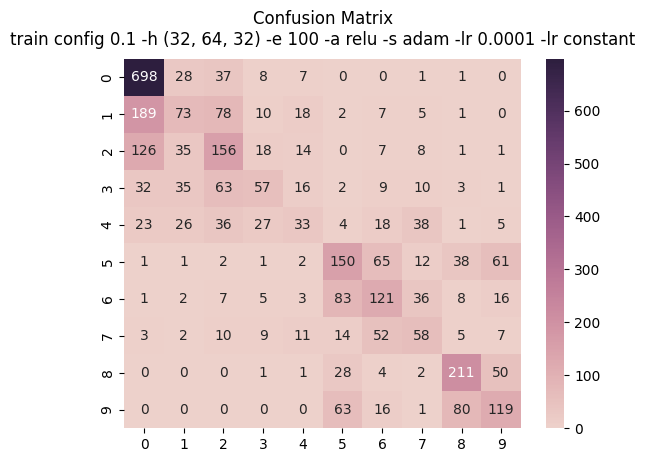

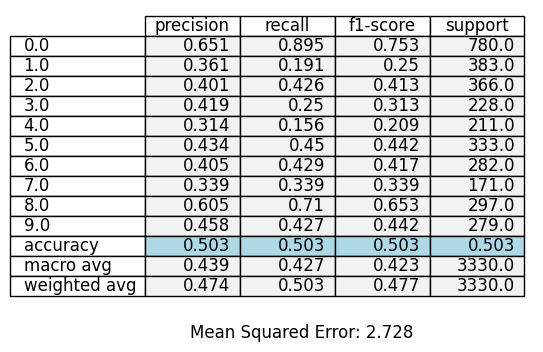

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


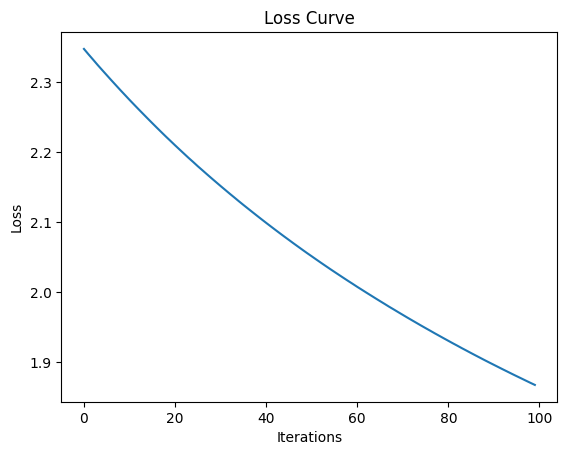

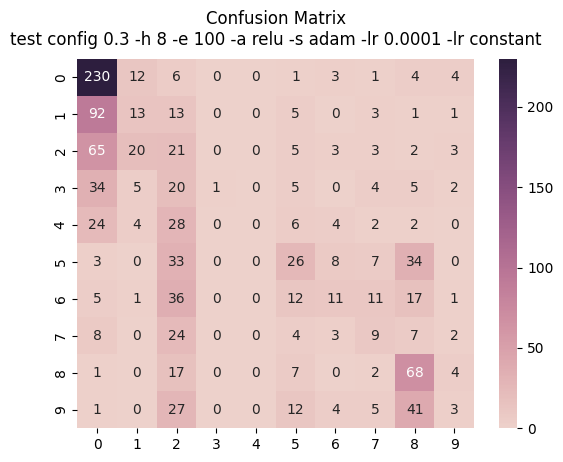

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


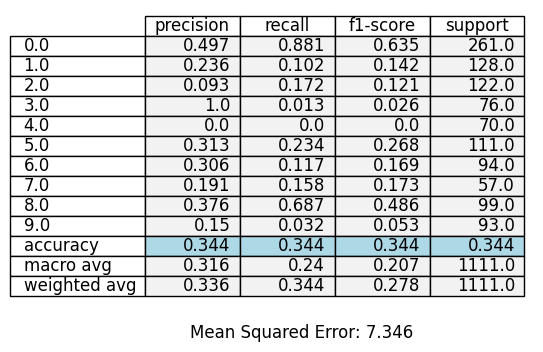

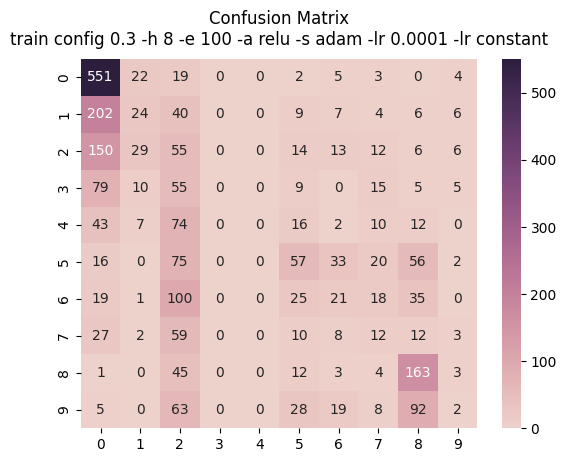

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


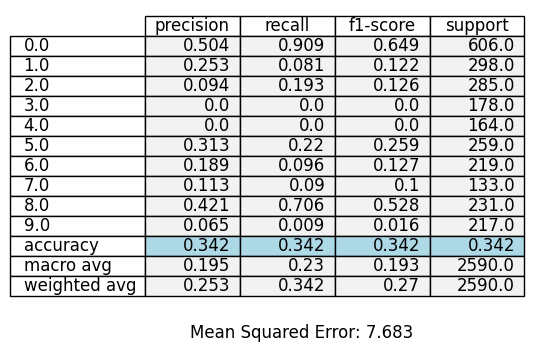

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


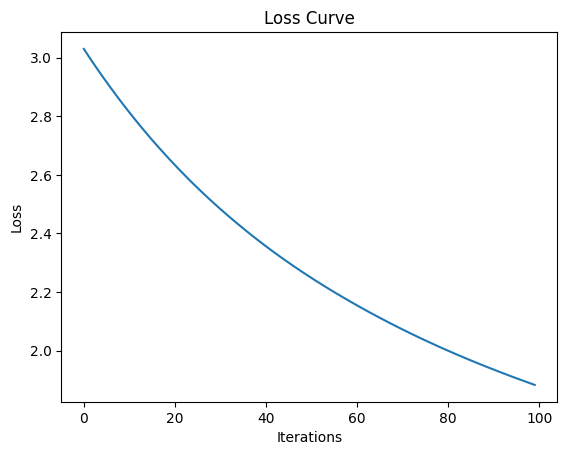

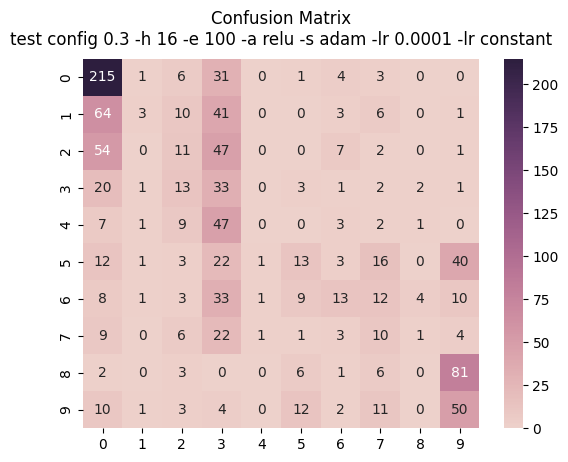

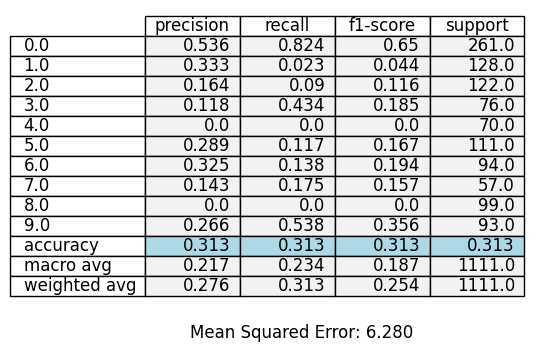

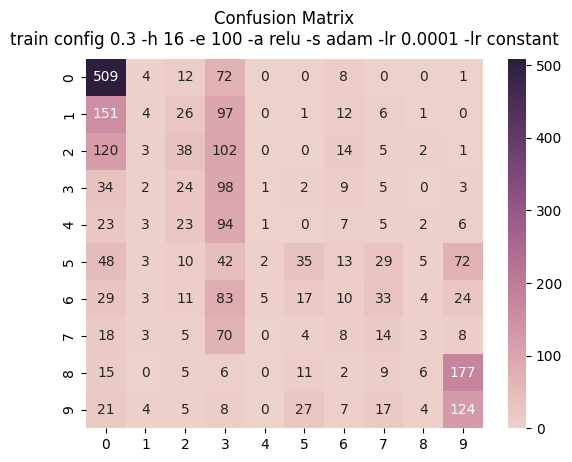

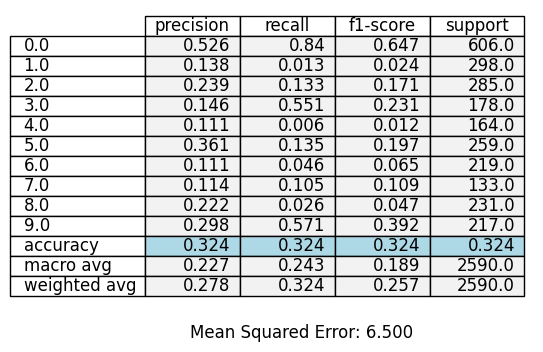

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


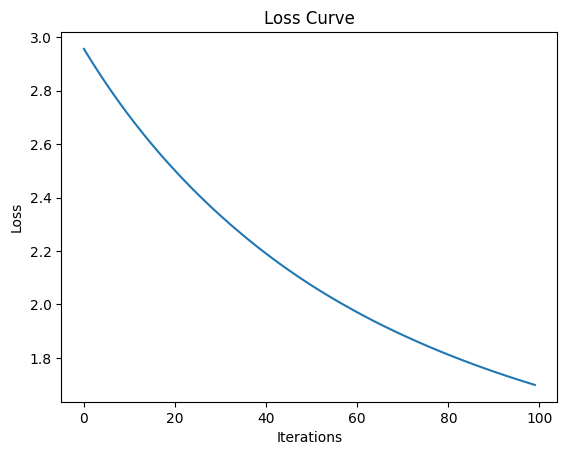

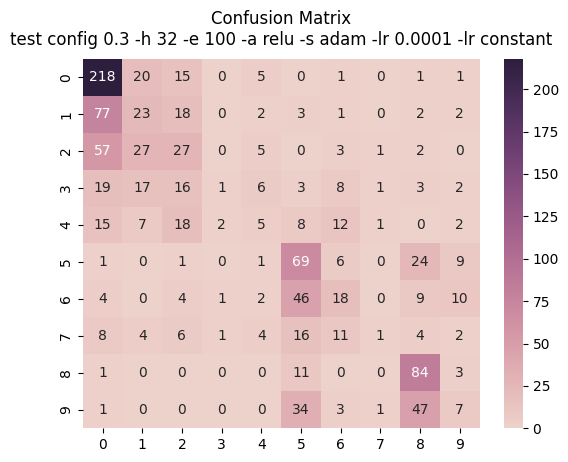

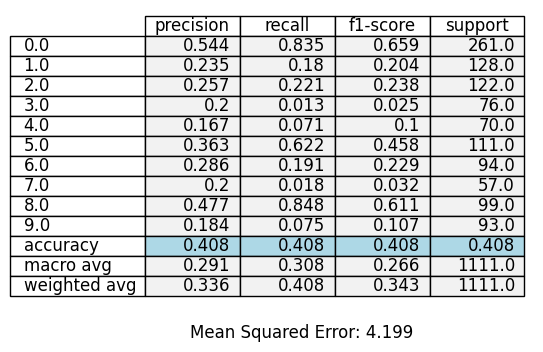

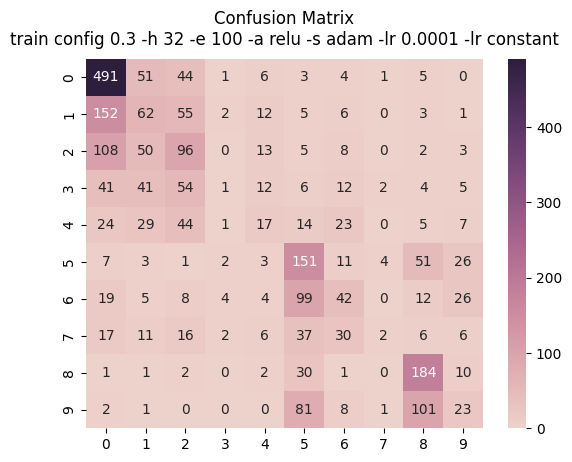

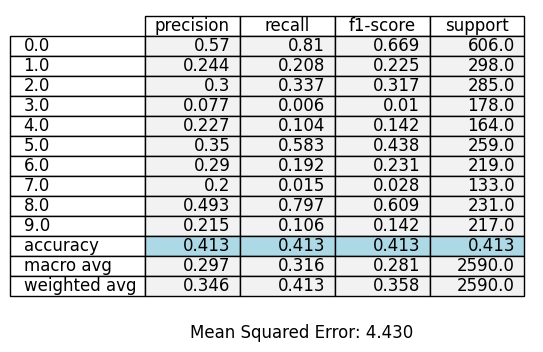

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


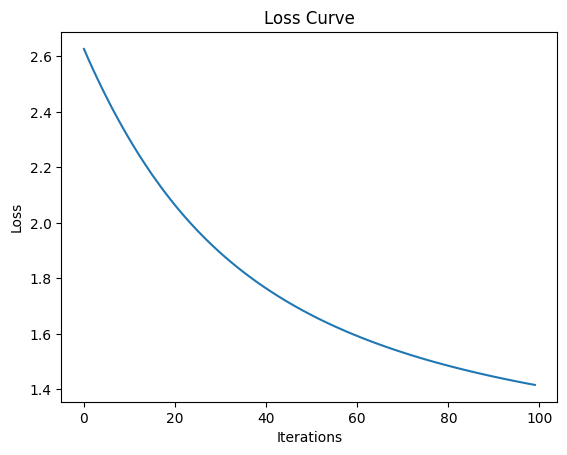

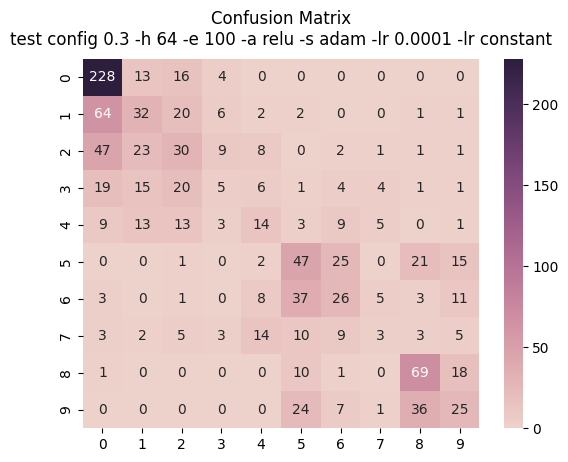

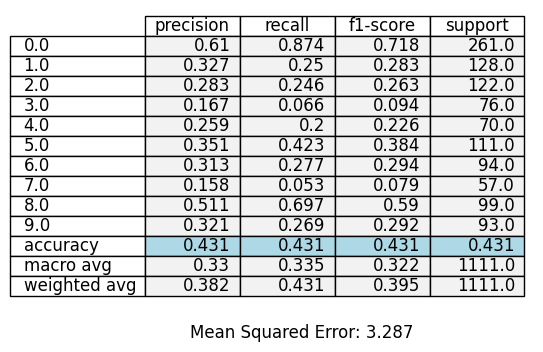

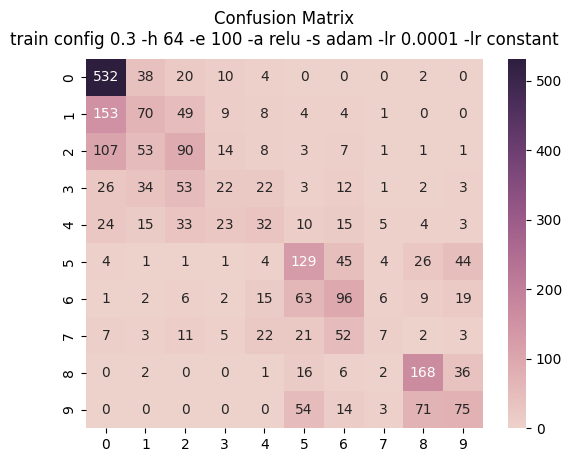

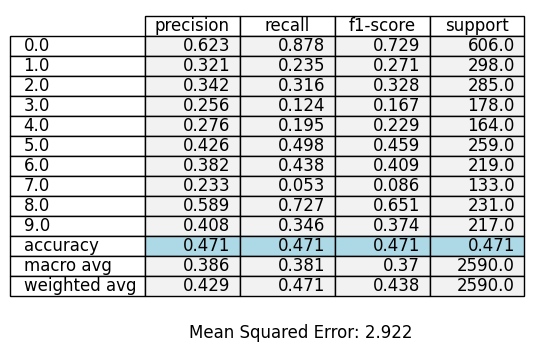

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


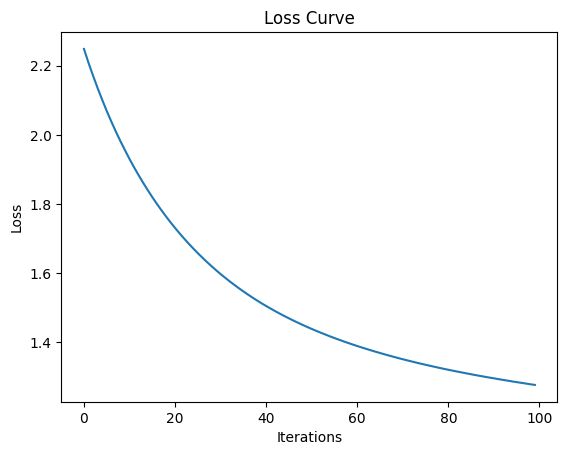

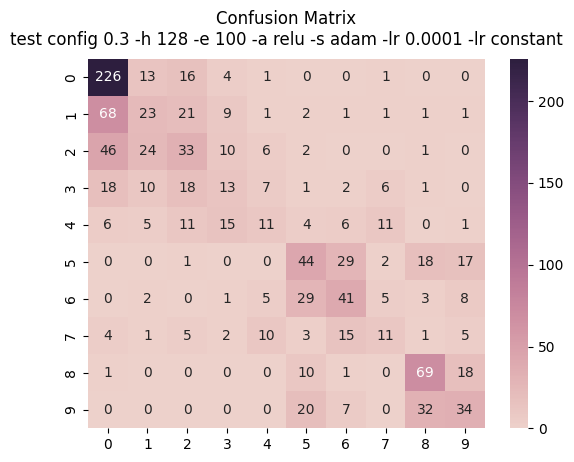

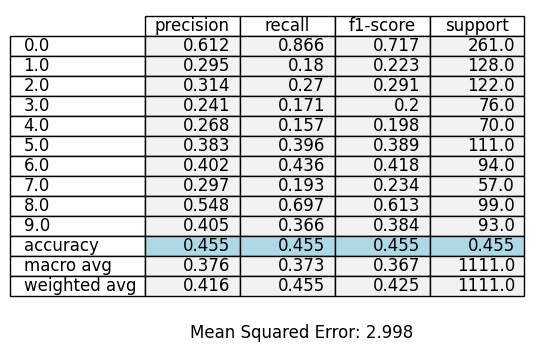

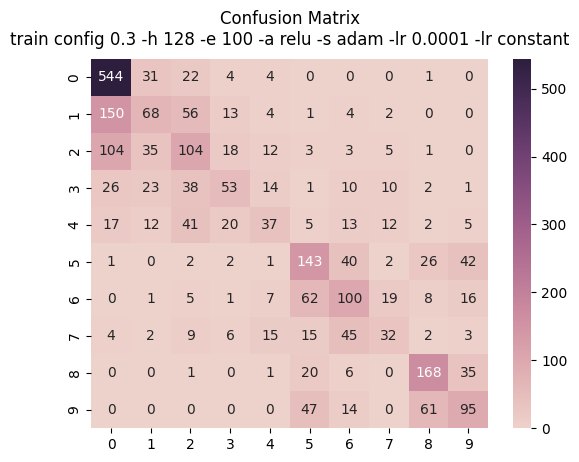

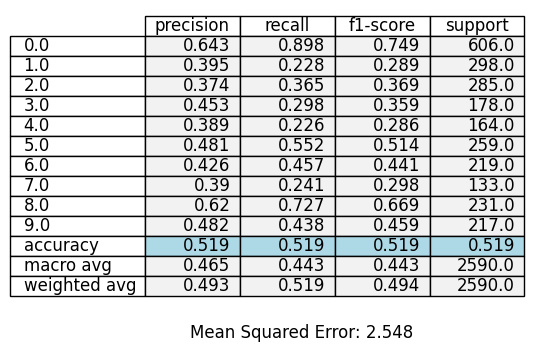

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


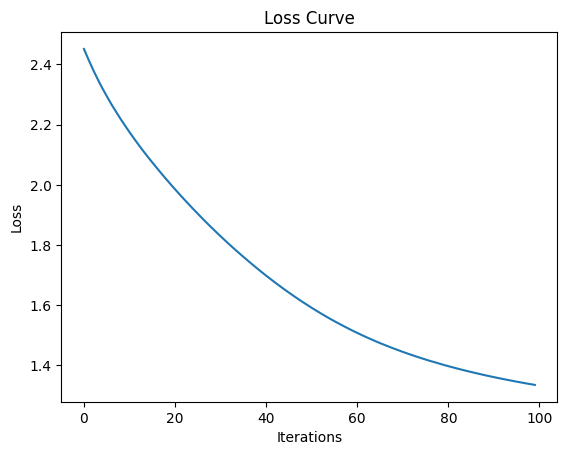

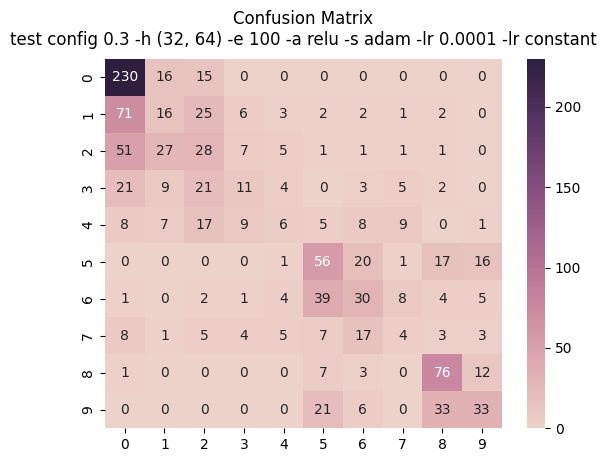

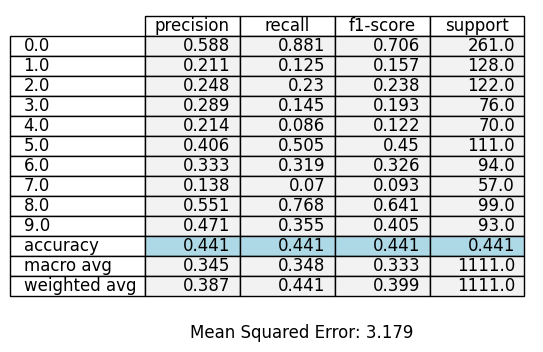

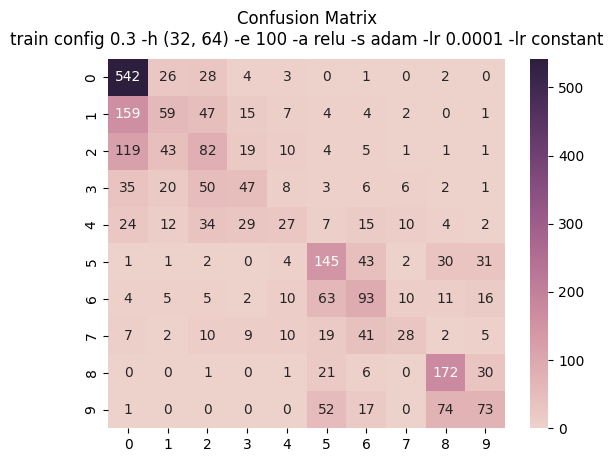

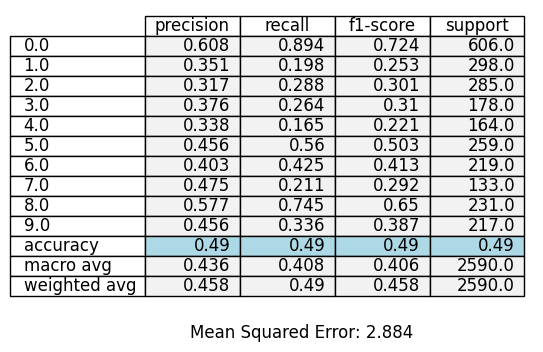

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


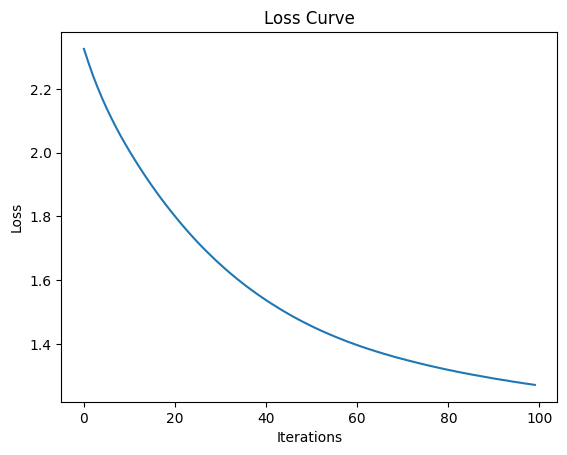

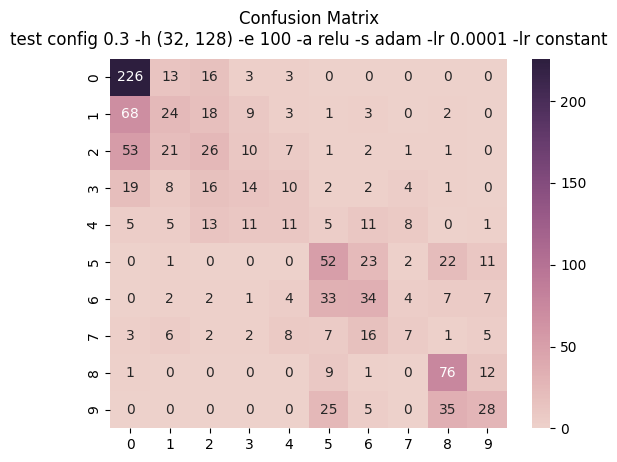

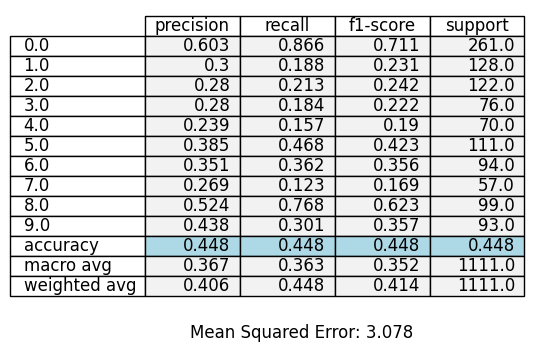

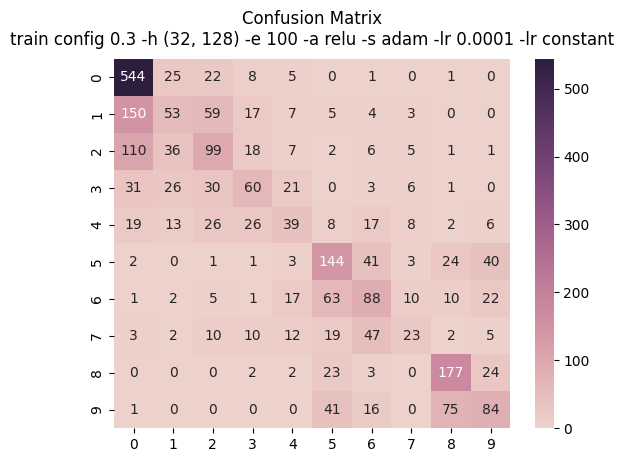

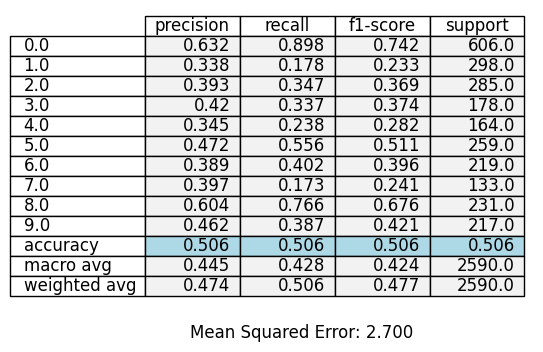

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


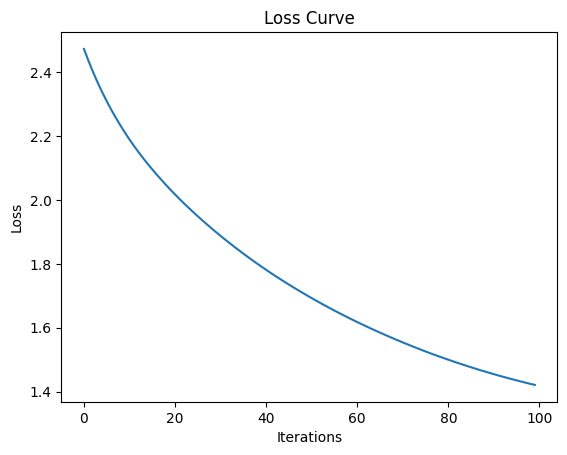

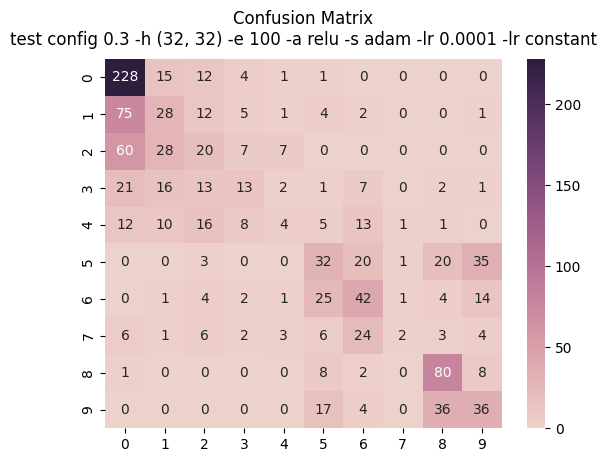

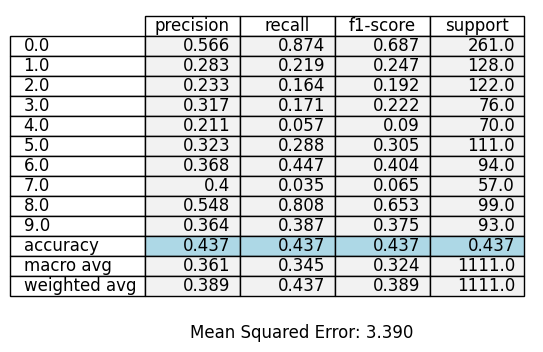

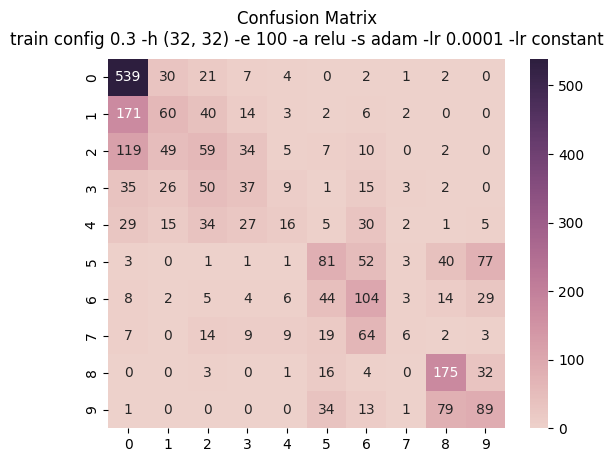

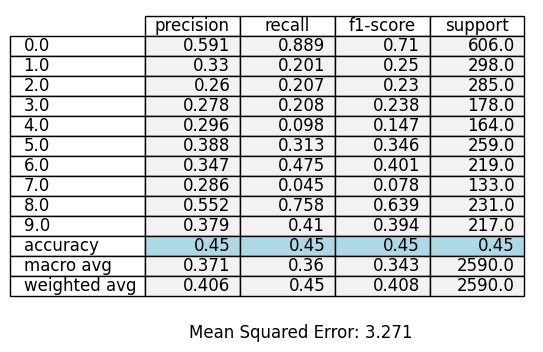

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


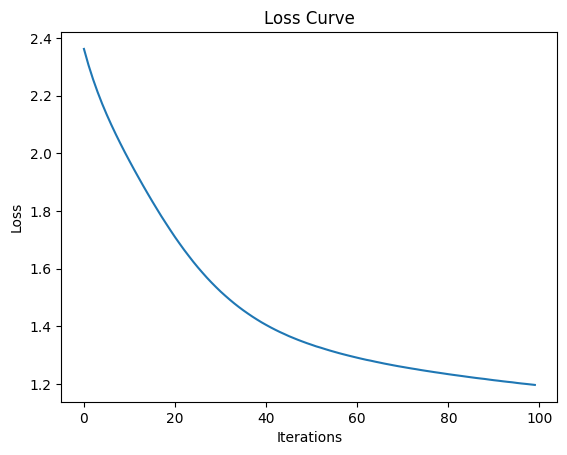

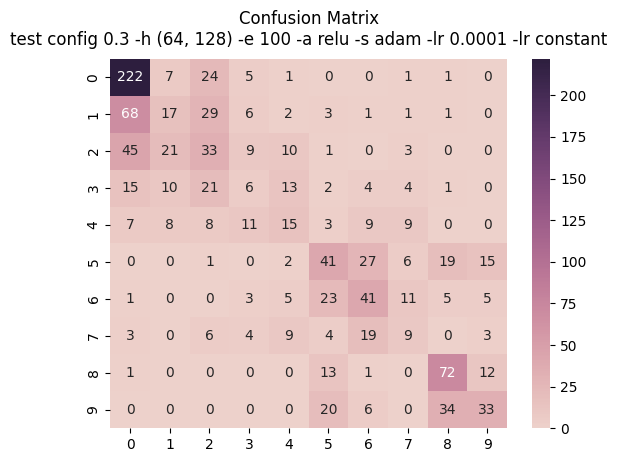

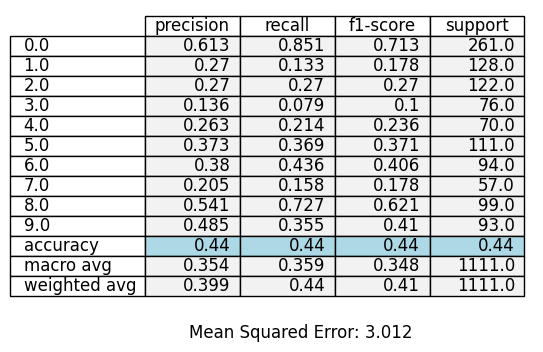

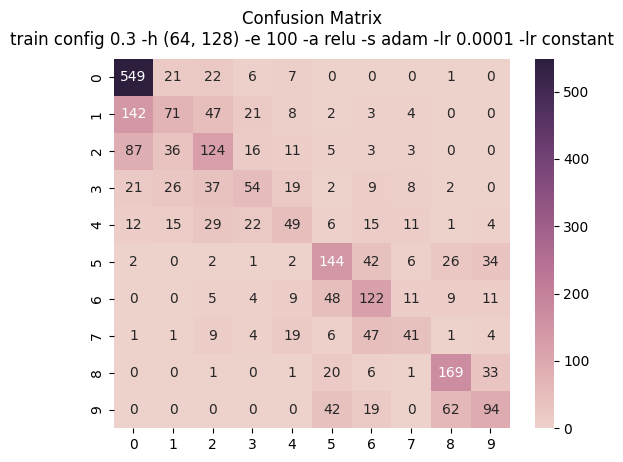

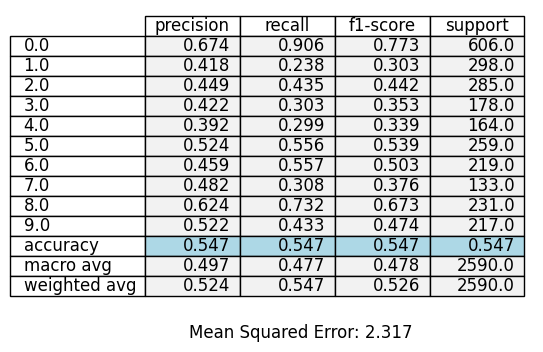

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


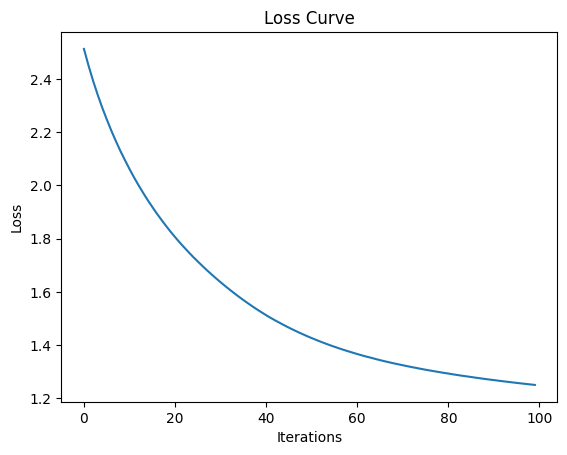

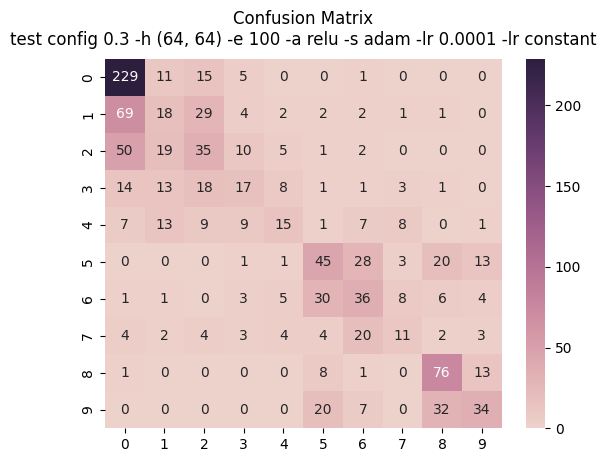

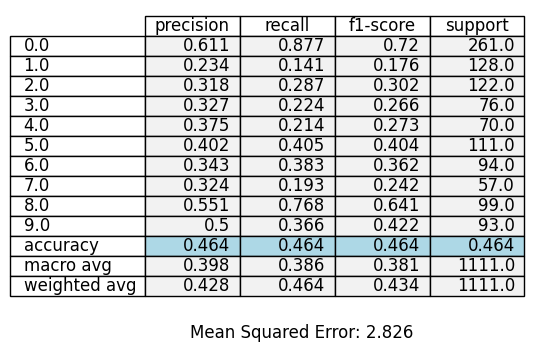

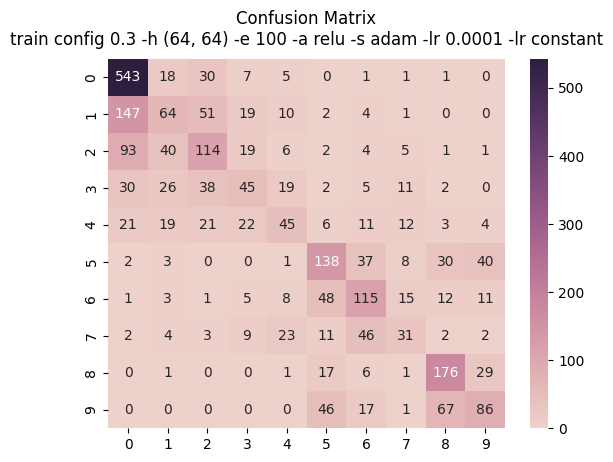

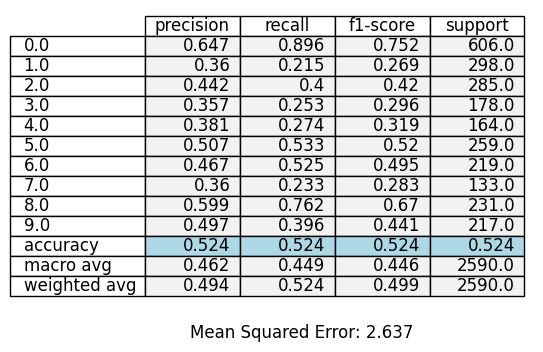

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


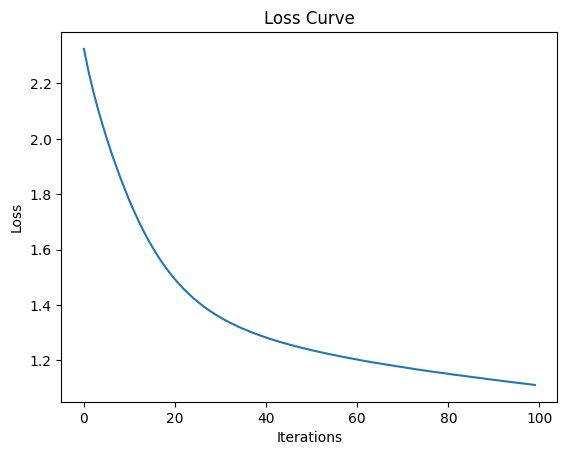

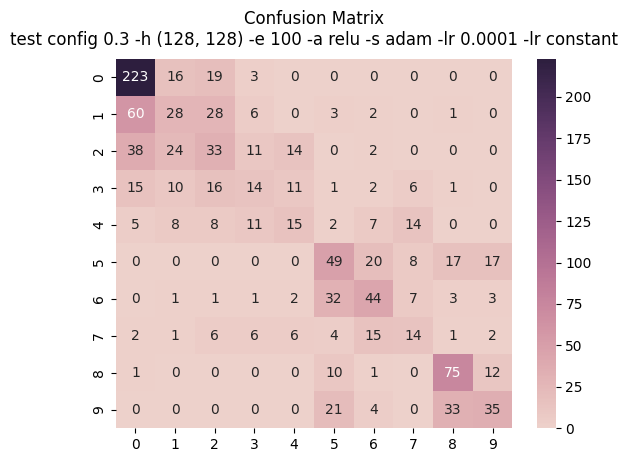

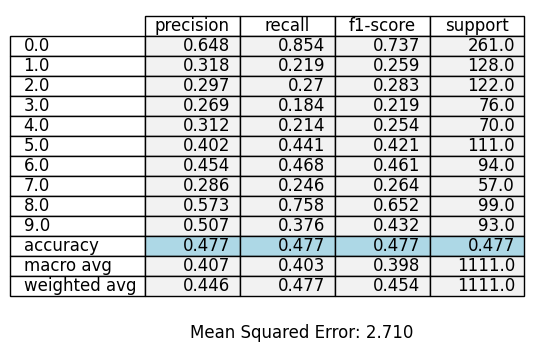

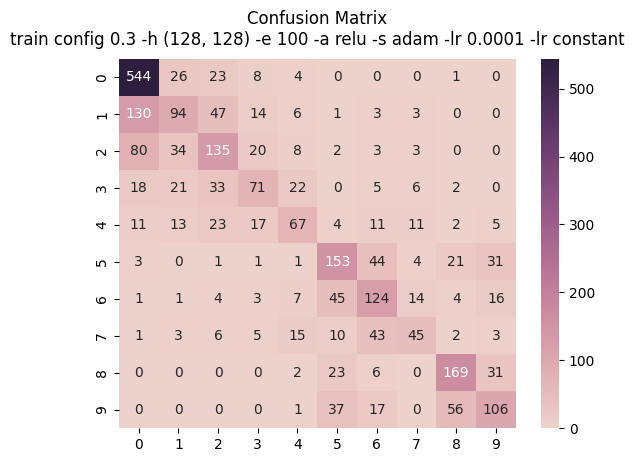

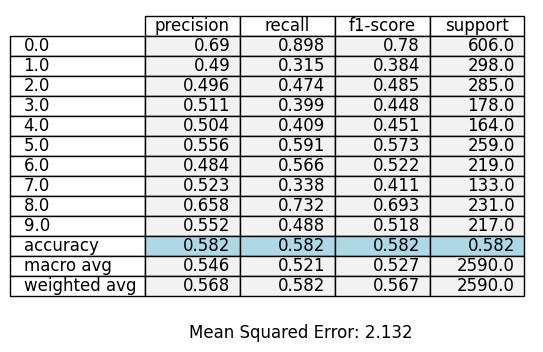

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


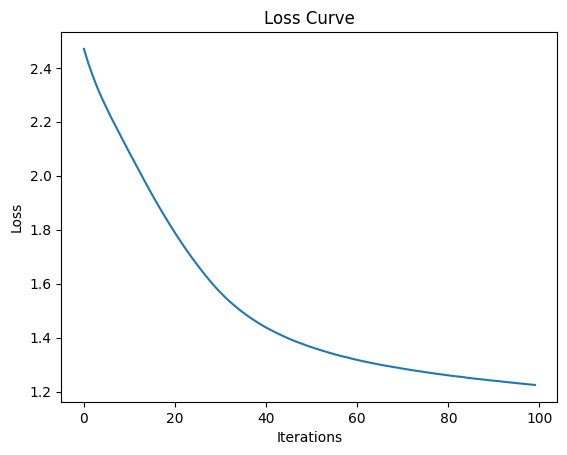

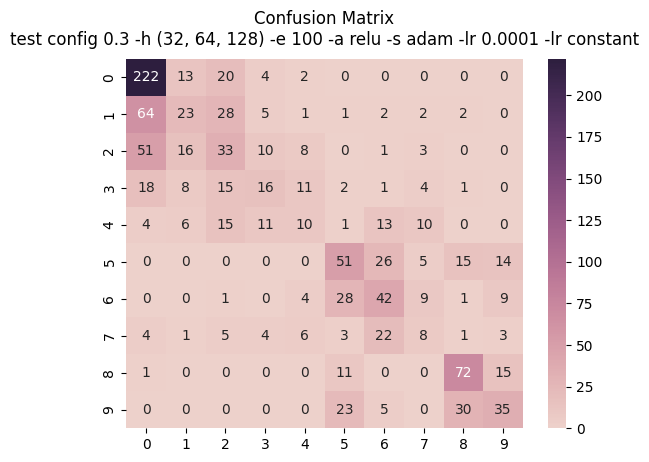

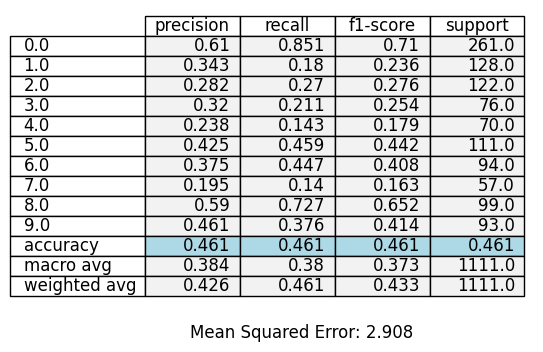

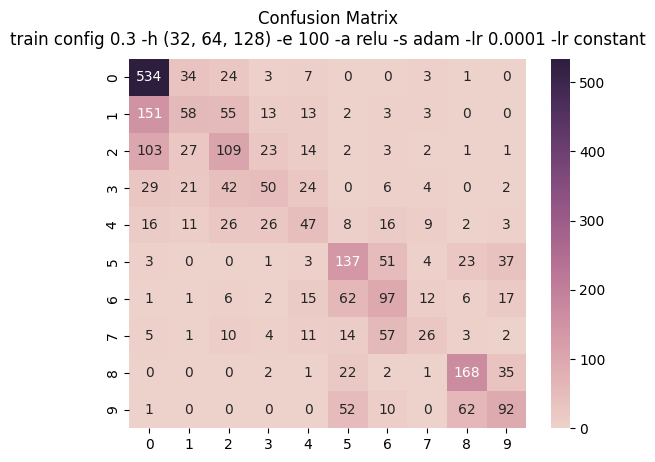

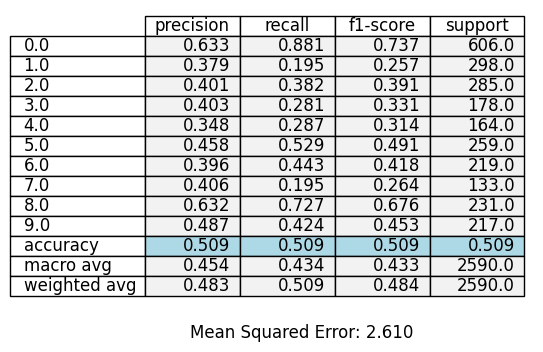

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


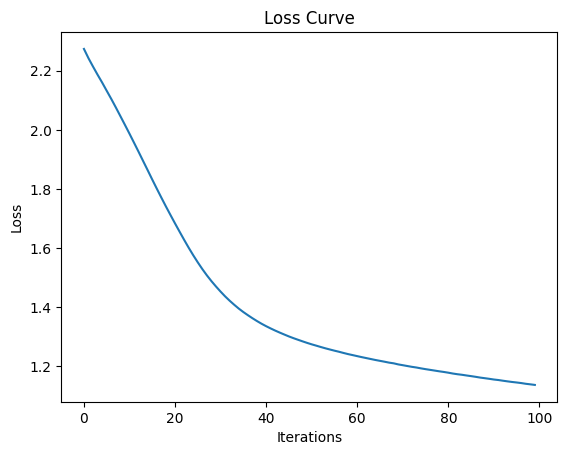

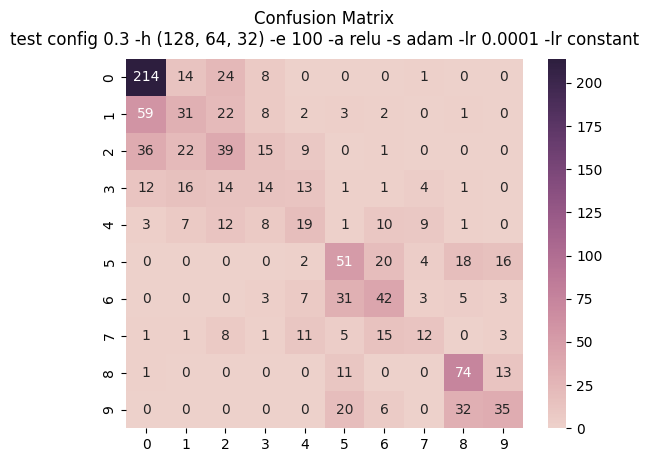

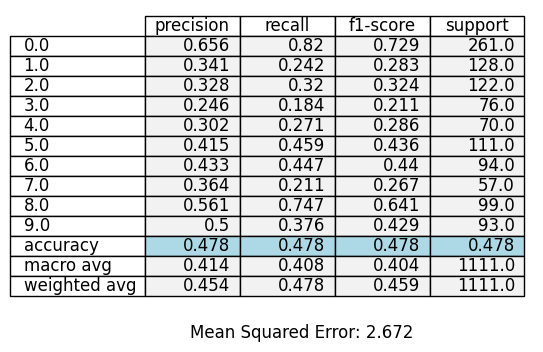

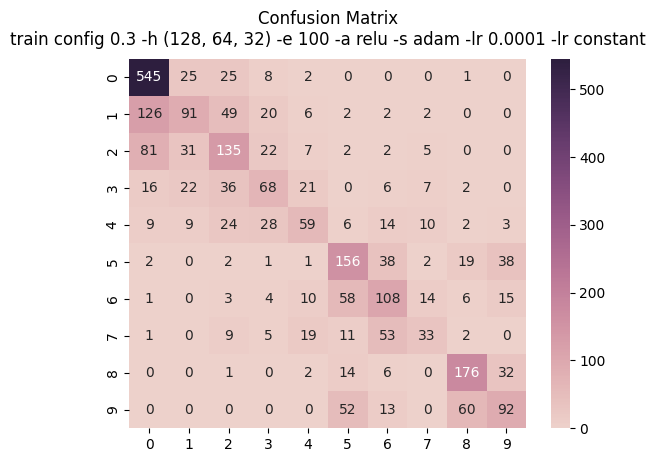

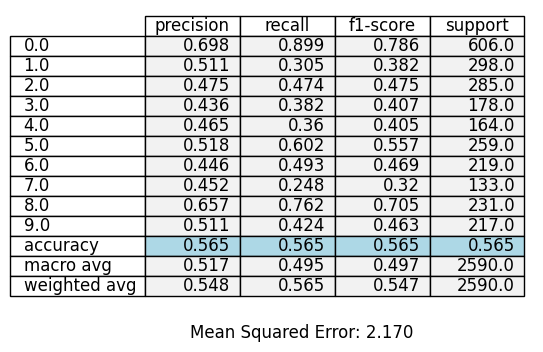

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


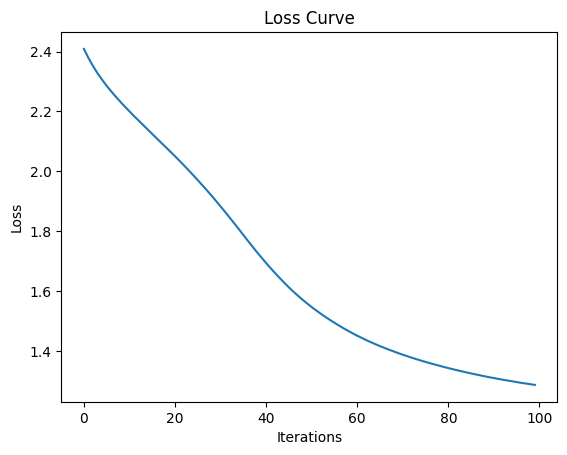

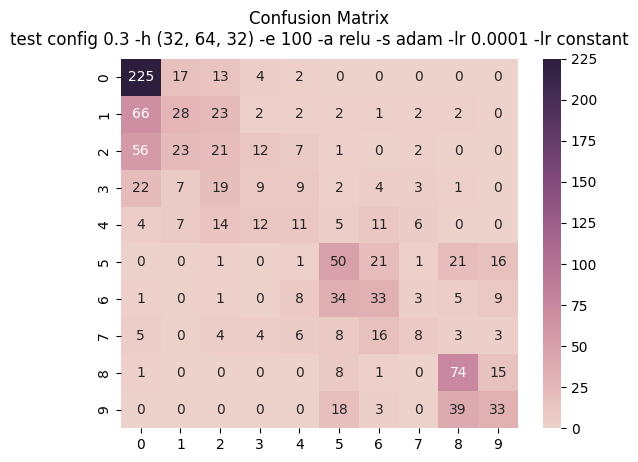

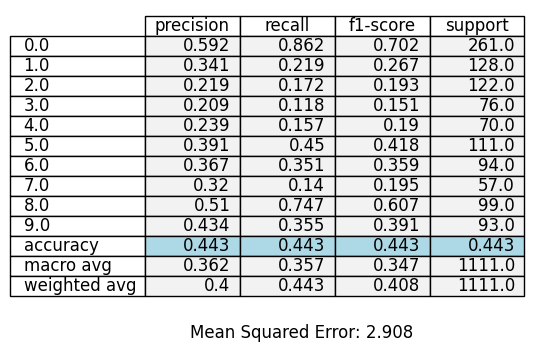

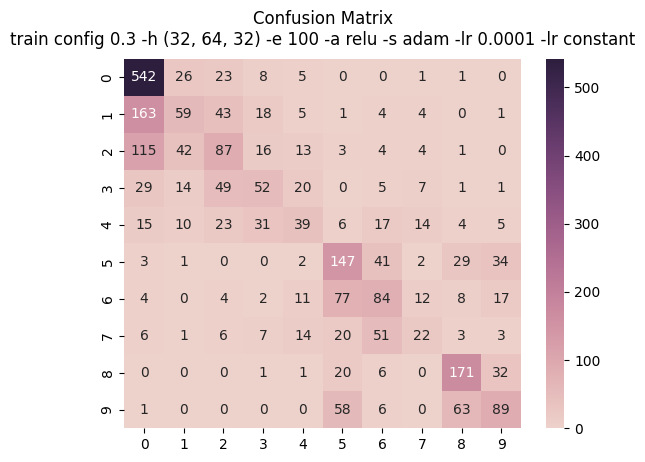

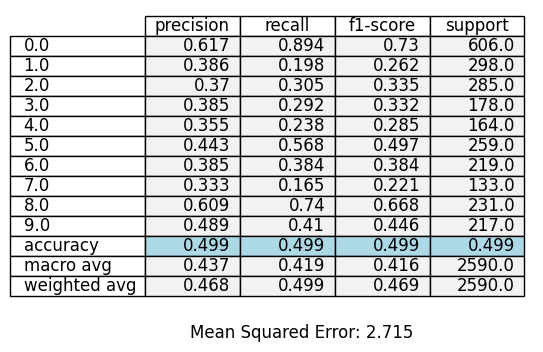

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


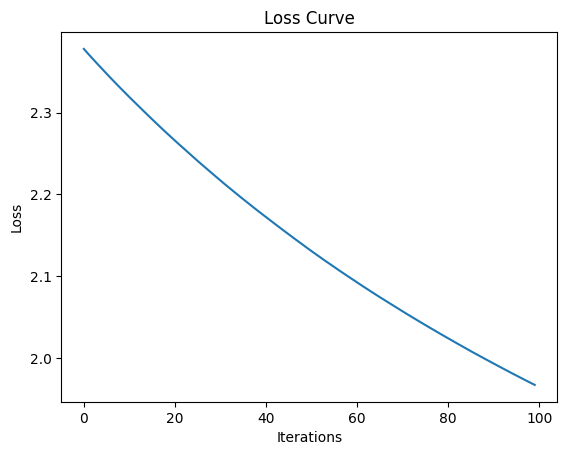

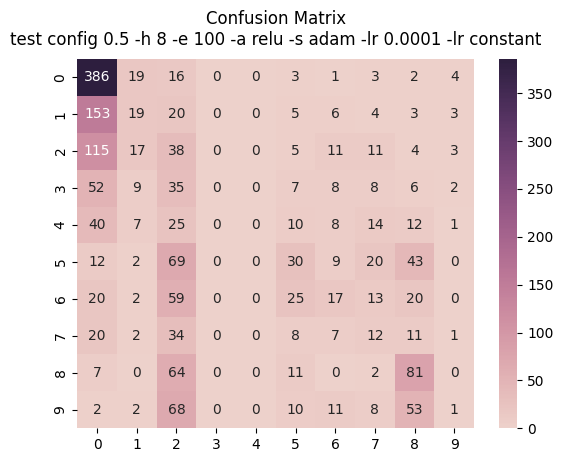

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


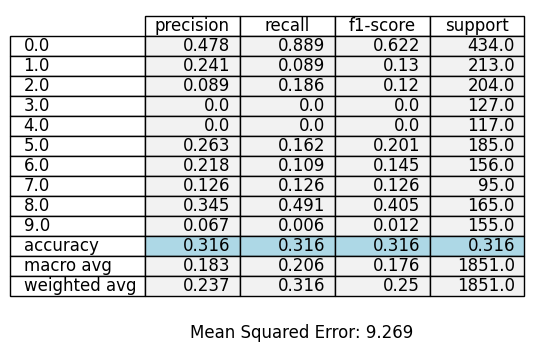

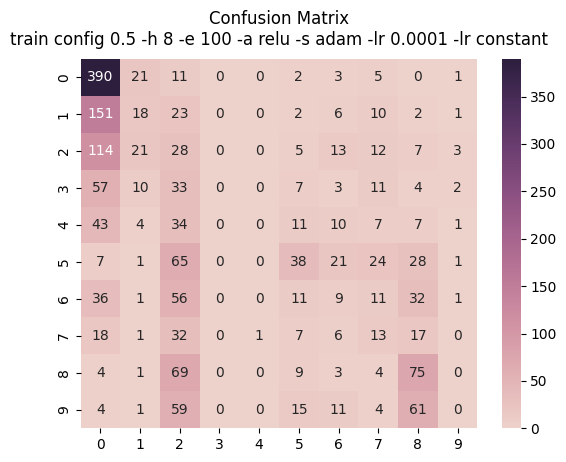

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


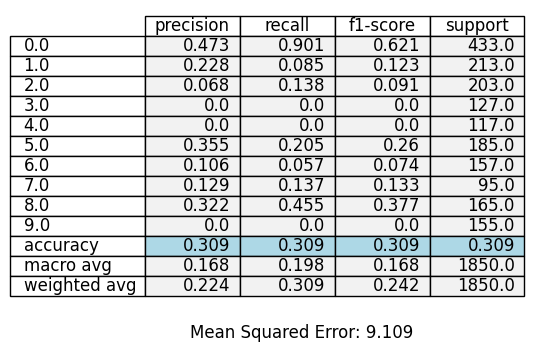

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


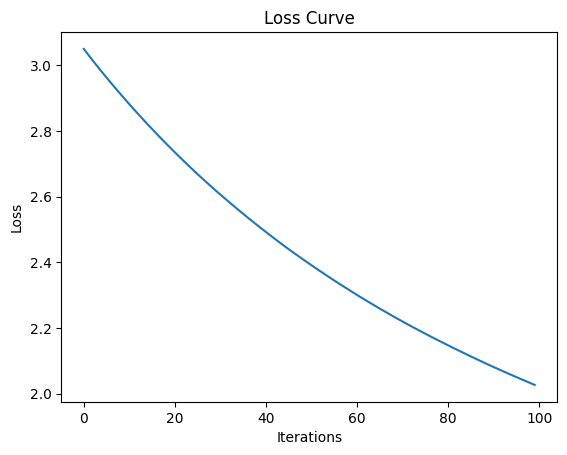

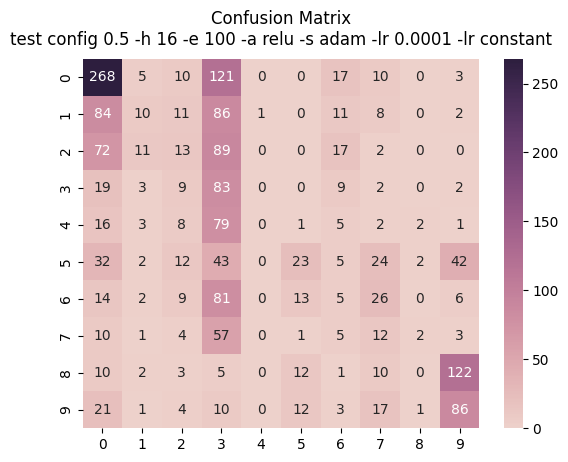

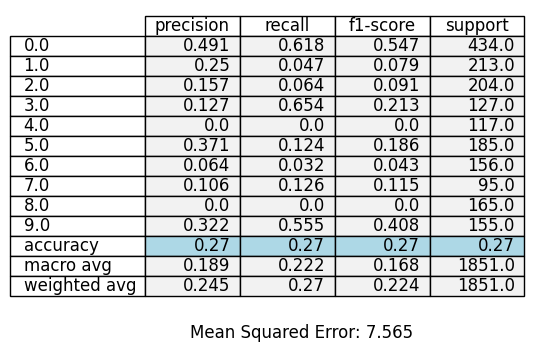

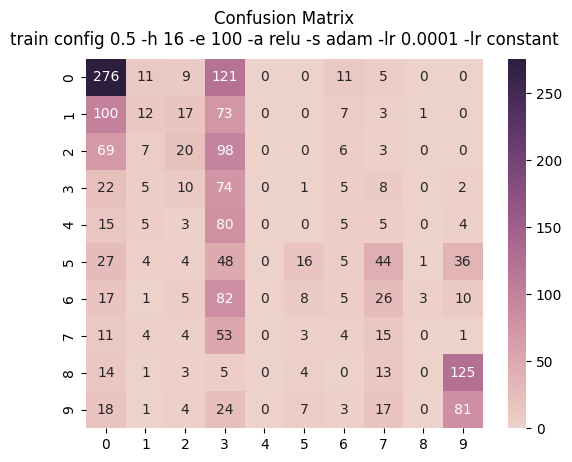

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


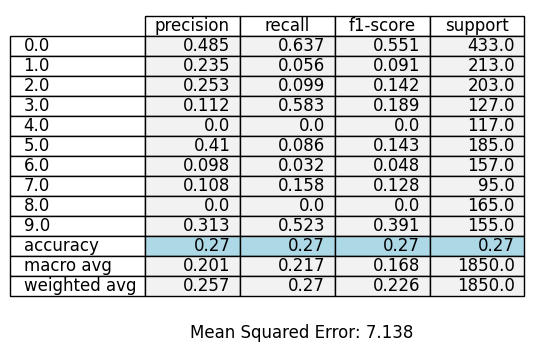

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


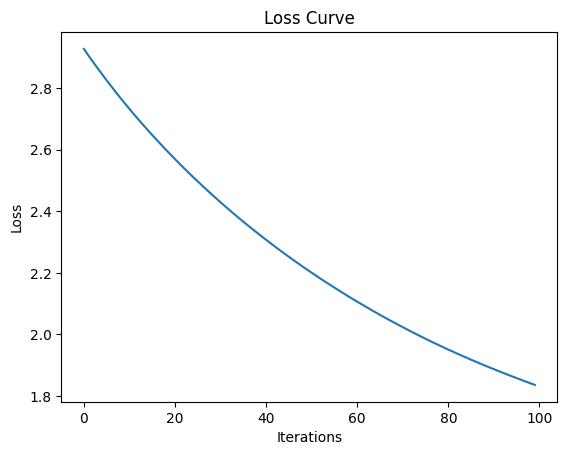

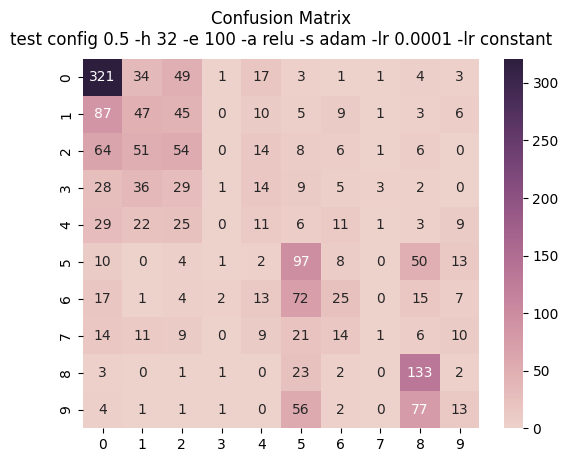

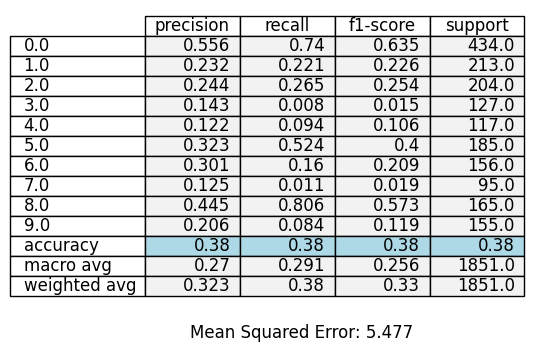

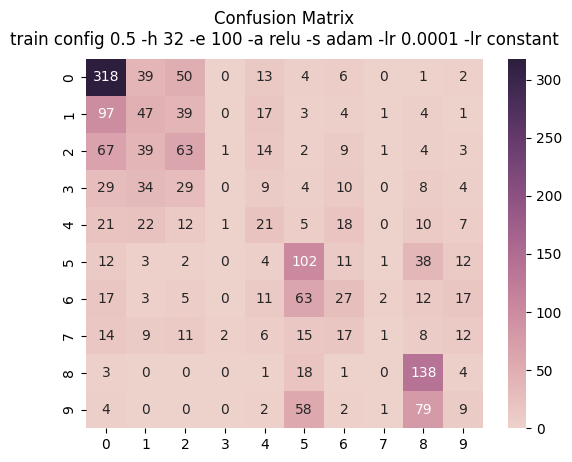

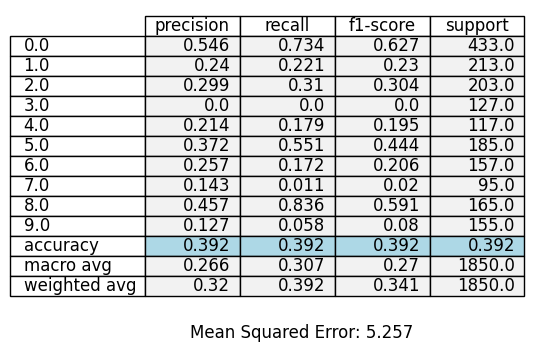

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


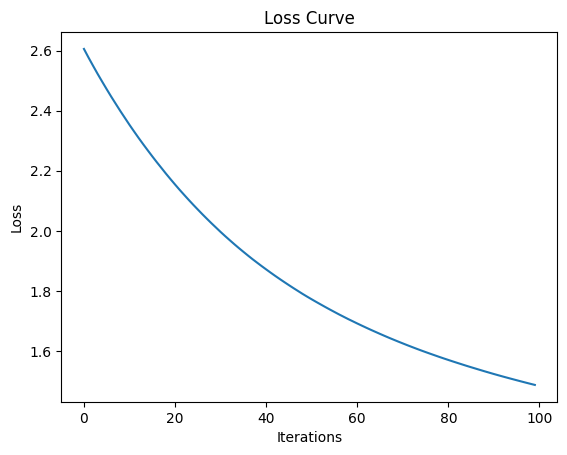

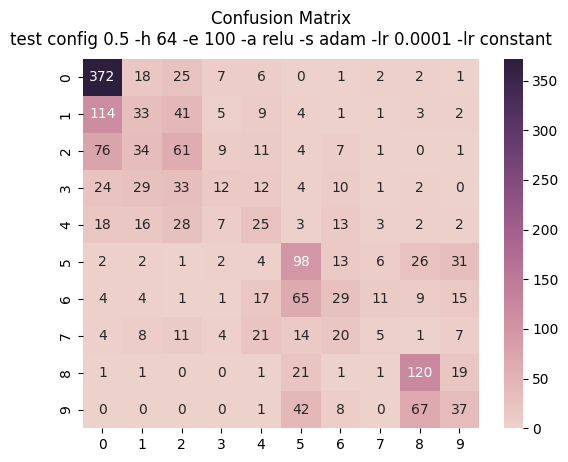

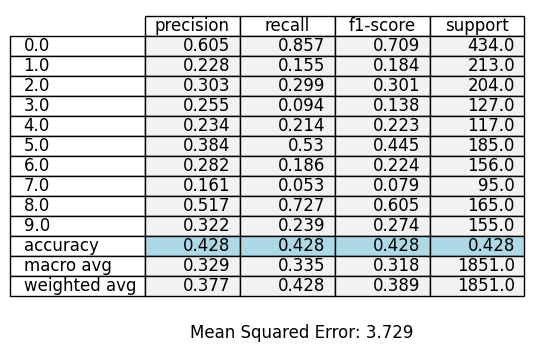

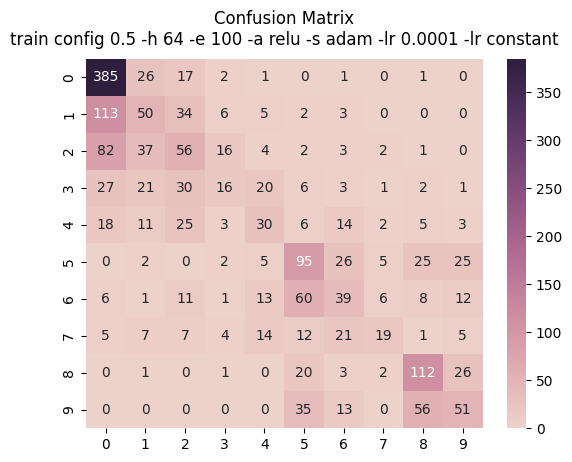

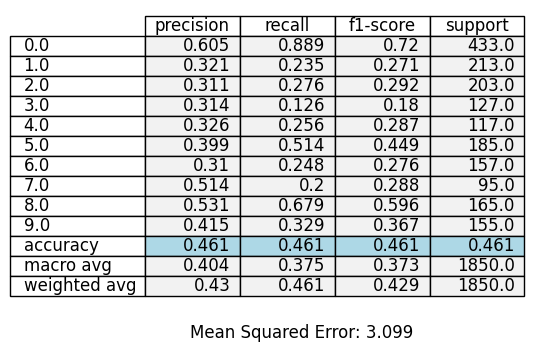

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


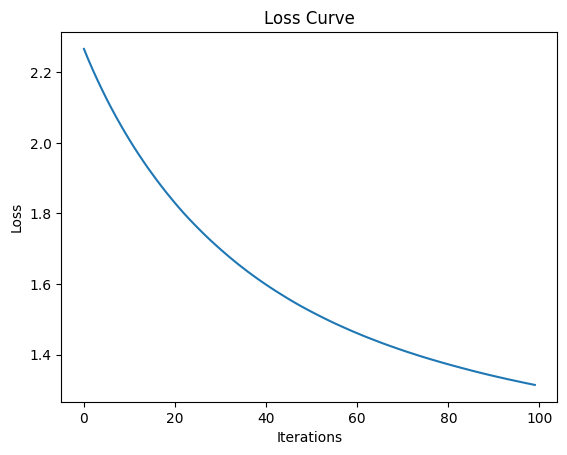

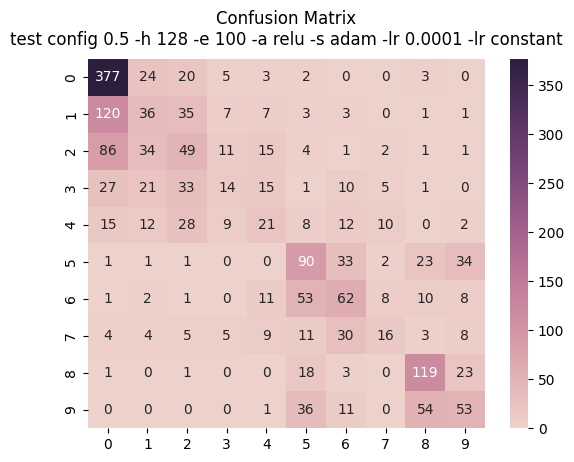

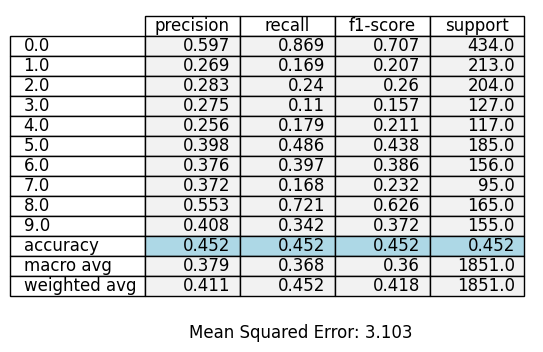

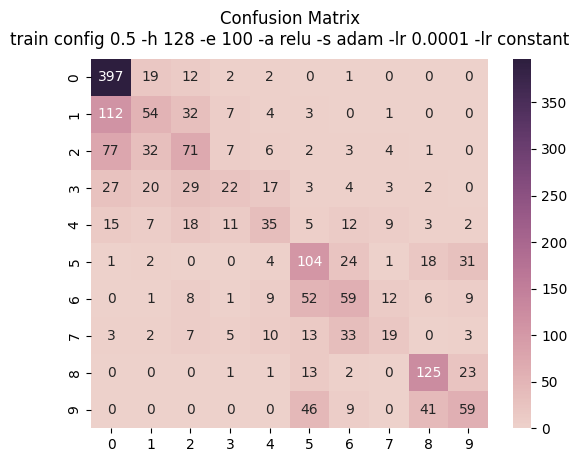

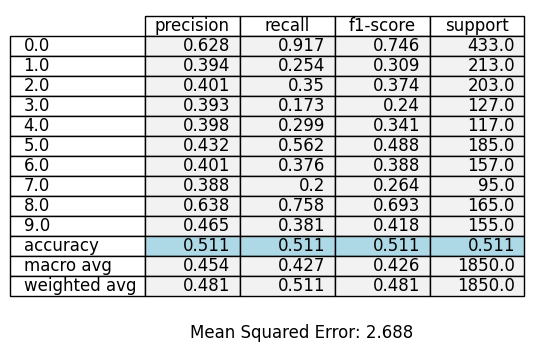

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


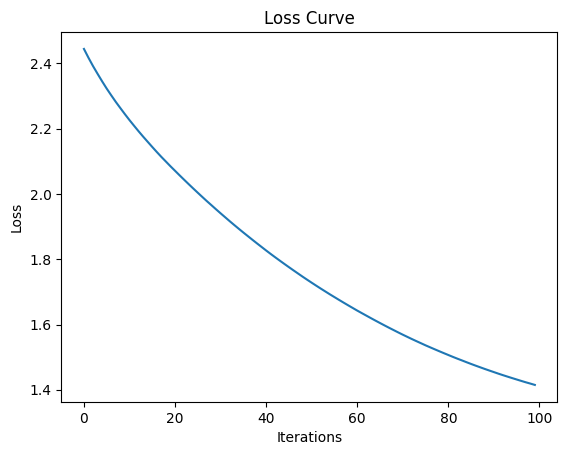

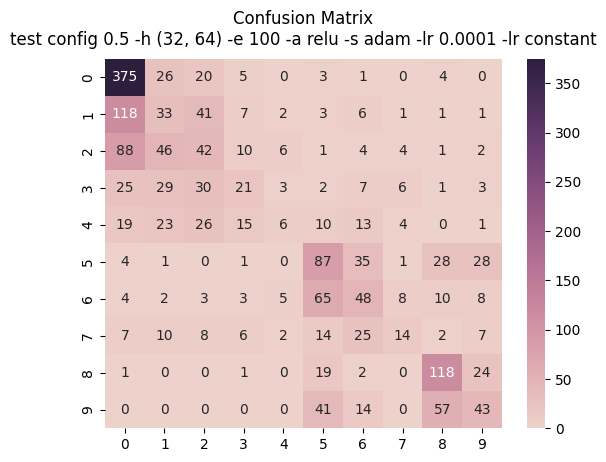

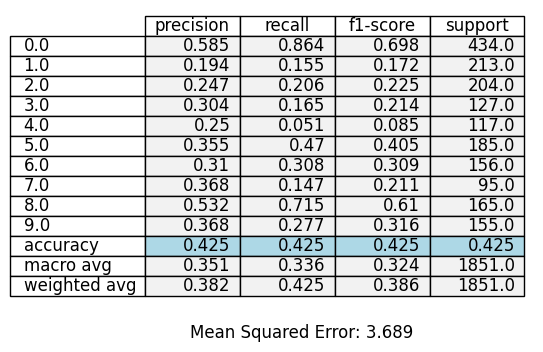

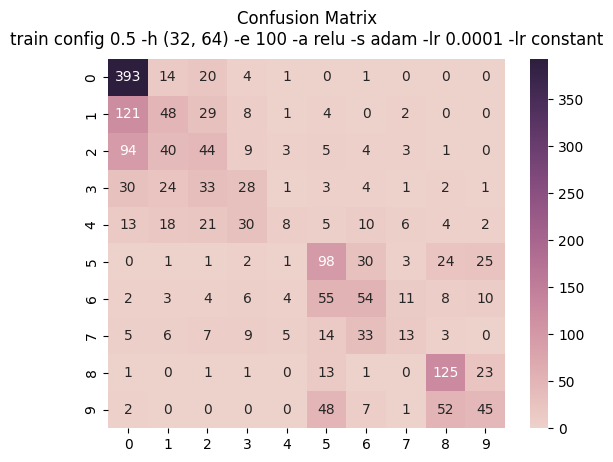

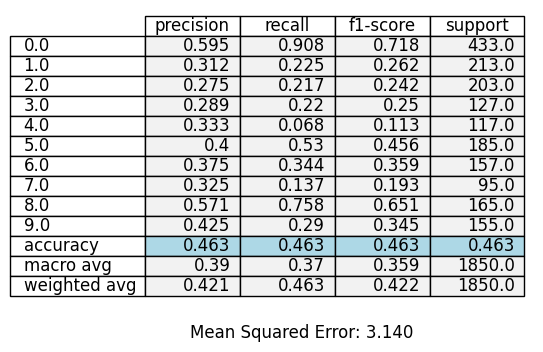

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


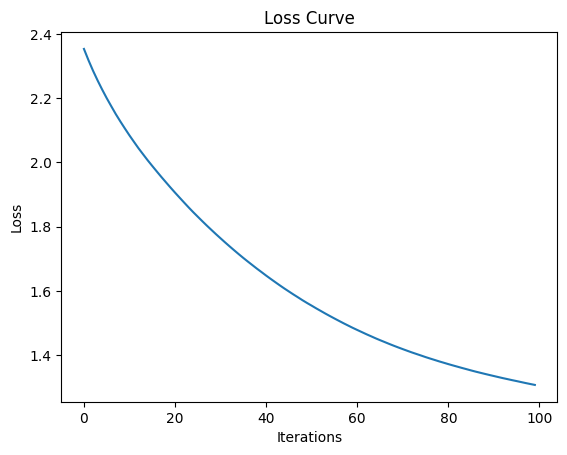

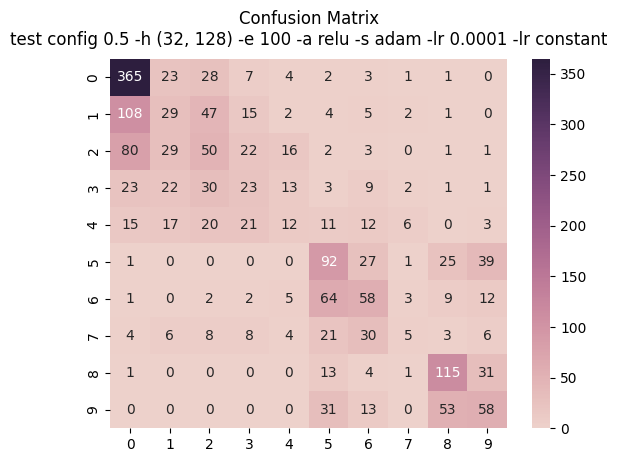

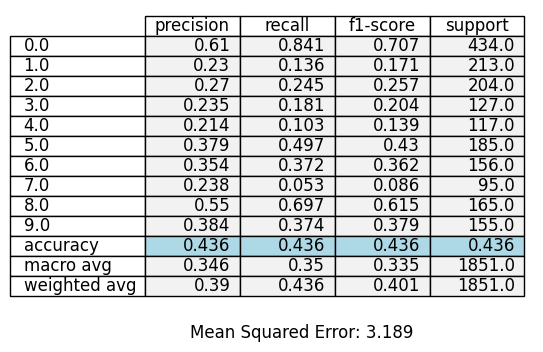

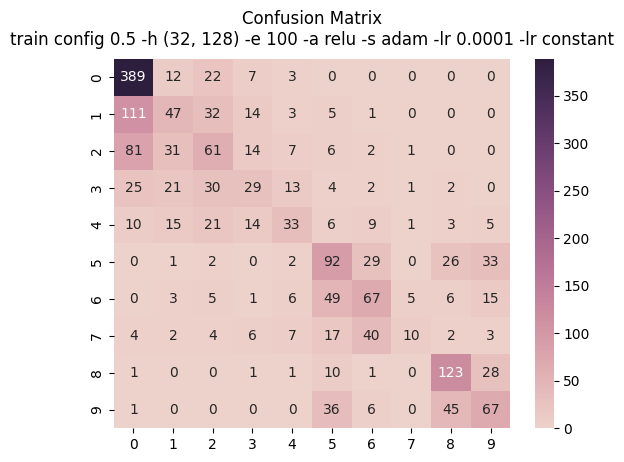

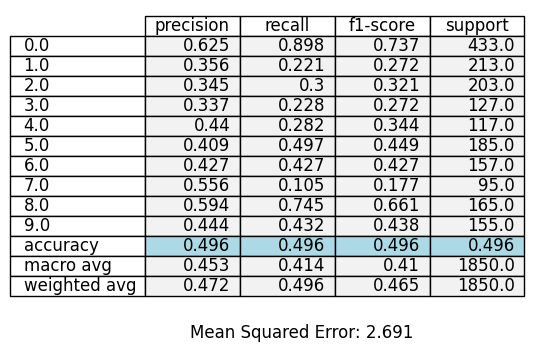

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


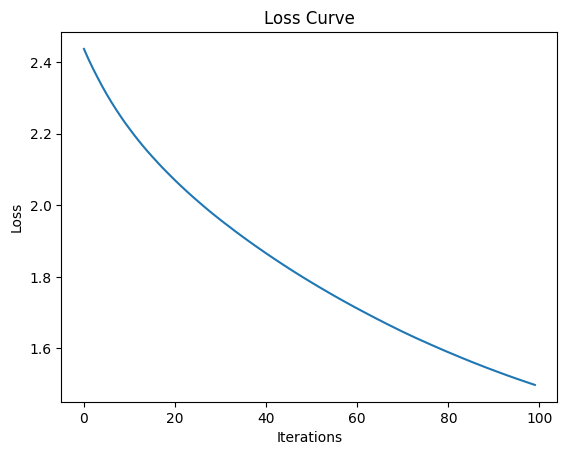

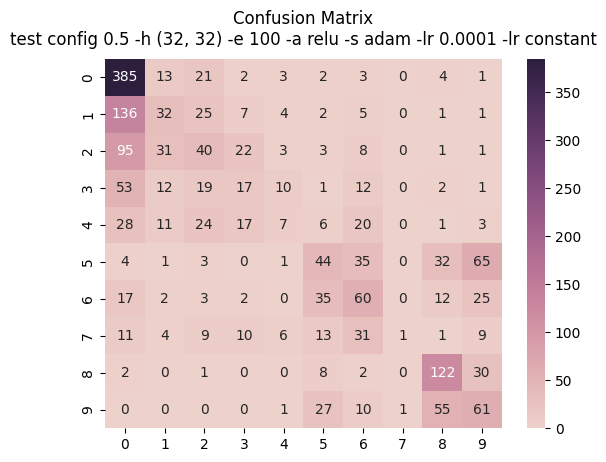

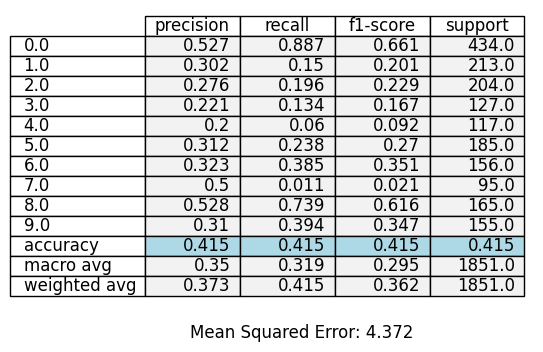

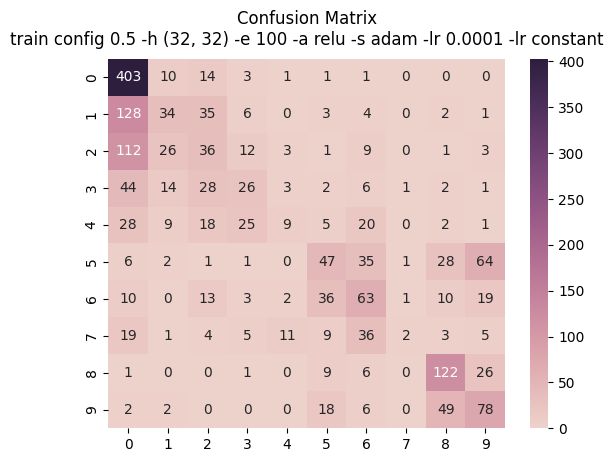

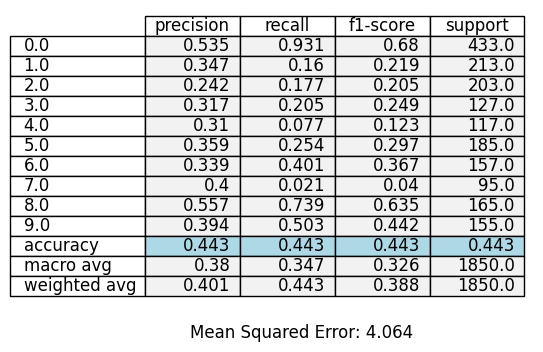

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


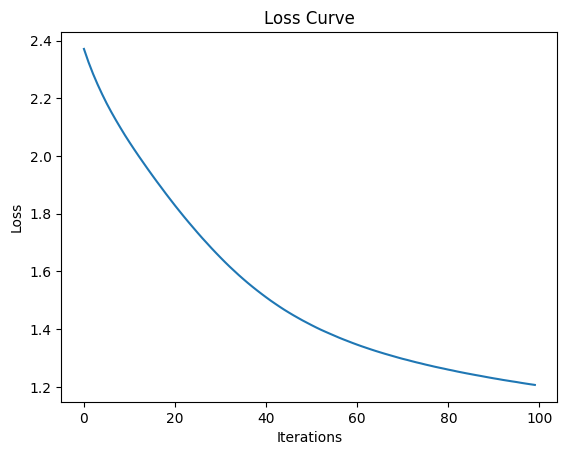

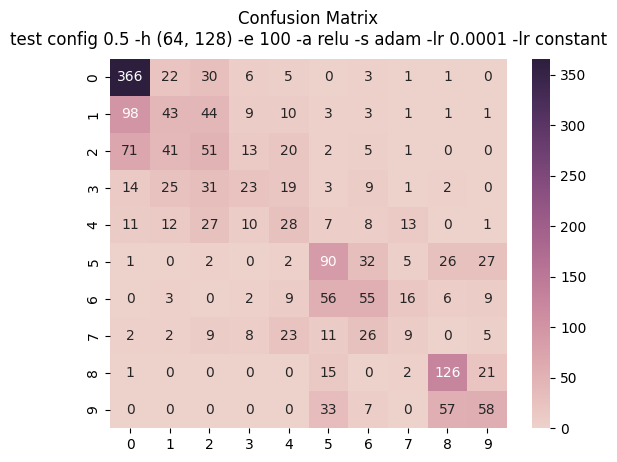

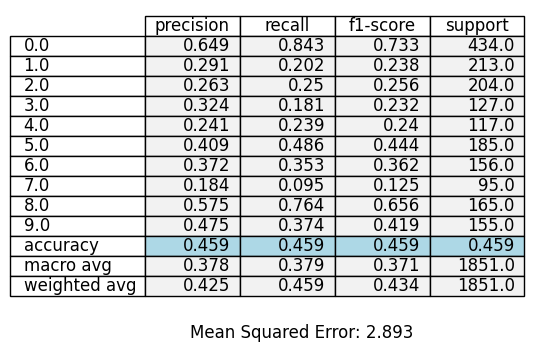

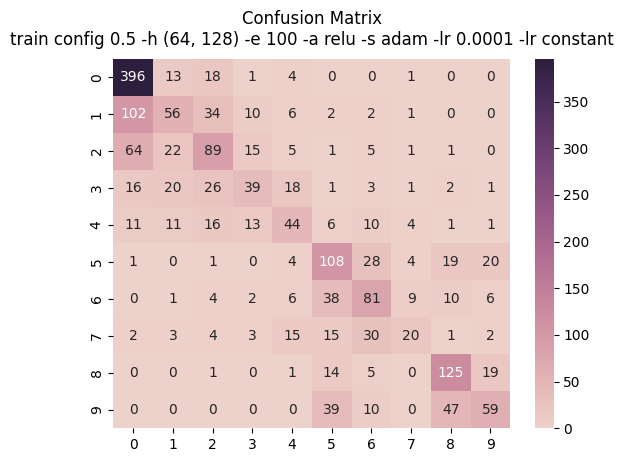

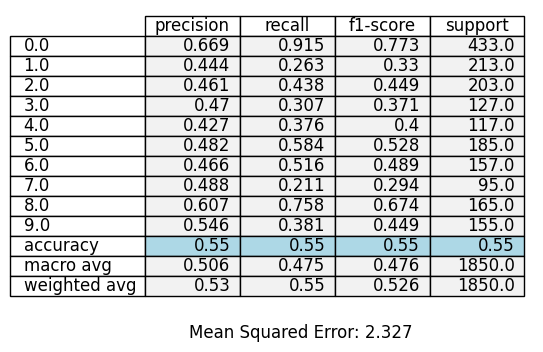

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


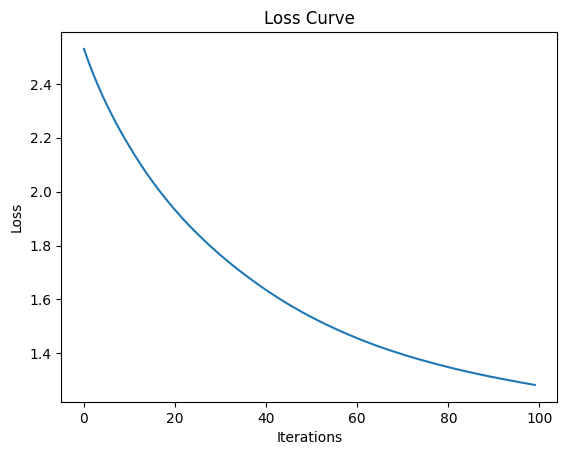

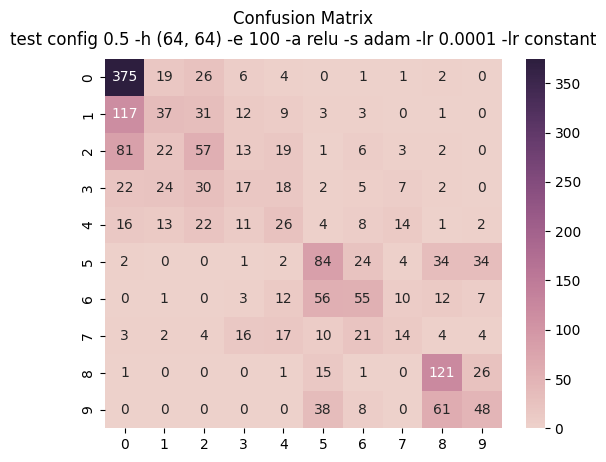

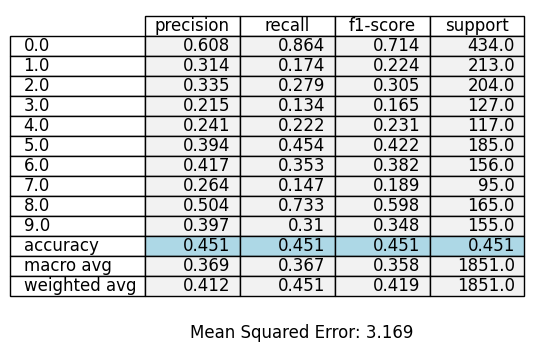

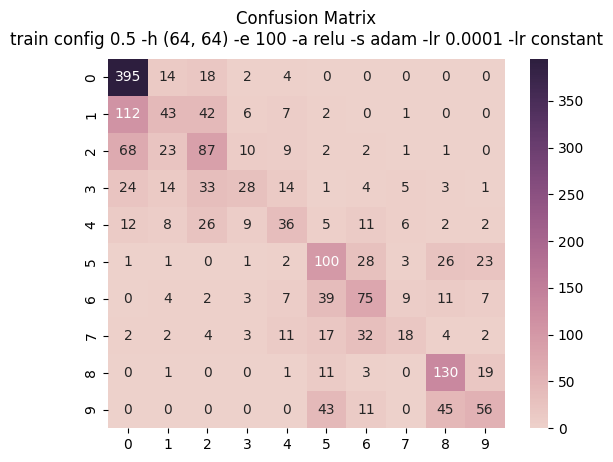

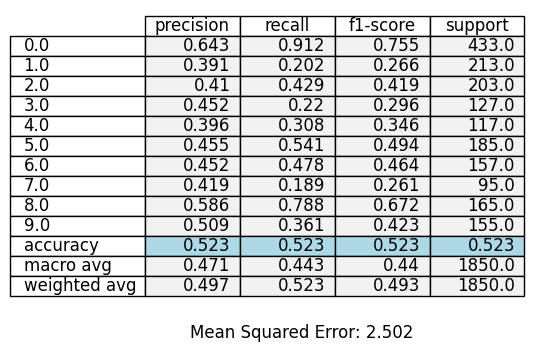

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


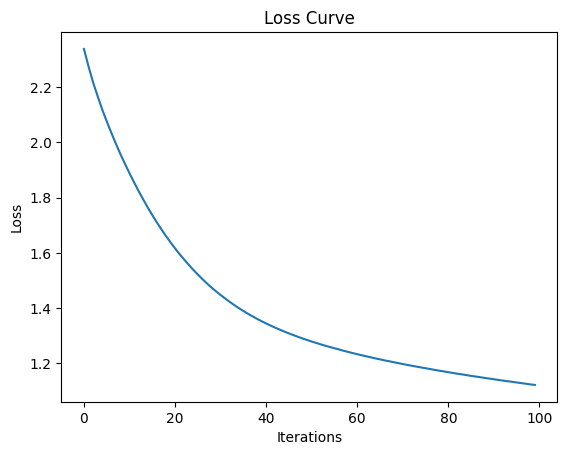

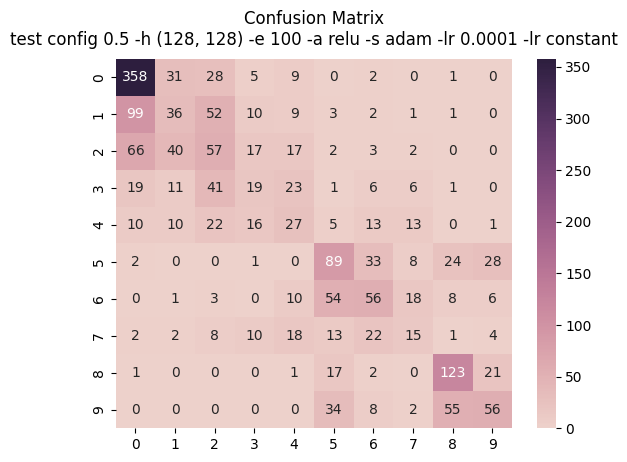

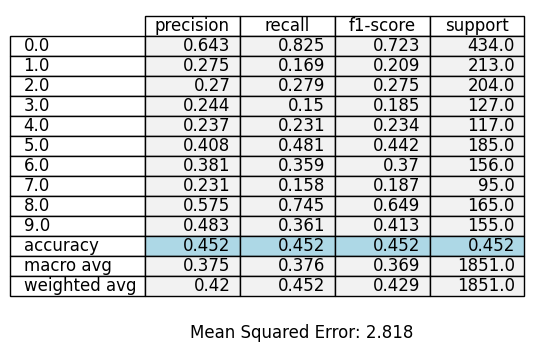

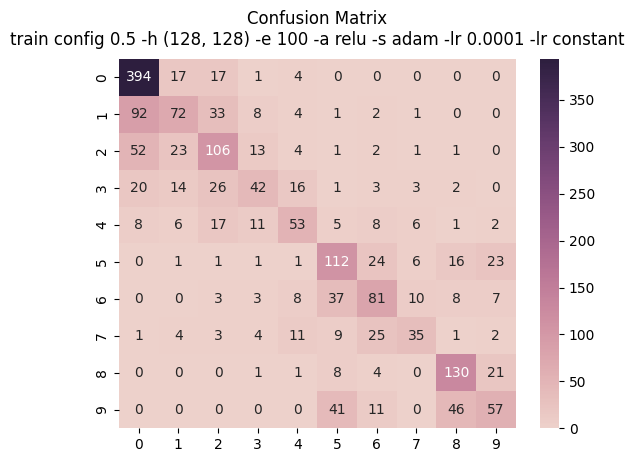

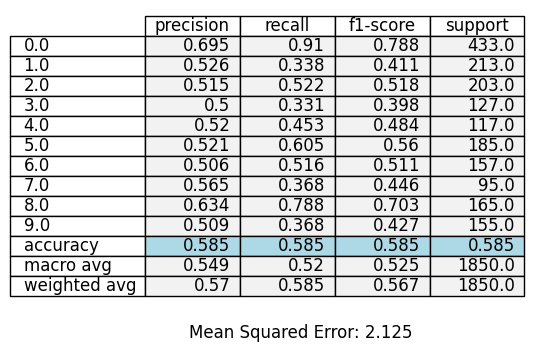

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


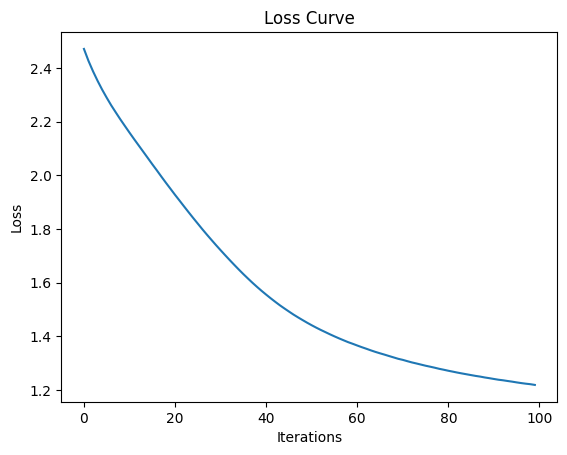

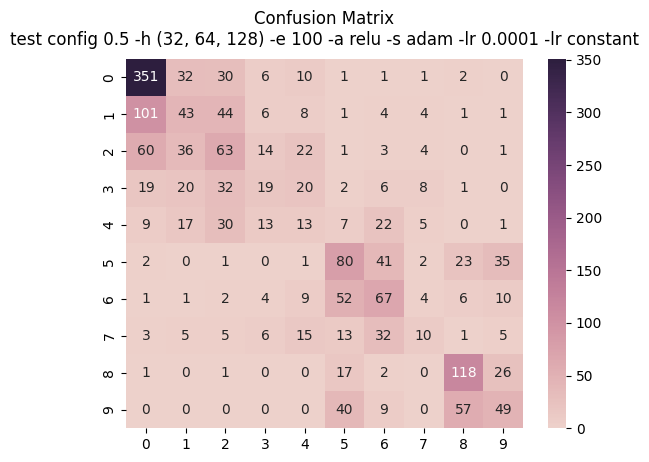

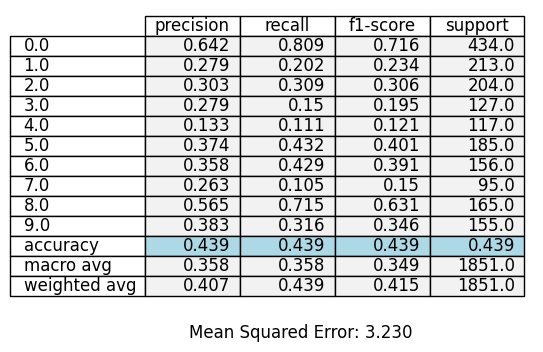

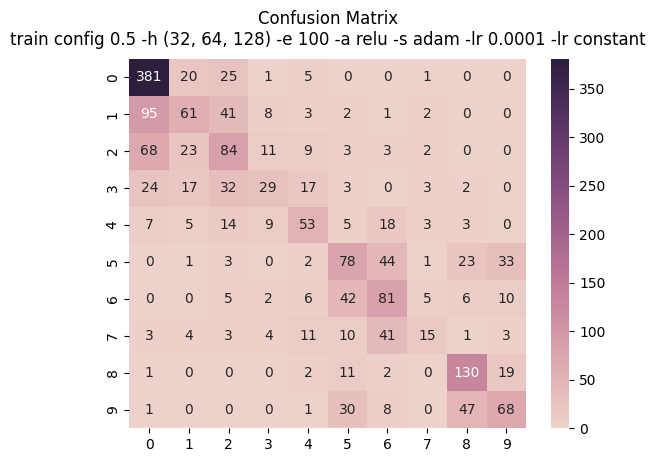

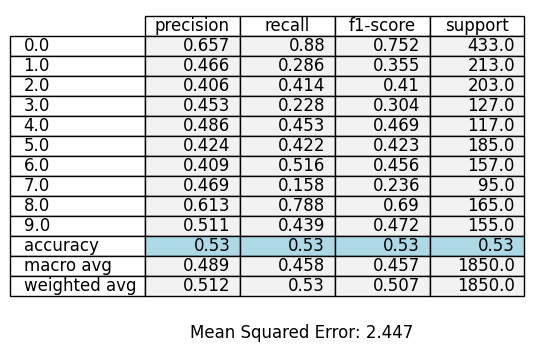

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


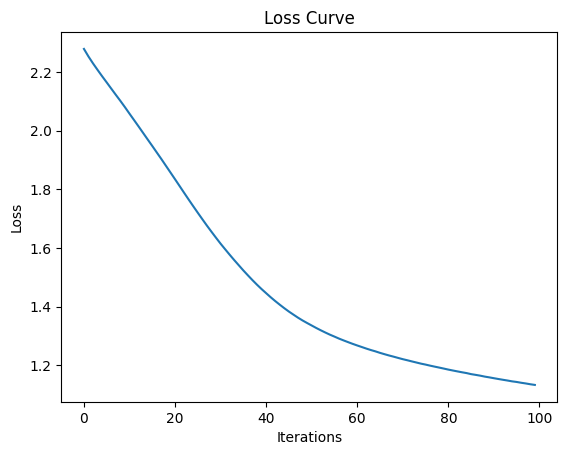

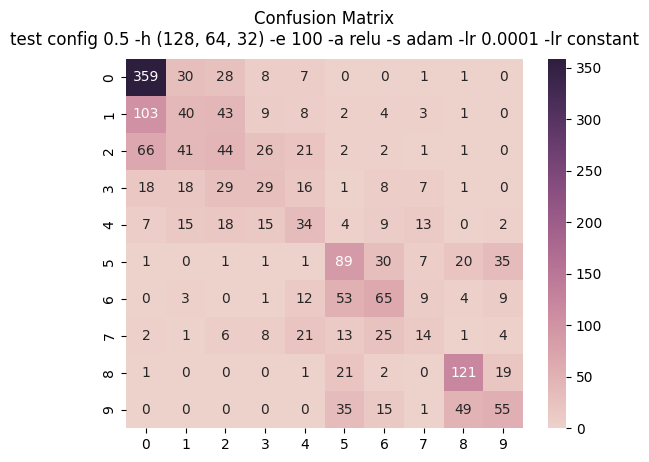

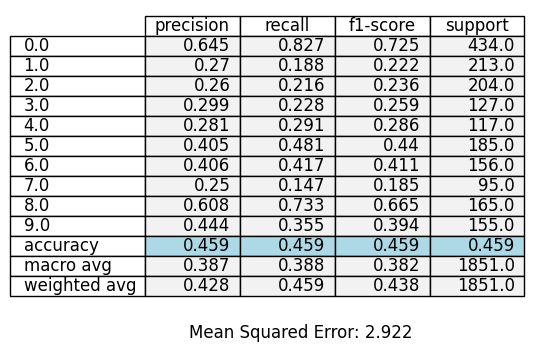

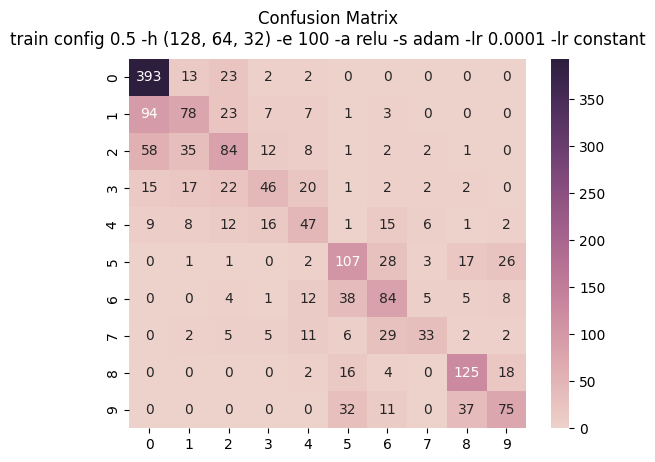

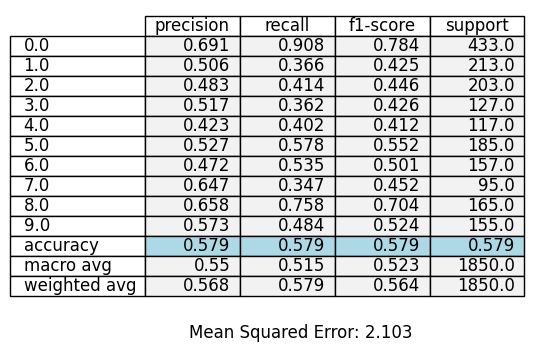

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


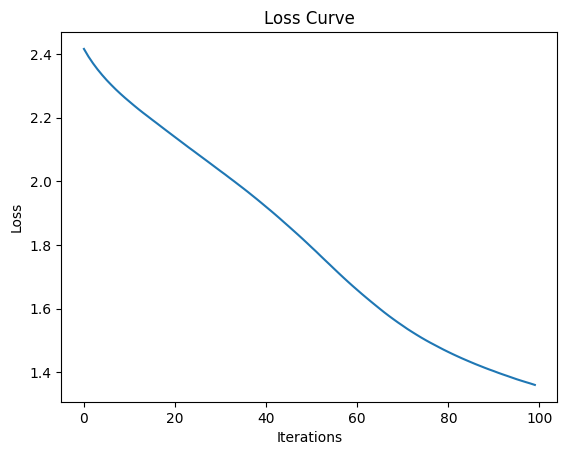

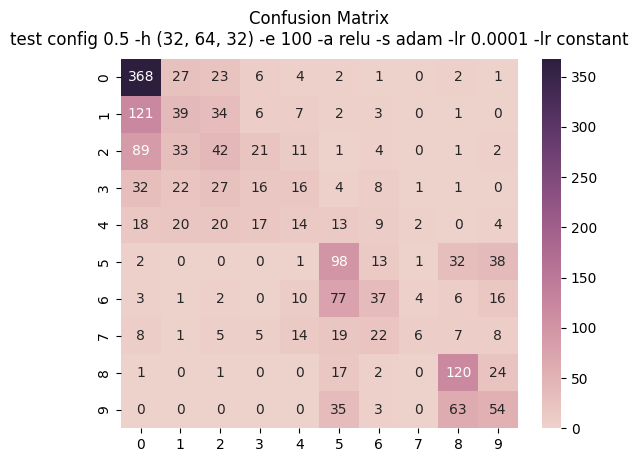

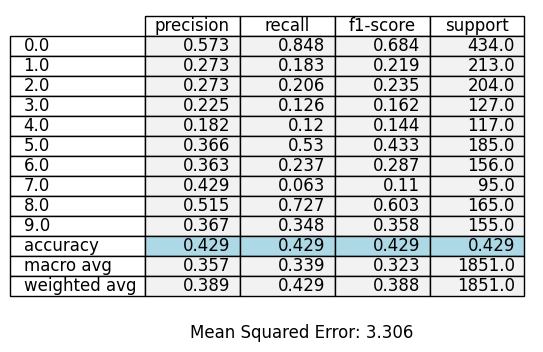

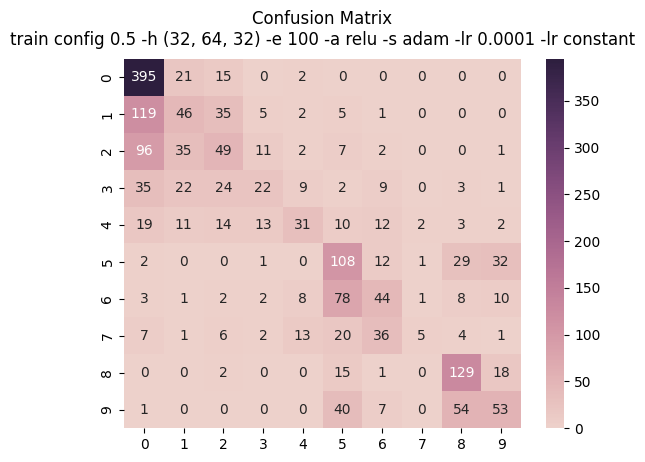

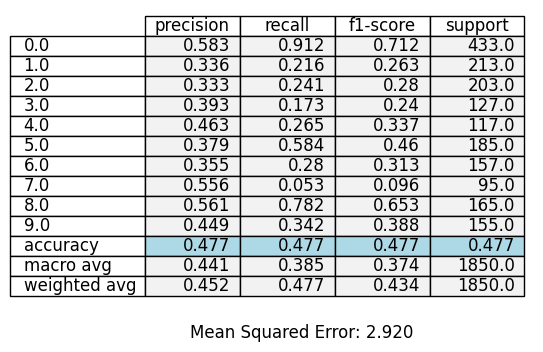

In [ ]:
best_accuracy = 0
best_config = None

config = [0.1, 0.3, 0.5]
unit_hidden = [(8),(16),(32),(64),(128), (32, 64), (32, 128), (32, 32), (64, 128), (64, 64), (128, 128), (32,64,128), (128,64,32), (32,64,32)]

for i in config:
    x_train, x_test, y_train, y_test = train_test_split(features, label, test_size=i, random_state=42, stratify=label)

    scaler = StandardScaler()
    x_train = scaler.fit_transform(x_train)
    x_test = scaler.transform(x_test)

    x_train = pd.DataFrame(x_train)
    x_test = pd.DataFrame(x_test)

    correlation_matrix = pd.DataFrame(x_train).corr()

    upper_tri = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape),k=1).astype(bool))
    to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.9)]

    x_train = x_train.drop(x_train.columns[to_drop], axis=1)
    x_test = x_test.drop(x_test.columns[to_drop], axis=1)

    pca = PCA(n_components=0.95)
    pca.fit(x_train)
    x_train = pca.transform(x_train)
    x_test = pca.transform(x_test)

    for j in unit_hidden:
        #! edit mulai disini
        hidden_layer = j
        max_iter = 100
        activation = 'relu'
        solver = 'adam'
        random_state = 42
        learning_rate_init = 0.0001
        learning_rate = 'constant'
        mlp = MLPClassifier(hidden_layer_sizes=hidden_layer, max_iter=max_iter, activation=activation, solver=solver, random_state=random_state, learning_rate_init=learning_rate_init, learning_rate=learning_rate)
        mlp.fit(x_train, y_train)
        #! sampe sini

        accuracy = mlp.score(x_test, y_test)

        # Check if the current accuracy is the best
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_config = {
                'config': i,
                'epoch': max_iter,
                'hidden_layer': j,
                'activation': activation,
                'solver': solver,
                'learning_rate_init': learning_rate_init,
                'learning_rate': learning_rate
            }

        plt.plot(mlp.loss_curve_)
        plt.title('Loss Curve')
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.show()

        predict = mlp.predict(x_test)
        confussion_matrix = confusion_matrix(y_test, predict)
        plot_cm(confussion_matrix, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model1_report = classification_report(y_test, predict, output_dict=True)
        report1 = pd.DataFrame(model1_report).transpose()
        report1 = report1.round(3)
        mse_value1 = mean_squared_error(y_test, predict)
        report_maker(report1, mse_value1, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)


        predict = mlp.predict(x_train)
        confusion_matrix_result = confusion_matrix(y_train, predict)
        plot_cm(confusion_matrix_result, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model_report = classification_report(y_train, predict, output_dict=True)
        report = pd.DataFrame(model_report).transpose()
        report = report.round(3)
        mse_value = mean_squared_error(y_train, predict)
        report_maker(report, mse_value, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)

In [ ]:
best_accuracy, best_config

(0.5013477088948787,
 {'config': 0.1,
  'epoch': 100,
  'hidden_layer': (32, 64),
  'activation': 'relu',
  'solver': 'adam',
  'learning_rate_init': 0.0001,
  'learning_rate': 'constant'})

### Weight Optimizer

In [ ]:
epoch_dir = 'weight-optimizer'

cm_epoch_dir = os.path.join(cm_dir, epoch_dir)
if not os.path.exists(cm_epoch_dir):
    os.makedirs(cm_epoch_dir)

report_epoch_dir = os.path.join(report_dir, epoch_dir)
if not os.path.exists(report_epoch_dir):
    os.makedirs(report_epoch_dir)

cmdir = os.path.relpath(cm_epoch_dir, start=main_dir)
cmdir = cmdir.replace(os.path.sep, '/')

rpdir = os.path.relpath(report_epoch_dir, start=main_dir)
rpdir = rpdir.replace(os.path.sep, '/')
    

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


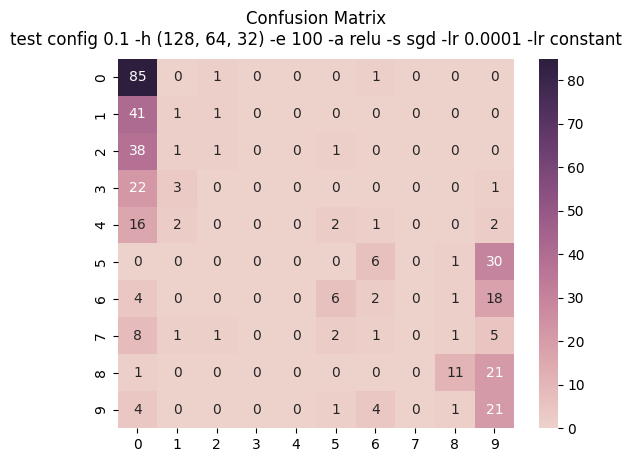

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


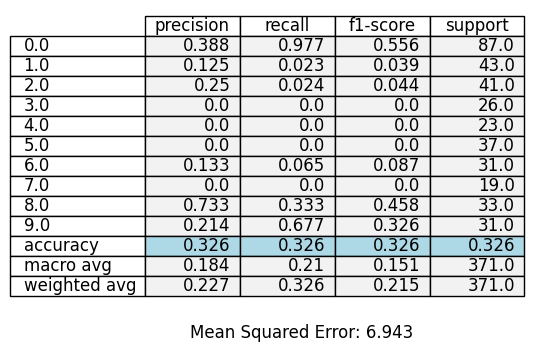

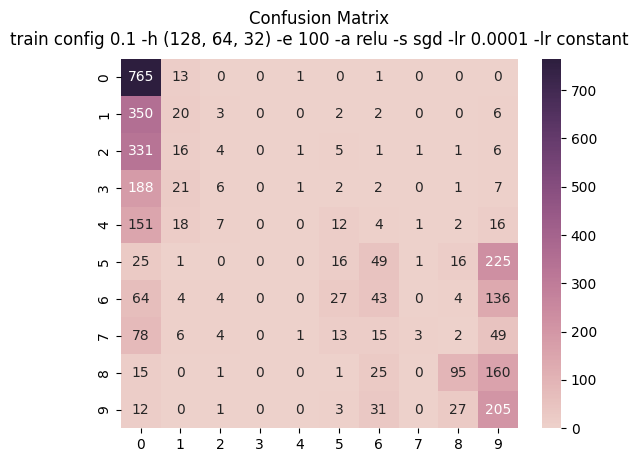

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


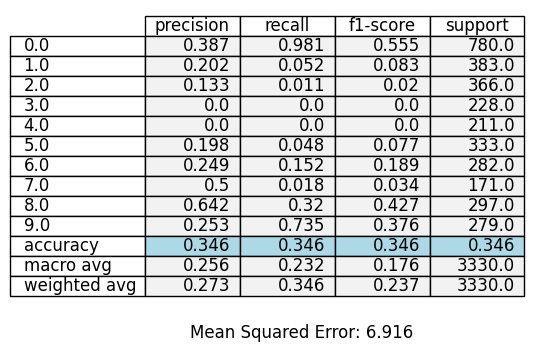

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


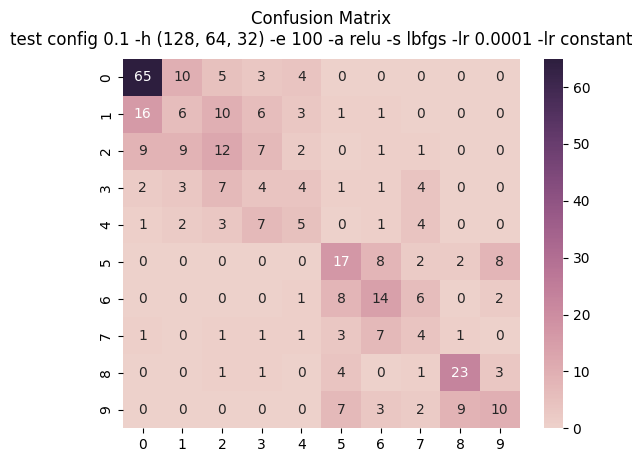

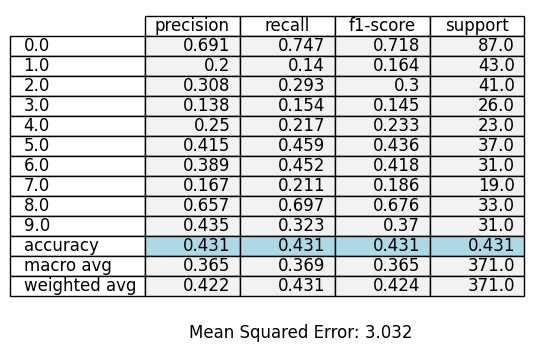

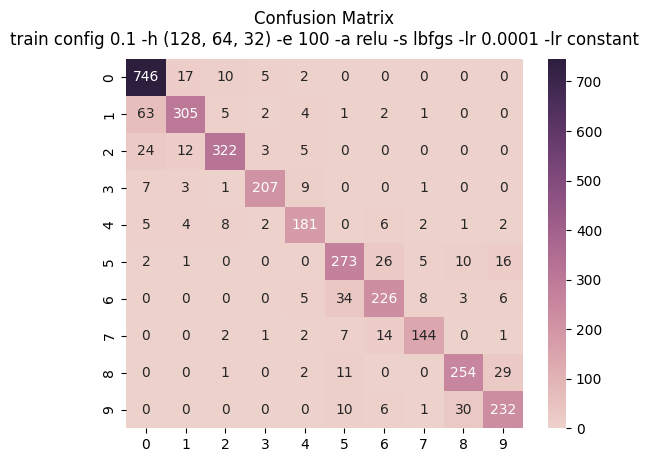

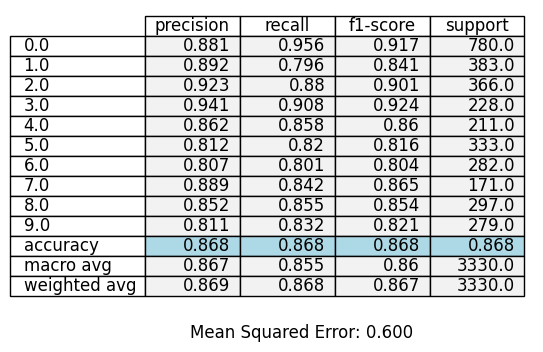

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


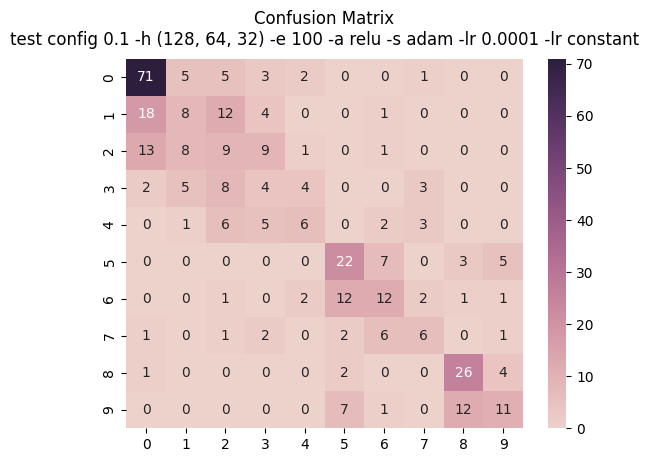

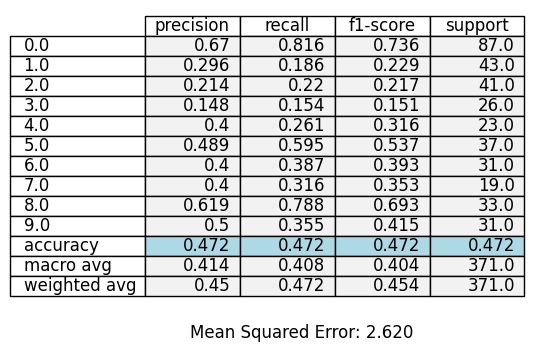

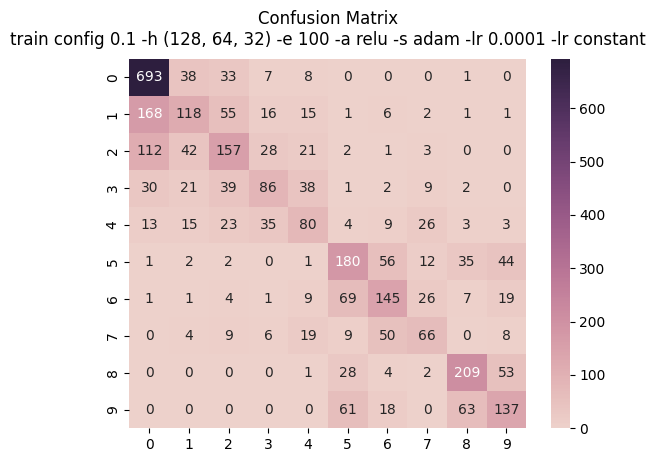

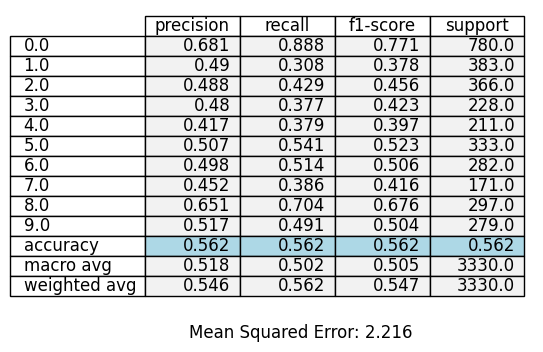

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


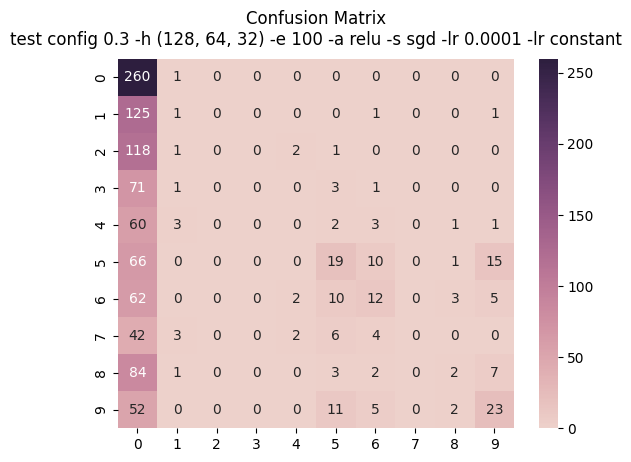

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


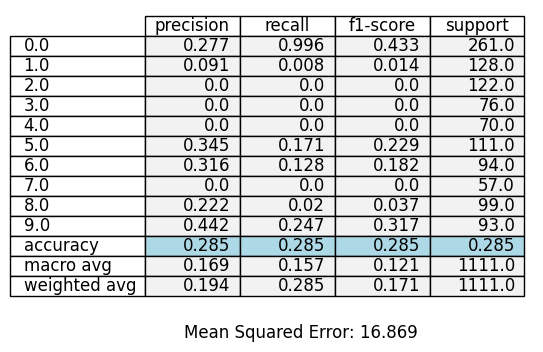

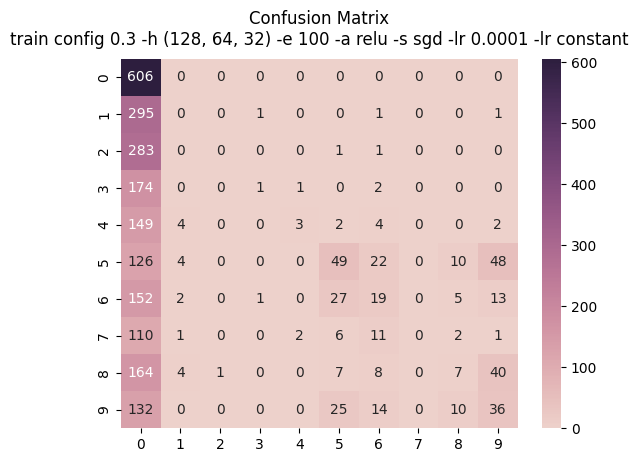

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


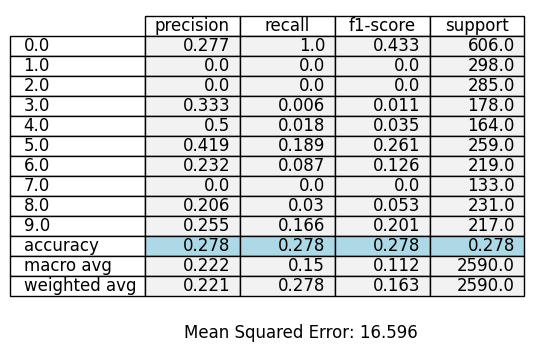

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


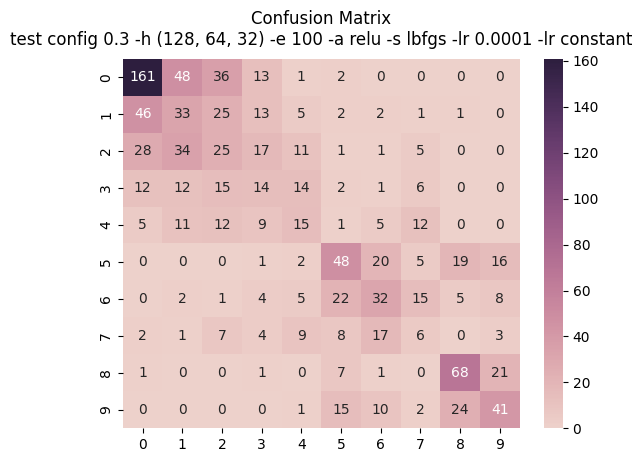

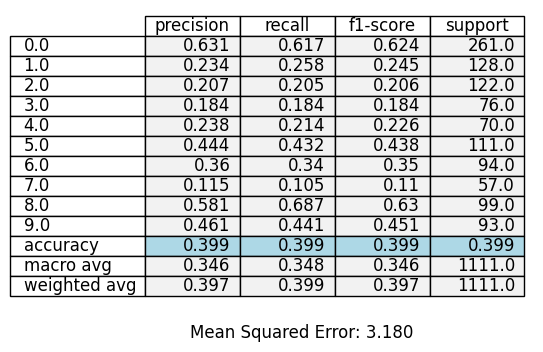

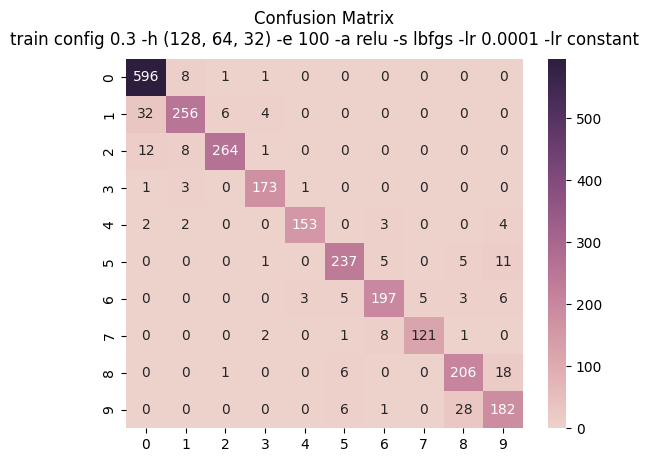

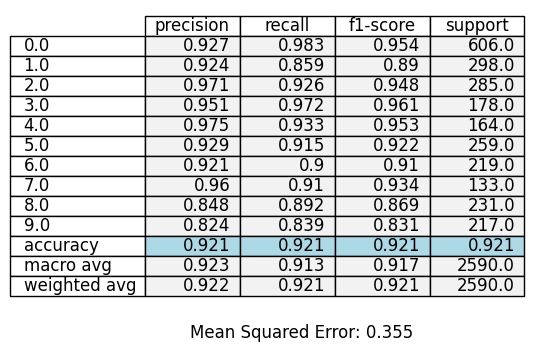

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


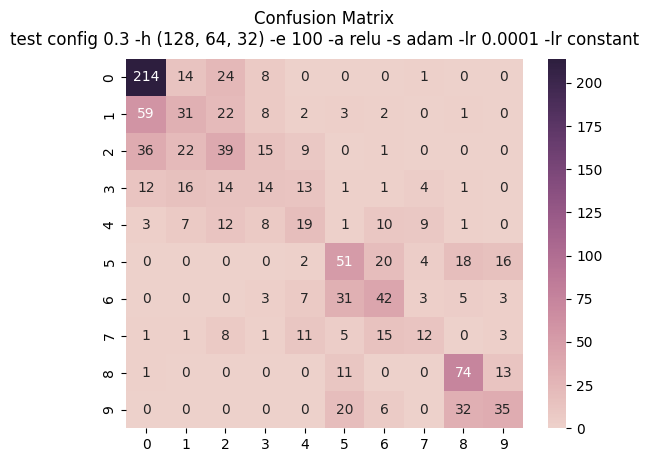

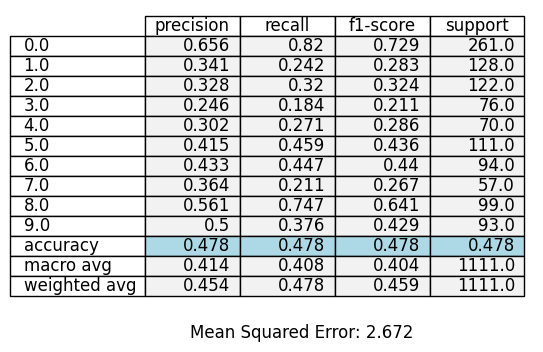

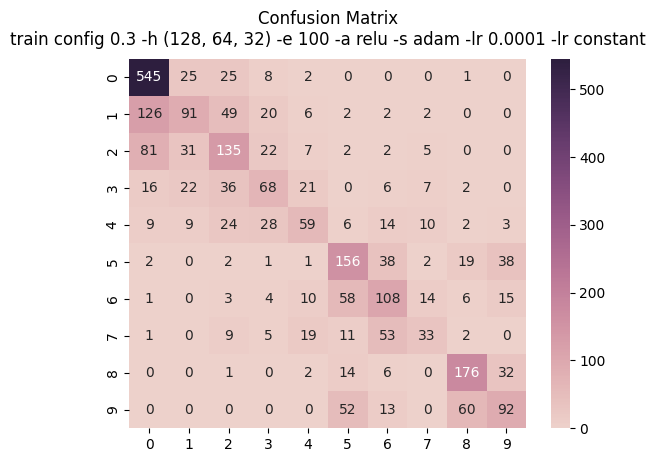

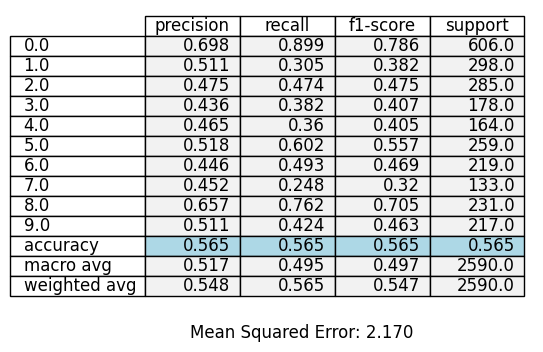

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


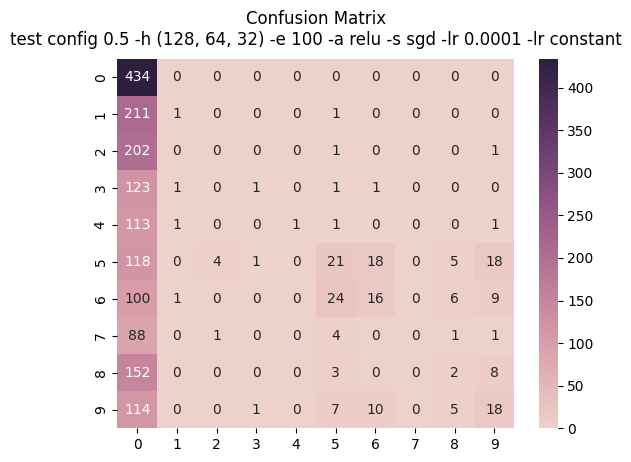

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


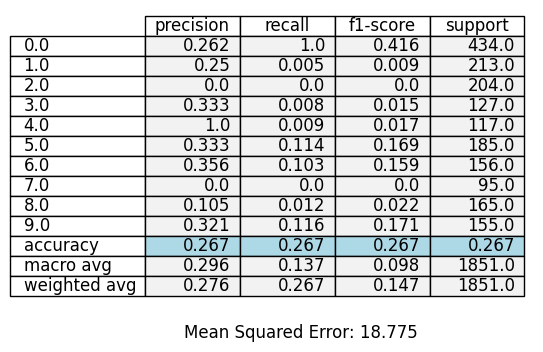

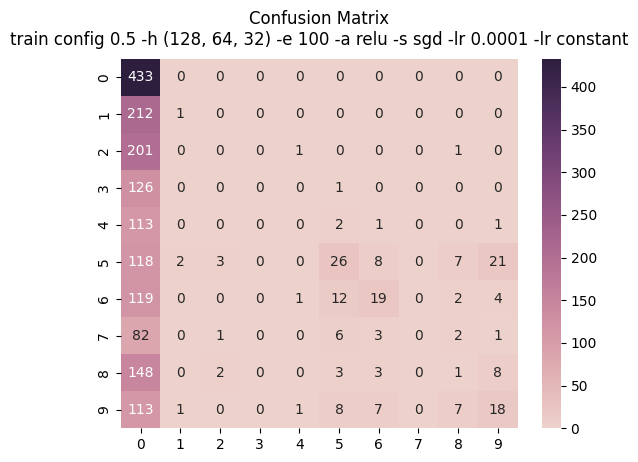

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


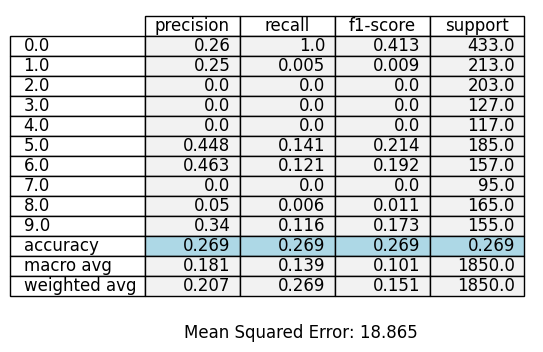

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:541: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


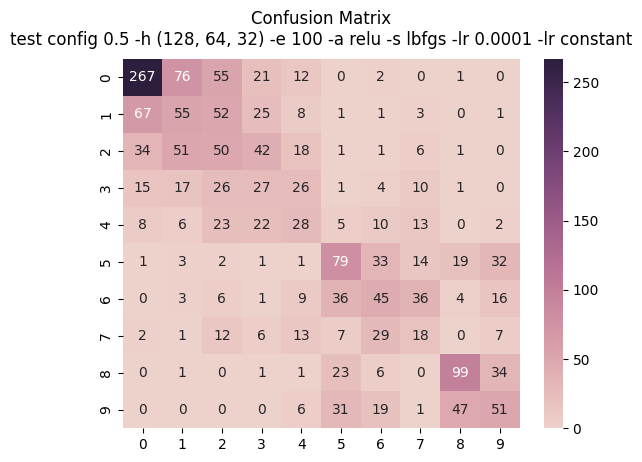

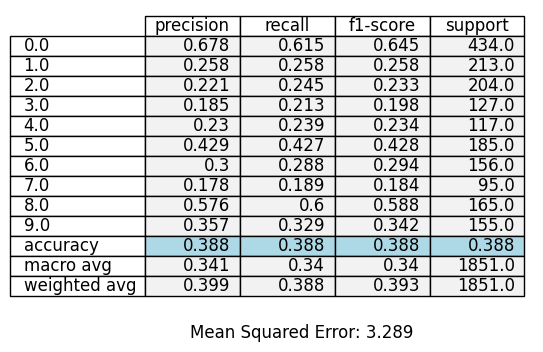

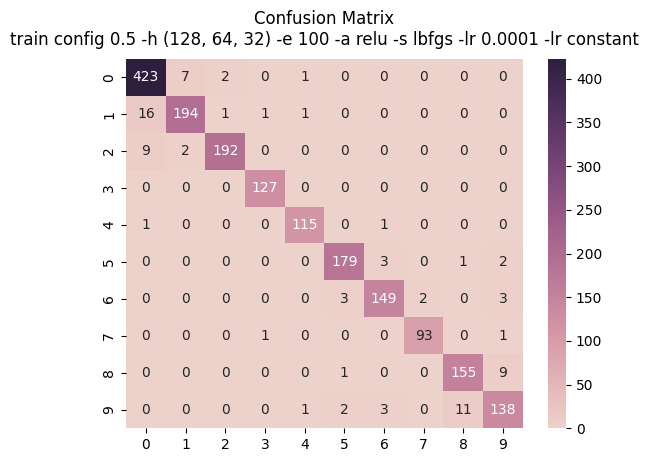

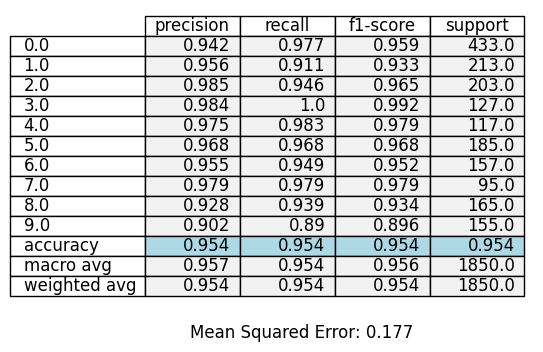

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


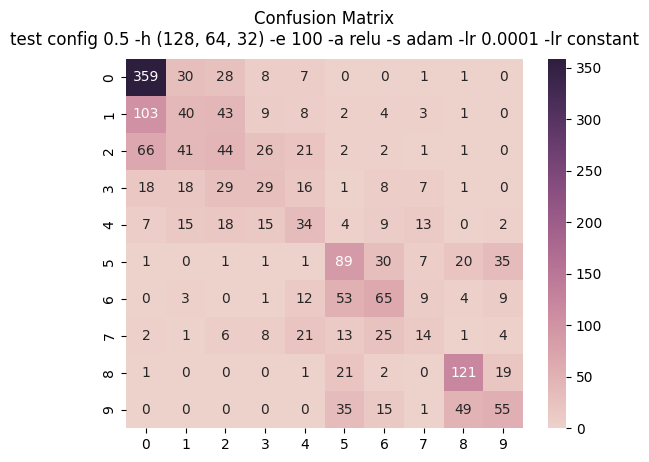

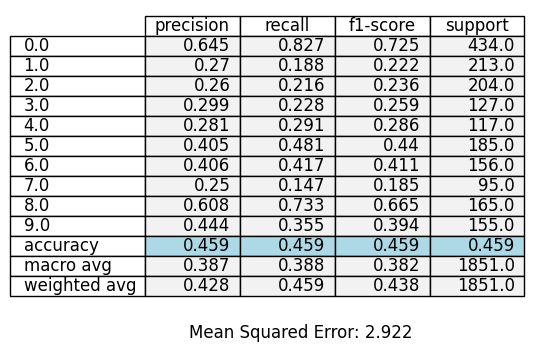

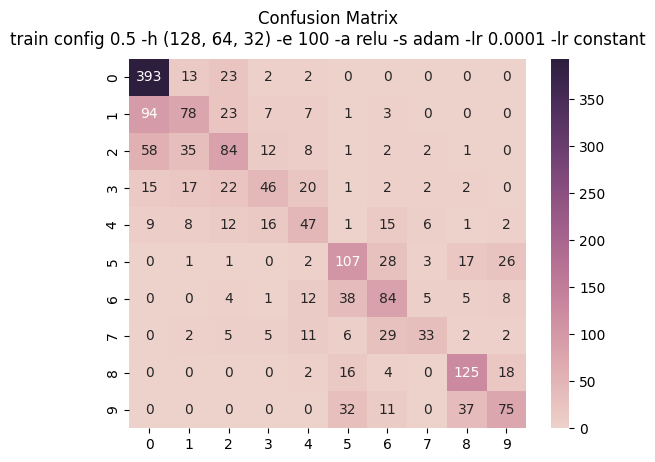

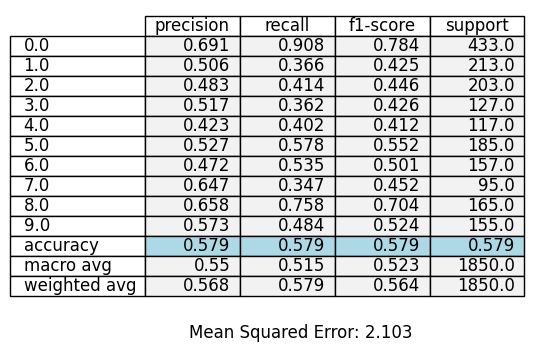

In [ ]:
best_accuracy = 0
best_config = None

config = [0.1, 0.3, 0.5]
wop = ['sgd', 'lbfgs', 'adam']

for i in config:
    x_train, x_test, y_train, y_test = train_test_split(features, label, test_size=i, random_state=42, stratify=label)

    scaler = StandardScaler()
    x_train = scaler.fit_transform(x_train)
    x_test = scaler.transform(x_test)

    x_train = pd.DataFrame(x_train)
    x_test = pd.DataFrame(x_test)

    correlation_matrix = pd.DataFrame(x_train).corr()

    upper_tri = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape),k=1).astype(bool))
    to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.9)]

    x_train = x_train.drop(x_train.columns[to_drop], axis=1)
    x_test = x_test.drop(x_test.columns[to_drop], axis=1)

    pca = PCA(n_components=0.95)
    pca.fit(x_train)
    x_train = pca.transform(x_train)
    x_test = pca.transform(x_test)

    for j in wop:
        #! edit mulai disini
        hidden_layer = (128,64,32)
        max_iter = 100
        activation = 'relu'
        solver = j
        random_state = 42
        learning_rate_init = 0.0001
        learning_rate = 'constant'
        mlp = MLPClassifier(hidden_layer_sizes=hidden_layer, max_iter=max_iter, activation=activation, solver=solver, random_state=random_state, learning_rate_init=learning_rate_init, learning_rate=learning_rate)
        mlp.fit(x_train, y_train)
        #! sampe sini

        accuracy = mlp.score(x_test, y_test)

        # Check if the current accuracy is the best
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_config = {
                'config': i,
                'epoch': max_iter,
                'hidden_layer': hidden_layer,
                'activation': activation,
                'solver': solver,
                'learning_rate_init': learning_rate_init,
                'learning_rate': learning_rate
            }

        # plt.plot(mlp.loss_curve_)
        # plt.title('Loss Curve')
        # plt.xlabel('Iterations')
        # plt.ylabel('Loss')
        # plt.show()

        predict = mlp.predict(x_test)
        confussion_matrix = confusion_matrix(y_test, predict)
        plot_cm(confussion_matrix, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model1_report = classification_report(y_test, predict, output_dict=True)
        report1 = pd.DataFrame(model1_report).transpose()
        report1 = report1.round(3)
        mse_value1 = mean_squared_error(y_test, predict)
        report_maker(report1, mse_value1, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)


        predict = mlp.predict(x_train)
        confusion_matrix_result = confusion_matrix(y_train, predict)
        plot_cm(confusion_matrix_result, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model_report = classification_report(y_train, predict, output_dict=True)
        report = pd.DataFrame(model_report).transpose()
        report = report.round(3)
        mse_value = mean_squared_error(y_train, predict)
        report_maker(report, mse_value, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)

In [ ]:
best_accuracy, best_config

(0.47794779477947796,
 {'config': 0.3,
  'epoch': 100,
  'hidden_layer': (128, 64, 32),
  'activation': 'relu',
  'solver': 'adam',
  'learning_rate_init': 0.0001,
  'learning_rate': 'constant'})

### Learning Rate Type

In [ ]:
epoch_dir = 'learning-rate-type'

cm_epoch_dir = os.path.join(cm_dir, epoch_dir)
if not os.path.exists(cm_epoch_dir):
    os.makedirs(cm_epoch_dir)

report_epoch_dir = os.path.join(report_dir, epoch_dir)
if not os.path.exists(report_epoch_dir):
    os.makedirs(report_epoch_dir)

cmdir = os.path.relpath(cm_epoch_dir, start=main_dir)
cmdir = cmdir.replace(os.path.sep, '/')

rpdir = os.path.relpath(report_epoch_dir, start=main_dir)
rpdir = rpdir.replace(os.path.sep, '/')
    

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


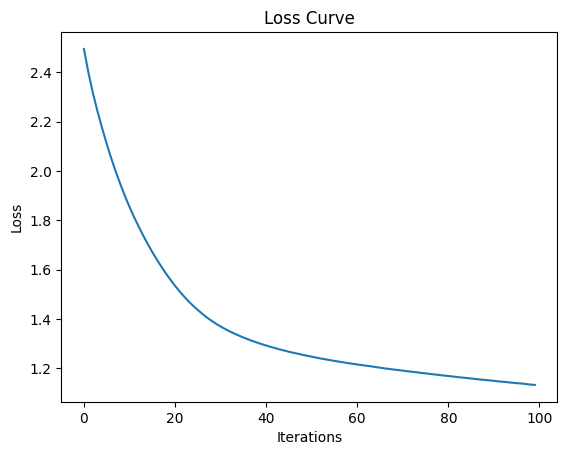

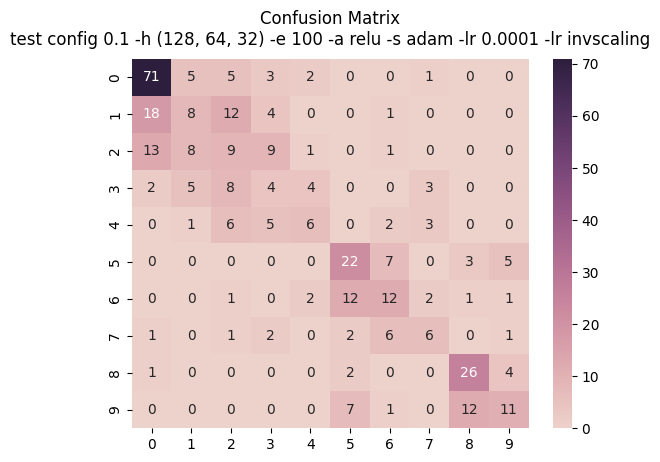

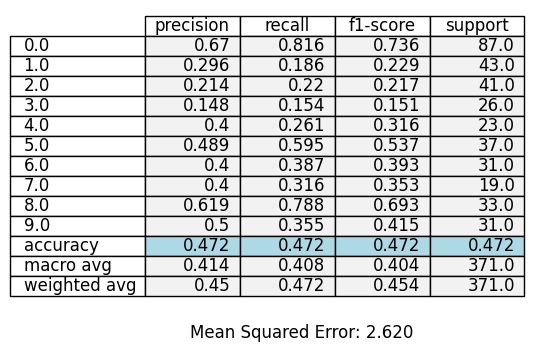

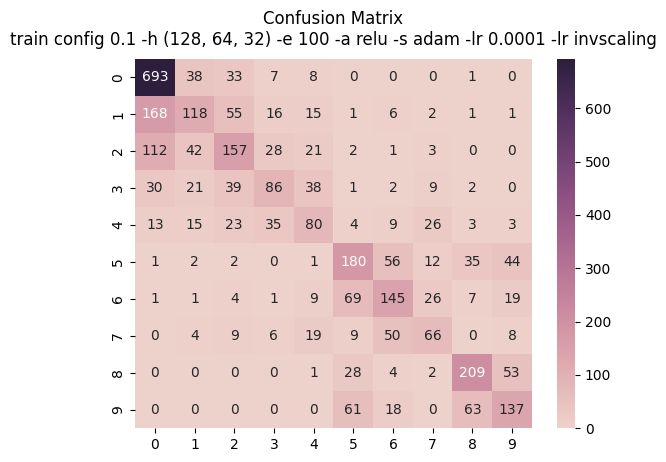

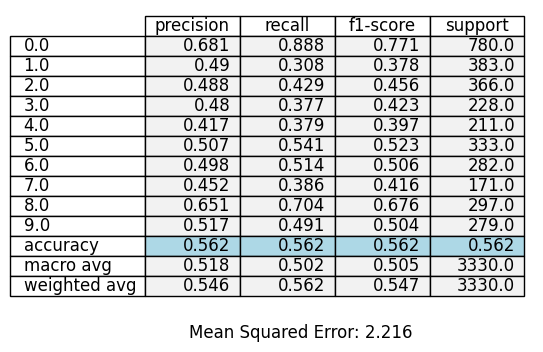

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


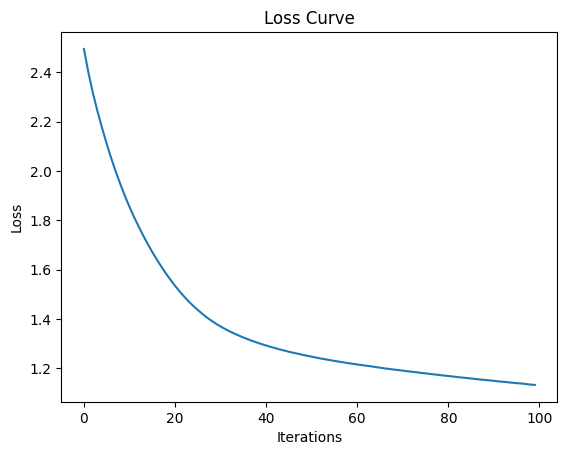

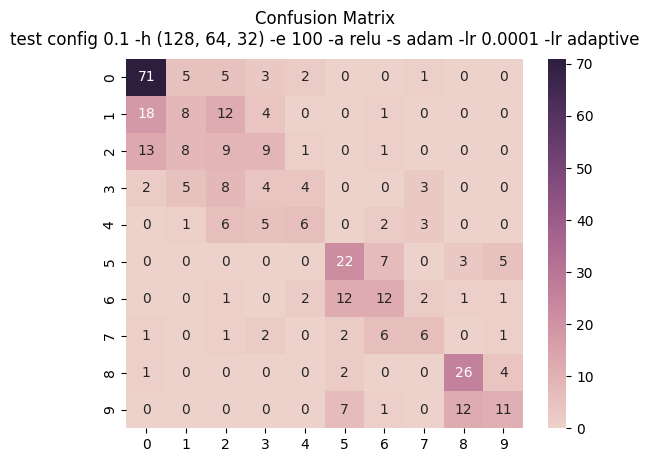

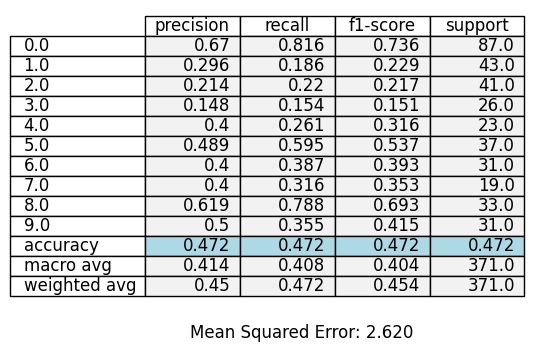

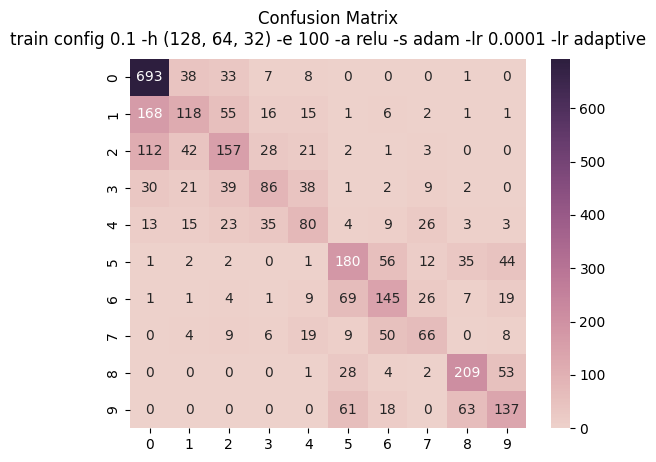

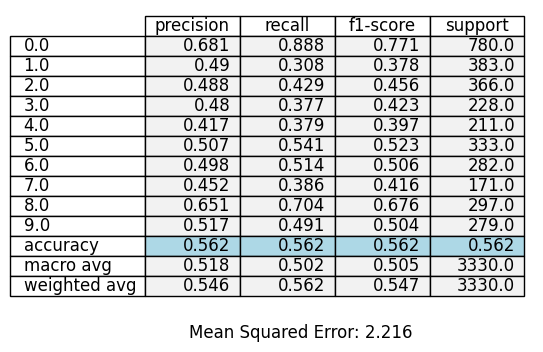

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


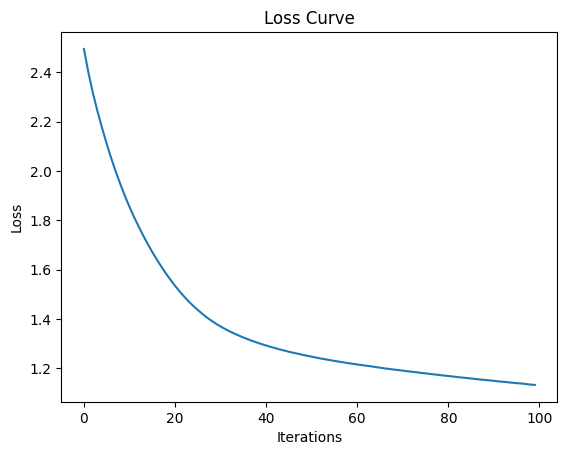

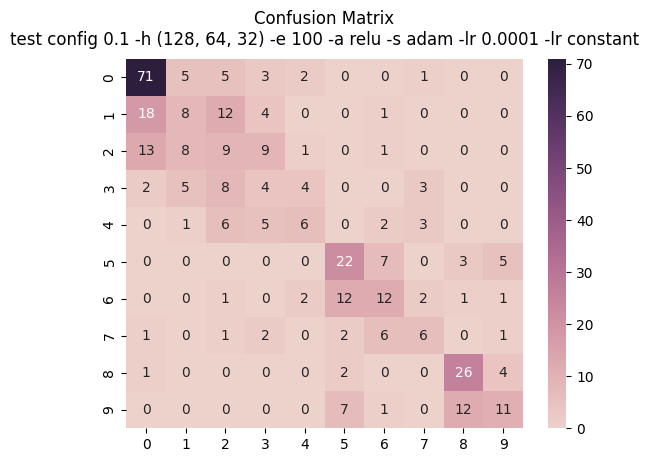

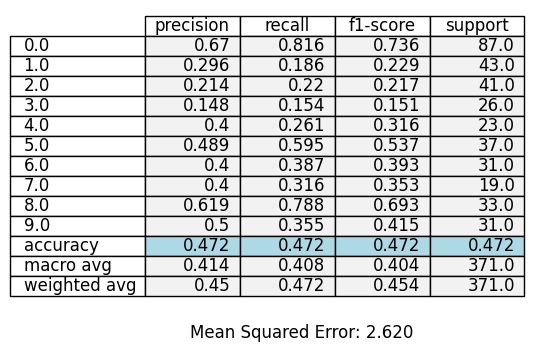

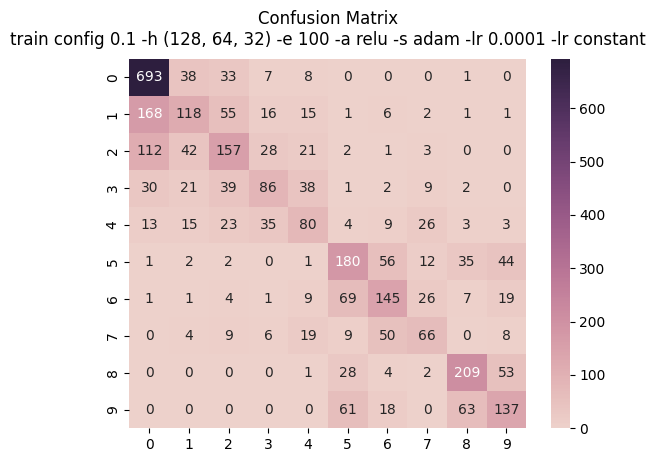

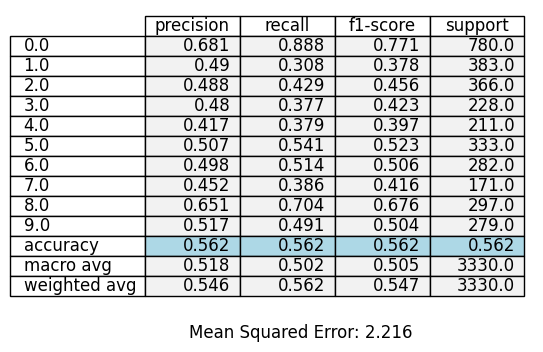

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


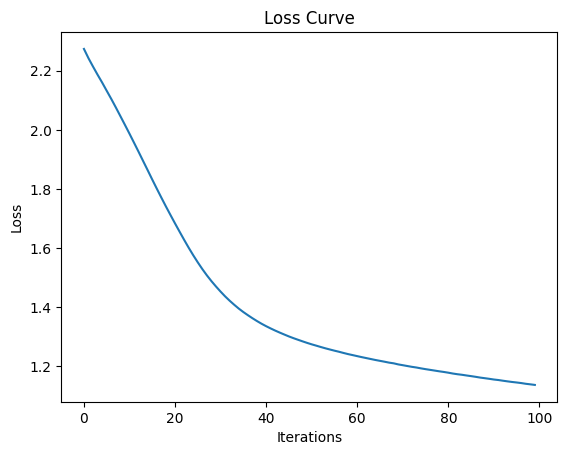

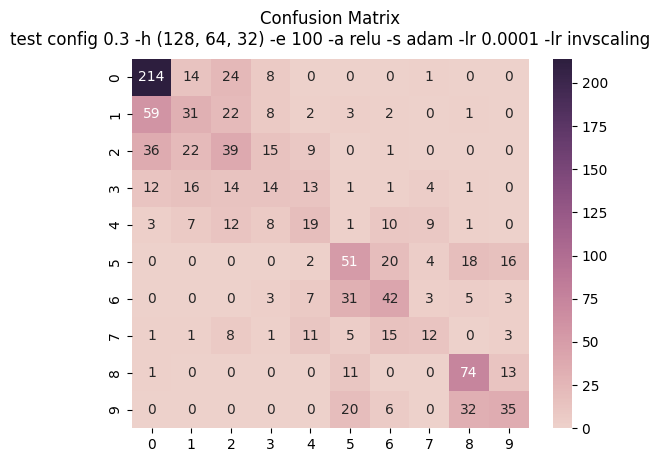

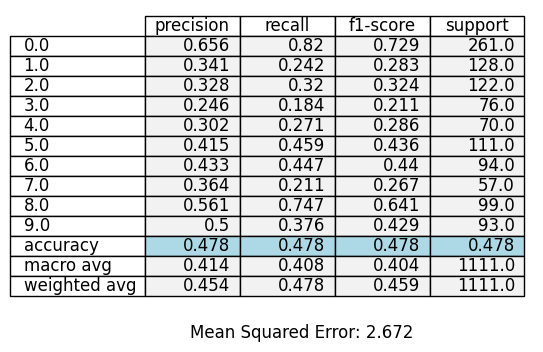

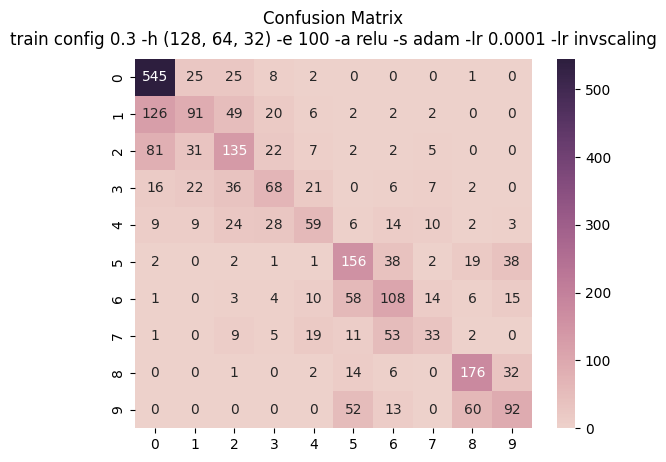

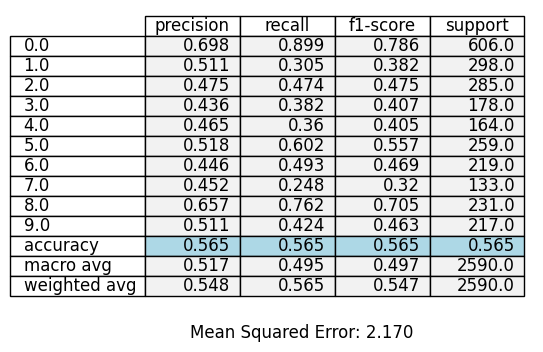

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


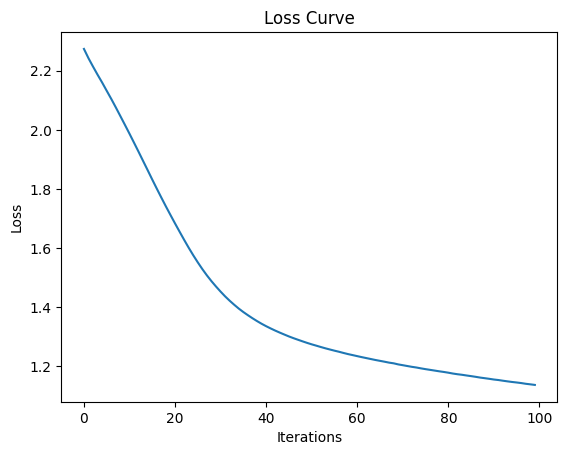

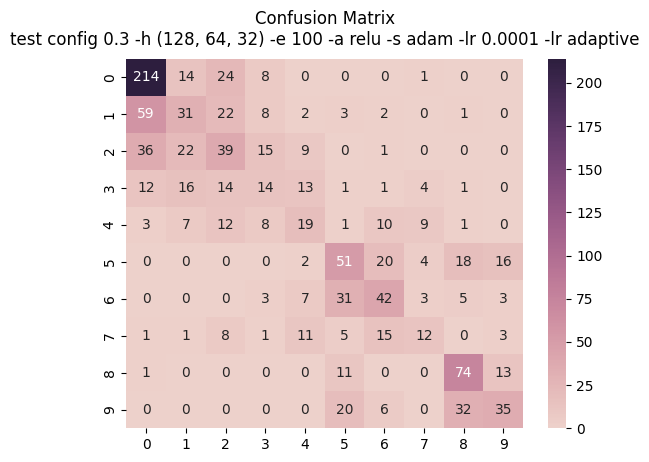

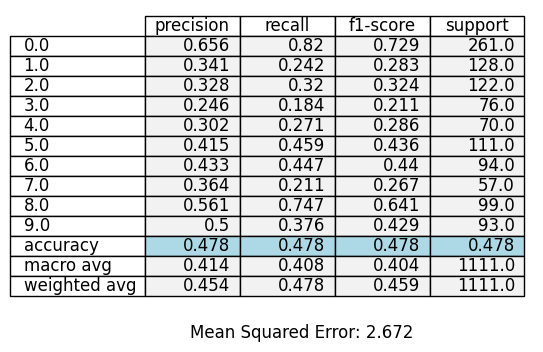

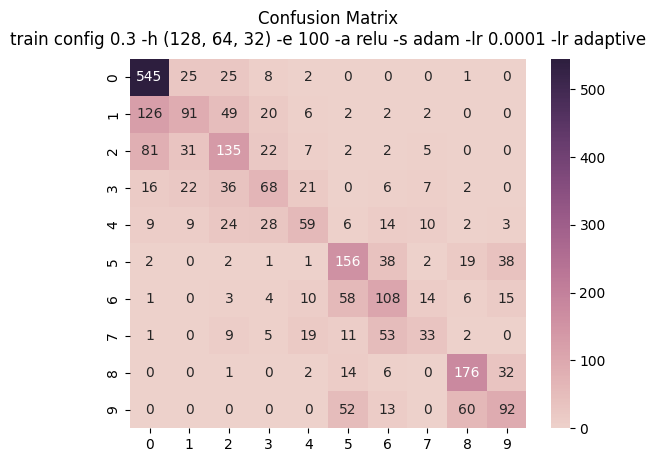

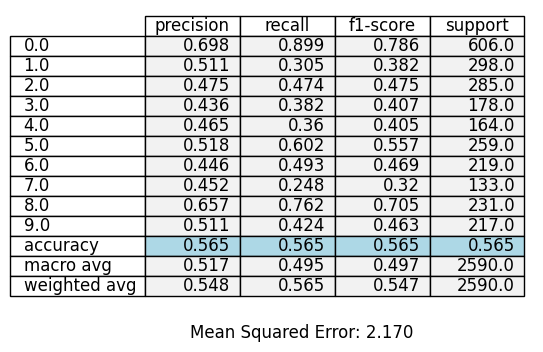

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


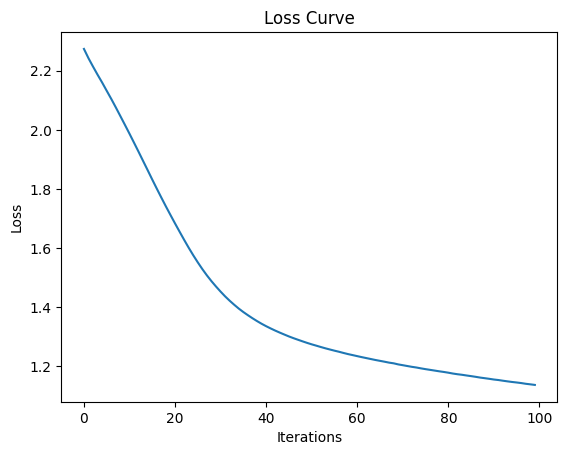

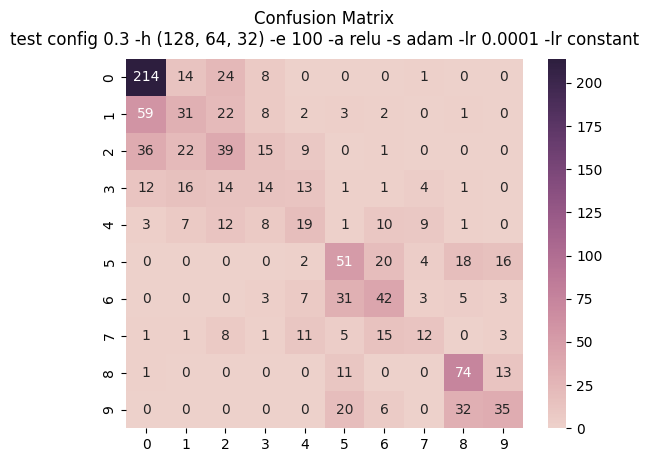

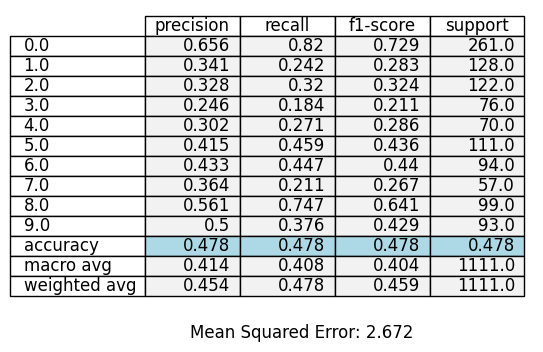

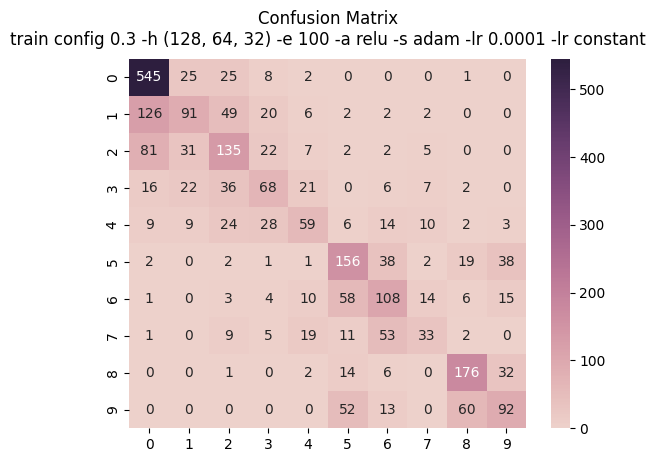

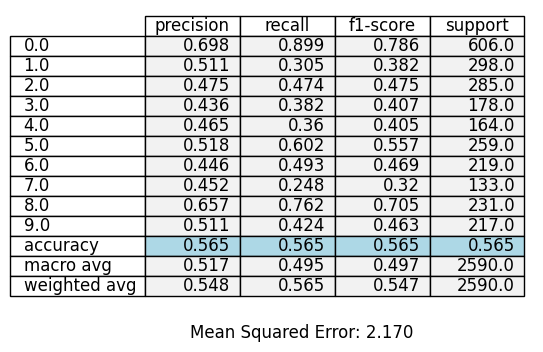

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


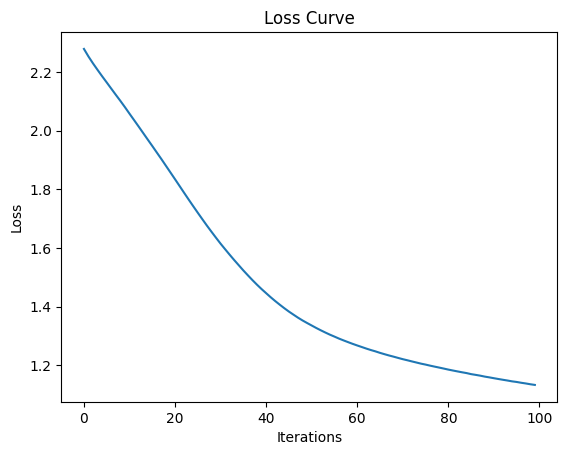

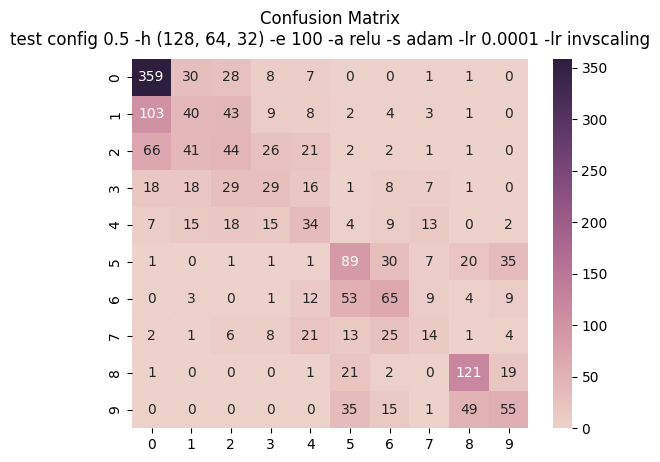

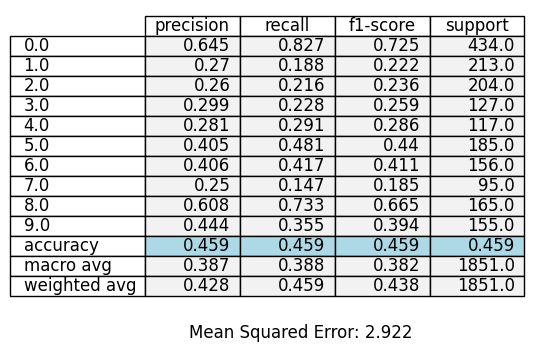

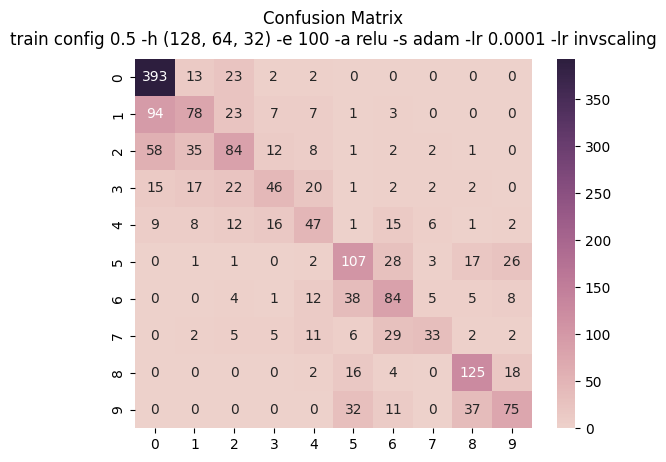

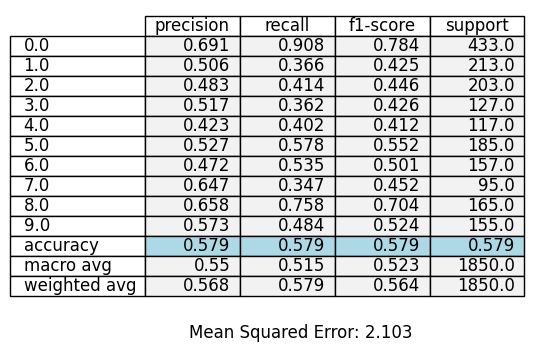

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


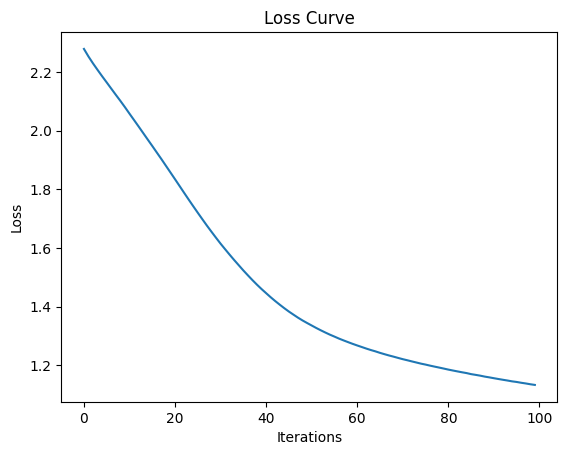

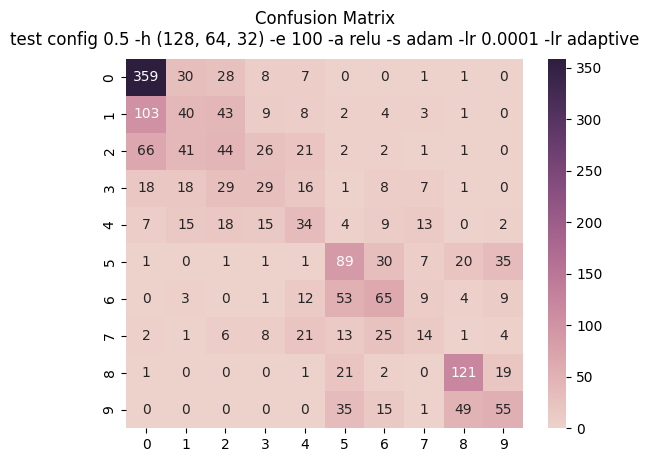

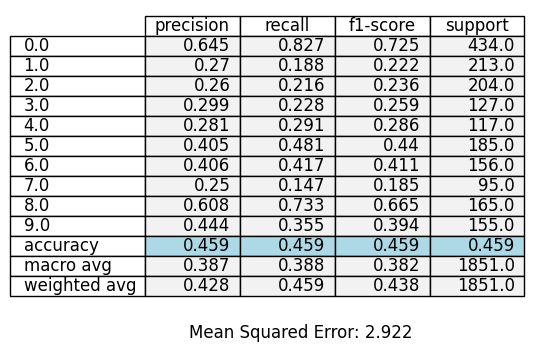

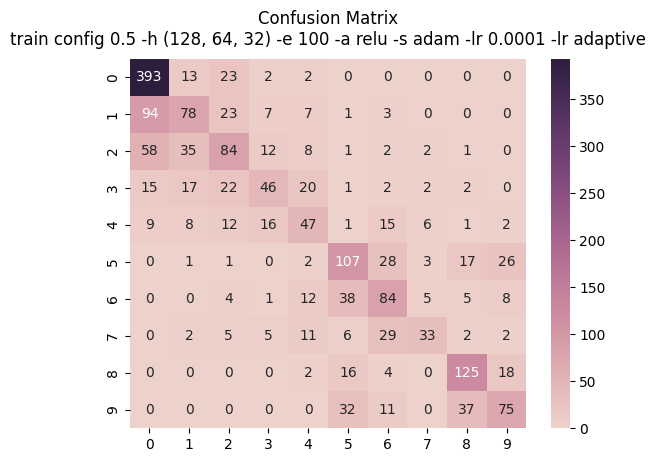

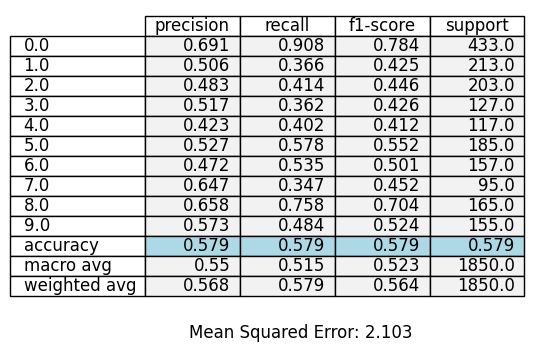

c:\anaconda3\envs\pyenv\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


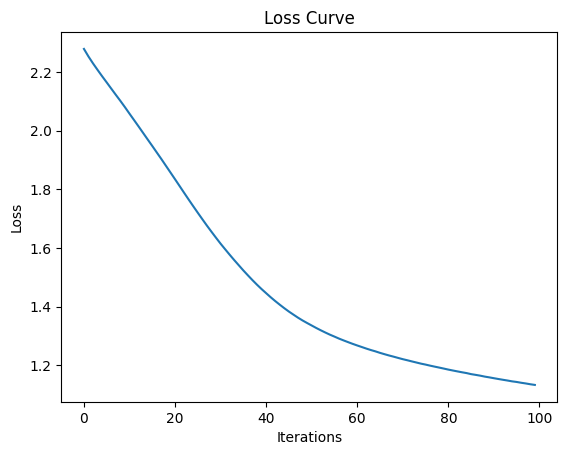

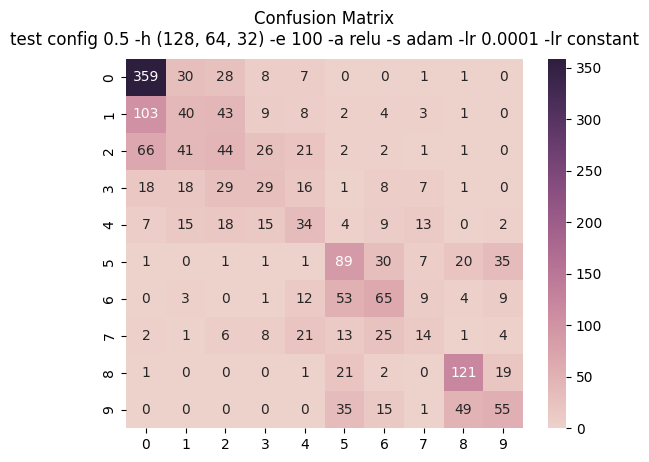

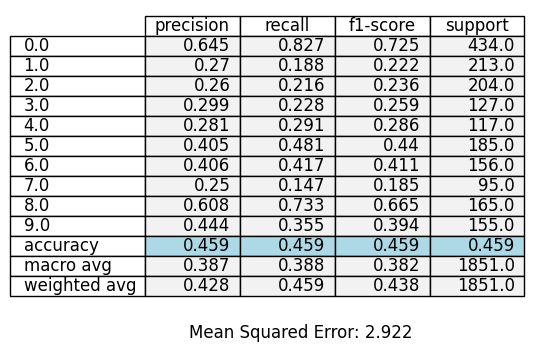

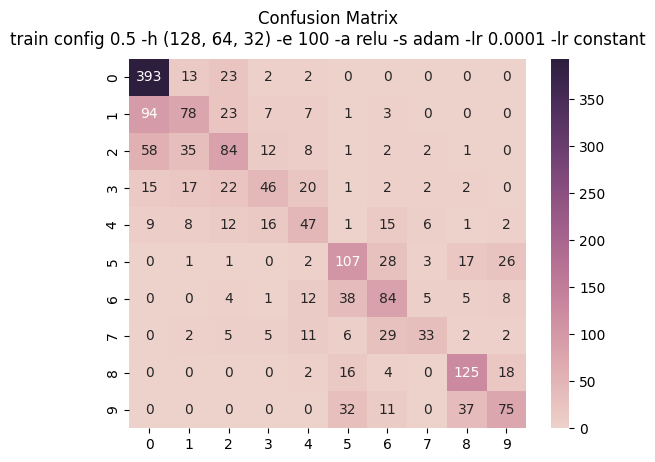

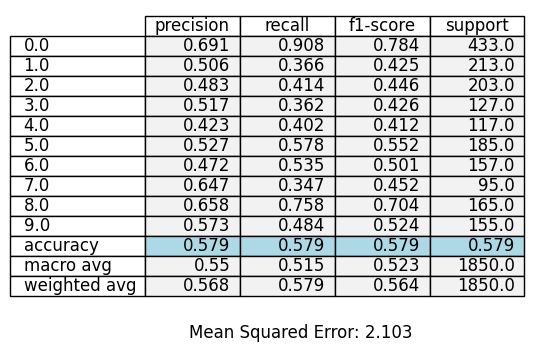

In [ ]:
best_accuracy = 0
best_config = None

config = [0.1, 0.3, 0.5]
lr_type = ['invscaling', 'adaptive', 'constant']

for i in config:
    x_train, x_test, y_train, y_test = train_test_split(features, label, test_size=i, random_state=42, stratify=label)

    scaler = StandardScaler()
    x_train = scaler.fit_transform(x_train)
    x_test = scaler.transform(x_test)

    x_train = pd.DataFrame(x_train)
    x_test = pd.DataFrame(x_test)

    correlation_matrix = pd.DataFrame(x_train).corr()

    upper_tri = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape),k=1).astype(bool))
    to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.9)]

    x_train = x_train.drop(x_train.columns[to_drop], axis=1)
    x_test = x_test.drop(x_test.columns[to_drop], axis=1)

    pca = PCA(n_components=0.95)
    pca.fit(x_train)
    x_train = pca.transform(x_train)
    x_test = pca.transform(x_test)

    for j in lr_type:
        #! edit mulai disini
        hidden_layer = (128,64,32)
        max_iter = 100
        activation = 'relu'
        solver = 'adam'
        random_state = 42
        learning_rate_init = 0.0001
        learning_rate = j
        mlp = MLPClassifier(hidden_layer_sizes=hidden_layer, max_iter=max_iter, activation=activation, solver=solver, random_state=random_state, learning_rate_init=learning_rate_init, learning_rate=learning_rate)
        mlp.fit(x_train, y_train)
        #! sampe sini

        accuracy = mlp.score(x_test, y_test)

        # Check if the current accuracy is the best
        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_config = {
                'config': i,
                'epoch': max_iter,
                'hidden_layer': j,
                'activation': activation,
                'solver': solver,
                'learning_rate_init': learning_rate_init,
                'learning_rate': learning_rate
            }

        plt.plot(mlp.loss_curve_)
        plt.title('Loss Curve')
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.show()

        predict = mlp.predict(x_test)
        confussion_matrix = confusion_matrix(y_test, predict)
        plot_cm(confussion_matrix, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model1_report = classification_report(y_test, predict, output_dict=True)
        report1 = pd.DataFrame(model1_report).transpose()
        report1 = report1.round(3)
        mse_value1 = mean_squared_error(y_test, predict)
        report_maker(report1, mse_value1, f'test config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)


        predict = mlp.predict(x_train)
        confusion_matrix_result = confusion_matrix(y_train, predict)
        plot_cm(confusion_matrix_result, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', cmdir)

        model_report = classification_report(y_train, predict, output_dict=True)
        report = pd.DataFrame(model_report).transpose()
        report = report.round(3)
        mse_value = mean_squared_error(y_train, predict)
        report_maker(report, mse_value, f'train config {i} -h {hidden_layer} -e {max_iter} -a {activation} -s {solver} -lr {learning_rate_init} -lr {learning_rate}', rpdir)

In [ ]:
best_accuracy, best_config

(0.47794779477947796,
 {'config': 0.3,
  'epoch': 100,
  'hidden_layer': 'invscaling',
  'activation': 'relu',
  'solver': 'adam',
  'learning_rate_init': 0.0001,
  'learning_rate': 'invscaling'})